In [1]:
import pandas as pd
import os
#import pyproj as pj # for reliable gps
# or from pyproj import Geod (and remove the pj when executing the functionality)
from pyproj import Geod, Proj
import numpy as np # for reliable gps
from collections import Counter # for reliable gps
import datetime as dt # called in staticMethods # for reliable gps and for depth halfTime
import sys
#import geopandas as gpd # for geometry column for reliable gps # install first GDAL, then fiona and then geopandas
import matplotlib.pyplot as plt #produces maps and diagrams

# for sunset and sunrise time calculation python library
# Additional Locations
import astral
from astral.sun import sun

# timezone aware datetime
import pytz

In [2]:
# staticMethodFunctions
def basedNamesForCsv(lastEntryRowDF, selfDfNameString, selfTurtleTag, selfSpecificFileName=""):
    for value in enumerate(lastEntryRowDF):
        #print(value[1][0])
        lastDate = value[1][0]
        date = dt.datetime.strptime(lastDate, "%Y.%m.%d")
        stringDate = date.strftime("%Y") + "_" + date.strftime("%b")
        print(f"The Last Entry in the Dataframe for {selfTurtleTag} is from: ")
        print(stringDate)
        # Give the CSV a Name based on this values above
        # name = allGpsDf_tag_xxxxx_until_lastdate
        cvsName = selfDfNameString + selfSpecificFileName + "_Tag_" + selfTurtleTag + "_" + stringDate +".csv"
        print(f"The Name for the {selfDfNameString} CSV for the turtleData {selfTurtleTag} is: ")
        print(cvsName)
        print('--------------')
        return cvsName 

def calculateDistance(geodRef, lon1, lat1, lon2, lat2):
    # # compute forward and back azimuths, plus distance
    az12,az21,dist = geodRef.inv(lon1, lat1, lon2, lat2) #Take the second row and the first row on the count. it shoul give 3 values, but I only need the dist.
    # f"{az12:.3f} {az21:.3f} {dist:.3f}"        
    return dist #Put the dist inside the distances variable once empty.

def convertUnixTimeFromString(timeString):
    return dt.datetime.strptime(timeString, '%Y.%m.%d %H:%M:%S').timestamp() #[i] is the position in an array

def stringIntoDate(timeString):
    return dt.datetime.strptime(timeString, '%Y.%m.%d %H:%M:%S')

def calculateSpeed(d, t1, t2):
    speed = d / (t2 - t1)
    return speed

def checkIfDfHasBeenSavedAndSaveDf(folderToSaveItems, folderToSave, dataframe, stringDfName):
    filesInResultsFolder = []       
    for file in folderToSaveItems:
        filesInResultsFolder.append(file)    
    print(filesInResultsFolder)
    if not filesInResultsFolder:
        print(f"The filename {stringDfName} is not yet in the folder... saving csv")
        pathToFilePlusCsvName = os.path.join(folderToSave, stringDfName)
        dataframe.to_csv(pathToFilePlusCsvName, index=False)
        print(f"{stringDfName} has been saved in the results folder!")
    elif stringDfName in filesInResultsFolder:
        print(f"The CSV {stringDfName} has already been saved in the results folder")
    else:
        print(f"The filename {stringDfName} is not yet in the folder... saving csv")
        pathToFilePlusCsvName = os.path.join(folderToSave, stringDfName)
        dataframe.to_csv(pathToFilePlusCsvName, index=False)
        print(f"{stringDfName} has been saved in the results folder!")
    print('--------------')

def checkIfJsonHasBeenSavedAndSaveJson(folderToSaveItems, folderToSave, dataframe, stringJsonName):
    JsonInResultsFolder = []
    for Json in folderToSaveItems:
        JsonInResultsFolder.append(Json) 
    print(JsonInResultsFolder)
    if not JsonInResultsFolder:
        print(f"The filename {stringJsonName} is not yet in the folder... saving json")
        pathToFilePlusJsonName = os.path.join(folderToSave, stringJsonName)
        out = dataframe.to_json(orient="table")
        with open(pathToFilePlusJsonName, 'w') as f:
            f.write(out)
        print(f"{stringJsonName} has been saved in the results folder!")
    elif stringJsonName in JsonInResultsFolder:
        print(f"The CSV {stringJsonName} has already been saved in the results folder")
    else:
        print(f"The filename {stringJsonName} is not yet in the folder... saving json")
        pathToFilePlusJsonName = os.path.join(folderToSave, stringJsonName)
        out = dataframe.to_json(orient="table")
        with open(pathToFilePlusJsonName, 'w') as f:
            f.write(out)
        print(f"{stringJsonName} has been saved in the results folder!")
    print('--------------')

def convertUnixTimeFromString(timeString):
    return dt.datetime.strptime(timeString, '%Y.%m.%d %H:%M:%S').timestamp() #[i] is the position in an array

def convertToStringFromUnixTime(unixSeconds):
    return dt.datetime.fromtimestamp(unixSeconds).strftime('%Y.%m.%d %H:%M:%S')

def createPoint(gps1, gps2, depth):
    
    #Calcolo Percentuale depth in base al tempo
    #print("How many time has passed between 2 points of GPS")
    print(gps1.acquisitionStartTime)
    print(gps2.acquisitionStartTime)
    unixTimeGPS1 = convertUnixTimeFromString(gps1.acquisitionStartTime)
    unixTimeGPS2 = convertUnixTimeFromString(gps2.acquisitionStartTime)
    totalTime = unixTimeGPS2 - unixTimeGPS1
    #print(totalTime)

    #------------------Calculations with acquisition time, not with halftime depth---------------    
    unixTimeAcquisitionTimeDepth = convertUnixTimeFromString(depth.acquisitionTime)
    #print("Depth Acquisition Time")
    #print(depth.acquisitionTime)
    depthTime = unixTimeAcquisitionTimeDepth - unixTimeGPS1
    depthTimePercent = (100*depthTime)/totalTime
    #-------------------------------------------
    
    #------------------half depth---------------
    # halfDepthTime = depth.halfTime - unixTimeGPS1 # maybe use the totalTime variable here
    # halfDepthTimePercent = (100*halfDepthTime)/totalTime
    # print("If using the depth.halfTime - unixTimeGPS1")
    # print("the diff between depth half acquisition time and gps1 acquisition time")
    # print(halfDepthTimePercent)
    #-------------------------------------------
    
    #Sottrazione vettori -----------------------
    #print("calculating diff between lon and lat of gps 1 and gps 2")
    vectorDiff = Point(gps2.longitude-gps1.longitude, gps2.latitude-gps1.latitude)
    #print("DIFF:" + str(vectorDiff.x) + " - " + str(vectorDiff.y))
    
    #Calcolo del modulo del vettore differenza
    modulovectorDiff = np.sqrt((vectorDiff.x**2) + (vectorDiff.y**2))
    
    #Normalizzazione vettore differenza, di lunghezza 1
    normalizedVector = Point( vectorDiff.x/modulovectorDiff, vectorDiff.y/modulovectorDiff)
    
    #Calcolo lunghezza vettore Depth
    #print("Calcolo lunghezza vettore Depth")
    depthVectorLength = ( modulovectorDiff*depthTimePercent)/100
    #print(depthVectorLength)
    
    #---------------------- half depth----------
    # #Calcolo lunghezza vettore Half depth
    # print("Calcolo lunghezza vettore Half Depth")
    # halfDepthVectorLength = ( modulovectorDiff*halfDepthTimePercent)/100
    # print(halfDepthVectorLength)
    #-------------------------------------------
    
    #Calcolo del vettore depth, sull'origine
    #print("Calcolo del vettore depth, sull'origine")
    depthVector = Point(normalizedVector.x * depthVectorLength, normalizedVector.y * depthVectorLength)
    #print(depthVector)
    
    #---------------------half depth------------
    # #Calcolo del vettore Half depth, sull'origine
    # print("Calcolo del vettore Half depth, sull'origine")
    # halfDepthVector = Point(normalizedVector.x * halfDepthVectorLength, normalizedVector.y * halfDepthVectorLength)
    # print(halfDepthVector)
    #-------------------------------------------
    
    #Calcolo finale del punto depth (somma del punto gps1 + vettore depth calcolato)
    #print("Calcolo finale del punto depth (somma del punto gps1 + vettore depth calcolato")
    depthPoint = Point(gps1.longitude + depthVector.x, gps1.latitude+depthVector.y)
    #print(depthPoint)
    
    #---------------------half depth------------
    # #Calcolo finale del punto depth (somma del punto gps1 + vettore depth calcolato)
    # print("Calcolo finale del punto half depth (somma del punto gps1 + vettore half depth calcolato")
    # halfDepthPoint = Point(gps1.longitude + halfDepthVector.x, gps1.latitude+halfDepthVector.y)
    # print(halfDepthPoint)
    #-------------------------------------------
    #print("my point of acquisition time depth")
    #print(str(depthPoint.x) + " - " + str(depthPoint.y))
    # print("my point of half time depth")
    # print(str(halfDepthPoint.x) + " - " + str(halfDepthPoint.y))
    
    # If I want to return the HalfTimeDepth I need to put in return below: halfDepthPoint
    # If I want to return the AquisitionTimeDepth I need to put in return below: depthPoint
    return depthPoint

# function to help transform the percentages in the graph in normal values
def autopct_format(values):
    def my_format(pct):
        total= sum(values)
        val = int(round(pct*total/100.0))
        return '{v:d} ({p:.2f}%)'.format(v=val, p=pct)
    return my_format

def lowerStringAndReplace(string):
    new_string = string.lower()
    return  new_string.replace(" ", "_")

def checkIfGraphHasBeenSavedAndSaveGraph(folderToSaveItems, folderToSave, plt, graphTitle):
    GraphsInResultsFolder = []
    for file in folderToSaveItems:
        if file.endswith('.png'):
            GraphsInResultsFolder.append(file) 
    print(GraphsInResultsFolder)
    if not GraphsInResultsFolder:
        print(f"The Graph {graphTitle} is not yet in the folder... saving graph")
        pathToFilePlusGraphName = os.path.join(folderToSave, graphTitle)
        plt.savefig(pathToFilePlusGraphName + '.png', dpi=300)
        print(f"{graphTitle} has been saved in the results folder!")
    elif graphTitle + '.png' in GraphsInResultsFolder:
        print(f"The Graph {graphTitle} has already been saved in the results folder")
    else:
        print(f"The Graph {graphTitle} is not yet in the folder... saving graph")
        pathToFilePlusGraphName = os.path.join(folderToSave, graphTitle)
        plt.savefig(pathToFilePlusGraphName + '.png', dpi=300)
        print(f"{graphTitle} has been saved in the results folder!")
    print('--------------')


def pieCompareTwoData(group1, group2, labels ,startangle, colors, title, folderToSaveItems, folderToSave):
    plt.figure(figsize=(7,7))
    plt.pie([group1, group2], #labels=labels, 
        autopct= autopct_format([group1,group2]), shadow=True, 
        startangle=startangle, colors=colors, pctdistance=0.6, explode=[0,.1])
    plt.title(title, fontsize=18) #bbox={'facecolor':'0.9', 'pad':5})
    #titleToSaveFig = title.rsplit(' ', 10)[0]
    titleToSaveFig = lowerStringAndReplace(title) + "_graph"
    #print("TITLE TO SAVE THE FIGURES")
    plt.legend(labels, loc="lower right", fontsize=16)#loc="best")
    print(titleToSaveFig)
    checkIfGraphHasBeenSavedAndSaveGraph(folderToSaveItems, folderToSave, plt, titleToSaveFig)
    #plt.savefig(os.path.join(folderToSave, titleToSaveFig + '.png'), dpi=300)
    #plt.savefig(titleToSaveFig + '.png', dpi=300)
    #plt.show()

# def drawFixAttemptGraph(df, columnName, group1, group2, title, folderToSave):
#     fig, ax = plt.subplots(figsize=(10,4))
#     for key, grp in df.groupby([columnName]):
#         ax.plot(grp[group1], grp[group2], label=key)
#     ax.legend()
#     titleToSaveFig = lowerStringAndReplace(title) + "_graph"
#     plt.savefig(os.path.join(folderToSave, titleToSaveFig + '.png'), dpi=300)

# def drawFixAttemptGraph(dataset1, dataset2, title, folderToSave):
#     fig = pd.crosstab(dataset1, dataset2).plot(kind='bar', figsize=(7,6), fontsize=14).get_figure()
#     titleToSaveFig = lowerStringAndReplace(title) + "_graph"
#     fig.savefig(os.path.join(folderToSave, titleToSaveFig + '.png'), dpi=300)
#     #dataset.plot(kind=bar)

# def drawFixAttemptGraph(dataset1, dataset2, title, folderToSave):
#     bar_width = 0.4
#     bar_height = 1
#     # Initialize the vertical-offset for the stacked bar chart.
#     y_offset = np.zeros(2)#len(columns))
#     fig, ax = plt.subplots(2)
#     #plt.xlabel('categories')
#     plt.ylabel('quantity')
#     #print("--------------------HERE")
#     #plt.bar(width=bar_width, height=bar_height, bottom=y_offset)
#     plt.bar(width=bar_width, height=bar_height, x='categories')
#     #dict1 = dict(zip(dataset1.array, dataset1.axes[0]))
#     #print(f"{dict1}--------------dict 01")
#     #dict2 = dict(zip(dataset2.array, dataset2.axes[0]))
#     #print(f"{dict2}--------------dict 02")
#     #print(dataset1.array) #[2832, 173, 6, 204]
#     #print(dataset1.axes) # [Index(['Resolved QFP', 'Resolved QFP (Uncertain)', 'Succeeded', 'Unresolved QFP']  
#     ax[0].plot(dataset1.axes[0], dataset1.array)
#     ax[1].plot(dataset2.axes[0], dataset2.array)
#     titleToSaveFig = lowerStringAndReplace(title) + "_graph"
#     fig.savefig(os.path.join(folderToSave, titleToSaveFig + '.png'), dpi=300)

# def drawFixAttemptGraph(x1, y1, x2, y2, title, folderToSave):
#     fig, ax = plt.subplots(nrows=2,ncols=1)
#     plt.xlabel('categories')
#     plt.ylabel('quantity')
#     #print(dataset1.array) #[2832, 173, 6, 204]
#     #print(dataset1.axes) # [Index(['Resolved QFP', 'Resolved QFP (Uncertain)', 'Succeeded', 'Unresolved QFP']  
#     ax[0].plot(x1, y1)
#     ax[1].plot(x2, y2)
#     titleToSaveFig = lowerStringAndReplace(title) + "_graph"
#     fig.savefig(os.path.join(folderToSave, titleToSaveFig + '.png'), dpi=300)

# def drawFixAttemptGraph(df1, df2, title, folderToSave):
#     fig = plt.figure(figsize=(8,7))
#     subplot1 = fig.add_subplot(1,2,1)
#     subplot1.plot(df1)
#     subplot2 = fig.add_subplot(2,4,2)
#     subplot2.plot(df2)
#     fig.suptitle(title)
#     titleToSaveFig = lowerStringAndReplace(title) + "_graph"
#     fig.savefig(os.path.join(folderToSave, titleToSaveFig + '.png'), dpi=300)

# def drawFixAttemptGraph(dataset, title, folderToSave):
#     fig = plt.figure(figsize=(8,7))
#     #fig = dataset.plot()
#     #fig.sort_values(['GPS Fix Attempt'], ascending=False).plot(kind='barh'), #y='GPS Fix Attempt', x='GPS Fix Attempt')
#     fig.plot(kind='barh')#, y='GPS Fix Attempt', x='GPS Fix Attempt')
#     #fig.suptitle(title)
#     titleToSaveFig = lowerStringAndReplace(title) + "_graph"
#     fig.savefig(os.path.join(folderToSave, titleToSaveFig + '.png'), dpi=300)

# def drawBarFixAttemptGraph(dataset1, dataset2, title, folderToSave):
#     fig = plt.figure(figsize=(8,7))
#     subplot1 = fig.add_subplot()
#     subplot1.plot(dataset1.array, dataset1.axes[0])
#     subplot2 = fig.add_subplot()
#     subplot2.plot(dataset2.array, dataset2.axes[0])    
#     fig.suptitle(title)
#     titleToSaveFig = lowerStringAndReplace(title) + "_bar_graph"
#     fig.savefig(os.path.join(folderToSave, titleToSaveFig + '.png'), dpi=300)

# def drawBarFixAttemptGraph(fixDf, title, folderToSave):
#     plot = fixDf.plot(kind='bar')
#     print("--------------------HERE")
#     fig = plot.get_figure()
#     titleToSaveFig = lowerStringAndReplace(title) + "_bar_chart "
#     fig.savefig(os.path.join(folderToSave, titleToSaveFig + '.png'), dpi=300)

def drawBarFixAttemptGraph(fixDf, title, turtleTag, folderToSaveItems, folderToSave):
    red = "#ff001e"
    green = "#26ed1f"
    plt.figure(figsize=(16,10))
    #colors = ['Blue', 'Yellow', 'Red', 'Green']
    
    # draw percentages in the graph
    graph = plt.bar(x=fixDf.index, height=fixDf["Filtered QFP"], align='center', data=fixDf)
    #graph = plt.bar(fixDf.Format, fixDf["Filtered QFP"], colors=colors)
    # draw title on the graph
    titleComplement = turtleTag + " Transmitter Tag Data"
    graphTitle = plt.title(title[1:] + "\n- " + titleComplement, fontsize=18)
    print(graphTitle)

    totals = fixDf["Overall Recorded QFP"]
    greenBars = [i/ j *100 for i, j in zip(fixDf["Mantained QFP"], totals)] # percentage
    orangeBars = [i/ j *100 for i, j in zip(fixDf["Filtered QFP"], totals)] # percentage
    #print(greenBars)
    #print(orangeBars)

    # draw percentages in the graph
    i = 0
    for p in graph:
        width = p.get_width()
        #height = p.get_heigth()
        x, y = p.get_xy()

        # the y is the height of the percentages text in the bar
        plt.text(x+width/2, y+orangeBars[i]*1.01, str(fixDf['Filtered % of Overall'][i])+'%', ha='center', weight='bold')
        plt.text(x+width/2, y+95*1.01, str(fixDf['Mantained % of Overall'][i])+'%', ha='center', weight='bold')
        #print("___________________________________________")
        #print(orangeBars[i]) # percentage value of each column in the bar graph for the filtered data
        #print(greenBars[i]) # percentage value of each column in the bar graph for the mantained data
        i+=1

    barWidth = 0.85
    names = fixDf.index
    # Create orange Bars
    plt.bar(names, orangeBars, color = red, #edgecolor='white', 
        width=barWidth, label="Filtered \nOver-speed \nerrors")
    # Create green Bars
    plt.bar(names, greenBars, bottom=orangeBars, color = green, #edgecolor='white', 
        width=barWidth, label="Reliable \nGPS \nlocations")    

    # Custom x axis
    #plt.xticks(fixDf.shape[0], names)
    plt.xticks(names)
    plt.xlabel("QFP Categories", fontsize=14)
    plt.ylabel("Overall %", fontsize=14)
    # Add a legend
    plt.legend(loc='upper left', bbox_to_anchor=(1,1), ncol=1)
    titleToSaveFig = lowerStringAndReplace(title) + "_bar_chart"
    #plt.savefig(os.path.join(folderToSave, titleToSaveFig + '.png'), dpi=300)
    checkIfGraphHasBeenSavedAndSaveGraph(folderToSaveItems, folderToSave, plt, titleToSaveFig)

    # #df = fixDf.iloc[:, 0:2]
    # #df = fixDf.index
    # #print(df)
    # fixDf.plot(x =fixDf.index, kind='barh',stacked=True, title=title[1:], mark_right=True)
    # df_rel = fixDf[fixDf.columns[1:]]
    # print(df_rel)

def stringDateFormatToDaySuntime(acqTime): # 2020.08.12 03:33:54 to 2020, 08, 12
    datePlusTime = acqTime
    #print(datePlusTime) # 2020.08.12 03:33:54
    date = dt.datetime.strptime(datePlusTime, "%Y.%m.%d %H:%M:%S")
    #print(date) # 2020-08-12 03:33:54
    myDataFormat = str(date).replace("-", ", ")[:-9] # 2020, 08, 12 03:33:54 # [:-9] = 2020, 08, 12
    #print(myDataFormat) # '2020, 08, 12'
    separeString = myDataFormat.split(", ")
    #print(separeString) # ['2020', '08', '12']
    stringIntoInt = [int(num) for num in separeString]
    #print(stringIntoInt) # we have a list [2020, 7, 9]
    year = stringIntoInt[0]
    #print(year)
    month = stringIntoInt[1]
    #print(month)
    day = stringIntoInt[2]
    #print(day)
    thatDate = dt.date(year, month, day) # string to day
    return thatDate

def additionalLocationsSunInfoAstral(latitude, longitude, thatDate):
    sunObserver = astral.Observer(latitude,longitude, 0) #, tzinfo=<UTC>
    s = sun(observer=sunObserver, date=thatDate)
    #print(sunObserver)
    #print(s)
    for key in [
        'dawn', # datetime.datetime(2020, 8, 12, 3, 40, 39, 410554, tzinfo=<UTC>
        'dusk', 
        'noon', 
        'sunrise', 
        'sunset' 
        ]:        
        #print(f'{key:10s}:', s[key])
        #print(key)
        if key == 'dawn':
            #print("--------- There is lightness after: ")
            #print(f'{key:10s}:', s[key])
            dawn = s[key]
            #print("see dawn") 
            #print(dawn)
        elif key == 'dusk':
            #print("--------- There is darkness after: ")
            #print(f'{key:10s}:', s[key])
            dusk = s[key]
            #print("see dusk") 
            #print(dusk)
        else:
            break
    #print(dawn) # 2020-08-12 03:40:39.410554+00:00
    #print(dusk) # 2020-08-12 18:21:12.184868+00:00
    return dawn, dusk

def addUTCtimezoneToDatetime(datetimeUnaware):
    timeZoneAware = datetimeUnaware.replace(tzinfo=pytz.UTC)
    #print(timeZoneAware) # 2020-08-12 03:02:44+00:00
    #print("--------- timeZoneAware ABOVE: ")
    return timeZoneAware

def extractYearAndMonthfromtheDate(dateString):
    acqTime = dateString
    #print(acqTime) # 2020.08.12 03:33:54
    splitDatetime = acqTime.split(" ", 1) # Split into "2020.08.12" and "03:33:54"
    justDate = splitDatetime[0]
    #print(justDate)
    # # Create date object in given time format yyyy-mm-dd
    myDate = dt.datetime.strptime(justDate, "%Y.%m.%d")
    #print(myDate)
    #print('Month: ', myDate.month) # To Get month from date
    #print('Year: ', myDate.year) # To Get month from year
    return myDate

def createDictOfElementsInList(list):
    #for x in list:
        #print(x)
    # Creating an empty dict
    yearsDict = dict()
    
    # Iterating the elements in list
    i = 1
    while i < len(list):
        for x in list:
            yearsDict[i] = x
            i+=1
    print(yearsDict)
    return yearsDict

# yearsOfResearch
def firstYear(yearDf):
    # first division of the dataframe is in yearDf
    #print(yearDf)
    firstYearDf = pd.DataFrame(yearDf)
    return firstYearDf
def secondYear(yearDf):
    #print(yearDf)
    secondYearDf = pd.DataFrame(yearDf)
    return secondYearDf
    
def noLight():
    return False
def light():
    return True

def january(boolLight, nightList, dayList, distanceValue):
    print("1 month")
    if boolLight == False:
        print(f"january nigth")
        nightList.append(distanceValue)
    else:
        print(f"january day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} january total distance at nigth")
    print(f"{distanceInMetresInDay} january total distance in day")
    return nightList, dayList

def february(boolLight, nightList, dayList, distanceValue):
    print("2 month")
    if boolLight == False:
        print(f"february nigth")
        nightList.append(distanceValue)
    else:
        print(f"february day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} february total distance at nigth")
    print(f"{distanceInMetresInDay} february total distance in day")
    return nightList, dayList

def march(boolLight, nightList, dayList, distanceValue):
    print("3 month")
    if boolLight == False:
        print(f"march nigth")
        nightList.append(distanceValue)
    else:
        print(f"march day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} march total distance at nigth")
    print(f"{distanceInMetresInDay} march total distance in day")
    return nightList, dayList

def april(boolLight, nightList, dayList, distanceValue):
    print("4 month")
    if boolLight == False:
        print(f"april nigth")
        nightList.append(distanceValue)
    else:
        print(f"april day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} april total distance at nigth")
    print(f"{distanceInMetresInDay} april total distance in day")
    return nightList, dayList

def may(boolLight, nightList, dayList, distanceValue):
    print("5 month")
    if boolLight == False:
        print(f"may nigth")
        nightList.append(distanceValue)
    else:
        print(f"may day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} may total distance at nigth")
    print(f"{distanceInMetresInDay} may total distance in day")
    return nightList, dayList

def june(boolLight, nightList, dayList, distanceValue):
    print("6 month")
    if boolLight == False:
        print(f"june nigth")
        nightList.append(distanceValue)
    else:
        print(f"june day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} june total distance at nigth")
    print(f"{distanceInMetresInDay} june total distance in day")
    return nightList, dayList

def july(boolLight, nightList, dayList, distanceValue):
    print("7 month")
    if boolLight == False:
        print(f"july nigth")
        nightList.append(distanceValue)
    else:
        print(f"july day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} july total distance at nigth")
    print(f"{distanceInMetresInDay} july total distance in day")
    return nightList, dayList

def august(boolLight, nightList, dayList, distanceValue):
    print("8 month")
    if boolLight == False:
        print(f"august nigth")
        nightList.append(distanceValue)
    else:
        print(f"august day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} august total distance at nigth")
    print(f"{distanceInMetresInDay} august total distance in day")
    return nightList, dayList

def september(boolLight, nightList, dayList, distanceValue):
    print("9 month")
    if boolLight == False:
        print(f"september nigth")
        nightList.append(distanceValue)
    else:
        print(f"september day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} september total distance at nigth")
    print(f"{distanceInMetresInDay} september total distance in day")
    return nightList, dayList

def october(boolLight, nightList, dayList, distanceValue):
    print("10 month")
    if boolLight == False:
        print(f"october nigth")
        nightList.append(distanceValue)
    else:
        print(f"october day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} october total distance at nigth")
    print(f"{distanceInMetresInDay} october total distance in day")
    return nightList, dayList

def november(boolLight, nightList, dayList, distanceValue):
    print("11 month")
    if boolLight == False:
        print(f"november nigth")
        nightList.append(distanceValue)
    else:
        print(f"november day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} november total distance at nigth")
    print(f"{distanceInMetresInDay} november total distance in day")
    return nightList, dayList

def december(boolLight, nightList, dayList, distanceValue):
    print("12 month")
    if boolLight == False:
        print(f"december nigth")
        nightList.append(distanceValue)
    else:
        print(f"december day")
        dayList.append(distanceValue)
    distanceInMetresAtNight = sum(nightList)
    distanceInMetresInDay = sum(dayList)
    print(f"{distanceInMetresAtNight} december total distance at nigth")
    print(f"{distanceInMetresInDay} december total distance in day")
    return nightList, dayList

def create2020DistanceGraphDayAndNight(d):
    df = pd.DataFrame(d)
    df['y_night']=df['y_night'].astype(float)
    df['y_day']=df['y_day'].astype(float)

    df.plot('x',y=['y_night','y_day'])
    plt.show()

def create2021DistanceGraphDayAndNight(d):
    df = pd.DataFrame(d)
    df['y_night']=df['y_night'].astype(float)
    df['y_day']=df['y_day'].astype(float)

    df.plot('x',y=['y_night','y_day'])
    plt.show()

In [3]:
class ColumnReferences:
    GPS_RELIABLE_ID = 0
    GPS_All_GPS_ID = 1
    GPS_ACQUISITION_TIME = 2
    GPS_ACQUISITION_START_TIME = 3
    GPS_GPS_FIX_TIME = 4
    GPS_GPS_FIX_ATTEMPT = 5
    GPS_LATITUDE = 6
    GPS_LONGITUDE = 7
    GPS_DISTANCE = 8
    GPS_TIME_S = 9
    GPS_SPEED = 10
    GPS_TIME_H = 11

    DEPTH_DEPTH_ID = 0
    DEPTH_NOGPS_ID = 1
    DEPTH_ACQUISITION_TIME = 2
    DEPTH_ACQUISITION_START_TIME = 3
    DEPTH_UNDERWATER_PERCENTAGE = 4
    DEPTH_DIVE_COUNT = 5
    DEPTH_AVERAGE_DIVE_DURATION = 6
    DEPTH_MAXIMUM_DIVE_DURATION = 7
    DEPTH_MAXIMUM_DIVE_DEPTH = 8
    DEPTH_PERCENTAGE_LAYER1 = 9
    DEPTH_PERCENTAGE_LAYER2 = 10
    DEPTH_PERCENTAGE_LAYER3 = 11
    DEPTH_PERCENTAGE_LAYER4 = 12
    DEPTH_PERCENTAGE_LAYER5 = 13
    DEPTH_PERCENTAGE_LAYER6 = 14
    DEPTH_PERCENTAGE_LAYER7 = 15
    DEPTH_PERCENTAGE_LAYER8 = 16
    DEPTH_PERCENTAGE_LAYER9 = 17
    DEPTH_PERCENTAGE_LAYER10 = 18
    DEPTH_DIVE_COUNT_LAYER1 =  19
    DEPTH_DIVE_COUNT_LAYER2 = 20
    DEPTH_DIVE_COUNT_LAYER3 = 21
    DEPTH_DIVE_COUNT_LAYER4 = 22
    DEPTH_DIVE_COUNT_LAYER5 = 23
    DEPTH_DIVE_COUNT_LAYER6 = 24
    DEPTH_DIVE_COUNT_LAYER7 = 25
    DEPTH_DIVE_COUNT_LAYER8 = 26
    DEPTH_DIVE_COUNT_LAYER9 = 27
    DEPTH_DIVE_COUNT_LAYER10 = 28

In [4]:
class DepthInfo:
    """Commom Depth class for all turtle's data """
    
    def __init__(self, npEntry):
        self.depth_id = npEntry[ColumnReferences.DEPTH_DEPTH_ID]
        self.nogps_id = npEntry[ColumnReferences.DEPTH_NOGPS_ID]
        self.acquisitionTime = npEntry[ColumnReferences.DEPTH_ACQUISITION_TIME]
        self.acquisitionTimeString = convertUnixTimeFromString(self.acquisitionTime)
        self.acquisitionStartTime = npEntry[ColumnReferences.DEPTH_ACQUISITION_START_TIME]
        self.underwaterPercentage = npEntry[ColumnReferences.DEPTH_UNDERWATER_PERCENTAGE]
        self.diveCount = npEntry[ColumnReferences.DEPTH_DIVE_COUNT]
        self.averageDiveDuration = npEntry[ColumnReferences.DEPTH_AVERAGE_DIVE_DURATION]
        self.maximumDiveDuration = npEntry[ColumnReferences.DEPTH_MAXIMUM_DIVE_DURATION]
        self.maximumDiveDepth = npEntry[ColumnReferences.DEPTH_MAXIMUM_DIVE_DEPTH]
        self.percentageLayer1 = npEntry[ColumnReferences.DEPTH_PERCENTAGE_LAYER1]
        self.percentageLayer2 = npEntry[ColumnReferences.DEPTH_PERCENTAGE_LAYER2]
        self.percentageLayer3 = npEntry[ColumnReferences.DEPTH_PERCENTAGE_LAYER3]
        self.percentageLayer4 = npEntry[ColumnReferences.DEPTH_PERCENTAGE_LAYER4]
        self.percentageLayer5 = npEntry[ColumnReferences.DEPTH_PERCENTAGE_LAYER5]
        self.percentageLayer6 = npEntry[ColumnReferences.DEPTH_PERCENTAGE_LAYER6]
        self.percentageLayer7 = npEntry[ColumnReferences.DEPTH_PERCENTAGE_LAYER7]
        self.percentageLayer8 = npEntry[ColumnReferences.DEPTH_PERCENTAGE_LAYER8]
        self.percentageLayer9 = npEntry[ColumnReferences.DEPTH_PERCENTAGE_LAYER9]
        self.percentageLayer10 = npEntry[ColumnReferences.DEPTH_PERCENTAGE_LAYER10]
        self.diveCountLayer1 = npEntry[ColumnReferences.DEPTH_DIVE_COUNT_LAYER1]
        self.diveCountLayer2 = npEntry[ColumnReferences.DEPTH_DIVE_COUNT_LAYER2]
        self.diveCountLayer3 = npEntry[ColumnReferences.DEPTH_DIVE_COUNT_LAYER3]
        self.diveCountLayer4 = npEntry[ColumnReferences.DEPTH_DIVE_COUNT_LAYER4]
        self.diveCountLayer5 = npEntry[ColumnReferences.DEPTH_DIVE_COUNT_LAYER5]
        self.diveCountLayer6 = npEntry[ColumnReferences.DEPTH_DIVE_COUNT_LAYER6]
        self.diveCountLayer7 = npEntry[ColumnReferences.DEPTH_DIVE_COUNT_LAYER7]
        self.diveCountLayer8 = npEntry[ColumnReferences.DEPTH_DIVE_COUNT_LAYER8]
        self.diveCountLayer9 = npEntry[ColumnReferences.DEPTH_DIVE_COUNT_LAYER9]
        self.diveCountLayer10 = npEntry[ColumnReferences.DEPTH_DIVE_COUNT_LAYER10]
        #self.halfTime = (convertUnixTimeFromString(self.acquisitionTime) + convertUnixTimeFromString(self.acquisitionStartTime))/2
        self.x = None
        self.y = None
        self.coordinates = None

In [5]:
class GPSInfo:
    """Commom GPS class for all turtle's data """

    def __init__(self, npEntry):
        self.reliable_id = npEntry[ColumnReferences.GPS_RELIABLE_ID]
        self.allGpsId = npEntry[ColumnReferences.GPS_All_GPS_ID]
        self.acquisitionTime = npEntry[ColumnReferences.GPS_ACQUISITION_TIME]
        self.acquisitionStartTime = npEntry[ColumnReferences.GPS_ACQUISITION_START_TIME]
        self.gpsFixTime = npEntry[ColumnReferences.GPS_GPS_FIX_TIME]
        self.gpsFixAttempt = npEntry[ColumnReferences.GPS_GPS_FIX_ATTEMPT]
        self.latitude = npEntry[ColumnReferences.GPS_LATITUDE]
        self.longitude = npEntry[ColumnReferences.GPS_LONGITUDE]
        self.distance = npEntry[ColumnReferences.GPS_DISTANCE]
        self.timeS = npEntry[ColumnReferences.GPS_TIME_S]
        self.speed = npEntry[ColumnReferences.GPS_SPEED]
        self.timeH = npEntry[ColumnReferences.GPS_TIME_H]

In [6]:
class RelativeGroupData:

    def __init__(self):
        self.gps1 = None #initialized with None value
        self.gps2 = None
        self.depths = []
    def addDepth(self,depth):
        self.depths.append(depth)

In [7]:
class Point:

    def __init__(self,x,y):
        self.x = x
        self.y = y
        self.GPSRowData = None
        self.DEPTHRowData = None

In [8]:
# To run with terminal OR jupyter notebook:
ASSETS_FOLDER = "assets"
ASSETS_FOLDER_ITENS = os.listdir(ASSETS_FOLDER)# ("assets")

DATACLEANINGRESULTS_FOLDER = "dataCleaningResults"
DATACLEANINGRESULTS_FOLDER_ITENS = os.listdir(DATACLEANINGRESULTS_FOLDER)# ("data_analysis/dataCleaningResults")

In [9]:
# Coordinate Reference Systems
# http://epsg.io/4326
crs = 'EPSG:4326'
ellps = 'WGS84'
proj4 = '+proj=longlat +datum=WGS84 +no_defs '

TAG_TURTLE_1 = '710333a'
DATE_TAG_TURTLE_1 = '2020.07.09'
TIME_TAG_TURTLE_1 = '23:00:09'

TAG_TURTLE_2 = '710348a'
DATE_TAG_TURTLE_2 = '2020.08.12'
TIME_TAG_TURTLE_2 = '02:00:11'

INITIAL_TAG_DIGITS = '7103'

# Replace spaces in filenames with underlines
def replace_space_with_underline(file_name):
    return file_name.replace(" ", "_")

# Convert excel files into csv
def converting_excel_file_into_csv_file(folder_obj, file):        
    # read excel   
    df_xlsx = pd.read_excel(os.path.join(folder_obj, file))
    # change file format
    file_in_csv = file.replace(".xlsx", ".csv")
    # transform excel to csv file with path to store the CSV file
    df_xlsx.to_csv(os.path.join(folder_obj, file_in_csv), index = False)

# def converting_csv_file_into_json_file(folder, csvFileName):
#     # remove everything (the format) after the dot of csv file to give a name to the json file
#     fileNameWithoutFormat = csvFileName.split('.', 1)[0]
#     jsonFileName = fileNameWithoutFormat + '.json'
#     print('- json file name = ' + jsonFileName)
#     print('- csv file name = ' + csvFileName)

#     data = {}
#     #open and read the csv
#     with open(os.path.join(folder ,csvFileName)) as csvFormat:
#         csvReader = csv.DictReader(csvFormat)
#         # Convert each row into a dictionary
#         # and add it to data
#         line_count = 0
#         for row in csvReader:
#             # Assuming a column named 'id' to
#             # be the primary key
#             # id = rows[0]
#             # data[id] = rows
#             if line_count == 0:
#                 columns = ", ".join(row)
#                 print(f'Column names: {columns}')
#                 print(type(columns))
#                 headers = columns.split(", ")
#                 print(headers)
#                 #data[]
#                 #line_count += 1
#             # else:
#             #     if row:
#             #         print(f'{row[0]}, {row[1]}, {row[2]}.')
#             #         line_count +1
#          #print(f'Processed {line_count} lines')

#     # create a json file and write the data on it
#     with open(os.path.join(folder ,jsonFileName), 'w') as jsonFormat:
#         #make it more readable
#         jsonFormat.write(json.dumps(data, indent=4))
#         return jsonFileName

# Check if some excel file has not been converted into csv yet
def check_for_excel_files():
    all_my_files = []
    n = 0
    for file in ASSETS_FOLDER_ITENS:
        # put all the file names in the same format
        file = replace_space_with_underline(file).lower()
        all_my_files.append(file)    
    # Create a copy of list
    for file in all_my_files[:]:
        if file.endswith('.xlsx'):
            print('- Excel file = ' + file)
            file_name = file.split('.', 1)[0] # remove everything (the format) after the dot
            # remove the excel file from my all_my_files list
            all_my_files.remove(file)            
            # check if another file with the same name in the folder exists
            if any(file_name in word for word in all_my_files):            
                print(f"-- Excellent! We've already converted the excel file \'{file_name}\' into csv file")
            else:
                print(f'-- Oh No! The excel file \'{file_name}\' has been not converted. Converting it into csv file...')
                # Call function "Convert excel files into csv"
                converting_excel_file_into_csv_file(ASSETS_FOLDER, file)
                file_in_csv = file.replace(".xlsx", ".csv") 
                all_my_files.append(file_in_csv)
                print('---> ' + file_in_csv + ' has been created!')                
    # Updated all_my_files List
    print('--- CSV files in the assets folder: ', all_my_files)

def getTurtlesData():
    split_char = '_'
    csvs = []        
    turtlesData = []
    #turtleDfs = []
    for file in ASSETS_FOLDER_ITENS:
        if file.endswith('.csv'):
            # put all the file names in the same format
            csv_string_filename = replace_space_with_underline(file).lower()
            filename_splitted = csv_string_filename.split(split_char)                        
            for word in filename_splitted:
                if word.startswith(INITIAL_TAG_DIGITS):
                    csvs.append(file)
                    #currentFileCsv = ASSETS_FOLDER + '\\' + file
                    # to work on server:
                    currentFileCsv = ASSETS_FOLDER + '/' + file
                    print('--------------')
                    print("Found TAG ("+ word +") in filename , check if tag is already associated with an object...")
                    #--------------------                                
                    foundTurtleData = None
                    # check inside the list if the turtle has already been created with that tag (word)
                    for obj in turtlesData:
                        if obj.getTag() == word:
                            foundTurtleData = obj
                            break    
                    #--------------------                                    
                    if foundTurtleData == None:
                        print("Instance for TAG ("+ word +") NOT found! Creating a new instance...")
                        # create a TurtleData obj with the turtle tag
                        foundTurtleData = TurtleData(word)
                        turtlesData.append(foundTurtleData)
                        print("Instance for TAG ("+ word +") CREATED!")
                    else:
                        print("Instance for TAG ("+ word +") ALREADY EXISTS, skipping object creation!")
                        print('--------------')
                    # for the instances turtleData objs in the list (for each turtle tag):
                    foundTurtleData.addDataFromCsv(currentFileCsv)                    

    return turtlesData

def checkInstancesAndItsDfs(turtlesData):
    print('Created instances for Obj turtleData: ')
    for turtleData in turtlesData:        
        print(turtleData.getTag())
    print('--------------')
    print('Created Dataframes: ')
    i = 0
    for turtleData in turtlesData: 
        print(f'turtlesData[{i}].df')
        print(turtleData.turtleTag)
        print(turtleData.df)
        print('--------------')
        i+=1

def getNoGpsDataframes(turtlesData):
    for turtleData in turtlesData:
        turtleData.giveNoGpsDf()
        
def displayNoGpsDf(turtlesData):
    i = 0
    for turtleData in turtlesData:
        print(f'turtlesData[{i}].noGpsDf')
        print(turtleData.turtleTag)
        print(turtleData.noGpsDf)

def createNoGpsDfCsvNameForEachInstance(turtlesData):
    # create a AllGpsDf's name for each turtleData
    for turtleData in turtlesData:
        turtleData.generateNoGpsDfCsvName()

def checkIfNoGpsDfHasBeenSaved(turtlesData):
    for turtleData in turtlesData:
        turtleData.saveNoGpsDfData()

def getAllGpsDataframes(turtlesData):
    for turtleData in turtlesData:
        turtleData.giveAllGpsDf()

def displayAllGpsDf(turtlesData):
    i = 0
    for turtleData in turtlesData:
        print(f'turtlesData[{i}].allGpsDf')
        print(turtleData.turtleTag)
        print(turtleData.allGpsDf)

def createAllGpsDfCsvNameForEachInstance(turtlesData):
    # create a AllGpsDf's name for each turtleData
    for turtleData in turtlesData:
        turtleData.generateAllGpsDfCsvName()

def checkIfAllGpsDfHasBeenSaved(turtlesData):
    for turtleData in turtlesData:
        turtleData.saveAllGpsDfData()

def assignTagDayDatetimeToEachInstance(turtlesData):
    notFoundTurtleTagDatetime = False
    for turtleData in turtlesData:
        if turtleData.getTag() == TAG_TURTLE_1:
            turtleData.assignTagTurtleDayDatetime(DATE_TAG_TURTLE_1, TIME_TAG_TURTLE_1)
        elif turtleData.getTag() == TAG_TURTLE_2:
            turtleData.assignTagTurtleDayDatetime(DATE_TAG_TURTLE_2, TIME_TAG_TURTLE_2)
        else:
            notFoundTurtleTagDatetime = True
            print("Attention!")
            print(f"{turtleData.turtleTag} has not a Tag Datetime yet!")
        # for obj in Class, print its tagDatetime
        print("For obj in Class, print its tagDatetime")
        print(turtleData.tagDatetime)
    if not notFoundTurtleTagDatetime:
        print("Tag Datetime for all instances assign!")
    
def getAllCleanedGpsDataframes(turtlesData):
    for turtleData in turtlesData:
        turtleData.giveAllCleanedGpsDf()

def createAllCleanedGpsDfCsvNameForEachInstance(turtlesData):
    # create a allCleanedGpsDf's name for each turtleData
    for turtleData in turtlesData:
        turtleData.generateAllCleanedGpsDfCsvName()

def checkIfAllCleanedGpsDfHasBeenSaved(turtlesData):
    for turtleData in turtlesData:
        turtleData.saveAllCleanedGpsDfData()

def giveCoordinateReferenceSystemCrs(turtlesData):
    for turtleData in turtlesData:
        turtleData.assignCoordinateReferenceSystemCrs(crs, ellps, proj4)

def getReliableAndNoReliableGpsDataframes(turtlesData):
    for turtleData in turtlesData:
        turtleData.giveReliableGpsDfAndNoReliableGps()

def createReliableGpsDfCsvNameForEachInstance(turtlesData):
    # create a reliableGpsDf's name for each turtleData
    for turtleData in turtlesData:
        turtleData.generateReliableGpsDfCsvName()

def checkIfReliableGpsDfHasBeenSaved(turtlesData):
    for turtleData in turtlesData:
        turtleData.saveReliableGpsData()

def createNoReliableGpsDfCsvNameForEachInstance(turtlesData):
    # create a noReliableGpsDf's name for each turtleData
    for turtleData in turtlesData:
        turtleData.generateNoReliableGpsDfCsvName()

def checkIfNoReliableGpsDfHasBeenSaved(turtlesData):
    for turtleData in turtlesData:
        turtleData.saveNoReliableGpsData()
    
def getRemainingDataDataframes(turtlesData):
    for turtleData in turtlesData:
        turtleData.giveRemainingDataDf()

def createRemainingDataDfCsvNameForEachInstance(turtlesData):
    # create a AllGpsDf's name for each turtleData
    for turtleData in turtlesData:
        turtleData.generateRemainingDataDfCsvName()

def checkIfRemainingDataDfHasBeenSaved(turtlesData):
    for turtleData in turtlesData:
        turtleData.saveRemainingDataDf()

def getDepthDataDataframes(turtlesData):
    for turtleData in turtlesData:
        turtleData.giveDepthDataDf()

def createdepthDataDfCsvNameForEachInstance(turtlesData):
    # create a reliableGpsDf's name for each turtleData
    for turtleData in turtlesData:
        turtleData.generateDepthDataDfCsvName()

def checkIfdepthDataDfHasBeenSaved(turtlesData):
    for turtleData in turtlesData:
        turtleData.saveDepthDataDf()
#
def getLines(turtlesData):
    #for turtleData in turtlesData:
        #turtleData.createLinesWithoutProjection()
        # add color to points on plot
    for turtleData in turtlesData:
        if turtleData.getTag() == TAG_TURTLE_1:
            turtleData.createLinesWithoutProjection('red')
        elif turtleData.getTag() == TAG_TURTLE_2:
            turtleData.createLinesWithoutProjection('green')

def getProjLines(turtlesData):
    #for turtleData in turtlesData:
        #turtleData.convertCoordinatesIntoMapProjection()
        # add color to points on plot
    for turtleData in turtlesData:
        if turtleData.getTag() == TAG_TURTLE_1:
            turtleData.convertCoordinatesIntoMapProjection('red')
        elif turtleData.getTag() == TAG_TURTLE_2:
            turtleData.convertCoordinatesIntoMapProjection('green')

def askCrs(turtlesData):
    for turtleData in turtlesData:
        turtleData.viewTheCoordinateReferenceSystemCrsAssociated()

def askGpsArray(turtlesData):
    for turtleData in turtlesData:
        turtleData.viewGpsArrays()

def depthPointsFromAcquisitionTime(turtlesData):
    for turtleData in turtlesData:
        turtleData.createDepthPointFromGpsDataByAcquisitionTime()

def getDepthDataDataframesWithApproxCoordinates(turtlesData):
    for turtleData in turtlesData:
        turtleData.giveDepthDataDfWithApproxCoordinates()

def createdepthDataDfWithCoordCsvNameForEachInstance(turtlesData):
    # create a depthDataWithApprxCoordDf's name for each turtleData
    for turtleData in turtlesData:
        turtleData.generateDepthDataDfWithApproxCoordinatesCsvName()

def checkIfdepthDataDfWithCoordHasBeenSaved(turtlesData):
    for turtleData in turtlesData:
        turtleData.saveDepthDataDfWithApproxCoordinates()

def getProjDepthLines(turtlesData):
    for turtleData in turtlesData:
        if turtleData.getTag() == TAG_TURTLE_1:
            turtleData.convertApproxDepthCoordinatesIntoMapProjection('black')
        elif turtleData.getTag() == TAG_TURTLE_2:
            turtleData.convertApproxDepthCoordinatesIntoMapProjection('yellow')

def askDepthArray(turtlesData):
    for turtleData in turtlesData:
        turtleData.viewDepthArrays()

def dTypes(turtlesData):
    for turtleData in turtlesData:
        turtleData.printDTypes()

#____________________
# def makeJson(turtlesData):
#     csvFiles = []
#     jsonFiles = []
#     for fileName in DATACLEANINGRESULTS_FOLDER_ITENS:
#         if fileName == :
    # csvFiles = []
    # jsonFiles = []
    # for file in DATACLEANINGRESULTS_FOLDER_ITENS:
    #     if file.endswith('.csv'):
    #         csvFiles.append(file)
    # # Create a copy of list
    # for csvFileName in csvFiles[:]:       
    #     # remove the csv file from my csvFiles list
    #     csvFiles.remove(csvFileName)

    #     if any(csvFileName in word for word in csvFiles):
    #         print(f"-- Excellent! We've already converted the csv file \'{csvFileName}\' into json file")
    #     else:
    #         print(f'-- Oh No! The csv file \'{csvFileName}\' has been not converted. Converting it into json file...')
    #         # Call function "Convert csv files into json"
    #         jsonFileName = converting_csv_file_into_json_file(DATACLEANINGRESULTS_FOLDER, csvFileName)
    #         jsonFiles.append(jsonFileName)
    #         print('---> ' + jsonFileName + ' has been created!')                
    # # Updated all_my_files List
    # print('--- json files in the dataResults folder: ', csvFiles)

#____________________
def getJson(turtlesData):
    for turtleData in turtlesData:
        #get gps json from df
        turtleData.generateGpsDataJsonName()
        turtleData.saveGpsDataDfToJson()

        #get depth json from df
        turtleData.generateDepthDataJsonName()
        turtleData.saveDepthDataDfToJson()

def getAmountOfDataObtained(turtlesData):
    for turtleData in turtlesData:
        turtleData.assignAmountOfDataObtained()

def seeGraphs(turtlesData):
    i = 0
    for turtleData in turtlesData:
        i+=1
        turtleData.drawGraphs(i)

def getDawnAndDuskTimesBasedOnCoordinates(turtlesData):
    for turtleData in turtlesData:
        turtleData.dawnAndDuskTimesBasedOnCoordinates()
        turtleData.generateReliableGpsDfWithSkyIlluminationCsvName()
        turtleData.saveReliableGpsDfWithSkyIllumination()
        turtleData.dawnAndDuskTimesBasedOnDepthDataCoordinates()
        turtleData.generateDepthDataReliableGpsDfWithSkyIlluminationCsvName()
        turtleData.saveDepthDataReliableGpsDfWithSkyIllumination()

def getGPSDfSeparatedByMonth(turtlesData):
    for turtleData in turtlesData:
        turtleData.calculatingDistanceByLightsAndMonths()

In [10]:
class TurtleData:
    """Commom base class for all turtle's data """

    C1 = 'Acquisition Time'
    C2 ='Acquisition Start Time'
    C3 ='Iridium CEP Radius'
    C4 ='Iridium Latitude'
    C5 ='Iridium Longitude'
    C6 ='GPS Fix Time'
    C7 ='GPS Fix Attempt'
    C8 ='GPS Latitude'
    C9 ='GPS Longitude'
    C10 ='GPS UTM Zone'
    C11 ='GPS UTM Northing'
    C12 ='GPS UTM Easting'
    C13 ='GPS Altitude'
    C14 ='GPS Horizontal Error'
    C15 ='GPS Horizontal Dilution'
    C16 ='GPS Satellite Bitmap'
    C17 ='GPS Satellite Count'
    C18 ='Underwater Percentage'
    C19 ='Dive Count'
    C20 ='Average Dive Duration'
    C21 ='Dive Duration Standard Deviation'
    C22 ='Maximum Dive Duration'
    C23 ='Maximum Dive Depth'
    C24 ='Duration Limit 1 Dive Count'
    C25 ='Duration Limit 2 Dive Count'
    C26 ='Duration Limit 3 Dive Count'
    C27 ='Duration Limit 4 Dive Count'
    C28 ='Duration Limit 5 Dive Count'
    C29 ='Duration Limit 6 Dive Count'
    C30 ='Layer 1 Percentage'
    C31 ='Layer 2 Percentage'
    C32 ='Layer 3 Percentage'
    C33 ='Layer 4 Percentage'
    C34 ='Layer 5 Percentage'
    C35 ='Layer 6 Percentage'
    C36 ='Layer 7 Percentage'
    C37 ='Layer 8 Percentage'
    C38 ='Layer 9 Percentage'
    C39 ='Layer 10 Percentage'
    C40 ='Layer 1 Dive Count'
    C41 ='Layer 2 Dive Count'
    C42 ='Layer 3 Dive Count'
    C43 ='Layer 4 Dive Count'
    C44 ='Layer 5 Dive Count'
    C45 ='Layer 6 Dive Count'
    C46 ='Layer 7 Dive Count'
    C47 ='Layer 8 Dive Count'
    C48 ='Layer 9 Dive Count'
    C49 ='Layer 10 Dive Count'
    C50 ='Temperature'
    C51 ='Satellite Uplink'
    C52 ='Receive Time'
    C53 ='Repetition Count'
    C54 ='Low Voltage'
    C55 ='Mortality'
    C56 ='Saltwater Failsafe'
    C57 ='Iridium Command'
    C58 ='Schedule Set'
    C59 ='Diagnostic Dive Data'
    C60 ='Predeployment Data'
    C61 ='Error'
    
    # COLUMN ID NAME
    # Access using TurtleData. before
    #ID_RAWDATA_COLUMN_NAME = "Raw Data ID"
    ID_ALLGPSDF_COLUMN_NAME = "All GPS's Track ID"
    ID_RELIABLE_COLUMN_NAME = 'Reliable Speed ID'
    ID_NORELIABLE_COLUMN_NAME = 'Removed GPS by Speed'
    ID_NOGPSDATA_COLUMN_NAME = 'No GPS Data ID'
    ID_REMAININGDATA_COLUMN_NAME = 'Remaining Data ID'
    ID_DEPTHDATA_COLUMN_NAME = 'Depth Data ID'
    LONG_DEPTHDATA_COLUMN_NAME = 'Approx Depth AQ Time Longitude'
    LAT_DEPTHDATA_COLUMN_NAME = 'Approx Depth AQ Time Latitude'

    col_names = list([
        C1, C2, C3, C4, C5, C6, C7, C8, C9, C10, 
        C11, C12, C13, C14, C15, C16, C17, C18, C19, C20, 
        C21, C22, C23, C24, C25, C26, C27, C28, C29, C30, 
        C31, C32, C33, C34, C35, C36, C37, C38, C39, C40, 
        C41, C42, C43, C44, C45, C46, C47, C48, C49, C50, 
        C51, C52, C53, C54, C55, C56, C57, C58, C59, C60, 
        C61
    ])
    gps_col_names = list([
        C1, C2, C6, C7, C8, C9
    ])
    principal_depth_col_names = list([
        ID_NOGPSDATA_COLUMN_NAME, C1, C2, C18, C19, C20, C22, C23, C30, C31, C32, C33, C34, C35, C36, 
        C37, C38, C39, C40, C41, C42, C43, C44, C45, C46, C47, C48, C49
    ])

    def __init__(self, tag):
        
        # To run with terminal OR jupyter notebook:
        self.ASSETS_FOLDER = "assets"
        self.ASSETS_FOLDER_ITENS = os.listdir(self.ASSETS_FOLDER)# ("assets")

        self.DATACLEANINGRESULTS_FOLDER = "dataCleaningResults"
        self.DATACLEANINGRESULTS_FOLDER_ITENS = os.listdir(self.DATACLEANINGRESULTS_FOLDER)# ("data_analysis/dataCleaningResults")

        self.turtleTag = tag
        self.tagDate = ""
        self.tagTime = ""
        self.tagDatetime = ""
        self.df = pd.DataFrame()
        #self.noGpsDf = {"dataframe": pd.DataFrame(), "stringDfName": ""}
        self.noGpsDf = pd.DataFrame()
        self.noGpsDfCsvName = ""
        self.allGpsDf = pd.DataFrame()
        self.allGpsDfCsvName = ""
        #self.allGpsDf2019 = pd.DataFrame()
        self.allCleanedGpsDf = pd.DataFrame()
        self.allCleanedGpsDfCsvName = ""
        self.totalGpsCoordReceived = None
        self.allSentFixCategoriesDict = {}
        self.noReliableGpsDf = pd.DataFrame()
        self.noReliableGpsDfCsvName = ""
        self.totalnoReliableGpsCoord = None
        self.deletedFixCategoriesDict = {}
        self.reliableGpsDf = pd.DataFrame()
        self.reliableGpsDfCsvName = ""
        self.totalReliableGpsCoord = None
        self.usedFixCategoriesDict = {}
        self.fixCategoriesDf = pd.DataFrame()
        self.reliableGpsDfWithSkyIllumination = pd.DataFrame()
        self.reliableGpsDfWithSkyIlluminationCsvName = ""
        self.remainingDataDf = pd.DataFrame()
        self.remainingDataDfCsvName = ""
        self.depthDataDf = pd.DataFrame()
        self.depthDataDfCsvName = ""
        self.depthDataWithApprxCoordDf = pd.DataFrame()
        self.depthDataWithApprxCoordDfCsvName = ""
        self.depthDataWithApprxCoordDfWithSkyIllumination = pd.DataFrame()
        self.depthDataWithApprxCoordDfWithSkyIlluminationCsvName = ""
        self.crs = ""
        self.ellps = ""
        self.proj4 = ""
        # reliableGpsDF lat, lon and acquisition time into numpy array for faster calculations
        self.xlonGps_np = np.array([])
        self.xlatGps_np = np.array([])
        self.acquisitionTime_np = np.array([])
        self.acquisitionTimeDepthData_np = np.array([])
        self.pointsList = []
        self.depthApproxLongs = []
        self.depthApproxLats = []
        self.xlonDepth_np = np.array([])
        self.xlatDepth_np = np.array([])
        #self.gps1 = None #initialized with None value
        #self.gps2 = None
        #self.depths = []
        #self.GPSRowData = None
        #self.DEPTHRowData = None
        self.gpsDataJsonName = ""
        self.depthDataJsonName = ""
        # Create a new set to puth set of years present in the data
        self.setOfResearchYearsGPS = set()
        self.setOfResearchYearsDepth = set()
        

    def addDataFromCsv(self, filename):
        temporaryDf = pd.read_csv(filename, skiprows=23, names=TurtleData.col_names)        
        self.df = self.df.append(temporaryDf, ignore_index=True)
        self.df.sort_values("Acquisition Time", inplace = True)

        #### Create new column for the raw data df ID
        # rawDataId = self.df.index + 1
        # self.df.insert(0, TurtleData.ID_RAWDATA_COLUMN_NAME, rawDataId)
        # print('DF WITH NEW ID COLUMN')
        # print(self.df)
        # print(' End of Df ^')
        # print('--------------')

    def getTag(self):
        return self.turtleTag

    def getDf(self):        
        return self.df
    
    def giveNoGpsDf(self):
        # Clean Data, filtering 'no GPS Data' from 'GPS Data'
        # Filtering rows that do not contain GPS information
        temporaryNoGPSData = self.df.copy()
        temporaryNoGPSData = (temporaryNoGPSData[~temporaryNoGPSData['GPS Latitude'].notna()])
        temporaryNoGPSData.reset_index(drop=True, inplace=True) # reset index        
        print('Temporary No GPS df is temporaryNoGPSData')
        print(temporaryNoGPSData)
        self.noGpsDf = self.noGpsDf.append(temporaryNoGPSData, ignore_index=True)
        #### Create new column for the new rows ID
        newid = self.noGpsDf.index + 1
        self.noGpsDf.insert(0, TurtleData.ID_NOGPSDATA_COLUMN_NAME, newid)
        print('No GPS df WITH NEW ID COLUMN')
        print(self.noGpsDf)
        print(' End of NO GPS Df ^')
        print('--------------')
    
    def generateNoGpsDfCsvName(self):
        # Last entry:
        lastEntry = self.noGpsDf['Acquisition Time'].tail(1)
        #print(lastEntry)
        # separing date from time in that column
        lastEntry = pd.Series([[y for y in x.split()] for x in lastEntry])
        # assign the Name in the Class Variable
        self.noGpsDfCsvName = basedNamesForCsv(lastEntry, "noGpsDf", self.turtleTag)        
    
    def saveNoGpsDfData(self):
        return checkIfDfHasBeenSavedAndSaveDf(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.noGpsDf, self.noGpsDfCsvName)

    def giveAllGpsDf(self):
        # see all the columns in the df
        #print(self.df.columns)
        # see one column at a time        
        temporaryAllGpsDf = self.df.copy()
        print(TurtleData.gps_col_names)
        tempList = TurtleData.gps_col_names.copy()
        for c in temporaryAllGpsDf.columns:
            print(c)            
            if c not in tempList:
                temporaryAllGpsDf.drop(c, inplace=True, axis=1)
            else:
                tempList.remove(c)
        if tempList:
            print("Colummn Data missing in!")
        else:
            print("The dataframe contains all the GPS columns")

        print('-----TEMPORARY DF with NaN values ---------')
        print(temporaryAllGpsDf)        
        #### Eliminate those GPS's null (NaN) rows from the dataframe
        temporaryAllGpsDf.drop(temporaryAllGpsDf[~temporaryAllGpsDf['GPS Latitude'].notna()].index, inplace=True)
        temporaryAllGpsDf.reset_index(drop=True, inplace=True) # reset index
        print('-----SAME TEMPORARY DF without NaN values, BUT WITH DUPLICATED ROWS ---------')
        print(temporaryAllGpsDf)
        print('--------------')
        duplicateRowsTemporaryAllGpsDf = temporaryAllGpsDf
        duplicateRowsTemporaryAllGpsDf = duplicateRowsTemporaryAllGpsDf.drop_duplicates(
            [
                'Acquisition Time','Acquisition Start Time', 'GPS Fix Time', 'GPS Fix Attempt', 'GPS Latitude', 'GPS Longitude'
            ], keep='first'
        )
        print(duplicateRowsTemporaryAllGpsDf)
        print(duplicateRowsTemporaryAllGpsDf.iloc[13:19,1])
        print(f"Without duplicated rows, the dataframe has now {len(duplicateRowsTemporaryAllGpsDf.index)} rows")
        # Drop same aquisition time that is giving us error in the calculation of distances and speeds
        duplicateRowsTemporaryAllGpsDf = duplicateRowsTemporaryAllGpsDf.drop_duplicates(['Acquisition Time'], keep='first')
        print(duplicateRowsTemporaryAllGpsDf)
        print(duplicateRowsTemporaryAllGpsDf.iloc[13:19,1])
        print("The lines where we had the same acquisition time")
        print(duplicateRowsTemporaryAllGpsDf.iloc[23:29,1])
        print(f"Without duplicated acquisition times, the dataframe has now {len(duplicateRowsTemporaryAllGpsDf.index)} rows")
        print("The df without duplicated rows and Without duplicated acquisition times is the duplicateRowsTemporaryDf")
        print('--------------')
        print('-----SAME TEMPORARY DF without DUPLICATED ROWS ---------')
        print(duplicateRowsTemporaryAllGpsDf)
        self.allGpsDf = self.allGpsDf.append(duplicateRowsTemporaryAllGpsDf, ignore_index=True)
        print(self.allGpsDf)
        ####Create a column for id GPS points to the left
        trackId = self.allGpsDf.index + 1
        self.allGpsDf.insert(0, TurtleData.ID_ALLGPSDF_COLUMN_NAME, trackId)        
        print(self.allGpsDf)        
        print(' End of all GPS Df ^')
        print('--------------')    
    
    def generateAllGpsDfCsvName(self):
        # Last entry:
        lastEntry = self.allGpsDf['Acquisition Time'].tail(1)
        #print(lastEntry)
        # separing date from time in that column
        lastEntry = pd.Series([[y for y in x.split()] for x in lastEntry])
        #print(lastEntry)
        # assign the Name in the Class Variable
        self.allGpsDfCsvName = basedNamesForCsv(lastEntry, "allGpsDf", self.turtleTag)        

    def saveAllGpsDfData(self):
        return checkIfDfHasBeenSavedAndSaveDf(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.allGpsDf, self.allGpsDfCsvName)
    
    def assignTagTurtleDayDatetime(self, TagDate, TagTime):
        '''
        the Date and Time of the turtle's Tag Day
        '''
        self.tagDate = TagDate
        self.tagTime = TagTime
        self.tagDatetime = self.tagDate + " " + self.tagTime
    
    def giveAllCleanedGpsDf(self):
        # without 2019 date and without duplicate rows
        precedentYearRowsTemporaryDf = self.allGpsDf.copy()
        print(f"Before cleaning, the AllGpsDf called: {self.allGpsDfCsvName}, contained {len(precedentYearRowsTemporaryDf.index)} rows")
        #### Eliminate those 2019 data rows from the dataframe
        ### example: df = df[~df['c'].astype(str).str.startswith('1')]
        print(f"Removing 2019 data from the {self.allGpsDfCsvName}")
        precedentYearRowsTemporaryDf.drop(precedentYearRowsTemporaryDf[precedentYearRowsTemporaryDf['Acquisition Time'].astype(str).str.startswith('2019')].index, inplace=True)
        precedentYearRowsTemporaryDf.reset_index(drop=True, inplace=True) # reset index
        #print(precedentYearRowsTemporaryDf)
        print(f"After removing 2019 data, the AllGpsDf called: {self.allGpsDfCsvName}, contained {len(precedentYearRowsTemporaryDf.index)} rows")
        ### Eliminate duplicate rows
        # Select duplicate rows except first occurrence based on all columns
        ## example of Selection by Position, to see example duplicated rows ----------------------------------
        ## df.iloc[row_indexer,column_indexer]
        print('--------------')
        duplicateRowsTemporaryDf = precedentYearRowsTemporaryDf
        duplicateRowsTemporaryDf = duplicateRowsTemporaryDf.drop_duplicates(
            [
                'Acquisition Time','Acquisition Start Time', 'GPS Fix Time', 'GPS Fix Attempt', 'GPS Latitude', 'GPS Longitude'
            ], keep='first'
        )
        print(duplicateRowsTemporaryDf)
        print(duplicateRowsTemporaryDf.iloc[13:19,1])
        print(f"Without duplicated rows, the dataframe has now {len(duplicateRowsTemporaryDf.index)} rows")
        # Drop same aquisition time that is giving us error in the calculation of distances and speeds
        duplicateRowsTemporaryDf = duplicateRowsTemporaryDf.drop_duplicates(['Acquisition Time'], keep='first')
        print(duplicateRowsTemporaryDf)
        print(duplicateRowsTemporaryDf.iloc[13:19,1])
        print("The lines where we had the same acquisition time")
        print(duplicateRowsTemporaryDf.iloc[23:29,1])
        print(f"Without duplicated acquisition times, the dataframe has now {len(duplicateRowsTemporaryDf.index)} rows")
        print("The df without duplicated rows and Without duplicated acquisition times is the duplicateRowsTemporaryDf")
        print('--------------')
        #### Eliminate test date before its Turtle tag day Datetime
        print("Excluding date BEFORE TAG DAY DATETIME")
        testDateRowsTemporaryDf = duplicateRowsTemporaryDf
        #print(testDateRowsTemporaryDf[testDateRowsTemporaryDf['Acquisition Time'].astype(str).str.startswith(self.tagDatetime)])
        ## listing days before
        print(testDateRowsTemporaryDf[testDateRowsTemporaryDf['Acquisition Time'] < self.tagDatetime])
        ## dropping them
        testDateRowsTemporaryDf.drop(testDateRowsTemporaryDf[testDateRowsTemporaryDf['Acquisition Time'] < self.tagDatetime].index, inplace=True)
        print("TEST -------------- TEST ------- TEST")
        print(self.tagDatetime)
        print(testDateRowsTemporaryDf)
        print(f"Without days before turtle tag day, the dataframe has now {len(testDateRowsTemporaryDf.index)} rows")
        print("The df without duplicated rows, without duplicated acquisition times and without days before turtle tag is the testDateRowsTemporaryDf")
        print('--------------')
        print("ALL THE DF THAT IS GONNA BE SAVE IN ALL CLEANED GPS DATAFRAME")
        print("Saving this temporary df into the allCleanedGpsDf...")
        self.allCleanedGpsDf = self.allCleanedGpsDf.append(testDateRowsTemporaryDf, ignore_index=True)
        print(self.allCleanedGpsDf)
        print(self.allCleanedGpsDf.iloc[13:19,1])
        print("The df without duplicated rows is now the self.allCleanedGpsDf")
        print('------- END -------')

    def generateAllCleanedGpsDfCsvName(self):
        # Last entry:
        lastEntry = self.allCleanedGpsDf['Acquisition Time'].tail(1)
        #print(lastEntry)
        # separing date from time in that column
        lastEntry = pd.Series([[y for y in x.split()] for x in lastEntry])
        #print(lastEntry)
        # assign the Name in the Class Variable
        self.allCleanedGpsDfCsvName = basedNamesForCsv(lastEntry, "allCleanedGpsDf", self.turtleTag)

    def saveAllCleanedGpsDfData(self):
        return checkIfDfHasBeenSavedAndSaveDf(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.allCleanedGpsDf, self.allCleanedGpsDfCsvName)

    def assignCoordinateReferenceSystemCrs(self, crsEpsgCode, ellpsForGeod, proj4ForProj):
        self.crs = crsEpsgCode
        self.ellps = ellpsForGeod
        self.proj4 = proj4ForProj

    def giveReliableGpsDfAndNoReliableGps(self):
        '''
        Remove GPS Errors by Angular velocity/Rotational speed 
        (degree per second)
        Geod Object for Calculations is used as objec to calculate 
        distances between points expressed in lat/lon (in degree)
        Choosing a Reference Ellipsoid - distance in degree more 
        accurate than a spherical method
        '''
        removingGpsErrorsTemporaryDf = self.allCleanedGpsDf.copy()
        #print(gpsErrorsTemporaryDf)
        geod = Geod(ellps=self.ellps)
        ## Converting data to a NumPy array.        
        latitudes = removingGpsErrorsTemporaryDf[['GPS Latitude']].to_numpy() 
        longitudes = removingGpsErrorsTemporaryDf[['GPS Longitude']].to_numpy()
        acquisitionTimes = removingGpsErrorsTemporaryDf[['Acquisition Time']].to_numpy()

        distances = []
        tripTimes = []
        speeds = []
        remSpeeds = []
        pointsToRemove = []        
        
        distances.append(0)
        tripTimes.append(0)
        speeds.append(0)

        i=1
        while i < (len(latitudes)):
            foundS = False
            previous = i-1
            D = 0
            S = 100
            while (S > 1.111) and (i < len(latitudes)):
                D = calculateDistance(geod, longitudes[previous], latitudes[previous], longitudes[i], latitudes[i])
                t1 = convertUnixTimeFromString(acquisitionTimes[previous,0])
                t2 = convertUnixTimeFromString(acquisitionTimes[i,0])
                S = calculateSpeed(D,t1,t2)
                #print(f" D = {D}")
                #print('dist: %.3f' % D)
                #print(f" S = {S}")
                #print('S: %.3f' % S)
                if(S > 1.111):
                    remSpeeds.append(S)
                    #print(f"remSpeeds List: {remSpeeds}")                    
                    pointsToRemove.append(acquisitionTimes[i,0])
                    #print(pointsToRemove)                    
                    i+=1
                else:
                    foundS = True
            if(foundS):
                distances.append(D)
                tripTimes.append(t2-t1)
                speeds.append(S)
            i+=1
        print(self.turtleTag)
        print("Length of pointsToRemove List: ")
        print(len(pointsToRemove))
        print(f"remSpeeds List: {remSpeeds}")
        #---------
        print('--------------')        
        print(pointsToRemove)
        ### Cond = Points with speed > than 4km/h to be removed from the df (removingGpsErrorsTemporaryDf)
        ### Cond 2 = Points with speed > than 4km/h to be keep in the df (keepingGpsErrorsTemporaryDf)

        ### TO CREATE A DF WITHOUT SPEED ERRORS = Cond *        
        cond = removingGpsErrorsTemporaryDf['Acquisition Time'].isin(pointsToRemove)
        print('BEFORE DROP - removingGpsErrorsTemporaryDf')
        print(len(removingGpsErrorsTemporaryDf))
        removingGpsErrorsTemporaryDf.drop(removingGpsErrorsTemporaryDf[cond].index, inplace = True)
        print('AFTER DROP - removingGpsErrorsTemporaryDf')
        print(len(removingGpsErrorsTemporaryDf))        
        
        ### TO CREATE A DF JUST WITH THE SPEED ERRORS = Cond 2 *
        keepingGpsErrorsTemporaryDf = self.allCleanedGpsDf.copy()
        ##for index, rows in Time_df.head().iterrows():
         ##if(rows["Total Time"] < 6.00 ):
             ##Time_df.loc[index,"Code"] = 1
        print('BEFORE KEEPING GPS POINTS WITH SPEED > 4KM/H in the keepingGpsErrorsTemporaryDf')
        print(len(keepingGpsErrorsTemporaryDf))
        wrongSpeedPoints = []
        for indexes, rows in keepingGpsErrorsTemporaryDf.iterrows():
            if(rows['Acquisition Time'] in pointsToRemove):
                wrongSpeedPoints.append(rows)
        print(wrongSpeedPoints)
        print(len(wrongSpeedPoints))

        wrongSpeedDf = pd.DataFrame(wrongSpeedPoints)
        wrongSpeedDf.reset_index(drop=True, inplace=True)
        print("TEST AS DATAFRAME wrongSpeedPoints")
        print(wrongSpeedDf)
        print(len(wrongSpeedDf))
        # ---------------------------------------------------
        ### CREATING NEW COLUMNS FOR BOTH DATAFRAMES AND SAVE THEM INTO A SELF DF
        ### 1 - self.reliableGpsDf         
        removingGpsErrorsTemporaryDf['Distance (m)'] = distances        
        removingGpsErrorsTemporaryDf['Time (s)'] = tripTimes
        removingGpsErrorsTemporaryDf['Speed m/s'] = speeds
        removingGpsErrorsTemporaryDf['Time (h)'] = pd.to_timedelta(removingGpsErrorsTemporaryDf['Time (s)'], unit='s') # Add a Column with the Time passed from on Point to another in hours
        print('BEFORE CHANGES - FROM INT TO FLOAT')
        print(type(removingGpsErrorsTemporaryDf.loc[0, 'Distance (m)']))        
        # # # Removing Square brackets From values in the 'Distance (m)' and 'Speed m/s' Columns
        # # #remove brackets of the values in Columns        
        removingGpsErrorsTemporaryDf = removingGpsErrorsTemporaryDf.astype({"Distance (m)":'float', "Speed m/s":'float'}) 
        # # #removingGpsErrorsTemporaryDf['Distance (m)'] = removingGpsErrorsTemporaryDf['Distance (m)'].str[0] #remove the brackets of the values in the column
        # # #removingGpsErrorsTemporaryDf['Speed m/s'] = removingGpsErrorsTemporaryDf['Speed m/s'].str[0] #remove the brackets of the values in the column	        
        print('AFTER CHANGES - FROM INT TO FLOAT')
        print(type(removingGpsErrorsTemporaryDf.loc[0, 'Distance (m)']))        
        print("removingGpsErrorsTemporaryDf With new columns")
        print(removingGpsErrorsTemporaryDf)
        print(removingGpsErrorsTemporaryDf.dtypes)        
        print('--------------')        
        # # # Create a ID Column on the Left for the Reliable Tracked Points 
        speedTrackedPoints = removingGpsErrorsTemporaryDf.index + 1
        removingGpsErrorsTemporaryDf.insert(0, TurtleData.ID_RELIABLE_COLUMN_NAME, speedTrackedPoints)        
        print("removingGpsErrorsTemporaryDf With ID column")
        print(removingGpsErrorsTemporaryDf)
        print(removingGpsErrorsTemporaryDf.dtypes)        
        print('--------------')        
        self.reliableGpsDf = self.reliableGpsDf.append(removingGpsErrorsTemporaryDf, ignore_index=True)        
        print("Assign the Reliable GPS DF into self")
        print(self.reliableGpsDf)
        print(self.reliableGpsDf.dtypes)        
        print('--------------')
        # ---------------------------------------------------

        ### 2 - self.noReliableGpsDf        
        wrongSpeedDf['Speeds > 1,11111 m/s'] = remSpeeds
        print('BEFORE CHANGES - FROM INT TO FLOAT')
        print(type(wrongSpeedDf.loc[0, "Speeds > 1,11111 m/s"]))        
        # # # Removing Square brackets From values in the 'Speeds > 1,11111 m/s' Columns
        # # #remove brackets of the values in Columns        
        wrongSpeedDf = wrongSpeedDf.astype({"Speeds > 1,11111 m/s":'float'}) 
        # # #wrongSpeedDf['Speeds > 1,11111 m/s'] = wrongSpeedDf['Speeds > 1,11111 m/s'].str[0] #remove the brackets of the values in the column	        
        print('AFTER CHANGES - FROM INT TO FLOAT')
        print(type(wrongSpeedDf.loc[0, "Speeds > 1,11111 m/s"]))        
        print("wrongSpeedDf With new columns")
        print(wrongSpeedDf)
        print(wrongSpeedDf.dtypes)        
        print('--------------')
        
        # # # Create a ID Column on the Left for the NO Reliable Tracked Points 
        speedTrackedPoints = wrongSpeedDf.index + 1
        wrongSpeedDf.insert(0, TurtleData.ID_NORELIABLE_COLUMN_NAME, speedTrackedPoints)        
        print("wrongSpeedDf With ID column")
        print(wrongSpeedDf)
        print(wrongSpeedDf.dtypes)        
        print('--------------')        
        self.noReliableGpsDf = self.noReliableGpsDf.append(wrongSpeedDf, ignore_index=True)        
        print("Assign the NO Reliable GPS DF into self")
        print(self.noReliableGpsDf)
        print(self.noReliableGpsDf.dtypes)        
        print('--------------')
    
    def generateReliableGpsDfCsvName(self):
        # Last entry:
        lastEntry = self.reliableGpsDf['Acquisition Time'].tail(1)
        #print(lastEntry)
        # separing date from time in that column
        lastEntry = pd.Series([[y for y in x.split()] for x in lastEntry])
        #print(lastEntry)
        # assign the Name in the Class Variable
        self.reliableGpsDfCsvName = basedNamesForCsv(lastEntry, "reliableGpsDf", self.turtleTag, "_bySpeed")

    def saveReliableGpsData(self):
        return checkIfDfHasBeenSavedAndSaveDf(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.reliableGpsDf, self.reliableGpsDfCsvName)
     
    def generateNoReliableGpsDfCsvName(self):
        # Last entry:
        lastEntry = self.noReliableGpsDf['Acquisition Time'].tail(1)
        #print(lastEntry)
        # separing date from time in that column
        lastEntry = pd.Series([[y for y in x.split()] for x in lastEntry])
        #print(lastEntry)
        # assign the Name in the Class Variable
        self.noReliableGpsDfCsvName = basedNamesForCsv(lastEntry, "noReliableGpsDf", self.turtleTag, "_bySpeed")
    
    def saveNoReliableGpsData(self):
        return checkIfDfHasBeenSavedAndSaveDf(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.noReliableGpsDf, self.noReliableGpsDfCsvName)
    
    ## Remaining Data = No GPS and No Depth data
    def giveRemainingDataDf(self):        
        temporaryDfRemainingData = self.noGpsDf.copy()
        temporaryDfRemainingData = (temporaryDfRemainingData[~temporaryDfRemainingData['Dive Count'].notna()])        
        temporaryDfRemainingData.reset_index(drop=True, inplace=True) # reset index        
        print('Temporary No GPS AND NO DEPTH df is temporaryDfRemainingData')
        print(temporaryDfRemainingData)

        ##blankcolumns removed
        temporaryDfRemainingData = temporaryDfRemainingData.dropna(axis=1, how='all') # dropping all columns where are completely empty. '=' the equal signal means to say pandas, I want to modify the copy no the view
        temporaryDfRemainingData.reset_index(drop=True, inplace=True) # reset index 
        #temporaryDfRemainingData.drop(TurtleData.ID_NOGPSDATA_COLUMN_NAME, axis=1, inplace=True) # remove entire rows or columns based on their name.
        #print("----------without new id column and blank columns-----------")
        print("----------without blank columns-----------")
        print(temporaryDfRemainingData)
        print(f"Before cleaning, the remainingDataDf called: {self.remainingDataDfCsvName}, contained {len(temporaryDfRemainingData.index)} rows")
        print('--------------')
        duplicateRowsRemainingDataTemporaryDf = temporaryDfRemainingData
        duplicateRowsRemainingDataTemporaryDf = duplicateRowsRemainingDataTemporaryDf.drop_duplicates(
            [
                'Acquisition Time','Acquisition Start Time', 'Iridium CEP Radius', 'Iridium Latitude', 'Iridium Longitude', 'Temperature', 
                'Satellite Uplink', 'Receive Time', 'Repetition Count', 'Low Voltage', 'Saltwater Failsafe', 'Schedule Set', 'Diagnostic Dive Data'
            ], keep='first'
        )
        print(duplicateRowsRemainingDataTemporaryDf)
        print(duplicateRowsRemainingDataTemporaryDf.iloc[59:69,1])
        print(f"Without duplicated rows, the dataframe has now {len(duplicateRowsRemainingDataTemporaryDf.index)} rows")
        
        #### Eliminate test date before its Turtle tag day Datetime
        print("Excluding date BEFORE TAG DAY DATETIME")
        testDateRowsRemainingDataTemporaryDf = duplicateRowsRemainingDataTemporaryDf
        #print(testDateRowsTemporaryDf[testDateRowsTemporaryDf['Acquisition Time'].astype(str).str.startswith(self.tagDatetime)])
        ## listing days before
        print(testDateRowsRemainingDataTemporaryDf[testDateRowsRemainingDataTemporaryDf['Acquisition Time'] < self.tagDatetime])
        ## dropping them
        testDateRowsRemainingDataTemporaryDf.drop(testDateRowsRemainingDataTemporaryDf[testDateRowsRemainingDataTemporaryDf['Acquisition Time'] < self.tagDatetime].index, inplace=True)
        print("TEST -------------- TEST ------- TEST")
        print(self.tagDatetime)
        print(testDateRowsRemainingDataTemporaryDf)
        testDateRowsRemainingDataTemporaryDf.reset_index(drop=True, inplace=True) #reset index
        print('--------reset index------')
        print(testDateRowsRemainingDataTemporaryDf)
        print(f"Without days before turtle tag day, the dataframe has now {len(testDateRowsRemainingDataTemporaryDf.index)} rows")
        print("The df without duplicated rows and without days before turtle tag is the testDateRowsRemainingDataTemporaryDf")
        print('--------------')
        print("ALL THE DF THAT IS GONNA BE SAVE IN remainingDataDf DATAFRAME")
        print("Saving this temporary df into the remainingDataDf...")
        self.remainingDataDf = self.remainingDataDf.append(testDateRowsRemainingDataTemporaryDf, ignore_index=True)
        print(self.remainingDataDf)
        print(self.remainingDataDf.iloc[59:69,1])
        print("The df without duplicated rows is now the self.remainingDataDf")

        #### Create new column for the new rows ID
        noDepthNoGpsId = self.remainingDataDf.index + 1
        self.remainingDataDf.insert(0, TurtleData.ID_REMAININGDATA_COLUMN_NAME, noDepthNoGpsId)
        print('No REMAINING DATA df WITH NEW ID COLUMN')
        print(self.remainingDataDf)
        print(' End of REMAINING DATA Df ^')
        print('--------------')
    
    def generateRemainingDataDfCsvName(self):
        # Last entry:
        lastEntry = self.remainingDataDf['Acquisition Time'].tail(1)
        #print(lastEntry)
        # separing date from time in that column
        lastEntry = pd.Series([[y for y in x.split()] for x in lastEntry])
        #print(lastEntry)
        # assign the Name in the Class Variable
        self.remainingDataDfCsvName = basedNamesForCsv(lastEntry, "remainingDataDf", self.turtleTag)        

    def saveRemainingDataDf(self):
        return checkIfDfHasBeenSavedAndSaveDf(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.remainingDataDf, self.remainingDataDfCsvName)
    # -------- end of Remaining Data

    def giveDepthDataDf(self): # depthDataDf
        ### DEPTH DATA
        temporaryDfDepthData = self.noGpsDf.copy()
        # List of columns that contains depth data on the original df
        # principal_depth_col_names
        columnsTempList = TurtleData.principal_depth_col_names.copy()
        for c in temporaryDfDepthData.columns:
            if c not in columnsTempList:
                # if it is not the column I'm looking for, drop it.
                temporaryDfDepthData.drop(c, inplace=True, axis=1)
            else:
                #remove the column for the list. This help me to know if the is missing some column I need in the rawdata
                columnsTempList.remove(c)            
        print(temporaryDfDepthData)
        print('-----------------------')
        # if remains some column in this list, means that this column is missing on the rawdata
        if columnsTempList:
            print("Some data is missing!")        
        ## eliminate those Depth's null (NaN) rows from the dataframe
        ## eliminate all the rows that are not Dive informations
        temporaryDfDepthData.drop(temporaryDfDepthData[~temporaryDfDepthData['Dive Count'].notna()].index, inplace=True)
        temporaryDfDepthData.reset_index(drop=True, inplace=True) #reset index
        print(temporaryDfDepthData)
        print(temporaryDfDepthData.dtypes)
        #--------------------------
        #converting number to percentage in layer columns
        #df.sport = df.sport.apply(lambda x: 'ball sport' if 'ball' in x else x)

        temporaryDfDepthData['Underwater Percentage'] = temporaryDfDepthData['Underwater Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))
        temporaryDfDepthData['Layer 1 Percentage'] = temporaryDfDepthData['Layer 1 Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))
        temporaryDfDepthData['Layer 2 Percentage'] = temporaryDfDepthData['Layer 2 Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))
        temporaryDfDepthData['Layer 3 Percentage'] = temporaryDfDepthData['Layer 3 Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))
        temporaryDfDepthData['Layer 4 Percentage'] = temporaryDfDepthData['Layer 4 Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))
        temporaryDfDepthData['Layer 5 Percentage'] = temporaryDfDepthData['Layer 5 Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))
        temporaryDfDepthData['Layer 6 Percentage'] = temporaryDfDepthData['Layer 6 Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))
        temporaryDfDepthData['Layer 7 Percentage'] = temporaryDfDepthData['Layer 7 Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))
        temporaryDfDepthData['Layer 8 Percentage'] = temporaryDfDepthData['Layer 8 Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))
        temporaryDfDepthData['Layer 9 Percentage'] = temporaryDfDepthData['Layer 9 Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))
        temporaryDfDepthData['Layer 10 Percentage'] = temporaryDfDepthData['Layer 10 Percentage'].apply(lambda x: str(x).replace('%', '') if '%' in str(x) else "%.3f" %float(x*100))

        print(temporaryDfDepthData)

        #Changing data type of multiple columns 
        #df['Percent'] = df['Grade'].astype(str) + '%'

        temporaryDfDepthData['Underwater Percentage'] = temporaryDfDepthData['Underwater Percentage'].astype(str) + '%'
        temporaryDfDepthData['Layer 1 Percentage'] = temporaryDfDepthData['Layer 1 Percentage'].astype(str) + '%'
        temporaryDfDepthData['Layer 2 Percentage'] = temporaryDfDepthData['Layer 2 Percentage'].astype(str) + '%'
        temporaryDfDepthData['Layer 3 Percentage'] = temporaryDfDepthData['Layer 3 Percentage'].astype(str) + '%'
        temporaryDfDepthData['Layer 4 Percentage'] = temporaryDfDepthData['Layer 4 Percentage'].astype(str) + '%'
        temporaryDfDepthData['Layer 5 Percentage'] = temporaryDfDepthData['Layer 5 Percentage'].astype(str) + '%'
        temporaryDfDepthData['Layer 6 Percentage'] = temporaryDfDepthData['Layer 6 Percentage'].astype(str) + '%'
        temporaryDfDepthData['Layer 7 Percentage'] = temporaryDfDepthData['Layer 7 Percentage'].astype(str) + '%'
        temporaryDfDepthData['Layer 8 Percentage'] = temporaryDfDepthData['Layer 8 Percentage'].astype(str) + '%'
        temporaryDfDepthData['Layer 9 Percentage'] = temporaryDfDepthData['Layer 9 Percentage'].astype(str) + '%'
        temporaryDfDepthData['Layer 10 Percentage'] = temporaryDfDepthData['Layer 10 Percentage'].astype(str) + '%'

        print(temporaryDfDepthData.dtypes)
        
        #--------------------------
        print(f"Before cleaning, the depthDataDf called: {self.depthDataDfCsvName}, contained {len(temporaryDfDepthData.index)} rows")
        print('--------------')
        duplicateRowsDepthDataTemporaryDf = temporaryDfDepthData
        duplicateRowsDepthDataTemporaryDf = duplicateRowsDepthDataTemporaryDf.drop_duplicates(
            [
                'Acquisition Time','Acquisition Start Time', 'Dive Count', 'Average Dive Duration', 'Maximum Dive Depth',
                'Layer 1 Dive Count', 'Layer 2 Dive Count', 'Layer 3 Dive Count'
            ], keep='first'
        )
        print(duplicateRowsDepthDataTemporaryDf)
        print(duplicateRowsDepthDataTemporaryDf.iloc[59:69,1])
        print(f"Without duplicated rows, the dataframe has now {len(duplicateRowsDepthDataTemporaryDf.index)} rows")
        
        #### Eliminate test date before its Turtle tag day Datetime
        print("Excluding date BEFORE TAG DAY DATETIME")
        testDateRowsDepthDataTemporaryDf = duplicateRowsDepthDataTemporaryDf
        #print(testDateRowsTemporaryDf[testDateRowsTemporaryDf['Acquisition Time'].astype(str).str.startswith(self.tagDatetime)])
        ## listing days before
        print(testDateRowsDepthDataTemporaryDf[testDateRowsDepthDataTemporaryDf['Acquisition Time'] < self.tagDatetime])
        ## dropping them
        testDateRowsDepthDataTemporaryDf.drop(testDateRowsDepthDataTemporaryDf[testDateRowsDepthDataTemporaryDf['Acquisition Time'] < self.tagDatetime].index, inplace=True)
        print("TEST -------------- TEST ------- TEST")
        print(self.tagDatetime)
        print(testDateRowsDepthDataTemporaryDf)
        testDateRowsDepthDataTemporaryDf.reset_index(drop=True, inplace=True) #reset index
        print('--------reset index------')
        print(testDateRowsDepthDataTemporaryDf)
        print(f"Without days before turtle tag day, the dataframe has now {len(testDateRowsDepthDataTemporaryDf.index)} rows")
        print("The df without duplicated rows and without days before turtle tag is the testDateRowsDepthDataTemporaryDf")
        print('--------------')
        print("ALL THE DF THAT IS GONNA BE SAVE INTO the depthDataDf DATAFRAME")
        print("Saving this temporary df into the depthDataDf...")
        self.depthDataDf = self.depthDataDf.append(testDateRowsDepthDataTemporaryDf, ignore_index=True)
        print(self.depthDataDf)
        print(self.depthDataDf.iloc[59:69,1])         
        print("The df without duplicated rows and without days before turtle tag is now the self.depthDataDf")

        #### Create new column for the new rows ID
        depthId = self.depthDataDf.index + 1
        self.depthDataDf.insert(0, TurtleData.ID_DEPTHDATA_COLUMN_NAME, depthId)
        print('depthDataDf WITH NEW ID COLUMN')
        print(self.depthDataDf)
        print(self.depthDataDf.dtypes) 
        print(' End of depthDataDf ^')
        print('--------------')
    
    def generateDepthDataDfCsvName(self):
        # Last entry:
        lastEntry = self.depthDataDf['Acquisition Time'].tail(1)
        #print(lastEntry)
        # separing date from time in that column
        lastEntry = pd.Series([[y for y in x.split()] for x in lastEntry])
        #print(lastEntry)
        # assign the Name in the Class Variable
        self.depthDataDfCsvName = basedNamesForCsv(lastEntry, "depthDataDf", self.turtleTag)

    def saveDepthDataDf(self):
        return checkIfDfHasBeenSavedAndSaveDf(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.depthDataDf, self.depthDataDfCsvName)

    # Create Points Shapefiles of GPS points and SAVE IT
    ##-------Create GeoPandas GeoDataFrame using the Pandas DataFrame dfGpsRoute, 
    # with the corresponding entries for the geometry column
    #self.reliableGpsDf
    #def createGeometryColumnForReliableGpsDf(self):
        #geoGpsDf = gpd.GeoDataFrame(self.reliableGpsDf, geometry = gpd.points_from_xy(self.reliableGpsDf['GPS Longitude'], self.reliableGpsDf['GPS Latitude']), crs="EPSG:4326")
        # not working, because I could not install geopandas inside pipenv
    
    # create a plot of the track
    def createLinesWithoutProjection(self, color):
        #This create all the points connected with lines!!
        ##It is this what I need to transform into shapefile
        i=0
        while(i < len(self.reliableGpsDf['GPS Latitude'])-1):
            x1, y1 = self.reliableGpsDf['GPS Longitude'][i], self.reliableGpsDf['GPS Latitude'][i]
            x2, y2 = self.reliableGpsDf['GPS Longitude'][i+1], self.reliableGpsDf['GPS Latitude'][i+1]
            plt.plot([x1, x2], [y1, y2], color=color, marker = 'o',markersize = 1)
            i+=1
    
    def convertCoordinatesIntoMapProjection(self, color):
        '''
        Converts from longitude,latitude to native map projection x,y coordinates
        '''
        ##Put the Longitude values into a numpy_array
        xlon = self.reliableGpsDf['GPS Longitude'].to_numpy()        
        ##Put the Latitudes values into a numpy_array
        ylat = self.reliableGpsDf['GPS Latitude'].to_numpy()
        ##Put the Acquisition Time values into a numpy_array     
        acTime = self.reliableGpsDf['Acquisition Time'].to_numpy()        

        ## initialize a Proj class instance
        ## using a proj4 string
        p = Proj(self.proj4)
        x, y = p(xlon, ylat)
        ## Create lines in projection
        i=0
        while(i < len(ylat)-1):
            x1, y1 = x[i], y[i]
            x2, y2 = x[i+1], y[i+1]
            plt.plot([x1, x2], [y1, y2], color=color, marker = 'o',markersize = 1)
            i+=1
        # or
        # ## Create lines in projection
        # i=0
        # while(i < len(ylat)-1):
        #     x1, y1 = p(xlon[i], ylat[i])
        #     x2, y2 = p(xlon[i+1], ylat[i+1])
        #     plt.plot([x1, x2], [y1, y2], color=color, marker = 'o',markersize = 1)
        #     i+=1

        # passing array to the obj
        self.xlonGps_np = np.append(self.xlonGps_np, xlon)
        self.xlatGps_np= np.append(self.xlatGps_np, ylat)
        self.acquisitionTime_np = np.append(self.acquisitionTime_np, acTime)
        
    def viewTheCoordinateReferenceSystemCrsAssociated(self):
        print("The CRS of this data is:", self.crs)
    
    def viewGpsArrays(self):        
        print("The xlonGps numpy array is:", self.xlonGps_np)
        print(type(self.xlonGps_np))     
        print("Size of the array: ", self.xlonGps_np.size)
        print("Length of one array element in bytes: ", self.xlonGps_np.itemsize)
        print("Total bytes consumed by the elements of the array: ", self.xlonGps_np.nbytes)
        #------
        print("The xlatGps numpy array is:", self.xlatGps_np)
        print(type(self.xlatGps_np))  
        print("Size of the array: ", self.xlatGps_np.size)
        print("Length of one array element in bytes: ", self.xlatGps_np.itemsize)
        print("Total bytes consumed by the elements of the array: ", self.xlatGps_np.nbytes)
        #------
        print("The acquisition time numpy array is:", self.acquisitionTime_np)
        print(type(self.acquisitionTime_np))  
        print("Size of the array: ", self.acquisitionTime_np.size)
        print("Length of one array element in bytes: ", self.acquisitionTime_np.itemsize)
        print("Total bytes consumed by the elements of the array: ", self.acquisitionTime_np.nbytes)

#----------------------------------------------------------------- 
    #def remove(self):
        ##Put the Acquisition Time of the self.depthDataDf values into a numpy_array
        #self.acquisitionTimeDepthData_np = np.array([])
        #acTimeDepthData = self.depthDataDf['Acquisition Time'].to_numpy()        
        #self.acquisitionTimeDepthData_np = np.append(self.acquisitionTimeDepthData_np, acTimeDepthData)
        # all approximated recorder depth position appending to the obj list
        #self.depths.append(depth)

        #Calcolo Percentuale depth in base al tempo
        #unixTimeGPS1 = convertUnixTimeFromString(gps1.acquisitionStartTime)
        #unixTimeGPS2 = convertUnixTimeFromString(gps2.acquisitionStartTime)

        #i=0
        #while i < (len(self.xlonGps_np)-1):
            #lon1 = self.xlonGps_np[i]
            #lon2 = self.xlonGps_np[i+1]
#-----------------------------------------------------------------
    
    #def addDepth(self, depth):
        #self.depths.append(depth)
    
    def createDepthPoint(self,x,y):
        self.x = x
        self.y = y
        self.GPSRowData = None
        self.DEPTHRowData = None

    def createDepthPointFromGpsDataByAcquisitionTime(self):
        #using numpy arrays from reliableGpsDF columns for faster calculations:        
        # to do Create_Depth_Point
        # reliableGpsDf and depthDataDf to numpy
        gpsDataNumpyArray = self.reliableGpsDf.to_numpy()
        depthDataNumpyArray = self.depthDataDf.to_numpy()
        print("---------------------END------------------------")

        # Lists
        rgd = RelativeGroupData()        
        print("CICLO 1")
        i=0
        j=0
        while i < (len(gpsDataNumpyArray)-1):            
            gps1Row = GPSInfo(gpsDataNumpyArray[i])
            gps2Row = GPSInfo(gpsDataNumpyArray[i+1])
            rgd.gps1 = gps1Row
            rgd.gps2 = gps2Row
            gps1Point = Point(rgd.gps1.longitude, rgd.gps1.latitude)
            gps1Point.GPSRowData = rgd.gps1
            #self.pointsList.append(gps1Point)
            exit=False
            while (j < (len(depthDataNumpyArray))) and not exit:
                depthRow = DepthInfo(depthDataNumpyArray[j])
                # if I want to use the time between the acquisition time and acquisition start time, I use the depthRow.halfTime                
                # if I want to use the acquisition time, I use the depthRow.acquisitionTimeString
                acquisitionDepthTime = convertToStringFromUnixTime(depthRow.acquisitionTimeString)
                if(acquisitionDepthTime > rgd.gps1.acquisitionTime and acquisitionDepthTime <= rgd.gps2.acquisitionTime):
                    #print("there is a depth data between GPS reliable id " + str(rgd.gps1.reliable_id) + " and " + str(rgd.gps2.reliable_id))
                    #print("depth acquisition time data: " + acquisitionDepthTime + " - depth id: " + str(depthRow.depth_id))
                    rgd.addDepth(depthRow)
                    depthCoordinates = createPoint(rgd.gps1, rgd.gps2, depthRow)
                    depthCoordinates.DEPTHRowData = depthRow
                    #-----
                    #assign the coordinates found to the depth class
                    depthRow.coordinates = depthCoordinates
                    depthRow.x = depthCoordinates.x
                    depthRow.y = depthCoordinates.y
                    #-----
                    long = depthCoordinates.x
                    lat = depthCoordinates.y
                    #print("Its Long is: " + str(long) + " - its lat is: " + str(lat))
                    #self.depthApproxLongs.append(long)
                    #self.depthApproxLats.append(lat)
                    #self.pointsList.append(depthCoordinates)
                    self.pointsList.append(depthCoordinates)
                    j+=1
                elif(acquisitionDepthTime >  rgd.gps2.acquisitionTime):
                    exit = True
            i+=1            
    
    def giveDepthDataDfWithApproxCoordinates(self):
        longColumn = TurtleData.LONG_DEPTHDATA_COLUMN_NAME
        latColumn = TurtleData.LAT_DEPTHDATA_COLUMN_NAME        
        newdfDfDepthData = self.depthDataDf.copy()
        newdfDfDepthData[longColumn] = ""
        newdfDfDepthData[latColumn] = ""
        i = 0
        for point in self.pointsList:
            #data.at[i,'NAME']='Safa'
            # float up to six decimal places
            #print("{:.6f}".format(your value here));
            newdfDfDepthData.at[i, longColumn] = "{:.6f}".format(point.x)
            newdfDfDepthData.at[i, latColumn] = "{:.6f}".format(point.y)
            i+=1
        
        print("Depth Df with Approx Coord Columns with String values")
        print(newdfDfDepthData)
        newdfDfDepthData[longColumn] = pd.to_numeric(newdfDfDepthData[longColumn], downcast="float")
        newdfDfDepthData[latColumn] = pd.to_numeric(newdfDfDepthData[latColumn], downcast="float")
        print("After change -----> Depth Df with Approx Coord Columns with Float values")
        print(newdfDfDepthData)

        self.depthDataWithApprxCoordDf = self.depthDataWithApprxCoordDf.append(newdfDfDepthData, ignore_index=True)
        #print(self.depthDataWithApprxCoordDf)
        #depthDataWithApprxCoordDfCsvName                
        print(self.depthDataWithApprxCoordDf)
        print(self.depthDataWithApprxCoordDf.dtypes)
        print(' End of depthDataWithApprxCoordDf ^')
        print('--------------')
    
    def generateDepthDataDfWithApproxCoordinatesCsvName(self):
        # Last entry:
        lastEntry = self.depthDataWithApprxCoordDf['Acquisition Time'].tail(1)
        #print(lastEntry)
        # separing date from time in that column
        lastEntry = pd.Series([[y for y in x.split()] for x in lastEntry])
        #print(lastEntry)
        # assign the Name in the Class Variable
        self.depthDataWithApprxCoordDfCsvName = basedNamesForCsv(lastEntry, "depthDataDfWithApproxCoord", self.turtleTag, "_floatValues")

    def saveDepthDataDfWithApproxCoordinates(self):
        return checkIfDfHasBeenSavedAndSaveDf(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.depthDataWithApprxCoordDf, self.depthDataWithApprxCoordDfCsvName)
    
    def convertApproxDepthCoordinatesIntoMapProjection(self, color):
        '''
        Converts from longitude,latitude to native map projection x,y coordinates
        '''
        ##Put the Longitude values into a numpy_array
        xlon = self.depthDataWithApprxCoordDf[TurtleData.LONG_DEPTHDATA_COLUMN_NAME].to_numpy()        
        ##Put the Latitudes values into a numpy_array
        ylat = self.depthDataWithApprxCoordDf[TurtleData.LAT_DEPTHDATA_COLUMN_NAME].to_numpy()
        ##Put the Acquisition Time values into a numpy_array     
        #acTime = self.depthDataWithApprxCoordDf['Acquisition Time'].to_numpy()        

        ## initialize a Proj class instance
        ## using a proj4 string
        p = Proj(self.proj4)
        x, y = p(xlon, ylat)
        ## Create lines in projection
        i=0
        while(i < len(ylat)-1):
            x1, y1 = x[i], y[i]
            x2, y2 = x[i+1], y[i+1]
            plt.plot([x1, x2], [y1, y2], color=color, marker = 'o',markersize = 1)
            i+=1

        # passing array to the obj
        self.xlonDepth_np = np.append(self.xlonDepth_np, xlon)
        self.xlatDepth_np= np.append(self.xlatDepth_np, ylat)
    
    def viewDepthArrays(self):        
        print("The xlonDepth numpy array is:", self.xlonDepth_np)
        print(type(self.xlonDepth_np))     
        print("Size of the array: ", self.xlonDepth_np.size)
        print("Length of one array element in bytes: ", self.xlonDepth_np.itemsize)
        print("Total bytes consumed by the elements of the array: ", self.xlonDepth_np.nbytes)
        #------
        print("The xlatDepth numpy array is:", self.xlatDepth_np)
        print(type(self.xlatDepth_np))  
        print("Size of the array: ", self.xlatDepth_np.size)
        print("Length of one array element in bytes: ", self.xlatDepth_np.itemsize)
        print("Total bytes consumed by the elements of the array: ", self.xlatDepth_np.nbytes)
    
    def printDTypes(self):
        print(self.reliableGpsDf.dtypes)
        print(self.depthDataWithApprxCoordDf.dtypes)

    # ------- working to convert dataframes into JSON files

    def generateGpsDataJsonName(self):
        print('- gps dataframe file name = ' + self.reliableGpsDfCsvName)
        # remove everything (the format) after the dot of csv file to give a name to the json file
        fileNameWithoutFormat = self.reliableGpsDfCsvName.split('.', 1)[0]
        self.gpsDataJsonName  = fileNameWithoutFormat + '.json'
        print('- gps json file name = ' + self.gpsDataJsonName)
    
    def saveGpsDataDfToJson(self):
        #df.to_json()
        return checkIfJsonHasBeenSavedAndSaveJson(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.reliableGpsDf, self.gpsDataJsonName)
    
    def generateDepthDataJsonName(self):
        print('- depth dataframe file name = ' + self.depthDataWithApprxCoordDfCsvName)
        # remove everything (the format) after the dot of csv file to give a name to the json file
        fileNameWithoutFormat = self.depthDataWithApprxCoordDfCsvName.split('.', 1)[0]
        self.depthDataJsonName = fileNameWithoutFormat + '.json'
        print('- depth json file name = ' + self.depthDataJsonName)
    
    def saveDepthDataDfToJson(self):
        #df.to_json()
        return checkIfJsonHasBeenSavedAndSaveJson(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.depthDataWithApprxCoordDf, self.depthDataJsonName)
    

    def assignAmountOfDataObtained(self):
        '''
        Saving the amount of GPS coordinates obtained
        '''
        self.totalGpsCoordReceived = len(self.allCleanedGpsDf.index)
        self.totalnoReliableGpsCoord = len(self.noReliableGpsDf.index)
        self.totalReliableGpsCoord = len(self.reliableGpsDf.index)
        '''
        Grouping and perform count over each categorie in GPS Fix Attempt ALL
        '''
        allSentFixCategories = self.allCleanedGpsDf.groupby('GPS Fix Attempt')['GPS Fix Attempt'].count()
        print(f"Quantity of ALL Fix Categories for the {self.turtleTag}")
        print(allSentFixCategories)
        self.allSentFixCategoriesDict = dict(zip(allSentFixCategories.axes[0], allSentFixCategories.array))
        print(f"{self.allSentFixCategoriesDict}--------------allSentFixCategoriesDict dict")
        print("^^^^^^^^^^^^^^^^^^^^^^^^^^^^^")
        '''
        Grouping and perform count over each categorie in GPS Fix Attempt DELETED
        '''
        deletedFixCategories = self.noReliableGpsDf.groupby('GPS Fix Attempt')['GPS Fix Attempt'].count()
        print(f"Quantity of filtered Fix Categories for the {self.turtleTag}")
        print(deletedFixCategories)
        self.deletedFixCategoriesDict = dict(zip(deletedFixCategories.axes[0], deletedFixCategories.array))
        print(f"{self.deletedFixCategoriesDict}--------------deletedFixCategoriesDict dict")
        print("^^^^^^^^^^^^^^^^^^^^^^^^^^^^^")
        '''
        Grouping and perform count over each categorie in GPS Fix Attempt USED
        '''
        usedFixCategories = self.reliableGpsDf.groupby('GPS Fix Attempt')['GPS Fix Attempt'].count()
        print(f"Quantity of remaining Fix Categories for the {self.turtleTag}")
        print(usedFixCategories)
        #print(usedFixCategories.unstack)
        #print(usedFixCategories.describe)
        #print(usedFixCategories.dtype)
        #print(usedFixCategories.name)
        #print(usedFixCategories.value_counts)
        #print(usedFixCategories.values) #[2832  173    6  204]
        #print(usedFixCategories.sort_values)
        #print(usedFixCategories.array) #[2832, 173, 6, 204]
        #print(usedFixCategories.axes[0]) # [Index(['Resolved QFP', 'Resolved QFP (Uncertain)', 'Succeeded', 'Unresolved QFP'],
        #print(usedFixCategories.items)
        #print(usedFixCategories.iloc)
        self.usedFixCategoriesDict = dict(zip(usedFixCategories.axes[0], usedFixCategories.array))
        print(f"{self.usedFixCategoriesDict}--------------usedFixCategoriesDict dict")
        print("^^^^^^^^^^^^^^^^^^^^^^^^^^^^^")

        # creating a df with total of the Fix Attemps in Categories and total of them deleted
        d = {
        'Filtered QFP': self.deletedFixCategoriesDict,
        'Mantained QFP': self.usedFixCategoriesDict,
        'Overall Recorded QFP': self.allSentFixCategoriesDict,
        }
        print(f"{d}-------------------------SEE DF")
        #temporaryFixDf = pd.DataFrame(d) #columns=)
        temporaryFixDf = pd.DataFrame(d).reset_index() #columns=['Filtered QFP', 'Overall Recorded QFP']) #columns=)
        print(f"{temporaryFixDf}-------------------------SEE DF")
        self.fixCategoriesDf = self.fixCategoriesDf.append(temporaryFixDf, ignore_index=True)
        print(self.fixCategoriesDf)
        self.fixCategoriesDf.set_index(['index'], inplace=True)
        self.fixCategoriesDf.index.names = ['QFP Categories']
        print(self.fixCategoriesDf)
        #print(self.fixCategoriesDf.describe)

        # calculating the percentage of the deleted fix attemps and mantained with respect to total receved, 
        # adding a percentage field in the dataframe
        filPercentages = []
        mantPercentages = []
        #print("df.shape[0] = ")
        #print(self.fixCategoriesDf.shape[0]) # 4 lines
        #print(self.fixCategoriesDf.shape[1]) # 2 coluns
        for i in range(self.fixCategoriesDf.shape[0]):
            filPct = (self.fixCategoriesDf["Filtered QFP"][i] / self.fixCategoriesDf["Overall Recorded QFP"][i]) *100
            mantPct = (self.fixCategoriesDf["Mantained QFP"][i] / self.fixCategoriesDf["Overall Recorded QFP"][i]) *100
            #print(filPct)
            #print(mantPct)
            filPercentages.append(round(filPct, 2))
            mantPercentages.append(round(mantPct, 2))
            # display percentages
        #print(filPercentages)
        #print(mantPercentages)
        # display data
        self.fixCategoriesDf['Filtered % of Overall'] = filPercentages
        self.fixCategoriesDf['Mantained % of Overall'] = mantPercentages
        # replace NaN values to 0
        self.fixCategoriesDf = self.fixCategoriesDf.fillna(0)
        print(self.fixCategoriesDf)
        #print(self.fixCategoriesDf.index[0]) # Resolved QFP
        #print("df.__format__ = ")
        #print(self.fixCategoriesDf.__format__)
    

    def drawGraphs(self, i):
        #figsize1=(6,7)
        #figsize2=(7,7)
        #colors1= ["#26ed1f", "#1f71ed"]
        colors2 = ["#26ed1f", "#ff001e"]
        #startangle1=40
        startangle2=140
        pieCompareTwoData(self.totalReliableGpsCoord, self.totalnoReliableGpsCoord, labels=["Positions with acceptable accuracy", "Positions with over-speed errors"],
            startangle=startangle2, colors= colors2, title= f" GPS Positions recorded by {self.turtleTag} transmitter tag", folderToSaveItems=self.DATACLEANINGRESULTS_FOLDER_ITENS, folderToSave=self.DATACLEANINGRESULTS_FOLDER
        )
        #drawFixAttemptGraph(self.noReliableGpsDf, self.reliableGpsDf , title="Fix Attempt test", folderToSave=self.DATACLEANINGRESULTS_FOLDER)
        #drawFixAttemptGraph(self.deletedFixCategories, self.usedFixCategories , title="Fix Attempt test", folderToSave=self.DATACLEANINGRESULTS_FOLDER)
        #drawFixAttemptGraph(self.deletedFixCategories.axes[0], self.deletedFixCategories.array, self.usedFixCategories.axes[0], self.usedFixCategories.array, title="Fix Attempt test", folderToSave=self.DATACLEANINGRESULTS_FOLDER)
        #drawFixAttemptGraph(self.deletedFixCategories)
        #drawFixAttemptGraph(self.usedFixCategories)
        #drawFixAttemptGraph(self.noReliableGpsDf, 'GPS Fix Attempt', self.noReliableGpsDf, self.reliableGpsDf, title="Fix Attempt test", folderToSave=self.DATACLEANINGRESULTS_FOLDER)
        drawBarFixAttemptGraph(self.fixCategoriesDf, title= f"{i} Percentage of GPS Data across QFP Position Categories ", turtleTag= self.turtleTag, folderToSaveItems=self.DATACLEANINGRESULTS_FOLDER_ITENS, folderToSave=self.DATACLEANINGRESULTS_FOLDER)
    
    def dawnAndDuskTimesBasedOnCoordinates(self):
        ## Converting data to a NumPy array.        
        latitudes = self.reliableGpsDf[['GPS Latitude']].to_numpy() 
        longitudes = self.reliableGpsDf[['GPS Longitude']].to_numpy()
        acquisitionTimes = self.reliableGpsDf['Acquisition Time'].to_numpy()
        #print(acquisitionTimes)

        illuminatedSky = []
        dawnTimes = []
        duskTimes = []
        monthNumber = []
        researchYearsGPS = []

        #print(self.turtleTag)

        i=0
        while i < (len(latitudes)):
        #while i < 4:
            # ----- extract Year And Month from the Date and create a new column
            dateData = extractYearAndMonthfromtheDate(acquisitionTimes[i])
            monthNumber.append(dateData.month)
            researchYearsGPS.append(dateData.year)
            # -----
            # check if the variable is equal to itself, if it is not, it is a NaN value.
            if latitudes[i] != latitudes[i]:
                print("ENTER TO IF")
                print(latitudes[i])
                illuminatedSky.append(None)
                break
            else:
                #print(latitudes[i], longitudes[i])
                # datePlusTime = acquisitionTimes[i]
                # print(datePlusTime) # 2020.08.12 03:33:54
                # date = dt.datetime.strptime(datePlusTime, "%Y.%m.%d %H:%M:%S")
                # #date = dt.datetime.strptime(acquisitionTimes[1], "%Y.%m.%d")
                # print(date) # 2020-08-12 03:33:54
                # myDataFormat = str(date).replace("-", ", ")[:-8] # 2020, 08, 12 03:33:54 # [:-8] = 2020, 08, 12
                # print(myDataFormat)
                thatDate = stringDateFormatToDaySuntime(acquisitionTimes[i])
                #print(thatDate) # = 'datetime.date' object

                dawn, dusk = additionalLocationsSunInfoAstral(latitudes[i], longitudes[i], thatDate)
                # 2020-08-12 03:40:39.410554+00:00 # = 'datetime.date' object
                # 2020-08-12 18:21:12.184868+00:00 # = 'datetime.date' object
                # stringDawn = dawn.strftime("%Y.%m.%d %H:%M:%S") # 2020.08.12 03:40:39
                # stringDusk = dusk.strftime( "%Y.%m.%d %H:%M:%S") # 2020.08.12 18:21:12
                # print(stringDawn)
                # print(stringDusk)
                acqTime = acquisitionTimes[i]
                #print(acqTime) # 2020.08.12 03:33:54
                acqTimeDatetime= stringIntoDate(acqTime)
                # add UTC timezone            
                acqTimeDatetimeAware = addUTCtimezoneToDatetime(acqTimeDatetime)
                #print("acqTimeDatetimeAware, dawn and dusk =")
                #print(acqTimeDatetimeAware)
                #print(dawn)
                #print(dusk)
                dawnTimes.append(dawn)      
                duskTimes.append(dusk)      
                if acqTimeDatetimeAware < dusk and acqTimeDatetimeAware < dawn:
                    isIlluminated = False
                    #print("darkness")
                    illuminatedSky.append(isIlluminated)
                elif acqTimeDatetimeAware > dusk or acqTimeDatetimeAware < dawn:
                    isIlluminated = False
                    #print("darkness")
                    illuminatedSky.append(isIlluminated)
                elif acqTimeDatetimeAware > dawn and acqTimeDatetimeAware < dusk:
                    isIlluminated = True
                    #print("lightness")
                    illuminatedSky.append(isIlluminated)
                else:
                    print("did not enter here")
                i+=1
        # see sky list of boolean
        print(illuminatedSky)

        ### CREATING NEW COLUMNS SAVE THEM INTO A NEW SELF DF       
        self.reliableGpsDf['Daylight'] = illuminatedSky
        #  Observer (Lat and Lon) for which to calculate the times of the sun   
        self.reliableGpsDf['Position Dawn time'] = dawnTimes
        self.reliableGpsDf['Position Dusk Time'] = duskTimes

        # Month from date
        self.reliableGpsDf['Data Month'] = monthNumber
        # Year from date
        self.reliableGpsDf['Data Year'] = researchYearsGPS
        self.setOfResearchYearsGPS = set(researchYearsGPS)

        self.reliableGpsDfWithSkyIllumination = self.reliableGpsDfWithSkyIllumination.append(self.reliableGpsDf, ignore_index=True)        
        print("Assign the reliableGpsDfWithSkyIllumination GPS DF into self")
        print(self.reliableGpsDfWithSkyIllumination)
    
    def generateReliableGpsDfWithSkyIlluminationCsvName(self):
        # Last entry:
        lastEntry = self.reliableGpsDfWithSkyIllumination['Acquisition Time'].tail(1)
        #print(lastEntry)
        # separing date from time in that column
        lastEntry = pd.Series([[y for y in x.split()] for x in lastEntry])
        #print(lastEntry)
        # assign the Name in the Class Variable
        self.reliableGpsDfWithSkyIlluminationCsvName = basedNamesForCsv(lastEntry, "reliableGpsDfWithSkyIllumination", self.turtleTag)

    def saveReliableGpsDfWithSkyIllumination(self):
        return checkIfDfHasBeenSavedAndSaveDf(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.reliableGpsDfWithSkyIllumination, self.reliableGpsDfWithSkyIlluminationCsvName)
    

    def dawnAndDuskTimesBasedOnDepthDataCoordinates(self):
        ## Converting data to a NumPy array.        
        latitudes = self.depthDataWithApprxCoordDf[['Approx Depth AQ Time Latitude']].to_numpy() 
        longitudes = self.depthDataWithApprxCoordDf[['Approx Depth AQ Time Longitude']].to_numpy()
        acquisitionTimes = self.depthDataWithApprxCoordDf['Acquisition Time'].to_numpy()
        #print(acquisitionTimes)

        illuminatedSky = []
        dawnTimes = []
        duskTimes = []
        monthNumber = []
        researchYearsDepth = []

        #print(self.turtleTag)

        i=0
        while i < (len(latitudes)):
        #while i < 4:
            # ----- extract Year And Month from the Date and create a new column
            dateData = extractYearAndMonthfromtheDate(acquisitionTimes[i])
            monthNumber.append(dateData.month)
            researchYearsDepth.append(dateData.year)
            # -----
            # check if the variable is equal to itself, if it is not, it is a NaN value.
            if latitudes[i] != latitudes[i]:
                print("ENTER TO IF")
                print(latitudes[i])
                illuminatedSky.append(None)
                break
            else:
                #print(latitudes[i], longitudes[i])
                # datePlusTime = acquisitionTimes[i]
                # print(datePlusTime) # 2020.08.12 03:33:54
                # date = dt.datetime.strptime(datePlusTime, "%Y.%m.%d %H:%M:%S")
                # #date = dt.datetime.strptime(acquisitionTimes[1], "%Y.%m.%d")
                # print(date) # 2020-08-12 03:33:54
                # myDataFormat = str(date).replace("-", ", ")[:-8] # 2020, 08, 12 03:33:54 # [:-8] = 2020, 08, 12
                # print(myDataFormat)
                thatDate = stringDateFormatToDaySuntime(acquisitionTimes[i])
                #print(thatDate) # = 'datetime.date' object

                dawn, dusk = additionalLocationsSunInfoAstral(latitudes[i], longitudes[i], thatDate)
                # 2020-08-12 03:40:39.410554+00:00 # = 'datetime.date' object
                # 2020-08-12 18:21:12.184868+00:00 # = 'datetime.date' object
                # stringDawn = dawn.strftime("%Y.%m.%d %H:%M:%S") # 2020.08.12 03:40:39
                # stringDusk = dusk.strftime( "%Y.%m.%d %H:%M:%S") # 2020.08.12 18:21:12
                # print(stringDawn)
                # print(stringDusk)
                acqTime = acquisitionTimes[i]
                #print(acqTime) # 2020.08.12 03:33:54

                acqTimeDatetime= stringIntoDate(acqTime)
                # add UTC timezone            
                acqTimeDatetimeAware = addUTCtimezoneToDatetime(acqTimeDatetime)
                #print("acqTimeDatetimeAware, dawn and dusk =")
                #print(acqTimeDatetimeAware)
                #print(dawn)
                #print(dusk)
                dawnTimes.append(dawn)      
                duskTimes.append(dusk)      
                if acqTimeDatetimeAware < dusk and acqTimeDatetimeAware < dawn:
                    isIlluminated = False
                    #print("darkness")
                    illuminatedSky.append(isIlluminated)
                elif acqTimeDatetimeAware > dusk or acqTimeDatetimeAware < dawn:
                    isIlluminated = False
                    #print("darkness")
                    illuminatedSky.append(isIlluminated)
                elif acqTimeDatetimeAware > dawn and acqTimeDatetimeAware < dusk:
                    isIlluminated = True
                    #print("lightness")
                    illuminatedSky.append(isIlluminated)
                else:
                    print("did not enter here")
                i+=1
        # see sky list of boolean
        #print(illuminatedSky)
        
        #  df and list length
        #print(len(self.depthDataWithApprxCoordDf.index))
        #print(len(illuminatedSky))

        # Length of values (2591) does not match length of index (2592)
        # The easiest way to fix this error is to simply create a new column using a pandas Series as opposed to a NumPy array. 
        ### CREATING NEW COLUMNS SAVE THEM INTO A NEW SELF DF       
        self.depthDataWithApprxCoordDf['Daylight'] = pd.Series(illuminatedSky)
        #  Observer (Lat and Lon) for which to calculate the times of the sun   
        self.depthDataWithApprxCoordDf['Position Dawn time'] = pd.Series(dawnTimes)
        self.depthDataWithApprxCoordDf['Position Dusk Time'] = pd.Series(duskTimes)

        # Month from date
        self.depthDataWithApprxCoordDf['Data Month'] = pd.Series(monthNumber)
        # Year from date
        self.depthDataWithApprxCoordDf['Data Year'] = pd.Series(researchYearsDepth)
        self.setOfResearchYearsDepth = set(researchYearsDepth)

        # # example: df1['Avg_Annual'] = df1['Avg_Annual'].str.replace(',', '').str.replace('$', '').astype(int)
        # self.depthDataWithApprxCoordDf['Underwater Percentage'] = self.depthDataWithApprxCoordDf['Underwater Percentage'].str.replace('%', '').astype(float)
        # self.depthDataWithApprxCoordDf['Layer 1 Percentage'] = self.depthDataWithApprxCoordDf['Layer 1 Percentage'].str.replace('%', '').astype(float)
        # self.depthDataWithApprxCoordDf['Layer 2 Percentage'] = self.depthDataWithApprxCoordDf['Layer 2 Percentage'].str.replace('%', '').astype(float)
        # self.depthDataWithApprxCoordDf['Layer 3 Percentage'] = self.depthDataWithApprxCoordDf['Layer 3 Percentage'].str.replace('%', '').astype(float)
        # self.depthDataWithApprxCoordDf['Layer 4 Percentage'] = self.depthDataWithApprxCoordDf['Layer 4 Percentage'].str.replace('%', '').astype(float)
        # self.depthDataWithApprxCoordDf['Layer 5 Percentage'] = self.depthDataWithApprxCoordDf['Layer 5 Percentage'].str.replace('%', '').astype(float)
        # self.depthDataWithApprxCoordDf['Layer 6 Percentage'] = self.depthDataWithApprxCoordDf['Layer 6 Percentage'].str.replace('%', '').astype(float)
        # self.depthDataWithApprxCoordDf['Layer 7 Percentage'] = self.depthDataWithApprxCoordDf['Layer 7 Percentage'].str.replace('%', '').astype(float)
        # self.depthDataWithApprxCoordDf['Layer 8 Percentage'] = self.depthDataWithApprxCoordDf['Layer 8 Percentage'].str.replace('%', '').astype(float)
        # self.depthDataWithApprxCoordDf['Layer 9 Percentage'] = self.depthDataWithApprxCoordDf['Layer 9 Percentage'].str.replace('%', '').astype(float)
        # self.depthDataWithApprxCoordDf['Layer 10 Percentage'] = self.depthDataWithApprxCoordDf['Layer 10 Percentage'].str.replace('%', '').astype(float)
        # removing % of column values 
        self.depthDataWithApprxCoordDfWithSkyIllumination = self.depthDataWithApprxCoordDfWithSkyIllumination.append(self.depthDataWithApprxCoordDf, ignore_index=True)        
        print("Assign the depthDataWithApprxCoordDfWithSkyIllumination Depth DF into self")
        print(self.depthDataWithApprxCoordDfWithSkyIllumination)
    
    def generateDepthDataReliableGpsDfWithSkyIlluminationCsvName(self):
        # Last entry:
        lastEntry = self.depthDataWithApprxCoordDfWithSkyIllumination['Acquisition Time'].tail(1)
        #print(lastEntry)
        # separing date from time in that column
        lastEntry = pd.Series([[y for y in x.split()] for x in lastEntry])
        #print(lastEntry)
        # assign the Name in the Class Variable
        self.depthDataWithApprxCoordDfWithSkyIlluminationCsvName = basedNamesForCsv(lastEntry, "depthDataWithApprxCoordDfWithSkyIllumination", self.turtleTag)

    def saveDepthDataReliableGpsDfWithSkyIllumination(self):
        return checkIfDfHasBeenSavedAndSaveDf(self.DATACLEANINGRESULTS_FOLDER_ITENS, self.DATACLEANINGRESULTS_FOLDER , self.depthDataWithApprxCoordDfWithSkyIllumination, self.depthDataWithApprxCoordDfWithSkyIlluminationCsvName)

    def calculatingDistanceByLightsAndMonths(self):
        newdf = self.reliableGpsDfWithSkyIllumination.copy()    
        months = {
            1:january,
            2:february, 
            3:march,
            4:april,
            5:may,
            6:june,
            7:july,
            8:august,
            9:september,
            10:october,
            11:november,
            12:december,
        }
        bools = {
            False:noLight,
            True:light,
        }
        # If your research have more than 2 years of data, include more lines in this dict bellow
        yearsOfResearch = {
            1:firstYear,
            2:secondYear,
        }
        month2020NightList1 = []
        month2020DayList1 = []
        month2020NightList2 = []
        month2020DayList2 = []
        month2020NightList3 = []
        month2020DayList3 = []
        month2020NightList4 = []
        month2020DayList4 = []
        month2020NightList5 = []
        month2020DayList5 = []
        month2020NightList6 = []
        month2020DayList6 = []
        month2020NightList7 = []
        month2020DayList7 = []
        month2020NightList8 = []
        month2020DayList8 = []
        month2020NightList9 = []
        month2020DayList9 = []
        month2020NightList10 = []
        month2020DayList10 = []
        month2020NightList11 = []
        month2020DayList11 = []
        month2020NightList12 = []
        month2020DayList12 = []
        month2021NightList1 = []
        month2021DayList1 = []
        month2021NightList2 = []
        month2021DayList2 = []
        month2021NightList3 = []
        month2021DayList3 = []
        month2021NightList4 = []
        month2021DayList4 = []
        month2021NightList5 = []
        month2021DayList5 = []
        month2021NightList6 = []
        month2021DayList6 = []
        month2021NightList7 = []
        month2021DayList7 = []
        month2021NightList8 = []
        month2021DayList8 = []
        month2021NightList9 = []
        month2021DayList9 = []
        month2021NightList10 = []
        month2021DayList10 = []
        month2021NightList11 = []
        month2021DayList11 = []
        month2021NightList12 = []
        month2021DayList12 = []
        i=0
        while i < (len(newdf.index)):                     
            if newdf['Data Year'][i] == 2020:
                n = 1
                selectedYearDf = yearsOfResearch[n](newdf)
                distanceValue = selectedYearDf['Distance (m)'][i]                
                boolLight = bools[selectedYearDf['Daylight'][i]]()                
                if selectedYearDf['Data Month'][i] == 1:
                    month2020NightList1, month2020DayList1 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList1, month2020DayList1, distanceValue)
                
                if selectedYearDf['Data Month'][i] == 2:
                    month2020NightList2, month2020DayList2 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList2, month2020DayList2, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 3:
                    month2020NightList3, month2020DayList3 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList3, month2020DayList3, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 4:
                    month2020NightList4, month2020DayList4 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList4, month2020DayList4, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 5:
                    month2020NightList5, month2020DayList5 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList5, month2020DayList5, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 6:
                    month2020NightList6, month2020DayList6 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList6, month2020DayList6, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 7:
                    month2020NightList7, month2020DayList7 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList7, month2020DayList7, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 8:
                    month2020NightList8, month2020DayList8 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList8, month2020DayList8, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 9:
                    month2020NightList9, month2020DayList9 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList9, month2020DayList9, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 10:
                    month2020NightList10, month2020DayList10 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList10, month2020DayList10, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 11:
                    month2020NightList11, month2020DayList11 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList11, month2020DayList11, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 12:
                    month2020NightList12, month2020DayList12 = months[selectedYearDf['Data Month'][i]](boolLight, month2020NightList12, month2020DayList12, distanceValue)
                    

            if newdf['Data Year'][i] == 2021:
                n=2
                selectedYearDf = yearsOfResearch[n](newdf)
                distanceValue = selectedYearDf['Distance (m)'][i]                
                boolLight = bools[selectedYearDf['Daylight'][i]]()
                if selectedYearDf['Data Month'][i] == 1:
                    month2021NightList1, month2021DayList1 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList1, month2021DayList1, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 2:
                    month2021NightList2, month2021DayList2 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList2, month2021DayList2, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 3:
                    month2021NightList3, month2021DayList3 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList3, month2021DayList3, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 4:                  
                    month2021NightList4, month2021DayList4 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList4, month2021DayList4, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 5:
                    month2021NightList5, month2021DayList5 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList5, month2021DayList5, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 6:
                    month2021NightList6, month2021DayList6 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList6, month2021DayList6, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 7:
                    month2021NightList7, month2021DayList7 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList7, month2021DayList7, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 8:
                    month2021NightList8, month2021DayList8 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList8, month2021DayList8, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 9:
                    month2021NightList9, month2021DayList9 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList9, month2021DayList9, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 10:
                    month2021NightList10, month2021DayList10 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList10, month2021DayList10, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 11:
                    month2021NightList11, month2021DayList11 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList11, month2021DayList11, distanceValue)
                    
                if selectedYearDf['Data Month'][i] == 12:
                    month2021NightList12, month2021DayList12 = months[selectedYearDf['Data Month'][i]](boolLight, month2021NightList12, month2021DayList12, distanceValue)                   
                    
                
                sumMonth2020NightList1 = sum(month2020NightList1)
                sumMonth2020DayList1 = sum(month2020DayList1)
                sumMonth2020NightList2 = sum(month2020NightList2)
                sumMonth2020DayList2 = sum(month2020DayList2)
                sumMonth2020NightList3= sum(month2020NightList3)
                sumMonth2020DayList3 = sum(month2020DayList3)
                sumMonth2020NightList4 = sum(month2020NightList4)
                sumMonth2020DayList4 = sum(month2020DayList4)
                sumMonth2020NightList5 = sum(month2020NightList5)
                sumMonth2020DayList5 = sum(month2020DayList5)
                sumMonth2020NightList6 = sum(month2020NightList6)
                sumMonth2020DayList6 = sum(month2020DayList6)
                sumMonth2020NightList7 = sum(month2020NightList7)
                sumMonth2020DayList7 = sum(month2020DayList7)
                sumMonth2020NightList8 = sum(month2020NightList8)
                sumMonth2020DayList8 = sum(month2020DayList8)
                sumMonth2020NightList9 = sum(month2020NightList9)
                sumMonth2020DayList9 = sum(month2020DayList9)
                sumMonth2020NightList10 = sum(month2020NightList10)
                sumMonth2020DayList10 = sum(month2020DayList10)
                sumMonth2020NightList11 = sum(month2020NightList11)
                sumMonth2020DayList11 = sum(month2020DayList11)
                sumMonth2020NightList12 = sum(month2020NightList12)
                sumMonth2020DayList12 = sum(month2020DayList12)

                sumMonth2021NightList1 = sum(month2021NightList1)
                sumMonth2021DayList1 = sum(month2021DayList1)
                sumMonth2021NightList2 = sum(month2021NightList2)
                sumMonth2021DayList2 = sum(month2021DayList2)
                sumMonth2021NightList3 = sum(month2021NightList3)
                sumMonth2021DayList3 = sum(month2021DayList3)
                sumMonth2021NightList4 = sum(month2021NightList4)
                sumMonth2021DayList4 = sum(month2021DayList4)
                sumMonth2021NightList5 = sum(month2021NightList5)
                sumMonth2021DayList5 = sum(month2021DayList5)
                sumMonth2021NightList6 = sum(month2021NightList6)
                sumMonth2021DayList6 = sum(month2021DayList6)
                sumMonth2021NightList7 = sum(month2021NightList7)
                sumMonth2021DayList7 = sum(month2021DayList7)
                sumMonth2021NightList8 = sum(month2021NightList8)
                sumMonth2021DayList8 = sum(month2021DayList8)
                sumMonth2021NightList9 = sum(month2021NightList9)
                sumMonth2021DayList9 = sum(month2021DayList9)
                sumMonth2021NightList10 = sum(month2021NightList10)
                sumMonth2021DayList10 = sum(month2021DayList10)
                sumMonth2021NightList11 = sum(month2021NightList11)
                sumMonth2021DayList11 = sum(month2021DayList11)
                sumMonth2021NightList12 = sum(month2021NightList12)
                sumMonth2021DayList12 = sum(month2021DayList12)


                
                print(sumMonth2020NightList1)
                print(sumMonth2020NightList2)
                print(sumMonth2020NightList2)
                print(sumMonth2020NightList3)
                print(sumMonth2020NightList4)
                print(sumMonth2020NightList5)
                print(sumMonth2020NightList6)
                print(sumMonth2020NightList7)
                print(sumMonth2020NightList8)
                print(sumMonth2020NightList9)
                print(sumMonth2020NightList10)
                print(sumMonth2020NightList11)
                print(sumMonth2021NightList1)
                print(sumMonth2021NightList2)
                print(sumMonth2021NightList2)
                print(sumMonth2021NightList3)
                print(sumMonth2021NightList4)
                print(sumMonth2021NightList5)
                print(sumMonth2021NightList6)
                print(sumMonth2021NightList7)
                print(sumMonth2021NightList8)
                print(sumMonth2021NightList9)
                print(sumMonth2021NightList10)
                print(sumMonth2021NightList11)
                print(sumMonth2020DayList1)
                print(sumMonth2020DayList2)
                print(sumMonth2020DayList3)
                print(sumMonth2020DayList4)
                print(sumMonth2020DayList5)
                print(sumMonth2020DayList6)
                print(sumMonth2020DayList7)
                print(sumMonth2020DayList8)
                print(sumMonth2020DayList9)
                print(sumMonth2020DayList10)
                print(sumMonth2020DayList11)
                print(sumMonth2020DayList12)
                print(sumMonth2021DayList1)
                print(sumMonth2021DayList2)
                print(sumMonth2021DayList3)
                print(sumMonth2021DayList4)
                print(sumMonth2021DayList5)
                print(sumMonth2021DayList6)
                print(sumMonth2021DayList7)
                print(sumMonth2021DayList8)
                print(sumMonth2021DayList9)
                print(sumMonth2021DayList10)
                print(sumMonth2021DayList11)
                print(sumMonth2021DayList12)
                
                df_2020 = {
                    'x': [1,2,3,4,5,6,7,8,9,10,11,12],
                    'y_night' : [
                        sumMonth2020NightList1,
                        sumMonth2020NightList2,
                        sumMonth2020NightList3,
                        sumMonth2020NightList4,
                        sumMonth2020NightList5,
                        sumMonth2020NightList6,
                        sumMonth2020NightList7,
                        sumMonth2020NightList8,
                        sumMonth2020NightList9,
                        sumMonth2020NightList10,
                        sumMonth2020NightList11,
                        sumMonth2020NightList12
                    ],
                    'y_day' : [
                        sumMonth2020DayList1,
                        sumMonth2020DayList2,
                        sumMonth2020DayList3,
                        sumMonth2020DayList4,
                        sumMonth2020DayList5,
                        sumMonth2020DayList6,
                        sumMonth2020DayList7,
                        sumMonth2020DayList8,
                        sumMonth2020DayList9,
                        sumMonth2020DayList10,
                        sumMonth2020DayList11,
                        sumMonth2020DayList12
                    ]
                }
                df_2021 = {
                    'x': [1,2,3,4,5,6,7,8,9,10,11,12],
                    'y_night' : [
                        sumMonth2021NightList1,
                        sumMonth2021NightList2,
                        sumMonth2021NightList3,
                        sumMonth2021NightList4,
                        sumMonth2021NightList5,
                        sumMonth2021NightList6,
                        sumMonth2021NightList7,
                        sumMonth2021NightList8,
                        sumMonth2021NightList9,
                        sumMonth2021NightList10,
                        sumMonth2021NightList11,
                        sumMonth2021NightList12
                    ],
                    'y_day' : [
                        sumMonth2021DayList1,
                        sumMonth2021DayList2,
                        sumMonth2021DayList3,
                        sumMonth2021DayList4,
                        sumMonth2021DayList5,
                        sumMonth2021DayList6,
                        sumMonth2021DayList7,
                        sumMonth2021DayList8,
                        sumMonth2021DayList9,
                        sumMonth2021DayList10,
                        sumMonth2021DayList11,
                        sumMonth2021DayList12,
                    ]
                }
                create2020DistanceGraphDayAndNight(df_2020)
                create2021DistanceGraphDayAndNight(df_2021)
            
            i+=1

In [11]:
# Check if some excel file has not been converted into csv yet
check_for_excel_files()
turtlesData = getTurtlesData()

- Excel file = mytest.xlsx
-- Excellent! We've already converted the excel file 'mytest' into csv file
- Excel file = tag_710333a_20_sept.xlsx
-- Excellent! We've already converted the excel file 'tag_710333a_20_sept' into csv file
--- CSV files in the assets folder:  ['710333a_93_condensed.csv', '710348a_49_condensed.csv', 'mytest.csv', 'tag_710333a_20_sept.csv']
--------------
Found TAG (710333a) in filename , check if tag is already associated with an object...
Instance for TAG (710333a) NOT found! Creating a new instance...
Instance for TAG (710333a) CREATED!
--------------
Found TAG (710348a) in filename , check if tag is already associated with an object...
Instance for TAG (710348a) NOT found! Creating a new instance...
Instance for TAG (710348a) CREATED!
--------------
Found TAG (710333a) in filename , check if tag is already associated with an object...
Instance for TAG (710333a) ALREADY EXISTS, skipping object creation!
--------------


In [12]:
# see instances for Obj turtleData created and its dfs
checkInstancesAndItsDfs(turtlesData)

Created instances for Obj turtleData: 
710333a
710348a
--------------
Created Dataframes: 
turtlesData[0].df
710333a
         Acquisition Time Acquisition Start Time  Iridium CEP Radius  \
0     2019.07.15 14:15:00    2019.07.15 14:15:00                 NaN   
1     2019.07.15 14:15:08    2019.07.15 14:15:00                 NaN   
2     2019.07.15 14:30:00    2019.07.15 14:15:00                 NaN   
3     2019.07.15 14:30:00    2019.07.15 14:30:00                 NaN   
4     2019.07.15 14:30:10    2019.07.15 14:30:00                 NaN   
...                   ...                    ...                 ...   
6903  2021.02.11 05:55:38    2021.02.11 05:00:00                 NaN   
6904  2021.02.11 06:00:00    2021.02.11 04:00:00                 NaN   
6905  2021.02.11 06:00:10    2021.02.11 06:00:00                 NaN   
6906  2021.02.11 08:00:00    2021.02.11 06:00:00                 NaN   
6907  2021.02.11 10:57:07    2021.02.11 10:57:07                 3.0   

      Iridium Lati

In [13]:
# build dfs of No gps data
getNoGpsDataframes(turtlesData)

Temporary No GPS df is temporaryNoGPSData
         Acquisition Time Acquisition Start Time  Iridium CEP Radius  \
0     2019.07.15 14:15:00    2019.07.15 14:15:00                 NaN   
1     2019.07.15 14:30:00    2019.07.15 14:15:00                 NaN   
2     2019.07.15 14:30:00    2019.07.15 14:30:00                 NaN   
3     2019.07.15 14:40:24    2019.07.15 14:40:24                 2.0   
4     2019.07.15 14:45:00    2019.07.15 14:30:00                 NaN   
...                   ...                    ...                 ...   
4871  2021.02.11 02:36:46    2021.02.11 02:36:46                 8.0   
4872  2021.02.11 04:00:00    2021.02.11 02:00:00                 NaN   
4873  2021.02.11 06:00:00    2021.02.11 04:00:00                 NaN   
4874  2021.02.11 08:00:00    2021.02.11 06:00:00                 NaN   
4875  2021.02.11 10:57:07    2021.02.11 10:57:07                 3.0   

      Iridium Latitude  Iridium Longitude GPS Fix Time GPS Fix Attempt  \
0                  

turtlesData[0].noGpsDf
710333a
      No GPS Data ID     Acquisition Time Acquisition Start Time  \
0                  1  2019.07.15 14:15:00    2019.07.15 14:15:00   
1                  2  2019.07.15 14:30:00    2019.07.15 14:15:00   
2                  3  2019.07.15 14:30:00    2019.07.15 14:30:00   
3                  4  2019.07.15 14:40:24    2019.07.15 14:40:24   
4                  5  2019.07.15 14:45:00    2019.07.15 14:30:00   
...              ...                  ...                    ...   
4871            4872  2021.02.11 02:36:46    2021.02.11 02:36:46   
4872            4873  2021.02.11 04:00:00    2021.02.11 02:00:00   
4873            4874  2021.02.11 06:00:00    2021.02.11 04:00:00   
4874            4875  2021.02.11 08:00:00    2021.02.11 06:00:00   
4875            4876  2021.02.11 10:57:07    2021.02.11 10:57:07   

      Iridium CEP Radius  Iridium Latitude  Iridium Longitude GPS Fix Time  \
0                    NaN               NaN                NaN          NaN

Iridium Longitude
GPS Fix Time
GPS Fix Attempt
GPS Latitude
GPS Longitude
GPS UTM Zone
GPS UTM Northing
GPS UTM Easting
GPS Altitude
GPS Horizontal Error
GPS Horizontal Dilution
GPS Satellite Bitmap
GPS Satellite Count
Underwater Percentage
Dive Count
Average Dive Duration
Dive Duration Standard Deviation
Maximum Dive Duration
Maximum Dive Depth
Duration Limit 1 Dive Count
Duration Limit 2 Dive Count
Duration Limit 3 Dive Count
Duration Limit 4 Dive Count
Duration Limit 5 Dive Count
Duration Limit 6 Dive Count
Layer 1 Percentage
Layer 2 Percentage
Layer 3 Percentage
Layer 4 Percentage
Layer 5 Percentage
Layer 6 Percentage
Layer 7 Percentage
Layer 8 Percentage
Layer 9 Percentage
Layer 10 Percentage
Layer 1 Dive Count
Layer 2 Dive Count
Layer 3 Dive Count
Layer 4 Dive Count
Layer 5 Dive Count
Layer 6 Dive Count
Layer 7 Dive Count
Layer 8 Dive Count
Layer 9 Dive Count
Layer 10 Dive Count
Temperature
Satellite Uplink
Receive Time
Repetition Count
Low Voltage
Mortality
Saltwater Failsafe
Ir

GPS Latitude
GPS Longitude
GPS UTM Zone
GPS UTM Northing
GPS UTM Easting
GPS Altitude
GPS Horizontal Error
GPS Horizontal Dilution
GPS Satellite Bitmap
GPS Satellite Count
Underwater Percentage
Dive Count
Average Dive Duration
Dive Duration Standard Deviation
Maximum Dive Duration
Maximum Dive Depth
Duration Limit 1 Dive Count
Duration Limit 2 Dive Count
Duration Limit 3 Dive Count
Duration Limit 4 Dive Count
Duration Limit 5 Dive Count
Duration Limit 6 Dive Count
Layer 1 Percentage
Layer 2 Percentage
Layer 3 Percentage
Layer 4 Percentage
Layer 5 Percentage
Layer 6 Percentage
Layer 7 Percentage
Layer 8 Percentage
Layer 9 Percentage
Layer 10 Percentage
Layer 1 Dive Count
Layer 2 Dive Count
Layer 3 Dive Count
Layer 4 Dive Count
Layer 5 Dive Count
Layer 6 Dive Count
Layer 7 Dive Count
Layer 8 Dive Count
Layer 9 Dive Count
Layer 10 Dive Count
Temperature
Satellite Uplink
Receive Time
Repetition Count
Low Voltage
Mortality
Saltwater Failsafe
Iridium Command
Schedule Set
Diagnostic Dive Data

After removing 2019 data, the AllGpsDf called: allGpsDf_Tag_710333a_2021_Feb.csv, contained 3261 rows
--------------
      All GPS's Track ID     Acquisition Time Acquisition Start Time  \
0                     12  2020.06.27 08:03:28    2020.06.27 08:02:40   
1                     13  2020.06.27 15:39:07    2020.06.27 15:35:59   
2                     14  2020.06.29 09:24:06    2020.06.29 09:22:54   
3                     15  2020.06.29 10:00:07    2020.06.29 10:00:00   
4                     16  2020.06.29 10:30:07    2020.06.29 10:30:00   
...                  ...                  ...                    ...   
3256                3268  2021.02.10 19:28:58    2021.02.10 19:00:00   
3257                3269  2021.02.10 22:42:32    2021.02.10 22:00:00   
3258                3270  2021.02.11 02:28:20    2021.02.11 02:00:00   
3259                3271  2021.02.11 05:55:38    2021.02.11 05:00:00   
3260                3272  2021.02.11 06:00:10    2021.02.11 06:00:00   

             GPS F

TEST -------------- TEST ------- TEST
2020.08.12 02:00:11
      All GPS's Track ID     Acquisition Time Acquisition Start Time  \
4                     16  2020.08.12 02:00:11    2020.08.12 02:00:00   
5                     17  2020.08.12 02:47:29    2020.08.12 02:30:00   
6                     18  2020.08.12 03:02:44    2020.08.12 03:00:00   
7                     19  2020.08.12 03:33:54    2020.08.12 03:30:00   
8                     20  2020.08.12 04:20:06    2020.08.12 04:00:00   
...                  ...                  ...                    ...   
2562                2574  2021.02.10 22:28:03    2021.02.10 22:00:00   
2563                2575  2021.02.11 02:57:25    2021.02.11 02:00:00   
2564                2576  2021.02.11 03:00:07    2021.02.11 03:00:00   
2565                2577  2021.02.11 05:50:10    2021.02.11 05:00:00   
2566                2578  2021.02.11 06:41:28    2021.02.11 06:00:00   

             GPS Fix Time GPS Fix Attempt  GPS Latitude  GPS Longitude  
4   

710333a
Length of pointsToRemove List: 
33
remSpeeds List: [array([1.18930457]), array([1.13096368]), array([42.3998984]), array([988.21761595]), array([282.15571977]), array([4.03555561]), array([171.75018604]), array([59.95711877]), array([10.36168531]), array([15.99201645]), array([234.99330641]), array([38.33812958]), array([218.95642372]), array([329.99169271]), array([1.40032288]), array([1.17689876]), array([151.11015997]), array([80.5629416]), array([21.39557692]), array([1.59042348]), array([27.78637835]), array([1.14580626]), array([41.69783778]), array([3.86245364]), array([1.22538072]), array([6.8776525]), array([23.15440736]), array([5.07402054]), array([9.28365653]), array([1.34491866]), array([29.8952071]), array([1.12774978]), array([111.65462206])]
--------------
['2020.07.26 05:30:07', '2020.07.28 17:33:12', '2020.08.02 04:34:30', '2020.08.05 07:01:05', '2020.08.06 08:38:31', '2020.08.06 17:36:30', '2020.08.23 19:36:02', '2020.08.24 06:58:17', '2020.08.26 01:09:49', '

710348a
Length of pointsToRemove List: 
14
remSpeeds List: [array([32.6084126]), array([1.170557]), array([177.62047653]), array([177.47599964]), array([1.55690435]), array([192.31635835]), array([168.02518142]), array([1.17419418]), array([42.03013665]), array([5.1905697]), array([10.26749834]), array([44.55296201]), array([1.25665037]), array([21.49260763])]
--------------
['2020.08.13 02:04:04', '2020.08.14 21:01:15', '2020.08.16 21:01:00', '2020.08.17 02:36:48', '2020.08.20 13:09:28', '2020.09.07 01:30:11', '2020.09.17 21:09:34', '2020.09.27 20:00:17', '2020.10.11 18:09:28', '2020.11.22 12:00:48', '2020.11.22 18:02:52', '2020.12.04 00:00:49', '2020.12.21 19:00:03', '2021.01.27 18:00:17']
BEFORE DROP - removingGpsErrorsTemporaryDf
2563
AFTER DROP - removingGpsErrorsTemporaryDf
2549
BEFORE KEEPING GPS POINTS WITH SPEED > 4KM/H in the keepingGpsErrorsTemporaryDf
2563
[All GPS's Track ID                         57
Acquisition Time          2020.08.13 02:04:04
Acquisition Start Time    

    No GPS Data ID     Acquisition Time Acquisition Start Time  \
0                1  2019.07.15 14:15:00    2019.07.15 14:15:00   
1                3  2019.07.15 14:30:00    2019.07.15 14:30:00   
2                4  2019.07.15 14:40:24    2019.07.15 14:40:24   
3                6  2019.07.15 14:45:00    2019.07.15 14:45:00   
4                8  2019.07.15 15:00:00    2019.07.15 15:00:00   
5                9  2019.07.15 15:10:24    2019.07.15 15:10:24   
6               11  2019.07.15 15:15:00    2019.07.15 15:15:00   
7               12  2019.07.15 15:30:00    2019.07.15 15:30:00   
8               14  2019.07.15 15:40:25    2019.07.15 15:40:25   
9               16  2019.07.15 15:45:00    2019.07.15 15:45:00   
10              18  2019.07.15 16:00:00    2019.07.15 16:00:00   
11              19  2019.07.15 16:10:23    2019.07.15 16:10:23   
12              21  2019.07.15 16:15:00    2019.07.15 16:15:00   
13              23  2019.07.15 16:30:00    2019.07.15 16:30:00   
14        

[845 rows x 17 columns]
Without days before turtle tag day, the dataframe has now 845 rows
The df without duplicated rows and without days before turtle tag is the testDateRowsRemainingDataTemporaryDf
--------------
ALL THE DF THAT IS GONNA BE SAVE IN remainingDataDf DATAFRAME
Saving this temporary df into the remainingDataDf...
     No GPS Data ID     Acquisition Time Acquisition Start Time  \
0                63  2020.08.12 08:00:14    2020.08.12 08:00:14   
1                65  2020.08.12 11:40:16    2020.08.12 11:40:16   
2                66  2020.08.12 12:00:00    2020.08.12 12:00:00   
3                71  2020.08.12 19:03:34    2020.08.12 19:03:34   
4                73  2020.08.12 20:48:24    2020.08.12 20:48:24   
..              ...                  ...                    ...   
840            3075  2021.02.10 06:59:55    2021.02.10 06:59:55   
841            3079  2021.02.10 12:00:00    2021.02.10 12:00:00   
842            3085  2021.02.10 22:27:46    2021.02.10 22:27:46   

c:\users\superpc\.virtualenvs\django_proj4_tirocinio-fszaxqtl\lib\site-packages\pandas\core\frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


      No GPS Data ID     Acquisition Time Acquisition Start Time  \
0                  2  2019.07.15 14:30:00    2019.07.15 14:15:00   
1                  5  2019.07.15 14:45:00    2019.07.15 14:30:00   
2                  7  2019.07.15 15:00:00    2019.07.15 14:45:00   
3                 10  2019.07.15 15:15:00    2019.07.15 15:00:00   
4                 13  2019.07.15 15:30:00    2019.07.15 15:15:00   
...              ...                  ...                    ...   
3475            4870  2021.02.11 00:00:00    2021.02.10 22:00:00   
3476            4871  2021.02.11 02:00:00    2021.02.11 00:00:00   
3477            4873  2021.02.11 04:00:00    2021.02.11 02:00:00   
3478            4874  2021.02.11 06:00:00    2021.02.11 04:00:00   
3479            4875  2021.02.11 08:00:00    2021.02.11 06:00:00   

     Underwater Percentage  Dive Count  Average Dive Duration  \
0                   0.000%         0.0                    0.0   
1                   0.000%         0.0               

      Depth Data ID  No GPS Data ID     Acquisition Time  \
0                 1              47  2020.07.10 02:00:00   
1                 2              49  2020.07.10 04:00:00   
2                 3              53  2020.07.10 06:00:00   
3                 4              55  2020.07.10 08:00:00   
4                 5              57  2020.07.10 10:00:00   
...             ...             ...                  ...   
2587           2588            4870  2021.02.11 00:00:00   
2588           2589            4871  2021.02.11 02:00:00   
2589           2590            4873  2021.02.11 04:00:00   
2590           2591            4874  2021.02.11 06:00:00   
2591           2592            4875  2021.02.11 08:00:00   

     Acquisition Start Time Underwater Percentage  Dive Count  \
0       2020.07.10 00:00:00                7.422%        12.0   
1       2020.07.10 02:00:00               74.609%        55.0   
2       2020.07.10 04:00:00               96.484%        60.0   
3       2020.07.10 

c:\users\superpc\.virtualenvs\django_proj4_tirocinio-fszaxqtl\lib\site-packages\pandas\core\frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


      No GPS Data ID     Acquisition Time Acquisition Start Time  \
0                  2  2019.07.15 14:30:00    2019.07.15 14:15:00   
1                  5  2019.07.15 14:45:00    2019.07.15 14:30:00   
2                  8  2019.07.15 15:00:00    2019.07.15 14:45:00   
3                 10  2019.07.15 15:15:00    2019.07.15 15:00:00   
4                 12  2019.07.15 15:30:00    2019.07.15 15:15:00   
...              ...                  ...                    ...   
2192            3084  2021.02.10 22:00:00    2021.02.10 20:00:00   
2193            3086  2021.02.11 00:00:00    2021.02.10 22:00:00   
2194            3088  2021.02.11 02:00:00    2021.02.11 00:00:00   
2195            3089  2021.02.11 04:00:00    2021.02.11 02:00:00   
2196            3090  2021.02.11 06:00:00    2021.02.11 04:00:00   

     Underwater Percentage  Dive Count  Average Dive Duration  \
0                    0.000         0.0                    0.0   
1                    0.000         0.0               

The CRS of this data is: EPSG:4326
The CRS of this data is: EPSG:4326


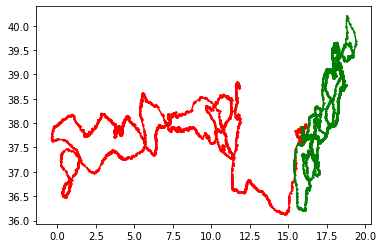

In [14]:
# see dfs of No gps data
displayNoGpsDf(turtlesData)

# get name for each No gps DF turtleData
createNoGpsDfCsvNameForEachInstance(turtlesData)

# SAVE THE NO GPS DATAFRAME in the Results Folder
checkIfNoGpsDfHasBeenSaved(turtlesData)

# build dfs of all gps
getAllGpsDataframes(turtlesData)

# see dfs of all gps
displayAllGpsDf(turtlesData)

# get name for each ALL GPS DF turtleData
createAllGpsDfCsvNameForEachInstance(turtlesData)

# SAVE THE ALL GPS DATAFRAME in the Results Folder
checkIfAllGpsDfHasBeenSaved(turtlesData)

assignTagDayDatetimeToEachInstance(turtlesData)

# deleting duplicate rows and 2019 date
getAllCleanedGpsDataframes(turtlesData)

# get name for each ALL CLEANED GPS DF turtleData
createAllCleanedGpsDfCsvNameForEachInstance(turtlesData)

# SAVE THE ALL CLEANED GPS DATAFRAME in the Results Folder
checkIfAllCleanedGpsDfHasBeenSaved(turtlesData)

# Assign the CRS data
giveCoordinateReferenceSystemCrs(turtlesData)

# see dfs of reliable gps and no reliable gps (Remove GPS Errors by Angular velocity/Rotational speed)
getReliableAndNoReliableGpsDataframes(turtlesData)

# get name for each RELIABLE GPS DF turtleData
createReliableGpsDfCsvNameForEachInstance(turtlesData)

# SAVE THE RELIABLE GPS DATAFRAME in the Results Folder
checkIfReliableGpsDfHasBeenSaved(turtlesData)

# get name for each NO RELIABLE GPS DF turtleData
createNoReliableGpsDfCsvNameForEachInstance(turtlesData)

# SAVE THE NO RELIABLE GPS DATAFRAME in the Results Folder    
checkIfNoReliableGpsDfHasBeenSaved(turtlesData)

# then initiate with the depth data
getRemainingDataDataframes(turtlesData)

# get name for each Remaining Data DF turtleData
createRemainingDataDfCsvNameForEachInstance(turtlesData)

# SAVE THE REMAINING DATA DATAFRAME in the Results Folder 
checkIfRemainingDataDfHasBeenSaved(turtlesData)

# build dfs for Depth Data
getDepthDataDataframes(turtlesData)

# get name for each Depth Data DF turtleData
createdepthDataDfCsvNameForEachInstance(turtlesData)

# SAVE THE DEPTH DATA DATAFRAME in the Results Folder 
checkIfdepthDataDfHasBeenSaved(turtlesData)

#
# get plotlyLines from reliable gps
### USE WITH JUPYTER NOTEBOOK
#getLines(turtlesData) # just to see the map without projection

# get plotlyLines from reliable gps with map projection
### USE WITH JUPYTER NOTEBOOK
getProjLines(turtlesData)

# see the CRS
askCrs(turtlesData)

#just to see if the append arrays of the Gps data inside the empty object works
#askGpsArray(turtlesData) 

In [15]:
depthPointsFromAcquisitionTime(turtlesData)

---------------------END------------------------
CICLO 1
2020.07.10 01:30:00
2020.07.10 02:00:00
2020.07.10 03:30:00
2020.07.10 05:00:00
2020.07.10 05:30:00
2020.07.10 06:00:00
2020.07.10 07:30:00
2020.07.10 08:00:00
2020.07.10 09:30:00
2020.07.10 10:30:00
2020.07.10 11:30:00
2020.07.10 12:00:00
2020.07.10 12:00:00
2020.07.10 14:00:00
2020.07.10 15:30:00
2020.07.10 16:00:00
2020.07.10 17:30:00
2020.07.10 18:00:00
2020.07.10 19:30:00
2020.07.10 20:00:00
2020.07.10 21:00:00
2020.07.10 22:00:00
2020.07.10 23:30:00
2020.07.11 00:00:00
2020.07.11 01:30:00
2020.07.11 02:30:00
2020.07.11 03:00:00
2020.07.11 04:00:00
2020.07.11 04:00:00
2020.07.11 11:00:00
2020.07.11 04:00:00
2020.07.11 11:00:00
2020.07.11 04:00:00
2020.07.11 11:00:00
2020.07.11 11:30:00
2020.07.11 17:30:00
2020.07.11 11:30:00
2020.07.11 17:30:00
2020.07.11 11:30:00
2020.07.11 17:30:00
2020.07.11 17:30:00
2020.07.11 18:30:00
2020.07.11 19:30:00
2020.07.11 20:00:00
2020.07.11 21:30:00
2020.07.11 23:00:00
2020.07.11 23:30:00
202

2020.08.24 08:00:00
2020.08.24 16:00:00
2020.08.24 08:00:00
2020.08.24 16:00:00
2020.08.24 08:00:00
2020.08.24 16:00:00
2020.08.24 08:00:00
2020.08.24 16:00:00
2020.08.24 17:00:00
2020.08.24 18:00:00
2020.08.24 18:00:00
2020.08.24 23:00:00
2020.08.24 18:00:00
2020.08.24 23:00:00
2020.08.24 23:00:00
2020.08.25 00:00:00
2020.08.25 00:00:00
2020.08.25 03:00:00
2020.08.25 03:00:00
2020.08.25 05:00:00
2020.08.25 05:00:00
2020.08.25 11:00:00
2020.08.25 05:00:00
2020.08.25 11:00:00
2020.08.25 05:00:00
2020.08.25 11:00:00
2020.08.25 11:00:00
2020.08.25 12:00:00
2020.08.25 12:00:00
2020.08.25 16:00:00
2020.08.25 12:00:00
2020.08.25 16:00:00
2020.08.25 16:00:00
2020.08.25 18:00:00
2020.08.25 18:00:00
2020.08.26 03:00:00
2020.08.25 18:00:00
2020.08.26 03:00:00
2020.08.25 18:00:00
2020.08.26 03:00:00
2020.08.25 18:00:00
2020.08.26 03:00:00
2020.08.26 03:00:00
2020.08.26 05:00:00
2020.08.26 05:00:00
2020.08.26 06:00:00
2020.08.26 07:00:00
2020.08.26 08:00:00
2020.08.26 08:00:00
2020.08.26 13:00:00


2020.10.09 18:00:00
2020.10.09 19:00:00
2020.10.09 20:00:00
2020.10.09 20:00:00
2020.10.09 22:00:00
2020.10.09 22:00:00
2020.10.10 00:00:00
2020.10.10 01:00:00
2020.10.10 02:00:00
2020.10.10 02:00:00
2020.10.10 04:00:00
2020.10.10 05:00:00
2020.10.10 06:00:00
2020.10.10 07:00:00
2020.10.10 08:00:00
2020.10.10 09:00:00
2020.10.10 10:00:00
2020.10.10 11:00:00
2020.10.10 13:00:00
2020.10.10 13:00:00
2020.10.10 15:00:00
2020.10.10 15:00:00
2020.10.10 16:00:00
2020.10.10 17:00:00
2020.10.10 18:00:00
2020.10.10 18:00:00
2020.10.10 21:00:00
2020.10.10 21:00:00
2020.10.11 01:00:00
2020.10.10 21:00:00
2020.10.11 01:00:00
2020.10.11 01:00:00
2020.10.11 02:00:00
2020.10.11 03:00:00
2020.10.11 04:00:00
2020.10.11 04:00:00
2020.10.11 06:00:00
2020.10.11 07:00:00
2020.10.11 08:00:00
2020.10.11 08:00:00
2020.10.11 10:00:00
2020.10.11 11:00:00
2020.10.11 12:00:00
2020.10.11 13:00:00
2020.10.11 15:00:00
2020.10.11 15:00:00
2020.10.11 16:00:00
2020.10.11 17:00:00
2020.10.11 19:00:00
2020.10.11 19:00:00


2020.11.24 07:00:00
2020.11.24 09:00:00
2020.11.24 09:00:00
2020.11.24 11:00:00
2020.11.24 11:00:00
2020.11.24 13:00:00
2020.11.24 13:00:00
2020.11.24 14:00:00
2020.11.24 15:00:00
2020.11.24 16:00:00
2020.11.24 16:00:00
2020.11.24 19:00:00
2020.11.24 19:00:00
2020.11.24 20:00:00
2020.11.24 20:00:00
2020.11.25 04:00:00
2020.11.24 20:00:00
2020.11.25 04:00:00
2020.11.24 20:00:00
2020.11.25 04:00:00
2020.11.24 20:00:00
2020.11.25 04:00:00
2020.11.25 04:00:00
2020.11.25 07:00:00
2020.11.25 07:00:00
2020.11.25 08:00:00
2020.11.25 08:00:00
2020.11.25 10:00:00
2020.11.25 10:00:00
2020.11.25 12:00:00
2020.11.25 13:00:00
2020.11.25 14:00:00
2020.11.25 15:00:00
2020.11.25 16:00:00
2020.11.25 16:00:00
2020.11.25 18:00:00
2020.11.25 19:00:00
2020.11.25 22:00:00
2020.11.25 19:00:00
2020.11.25 22:00:00
2020.11.25 22:00:00
2020.11.26 01:00:00
2020.11.26 01:00:00
2020.11.26 02:00:00
2020.11.26 03:00:00
2020.11.26 04:00:00
2020.11.26 04:00:00
2020.11.26 06:00:00
2020.11.26 06:00:00
2020.11.26 08:00:00


2021.01.11 21:00:00
2021.01.11 21:00:00
2021.01.12 00:00:00
2021.01.11 21:00:00
2021.01.12 00:00:00
2021.01.12 01:00:00
2021.01.12 04:00:00
2021.01.12 01:00:00
2021.01.12 04:00:00
2021.01.12 04:00:00
2021.01.12 07:00:00
2021.01.12 07:00:00
2021.01.12 10:00:00
2021.01.12 07:00:00
2021.01.12 10:00:00
2021.01.12 11:00:00
2021.01.12 15:00:00
2021.01.12 11:00:00
2021.01.12 15:00:00
2021.01.12 15:00:00
2021.01.12 18:00:00
2021.01.12 15:00:00
2021.01.12 18:00:00
2021.01.12 18:00:00
2021.01.12 22:00:00
2021.01.12 18:00:00
2021.01.12 22:00:00
2021.01.12 22:00:00
2021.01.13 01:00:00
2021.01.13 01:00:00
2021.01.13 05:00:00
2021.01.13 01:00:00
2021.01.13 05:00:00
2021.01.13 05:00:00
2021.01.13 06:00:00
2021.01.13 06:00:00
2021.01.13 10:00:00
2021.01.13 06:00:00
2021.01.13 10:00:00
2021.01.13 10:00:00
2021.01.13 17:00:00
2021.01.13 10:00:00
2021.01.13 17:00:00
2021.01.13 10:00:00
2021.01.13 17:00:00
2021.01.13 17:00:00
2021.01.13 22:00:00
2021.01.13 17:00:00
2021.01.13 22:00:00
2021.01.13 17:00:00


2020.08.24 04:30:00
2020.08.24 05:30:00
2020.08.24 06:00:00
2020.08.24 07:30:00
2020.08.24 08:00:00
2020.08.24 09:30:00
2020.08.24 10:00:00
2020.08.24 11:30:00
2020.08.24 12:00:00
2020.08.24 13:30:00
2020.08.24 14:00:00
2020.08.24 15:30:00
2020.08.24 16:00:00
2020.08.24 17:30:00
2020.08.24 18:30:00
2020.08.24 19:30:00
2020.08.24 20:30:00
2020.08.24 20:30:00
2020.08.24 22:30:00
2020.08.24 23:30:00
2020.08.25 01:30:00
2020.08.25 01:30:00
2020.08.25 02:00:00
2020.08.25 03:30:00
2020.08.25 04:00:00
2020.08.25 05:30:00
2020.08.25 06:00:00
2020.08.25 07:30:00
2020.08.25 08:00:00
2020.08.25 09:30:00
2020.08.25 10:30:00
2020.08.25 11:30:00
2020.08.25 12:00:00
2020.08.25 13:30:00
2020.08.25 14:00:00
2020.08.25 15:30:00
2020.08.25 16:00:00
2020.08.25 17:30:00
2020.08.25 18:30:00
2020.08.25 19:30:00
2020.08.25 20:30:00
2020.08.25 21:30:00
2020.08.25 22:00:00
2020.08.25 23:30:00
2020.08.26 00:00:00
2020.08.26 01:30:00
2020.08.26 02:00:00
2020.08.26 03:30:00
2020.08.26 04:00:00
2020.08.26 05:30:00


2020.10.12 00:00:00
2020.10.11 12:00:00
2020.10.12 00:00:00
2020.10.11 12:00:00
2020.10.12 00:00:00
2020.10.11 12:00:00
2020.10.12 00:00:00
2020.10.11 12:00:00
2020.10.12 00:00:00
2020.10.12 00:00:00
2020.10.12 06:00:00
2020.10.12 00:00:00
2020.10.12 06:00:00
2020.10.12 00:00:00
2020.10.12 06:00:00
2020.10.12 06:00:00
2020.10.12 12:00:00
2020.10.12 06:00:00
2020.10.12 12:00:00
2020.10.12 06:00:00
2020.10.12 12:00:00
2020.10.12 12:00:00
2020.10.12 18:00:00
2020.10.12 12:00:00
2020.10.12 18:00:00
2020.10.12 12:00:00
2020.10.12 18:00:00
2020.10.12 18:00:00
2020.10.13 06:00:00
2020.10.12 18:00:00
2020.10.13 06:00:00
2020.10.12 18:00:00
2020.10.13 06:00:00
2020.10.12 18:00:00
2020.10.13 06:00:00
2020.10.12 18:00:00
2020.10.13 06:00:00
2020.10.12 18:00:00
2020.10.13 06:00:00
2020.10.13 06:00:00
2020.10.13 12:00:00
2020.10.13 06:00:00
2020.10.13 12:00:00
2020.10.13 06:00:00
2020.10.13 12:00:00
2020.10.13 12:00:00
2020.10.13 18:00:00
2020.10.13 12:00:00
2020.10.13 18:00:00
2020.10.13 12:00:00


2020.12.05 08:00:00
2020.12.05 11:00:00
2020.12.05 11:00:00
2020.12.05 12:00:00
2020.12.05 13:00:00
2020.12.05 17:00:00
2020.12.05 13:00:00
2020.12.05 17:00:00
2020.12.05 17:00:00
2020.12.05 18:00:00
2020.12.05 18:00:00
2020.12.05 20:00:00
2020.12.05 21:00:00
2020.12.05 22:00:00
2020.12.05 23:00:00
2020.12.06 00:00:00
2020.12.06 01:00:00
2020.12.06 02:00:00
2020.12.06 03:00:00
2020.12.06 04:00:00
2020.12.06 05:00:00
2020.12.06 09:00:00
2020.12.06 05:00:00
2020.12.06 09:00:00
2020.12.06 09:00:00
2020.12.06 10:00:00
2020.12.06 10:00:00
2020.12.06 12:00:00
2020.12.06 13:00:00
2020.12.06 14:00:00
2020.12.06 14:00:00
2020.12.06 18:00:00
2020.12.06 14:00:00
2020.12.06 18:00:00
2020.12.06 18:00:00
2020.12.06 20:00:00
2020.12.06 20:00:00
2020.12.06 22:00:00
2020.12.06 22:00:00
2020.12.07 01:00:00
2020.12.07 01:00:00
2020.12.07 04:00:00
2020.12.07 01:00:00
2020.12.07 04:00:00
2020.12.07 04:00:00
2020.12.07 06:00:00
2020.12.07 07:00:00
2020.12.07 08:00:00
2020.12.07 09:00:00
2020.12.07 11:00:00


2021.01.28 00:00:00
2021.01.28 05:00:00
2021.01.28 00:00:00
2021.01.28 05:00:00
2021.01.28 05:00:00
2021.01.28 10:00:00
2021.01.28 05:00:00
2021.01.28 10:00:00
2021.01.28 05:00:00
2021.01.28 10:00:00
2021.01.28 10:00:00
2021.01.28 14:00:00
2021.01.28 10:00:00
2021.01.28 14:00:00
2021.01.28 14:00:00
2021.01.28 19:00:00
2021.01.28 14:00:00
2021.01.28 19:00:00
2021.01.28 19:00:00
2021.01.28 20:00:00
2021.01.28 20:00:00
2021.01.28 23:00:00
2021.01.28 23:00:00
2021.01.29 04:00:00
2021.01.28 23:00:00
2021.01.29 04:00:00
2021.01.28 23:00:00
2021.01.29 04:00:00
2021.01.29 05:00:00
2021.01.29 06:00:00
2021.01.29 07:00:00
2021.01.29 09:00:00
2021.01.29 09:00:00
2021.01.29 14:00:00
2021.01.29 09:00:00
2021.01.29 14:00:00
2021.01.29 09:00:00
2021.01.29 14:00:00
2021.01.29 14:00:00
2021.01.29 20:00:00
2021.01.29 14:00:00
2021.01.29 20:00:00
2021.01.29 14:00:00
2021.01.29 20:00:00
2021.01.29 20:00:00
2021.01.29 22:00:00
2021.01.29 23:00:00
2021.01.30 01:00:00
2021.01.30 01:00:00
2021.01.30 05:00:00


In [16]:
getDepthDataDataframesWithApproxCoordinates(turtlesData)

Depth Df with Approx Coord Columns with String values
      Depth Data ID  No GPS Data ID     Acquisition Time  \
0                 1              47  2020.07.10 02:00:00   
1                 2              49  2020.07.10 04:00:00   
2                 3              53  2020.07.10 06:00:00   
3                 4              55  2020.07.10 08:00:00   
4                 5              57  2020.07.10 10:00:00   
...             ...             ...                  ...   
2587           2588            4870  2021.02.11 00:00:00   
2588           2589            4871  2021.02.11 02:00:00   
2589           2590            4873  2021.02.11 04:00:00   
2590           2591            4874  2021.02.11 06:00:00   
2591           2592            4875  2021.02.11 08:00:00   

     Acquisition Start Time Underwater Percentage  Dive Count  \
0       2020.07.10 00:00:00                7.422%        12.0   
1       2020.07.10 02:00:00               74.609%        55.0   
2       2020.07.10 04:00:00   

      Depth Data ID  No GPS Data ID     Acquisition Time  \
0                 1              60  2020.08.12 04:00:00   
1                 2              61  2020.08.12 06:00:00   
2                 3              62  2020.08.12 08:00:00   
3                 4              64  2020.08.12 10:00:00   
4                 5              67  2020.08.12 12:00:00   
...             ...             ...                  ...   
2182           2183            3084  2021.02.10 22:00:00   
2183           2184            3086  2021.02.11 00:00:00   
2184           2185            3088  2021.02.11 02:00:00   
2185           2186            3089  2021.02.11 04:00:00   
2186           2187            3090  2021.02.11 06:00:00   

     Acquisition Start Time Underwater Percentage  Dive Count  \
0       2020.08.12 02:00:00               91.016%        23.0   
1       2020.08.12 04:00:00               98.828%        71.0   
2       2020.08.12 06:00:00               93.359%        17.0   
3       2020.08.12 

In [17]:
createdepthDataDfWithCoordCsvNameForEachInstance(turtlesData)

checkIfdepthDataDfWithCoordHasBeenSaved(turtlesData)

The Last Entry in the Dataframe for 710333a is from: 
2021_Feb
The Name for the depthDataDfWithApproxCoord CSV for the turtleData 710333a is: 
depthDataDfWithApproxCoord_floatValues_Tag_710333a_2021_Feb.csv
--------------
The Last Entry in the Dataframe for 710348a is from: 
2021_Feb
The Name for the depthDataDfWithApproxCoord CSV for the turtleData 710348a is: 
depthDataDfWithApproxCoord_floatValues_Tag_710348a_2021_Feb.csv
--------------
['.~lock.depthDataWithApprxCoordDfWithSkyIllumination_Tag_710333a_2021_Feb.csv#', '.~lock.reliableGpsDfWithSkyIllumination_Tag_710333a_2021_Feb.csv#', '.~lock.reliableGpsDfWithSkyIllumination_Tag_710348a_2021_Feb.csv#', '1_percentage_of_gps_data_across_qfp_position_categories__bar_chart.png', '2_percentage_of_gps_data_across_qfp_position_categories__bar_chart.png', 'allCleanedGpsDf_Tag_710333a_2021_Feb.csv', 'allCleanedGpsDf_Tag_710348a_2021_Feb.csv', 'allGpsDf_Tag_710333a_2021_Feb.csv', 'allGpsDf_Tag_710348a_2021_Feb.csv', 'depthDataDfWithApproxCoor

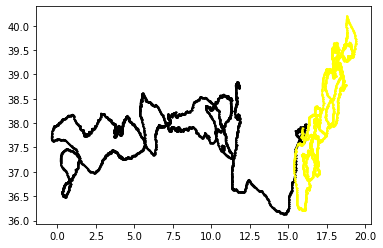

In [18]:
# get plotlyLines from depth data with approx coord with map projection
### USE WITH JUPYTER NOTEBOOK
getProjDepthLines(turtlesData)

#just to see if the append arrays of the Depth data inside the empty object works
#askDepthArray(turtlesData) 

In [19]:
dTypes(turtlesData)

Reliable Speed ID                   int64
All GPS's Track ID                  int64
Acquisition Time                   object
Acquisition Start Time             object
GPS Fix Time                       object
GPS Fix Attempt                    object
GPS Latitude                      float64
GPS Longitude                     float64
Distance (m)                      float64
Time (s)                          float64
Speed m/s                         float64
Time (h)                  timedelta64[ns]
dtype: object
Depth Data ID                       int64
No GPS Data ID                      int64
Acquisition Time                   object
Acquisition Start Time             object
Underwater Percentage              object
Dive Count                        float64
Average Dive Duration             float64
Maximum Dive Duration             float64
Maximum Dive Depth                float64
Layer 1 Percentage                 object
Layer 2 Percentage                 object
Layer 3 Percentage  

In [20]:
getJson(turtlesData)  

- gps dataframe file name = reliableGpsDf_bySpeed_Tag_710333a_2021_Feb.csv
- gps json file name = reliableGpsDf_bySpeed_Tag_710333a_2021_Feb.json
['.~lock.depthDataWithApprxCoordDfWithSkyIllumination_Tag_710333a_2021_Feb.csv#', '.~lock.reliableGpsDfWithSkyIllumination_Tag_710333a_2021_Feb.csv#', '.~lock.reliableGpsDfWithSkyIllumination_Tag_710348a_2021_Feb.csv#', '1_percentage_of_gps_data_across_qfp_position_categories__bar_chart.png', '2_percentage_of_gps_data_across_qfp_position_categories__bar_chart.png', 'allCleanedGpsDf_Tag_710333a_2021_Feb.csv', 'allCleanedGpsDf_Tag_710348a_2021_Feb.csv', 'allGpsDf_Tag_710333a_2021_Feb.csv', 'allGpsDf_Tag_710348a_2021_Feb.csv', 'depthDataDfWithApproxCoord_floatValues_Tag_710333a_2021_Feb.csv', 'depthDataDfWithApproxCoord_floatValues_Tag_710333a_2021_Feb.json', 'depthDataDfWithApproxCoord_floatValues_Tag_710348a_2021_Feb.csv', 'depthDataDfWithApproxCoord_floatValues_Tag_710348a_2021_Feb.json', 'depthDataDfWithApproxCoord_Tag_710333a_2021_Feb.csv',

In [21]:
#print(jsonGpsData_tag_710333a)
#print(jsonGpsData_tag_710348a)
#print(jsonDepthData_tag_710333a)
#print(jsonDepthData_tag_710348a)

In [22]:
getAmountOfDataObtained(turtlesData)

Quantity of ALL Fix Categories for the 710333a
GPS Fix Attempt
Resolved QFP                2840
Resolved QFP (Uncertain)     180
Succeeded                      6
Unresolved QFP               222
Name: GPS Fix Attempt, dtype: int64
{'Resolved QFP': 2840, 'Resolved QFP (Uncertain)': 180, 'Succeeded': 6, 'Unresolved QFP': 222}--------------allSentFixCategoriesDict dict
^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
Quantity of filtered Fix Categories for the 710333a
GPS Fix Attempt
Resolved QFP                 8
Resolved QFP (Uncertain)     7
Unresolved QFP              18
Name: GPS Fix Attempt, dtype: int64
{'Resolved QFP': 8, 'Resolved QFP (Uncertain)': 7, 'Unresolved QFP': 18}--------------deletedFixCategoriesDict dict
^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
Quantity of remaining Fix Categories for the 710333a
GPS Fix Attempt
Resolved QFP                2832
Resolved QFP (Uncertain)     173
Succeeded                      6
Unresolved QFP               204
Name: GPS Fix Attempt, dtype: int64
{'Resolved QFP': 2832

_gps_positions_recorded_by_710333a_transmitter_tag_graph
['1_percentage_of_gps_data_across_qfp_position_categories__bar_chart.png', '2_percentage_of_gps_data_across_qfp_position_categories__bar_chart.png', '_gps_positions_recorded_by_710333a_transmitter_tag_graph.png', '_gps_positions_recorded_by_710348a_transmitter_tag_graph.png']
The Graph _gps_positions_recorded_by_710333a_transmitter_tag_graph has already been saved in the results folder
--------------
Text(0.5, 1.0, ' Percentage of GPS Data across QFP Position Categories \n- 710333a Transmitter Tag Data')
['1_percentage_of_gps_data_across_qfp_position_categories__bar_chart.png', '2_percentage_of_gps_data_across_qfp_position_categories__bar_chart.png', '_gps_positions_recorded_by_710333a_transmitter_tag_graph.png', '_gps_positions_recorded_by_710348a_transmitter_tag_graph.png']
The Graph 1_percentage_of_gps_data_across_qfp_position_categories__bar_chart has already been saved in the results folder
--------------
_gps_positions_reco

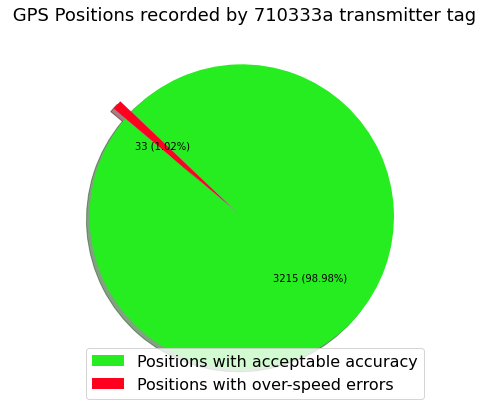

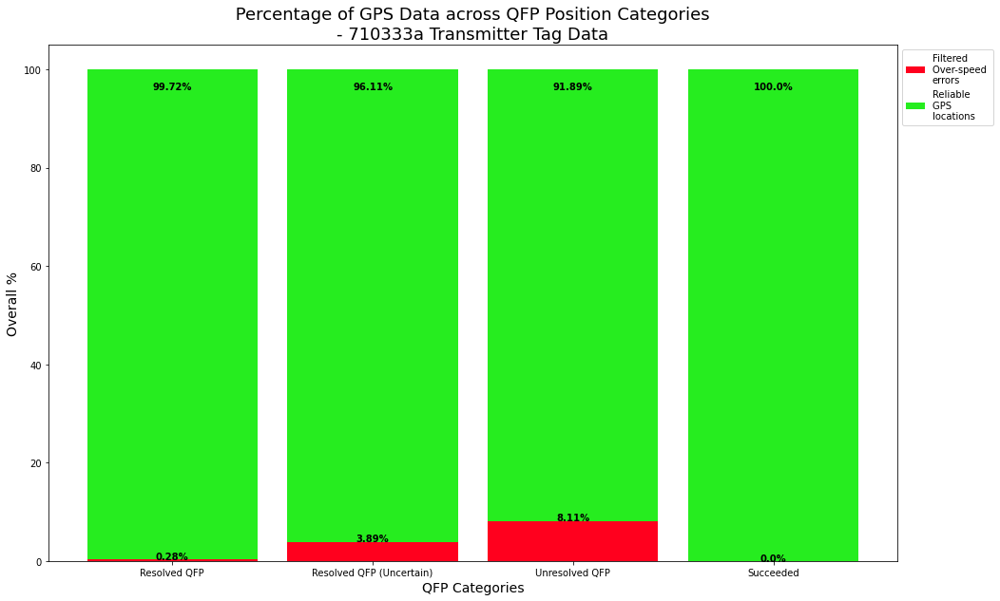

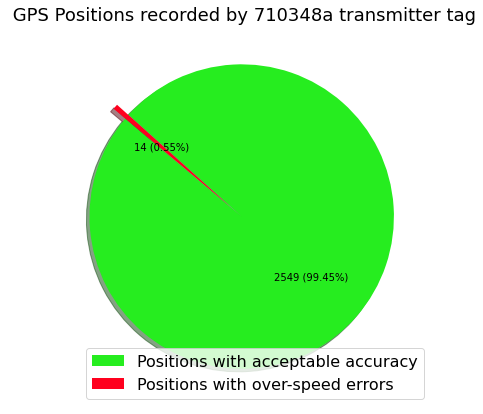

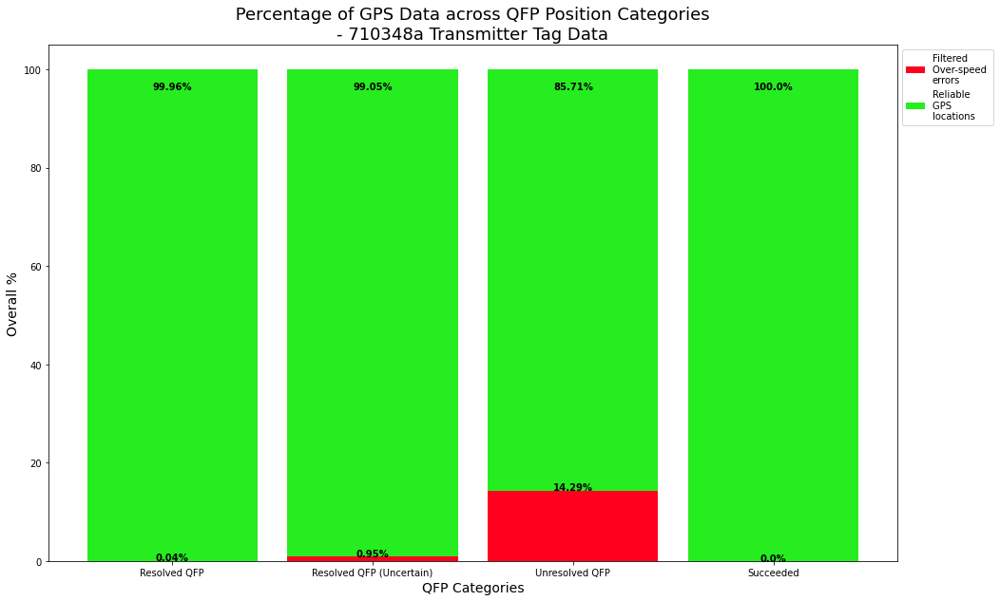

In [23]:
seeGraphs(turtlesData)

In [24]:
getDawnAndDuskTimesBasedOnCoordinates(turtlesData)

[False, False, False, False, False, False, False, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, False, False, False, False, False, False, False, False, False, False, False, False, False, False, True, True, True, True, True, True, False, False, False, False, False, False, False, False, False, False, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, False, False, False, False, False, False, False, False, False, False, False, False, False, False, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, False, False, False, False, True, True, True, True,

ENTER TO IF
[nan]
Assign the depthDataWithApprxCoordDfWithSkyIllumination Depth DF into self
      Depth Data ID  No GPS Data ID     Acquisition Time  \
0                 1              47  2020.07.10 02:00:00   
1                 2              49  2020.07.10 04:00:00   
2                 3              53  2020.07.10 06:00:00   
3                 4              55  2020.07.10 08:00:00   
4                 5              57  2020.07.10 10:00:00   
...             ...             ...                  ...   
2587           2588            4870  2021.02.11 00:00:00   
2588           2589            4871  2021.02.11 02:00:00   
2589           2590            4873  2021.02.11 04:00:00   
2590           2591            4874  2021.02.11 06:00:00   
2591           2592            4875  2021.02.11 08:00:00   

     Acquisition Start Time Underwater Percentage  Dive Count  \
0       2020.07.10 00:00:00                7.422%        12.0   
1       2020.07.10 02:00:00               74.609%       

Assign the depthDataWithApprxCoordDfWithSkyIllumination Depth DF into self
      Depth Data ID  No GPS Data ID     Acquisition Time  \
0                 1              60  2020.08.12 04:00:00   
1                 2              61  2020.08.12 06:00:00   
2                 3              62  2020.08.12 08:00:00   
3                 4              64  2020.08.12 10:00:00   
4                 5              67  2020.08.12 12:00:00   
...             ...             ...                  ...   
2182           2183            3084  2021.02.10 22:00:00   
2183           2184            3086  2021.02.11 00:00:00   
2184           2185            3088  2021.02.11 02:00:00   
2185           2186            3089  2021.02.11 04:00:00   
2186           2187            3090  2021.02.11 06:00:00   

     Acquisition Start Time Underwater Percentage  Dive Count  \
0       2020.08.12 02:00:00               91.016%        23.0   
1       2020.08.12 04:00:00               98.828%        71.0   
2       2

7 month
july nigth
0.0 july total distance at nigth
0 july total distance in day
7 month
july nigth
16.257208199638672 july total distance at nigth
0 july total distance in day
7 month
july nigth
176.68887484663497 july total distance at nigth
0 july total distance in day
7 month
july nigth
183.12659488012744 july total distance at nigth
0 july total distance in day
7 month
july nigth
190.42042859245728 july total distance at nigth
0 july total distance in day
7 month
july nigth
197.2229900084757 july total distance at nigth
0 july total distance in day
7 month
july nigth
722.2934256664122 july total distance at nigth
0 july total distance in day
7 month
july day
722.2934256664122 july total distance at nigth
515.5876887223952 july total distance in day
7 month
july day
722.2934256664122 july total distance at nigth
2460.541305748668 july total distance in day
7 month
july day
722.2934256664122 july total distance at nigth
2523.3782767475545 july total distance in day
7 month
july day


july day
83937.64897959495 july total distance at nigth
132964.11436874536 july total distance in day
7 month
july day
83937.64897959495 july total distance at nigth
135425.7652876766 july total distance in day
7 month
july day
83937.64897959495 july total distance at nigth
135566.6977105123 july total distance in day
7 month
july nigth
85081.40981968728 july total distance at nigth
135566.6977105123 july total distance in day
7 month
july nigth
85645.5123780448 july total distance at nigth
135566.6977105123 july total distance in day
7 month
july nigth
85971.9008741055 july total distance at nigth
135566.6977105123 july total distance in day
7 month
july nigth
85980.48405548792 july total distance at nigth
135566.6977105123 july total distance in day
7 month
july nigth
86041.26180641464 july total distance at nigth
135566.6977105123 july total distance in day
7 month
july nigth
86053.70082409127 july total distance at nigth
135566.6977105123 july total distance in day
7 month
july day

8 month
august day
51699.06660056234 august total distance at nigth
110758.79995265036 august total distance in day
8 month
august nigth
53204.77407966217 august total distance at nigth
110758.79995265036 august total distance in day
8 month
august nigth
57731.86216145332 august total distance at nigth
110758.79995265036 august total distance in day
8 month
august nigth
59814.52087992589 august total distance at nigth
110758.79995265036 august total distance in day
8 month
august nigth
62777.02640843473 august total distance at nigth
110758.79995265036 august total distance in day
8 month
august nigth
65146.72320533818 august total distance at nigth
110758.79995265036 august total distance in day
8 month
august nigth
67855.23945020024 august total distance at nigth
110758.79995265036 august total distance in day
8 month
august nigth
70486.71709196377 august total distance at nigth
110758.79995265036 august total distance in day
8 month
august nigth
71567.65618001172 august total distan

8 month
august day
224217.16956203774 august total distance at nigth
627943.8147923225 august total distance in day
8 month
august nigth
225761.66482834876 august total distance at nigth
627943.8147923225 august total distance in day
8 month
august nigth
228939.7842277017 august total distance at nigth
627943.8147923225 august total distance in day
8 month
august day
228939.7842277017 august total distance at nigth
630128.6307189481 august total distance in day
8 month
august day
228939.7842277017 august total distance at nigth
631419.6153810762 august total distance in day
8 month
august day
228939.7842277017 august total distance at nigth
633978.9674633828 august total distance in day
8 month
august day
228939.7842277017 august total distance at nigth
635462.2633641026 august total distance in day
8 month
august day
228939.7842277017 august total distance at nigth
640918.4350746956 august total distance in day
8 month
august day
228939.7842277017 august total distance at nigth
643362

9 month
september nigth
130901.68967071659 september total distance at nigth
247523.02787574788 september total distance in day
9 month
september nigth
132001.78085189752 september total distance at nigth
247523.02787574788 september total distance in day
9 month
september nigth
133366.2826769609 september total distance at nigth
247523.02787574788 september total distance in day
9 month
september day
133366.2826769609 september total distance at nigth
248329.20411675423 september total distance in day
9 month
september day
133366.2826769609 september total distance at nigth
251372.29500563603 september total distance in day
9 month
september day
133366.2826769609 september total distance at nigth
252545.02821559412 september total distance in day
9 month
september day
133366.2826769609 september total distance at nigth
254249.0346113279 september total distance in day
9 month
september day
133366.2826769609 september total distance at nigth
255523.80813253953 september total distance 

october nigth
141914.44673605537 october total distance at nigth
188325.85759900737 october total distance in day
10 month
october day
141914.44673605537 october total distance at nigth
188767.69581713577 october total distance in day
10 month
october day
141914.44673605537 october total distance at nigth
189617.9821517106 october total distance in day
10 month
october day
141914.44673605537 october total distance at nigth
189716.6305105279 october total distance in day
10 month
october day
141914.44673605537 october total distance at nigth
189985.82518909936 october total distance in day
10 month
october day
141914.44673605537 october total distance at nigth
191195.39153773093 october total distance in day
10 month
october day
141914.44673605537 october total distance at nigth
192708.0251679367 october total distance in day
10 month
october day
141914.44673605537 october total distance at nigth
195081.8355913497 october total distance in day
10 month
october day
141914.44673605537 oct

11 month
november nigth
54596.730814142546 november total distance at nigth
63420.25336026891 november total distance in day
11 month
november nigth
56727.20517257554 november total distance at nigth
63420.25336026891 november total distance in day
11 month
november nigth
57576.20801461756 november total distance at nigth
63420.25336026891 november total distance in day
11 month
november nigth
58378.956567987836 november total distance at nigth
63420.25336026891 november total distance in day
11 month
november nigth
59676.33739165333 november total distance at nigth
63420.25336026891 november total distance in day
11 month
november nigth
60451.38859809922 november total distance at nigth
63420.25336026891 november total distance in day
11 month
november nigth
61821.241097261096 november total distance at nigth
63420.25336026891 november total distance in day
11 month
november nigth
62834.941581222025 november total distance at nigth
63420.25336026891 november total distance in day
11 m

12 month
december nigth
93025.7801287178 december total distance at nigth
69884.54827113786 december total distance in day
12 month
december nigth
93763.37054367154 december total distance at nigth
69884.54827113786 december total distance in day
12 month
december nigth
94302.5057572723 december total distance at nigth
69884.54827113786 december total distance in day
12 month
december nigth
95004.51960164242 december total distance at nigth
69884.54827113786 december total distance in day
12 month
december nigth
95616.0555102817 december total distance at nigth
69884.54827113786 december total distance in day
12 month
december nigth
97245.28885806067 december total distance at nigth
69884.54827113786 december total distance in day
12 month
december nigth
98229.10993124153 december total distance at nigth
69884.54827113786 december total distance in day
12 month
december day
98229.10993124153 december total distance at nigth
70777.33025018759 december total distance in day
12 month
dece

292405.35983109 december total distance at nigth
289696.5139688683 december total distance in day
12 month
december nigth
293741.38688399934 december total distance at nigth
289696.5139688683 december total distance in day
12 month
december nigth
295069.98163323966 december total distance at nigth
289696.5139688683 december total distance in day
12 month
december nigth
299393.09888979956 december total distance at nigth
289696.5139688683 december total distance in day
12 month
december nigth
300674.1513170242 december total distance at nigth
289696.5139688683 december total distance in day
12 month
december nigth
301987.23483886034 december total distance at nigth
289696.5139688683 december total distance in day
12 month
december nigth
303237.77434171416 december total distance at nigth
289696.5139688683 december total distance in day
12 month
december day
303237.77434171416 december total distance at nigth
290910.26608932746 december total distance in day
12 month
december day
303237.

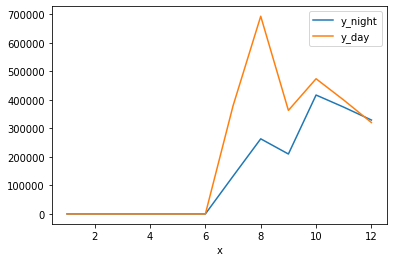

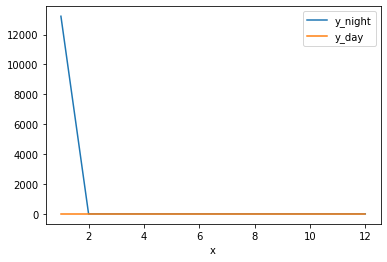

1 month
january nigth
16852.50713832412 january total distance at nigth
0 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
16852.50713832412
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
0
0
0
0
0
0
0
0
0
0
0
0


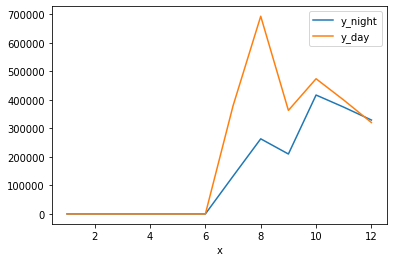

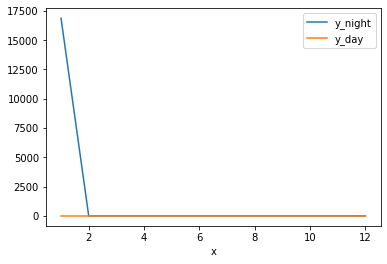

1 month
january day
16852.50713832412 january total distance at nigth
2612.572482800643 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
16852.50713832412
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
2612.572482800643
0
0
0
0
0
0
0
0
0
0
0


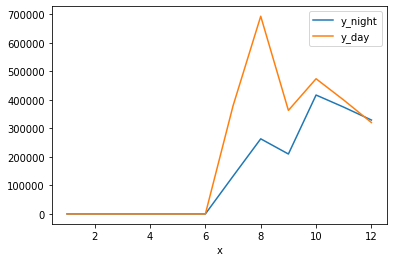

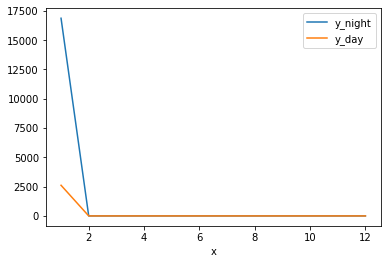

1 month
january day
16852.50713832412 january total distance at nigth
3007.8568636371747 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
16852.50713832412
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
3007.8568636371747
0
0
0
0
0
0
0
0
0
0
0


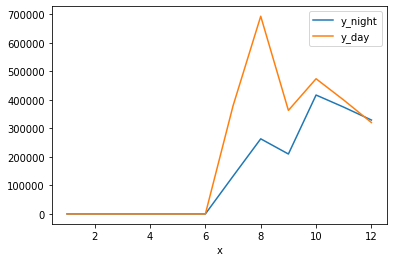

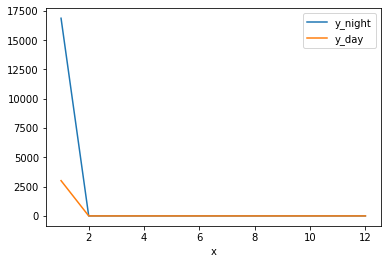

1 month
january day
16852.50713832412 january total distance at nigth
3192.609083695673 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
16852.50713832412
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
3192.609083695673
0
0
0
0
0
0
0
0
0
0
0


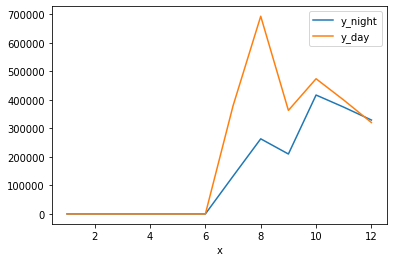

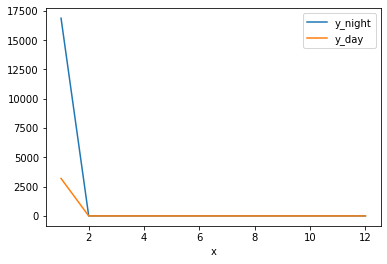

1 month
january day
16852.50713832412 january total distance at nigth
3319.585817778154 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
16852.50713832412
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
3319.585817778154
0
0
0
0
0
0
0
0
0
0
0


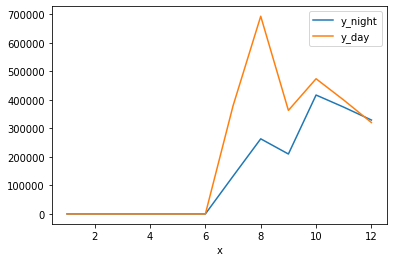

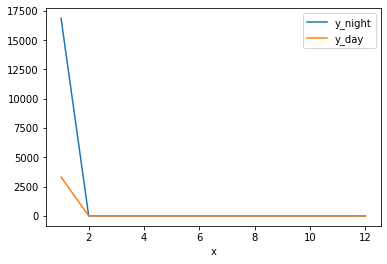

1 month
january day
16852.50713832412 january total distance at nigth
4603.147176951449 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
16852.50713832412
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
4603.147176951449
0
0
0
0
0
0
0
0
0
0
0


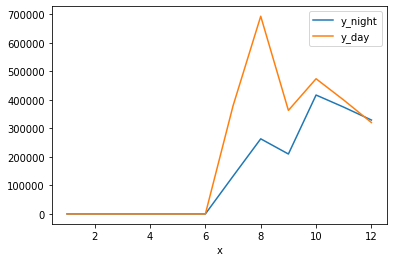

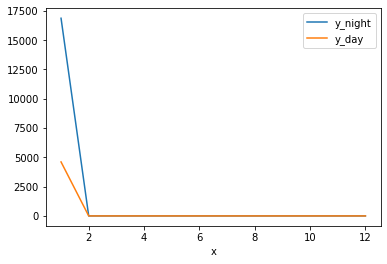

1 month
january day
16852.50713832412 january total distance at nigth
6897.102053488972 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
16852.50713832412
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
6897.102053488972
0
0
0
0
0
0
0
0
0
0
0


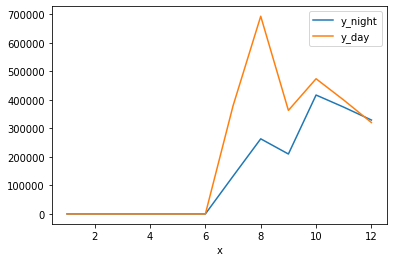

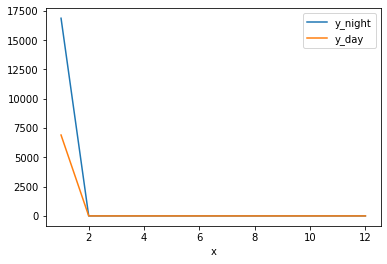

1 month
january day
16852.50713832412 january total distance at nigth
7726.940934021336 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
16852.50713832412
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
7726.940934021336
0
0
0
0
0
0
0
0
0
0
0


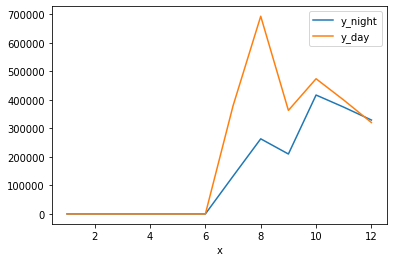

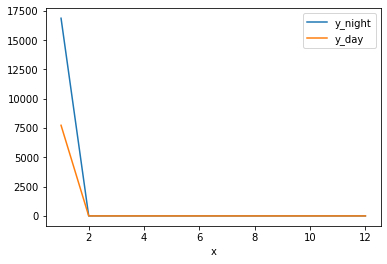

1 month
january nigth
25033.55979692706 january total distance at nigth
7726.940934021336 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
25033.55979692706
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
7726.940934021336
0
0
0
0
0
0
0
0
0
0
0


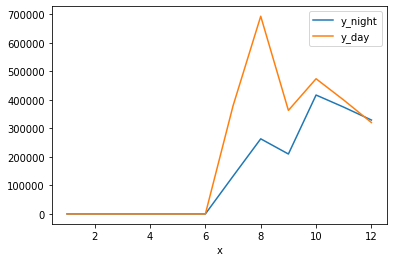

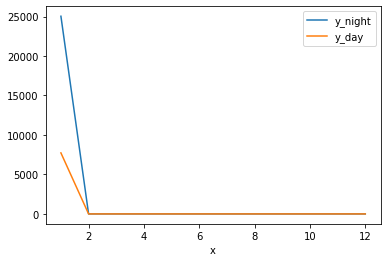

1 month
january nigth
28761.296299330654 january total distance at nigth
7726.940934021336 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
28761.296299330654
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
7726.940934021336
0
0
0
0
0
0
0
0
0
0
0


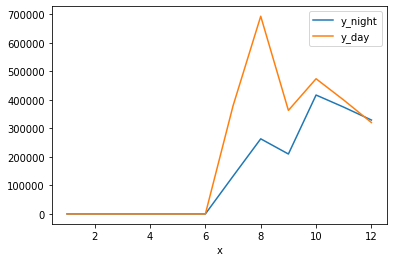

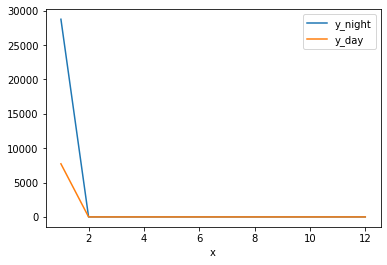

1 month
january nigth
30808.969211392927 january total distance at nigth
7726.940934021336 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
30808.969211392927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
7726.940934021336
0
0
0
0
0
0
0
0
0
0
0


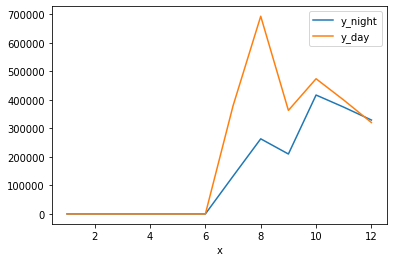

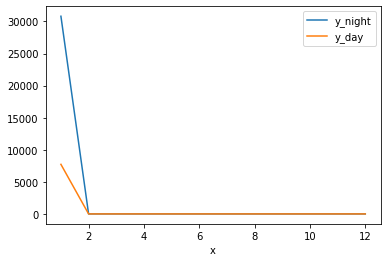

1 month
january nigth
32645.60545016236 january total distance at nigth
7726.940934021336 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
32645.60545016236
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
7726.940934021336
0
0
0
0
0
0
0
0
0
0
0


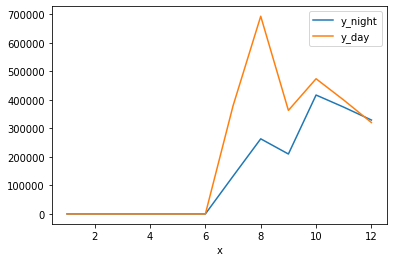

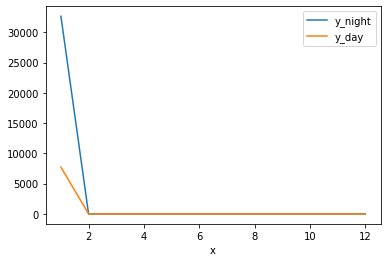

1 month
january nigth
34390.09858574874 january total distance at nigth
7726.940934021336 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
34390.09858574874
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
7726.940934021336
0
0
0
0
0
0
0
0
0
0
0


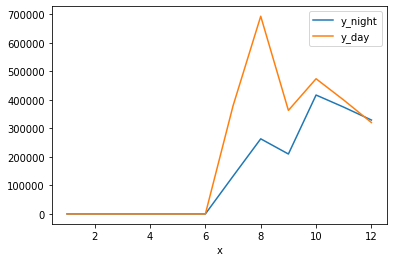

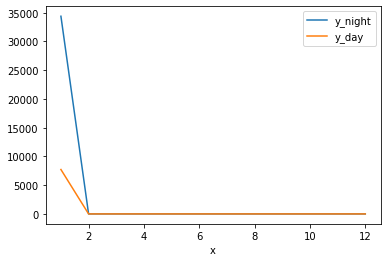

1 month
january nigth
36181.62832721901 january total distance at nigth
7726.940934021336 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
36181.62832721901
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
7726.940934021336
0
0
0
0
0
0
0
0
0
0
0


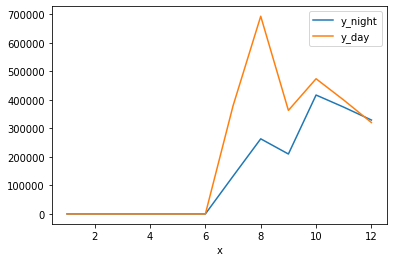

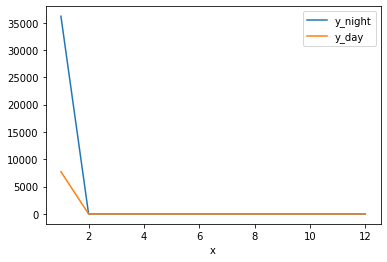

1 month
january nigth
37235.25135103386 january total distance at nigth
7726.940934021336 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
37235.25135103386
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
7726.940934021336
0
0
0
0
0
0
0
0
0
0
0


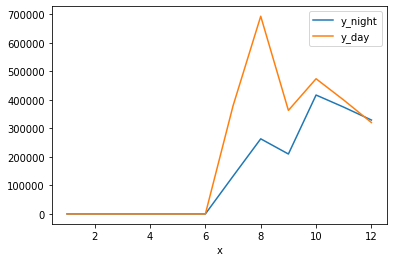

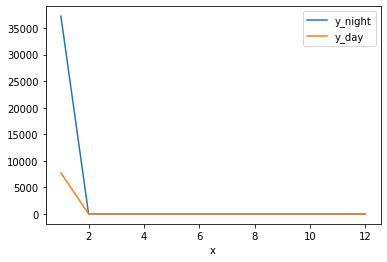

1 month
january nigth
38322.459337723776 january total distance at nigth
7726.940934021336 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
38322.459337723776
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
7726.940934021336
0
0
0
0
0
0
0
0
0
0
0


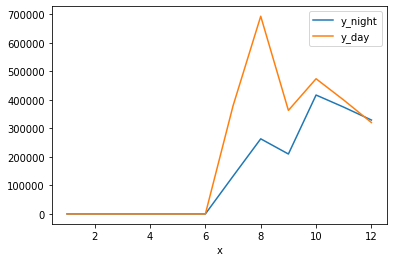

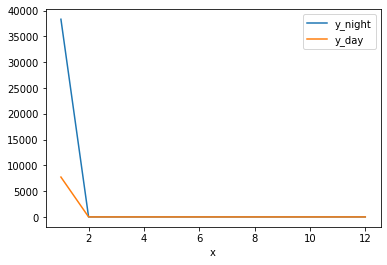

1 month
january day
38322.459337723776 january total distance at nigth
8875.185936336584 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
38322.459337723776
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
8875.185936336584
0
0
0
0
0
0
0
0
0
0
0


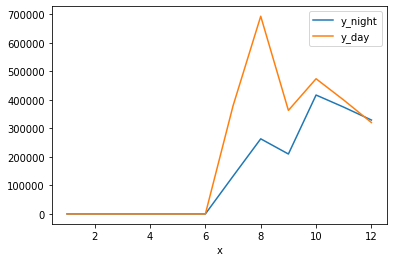

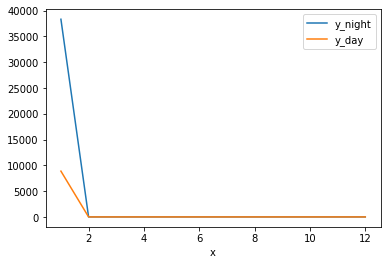

1 month
january day
38322.459337723776 january total distance at nigth
9993.040932245025 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
38322.459337723776
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
9993.040932245025
0
0
0
0
0
0
0
0
0
0
0


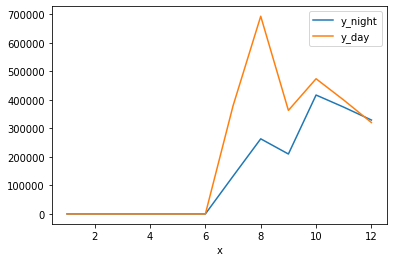

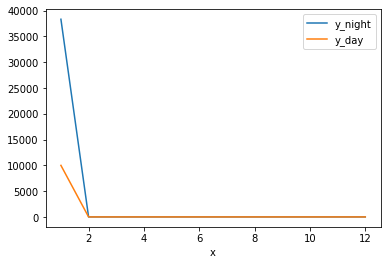

1 month
january day
38322.459337723776 january total distance at nigth
13857.835834104553 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
38322.459337723776
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
13857.835834104553
0
0
0
0
0
0
0
0
0
0
0


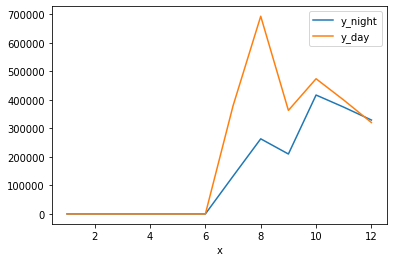

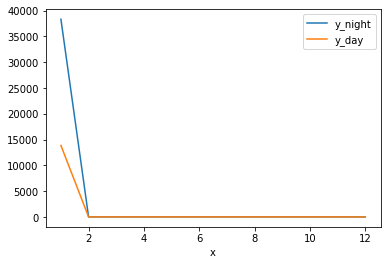

1 month
january day
38322.459337723776 january total distance at nigth
18547.894883037618 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
38322.459337723776
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
18547.894883037618
0
0
0
0
0
0
0
0
0
0
0


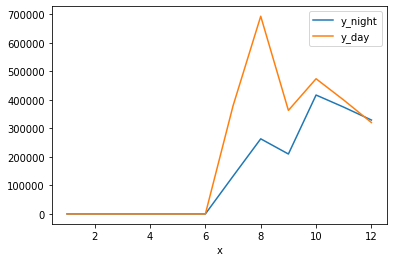

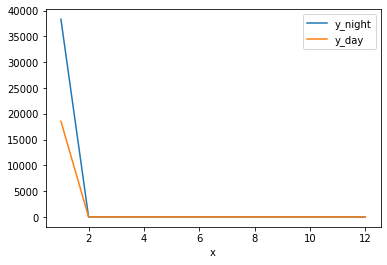

1 month
january day
38322.459337723776 january total distance at nigth
20327.4050911422 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
38322.459337723776
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
20327.4050911422
0
0
0
0
0
0
0
0
0
0
0


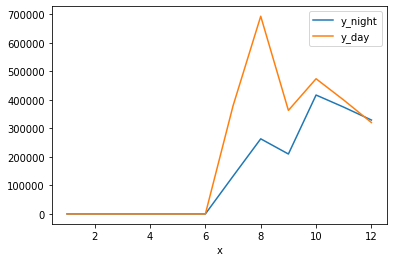

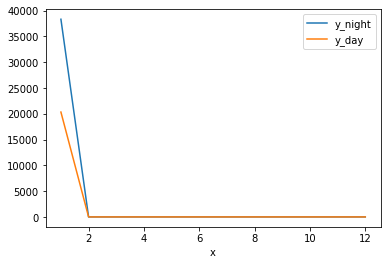

1 month
january day
38322.459337723776 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
38322.459337723776
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


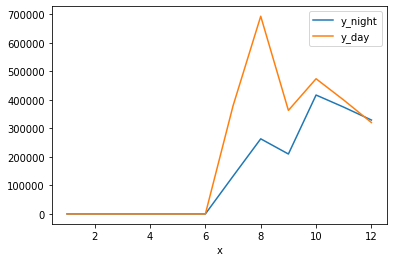

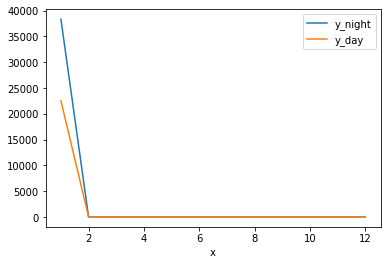

1 month
january nigth
45063.143375091946 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
45063.143375091946
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


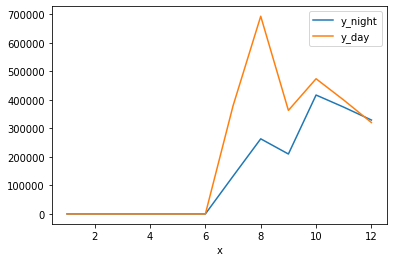

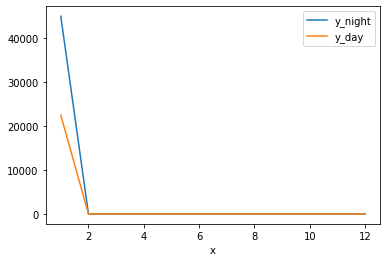

1 month
january nigth
47500.082139637474 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
47500.082139637474
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


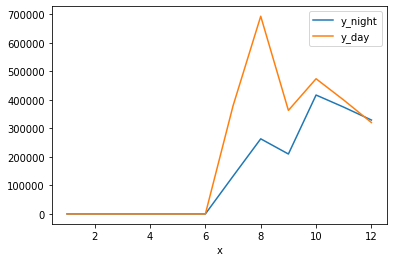

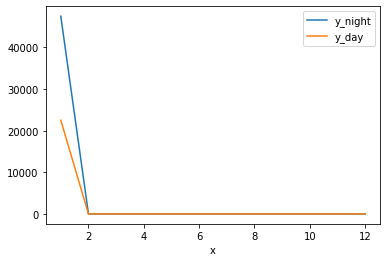

1 month
january nigth
50366.498833859274 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
50366.498833859274
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


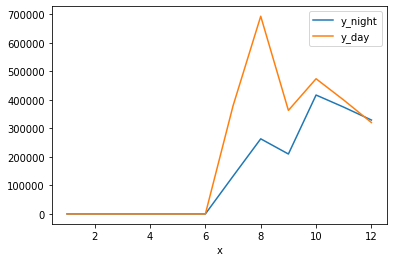

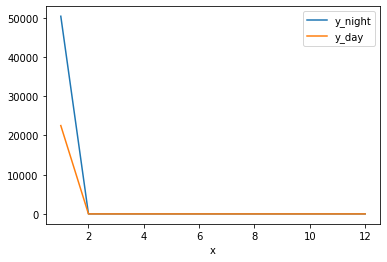

1 month
january nigth
53420.87067680049 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
53420.87067680049
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


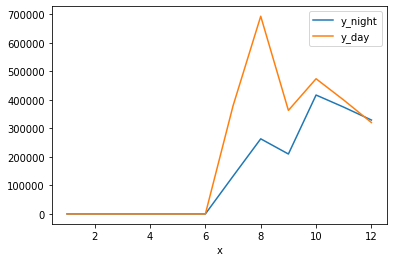

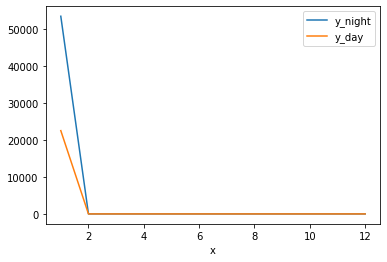

1 month
january nigth
57036.552253356094 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
57036.552253356094
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


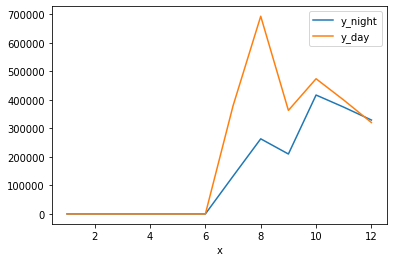

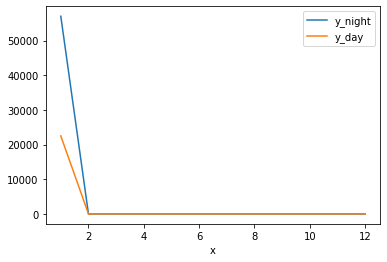

1 month
january nigth
60641.38174011999 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
60641.38174011999
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


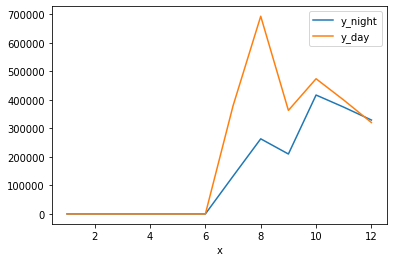

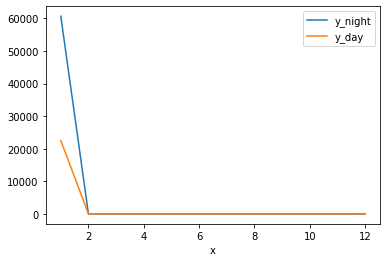

1 month
january nigth
62499.11208151575 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
62499.11208151575
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


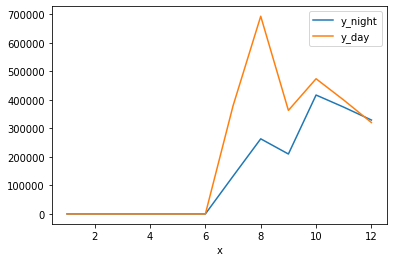

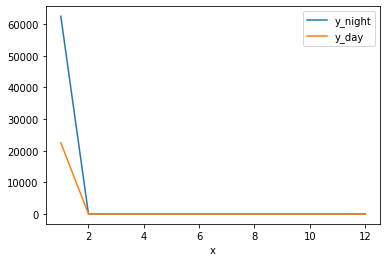

1 month
january nigth
65757.3141583153 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
65757.3141583153
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


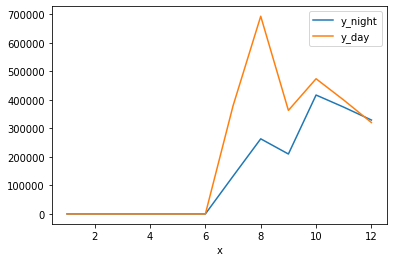

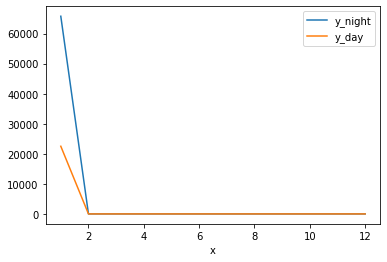

1 month
january nigth
69026.1095391303 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
69026.1095391303
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


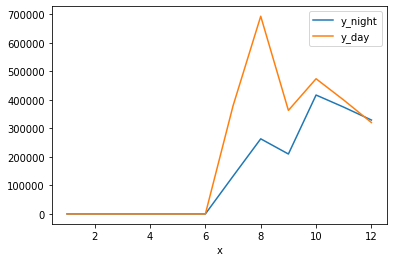

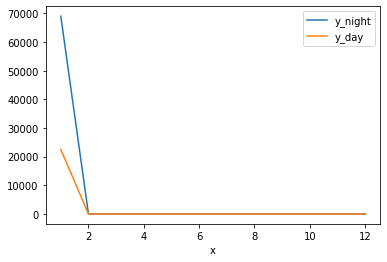

1 month
january nigth
70264.3348270181 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
70264.3348270181
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


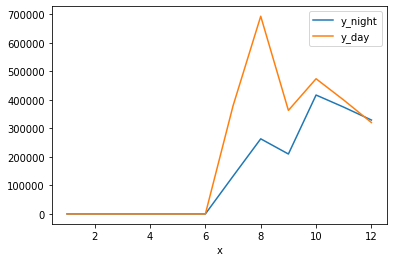

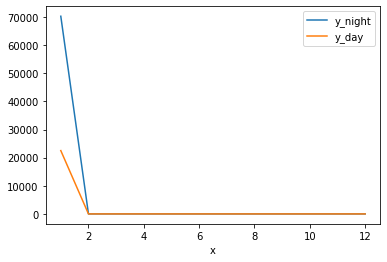

1 month
january nigth
75285.67525619059 january total distance at nigth
22508.414721087185 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
75285.67525619059
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
22508.414721087185
0
0
0
0
0
0
0
0
0
0
0


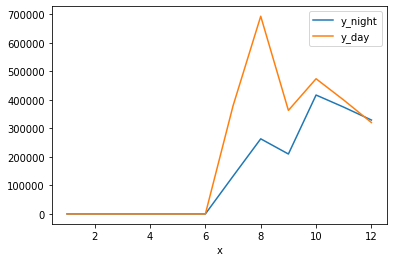

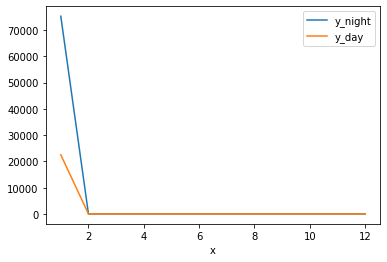

1 month
january day
75285.67525619059 january total distance at nigth
27337.063797572242 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
75285.67525619059
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
27337.063797572242
0
0
0
0
0
0
0
0
0
0
0


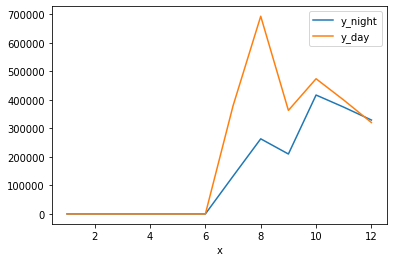

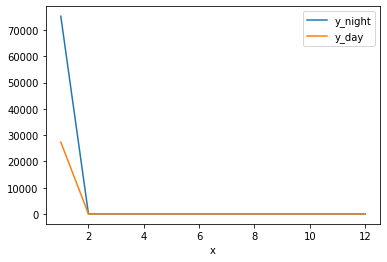

1 month
january day
75285.67525619059 january total distance at nigth
29094.44899924004 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
75285.67525619059
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
29094.44899924004
0
0
0
0
0
0
0
0
0
0
0


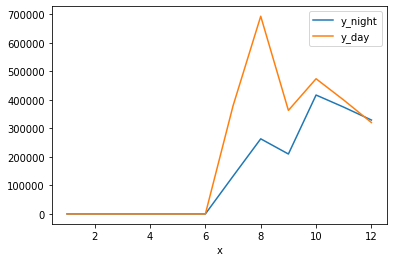

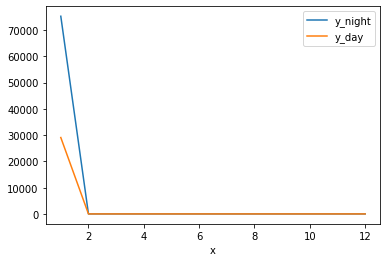

1 month
january day
75285.67525619059 january total distance at nigth
33596.090794751464 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
75285.67525619059
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
33596.090794751464
0
0
0
0
0
0
0
0
0
0
0


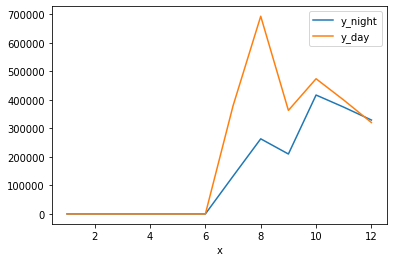

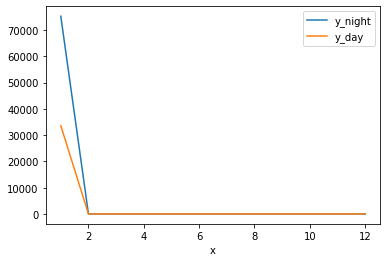

1 month
january day
75285.67525619059 january total distance at nigth
35013.5178014924 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
75285.67525619059
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
35013.5178014924
0
0
0
0
0
0
0
0
0
0
0


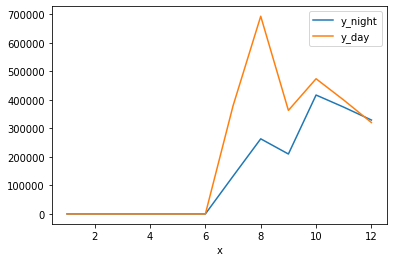

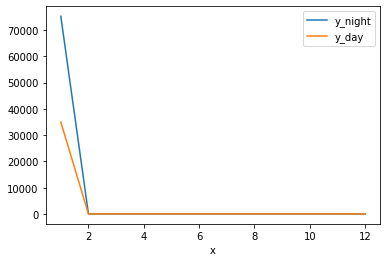

1 month
january day
75285.67525619059 january total distance at nigth
39507.29530925306 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
75285.67525619059
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
39507.29530925306
0
0
0
0
0
0
0
0
0
0
0


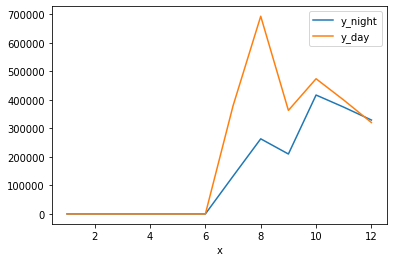

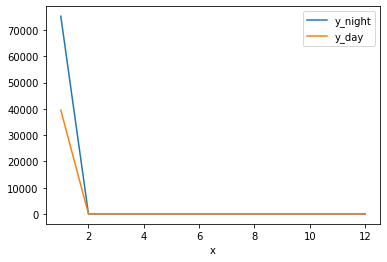

1 month
january day
75285.67525619059 january total distance at nigth
43038.802380275745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
75285.67525619059
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43038.802380275745
0
0
0
0
0
0
0
0
0
0
0


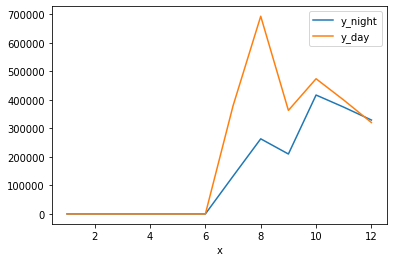

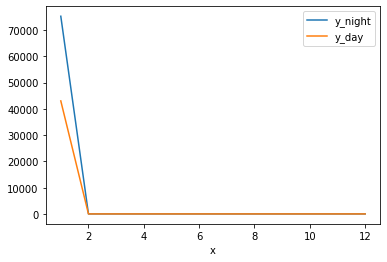

1 month
january nigth
76652.41656792499 january total distance at nigth
43038.802380275745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
76652.41656792499
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43038.802380275745
0
0
0
0
0
0
0
0
0
0
0


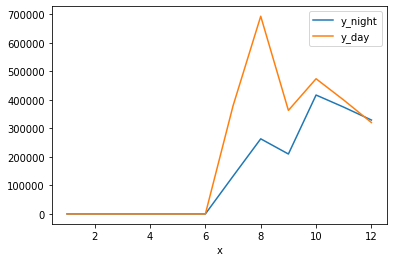

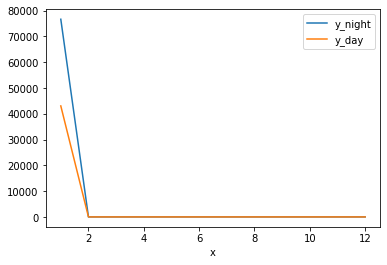

1 month
january nigth
77336.05356525963 january total distance at nigth
43038.802380275745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
77336.05356525963
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43038.802380275745
0
0
0
0
0
0
0
0
0
0
0


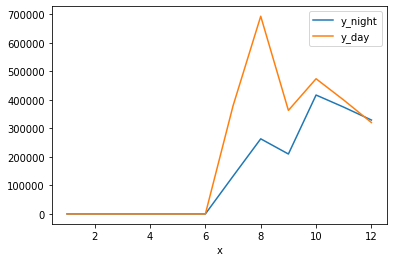

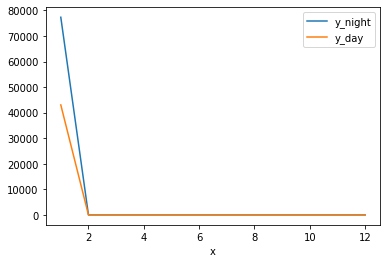

1 month
january nigth
78288.08839693134 january total distance at nigth
43038.802380275745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
78288.08839693134
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43038.802380275745
0
0
0
0
0
0
0
0
0
0
0


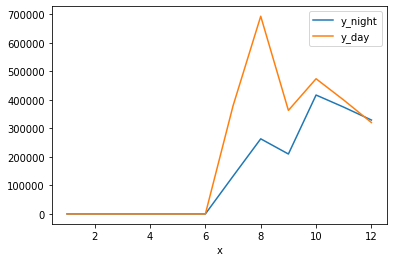

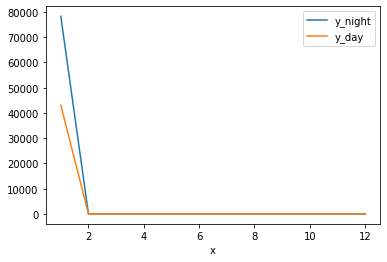

1 month
january nigth
79754.46095196645 january total distance at nigth
43038.802380275745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
79754.46095196645
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43038.802380275745
0
0
0
0
0
0
0
0
0
0
0


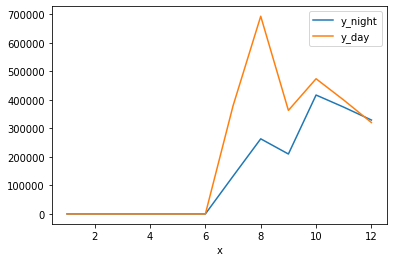

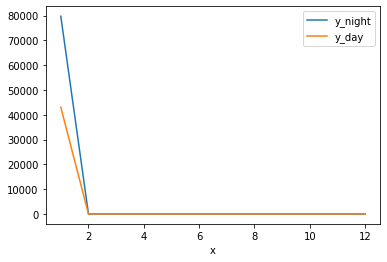

1 month
january nigth
80586.89831908322 january total distance at nigth
43038.802380275745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
80586.89831908322
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43038.802380275745
0
0
0
0
0
0
0
0
0
0
0


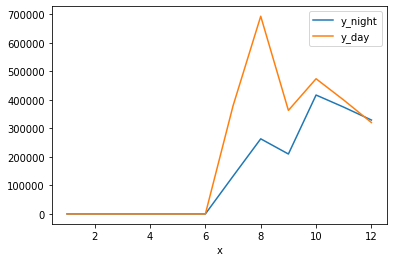

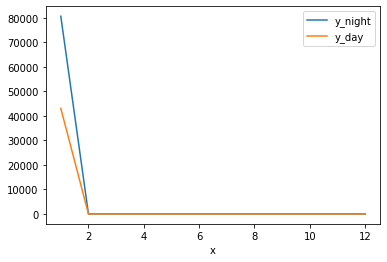

1 month
january nigth
81080.71899369037 january total distance at nigth
43038.802380275745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
81080.71899369037
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43038.802380275745
0
0
0
0
0
0
0
0
0
0
0


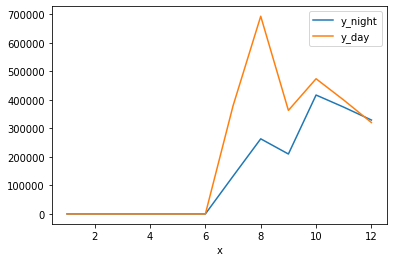

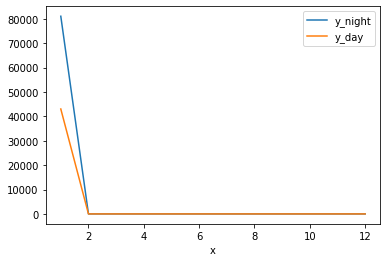

1 month
january nigth
81322.50189211522 january total distance at nigth
43038.802380275745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
81322.50189211522
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43038.802380275745
0
0
0
0
0
0
0
0
0
0
0


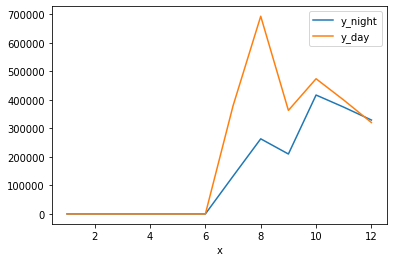

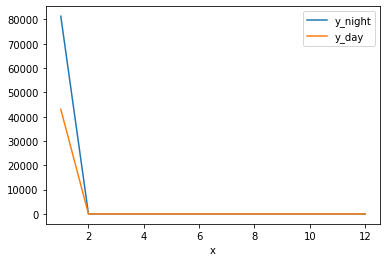

1 month
january nigth
81992.00807530002 january total distance at nigth
43038.802380275745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
81992.00807530002
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43038.802380275745
0
0
0
0
0
0
0
0
0
0
0


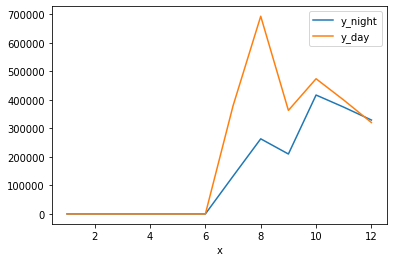

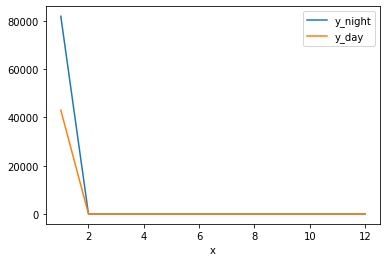

1 month
january nigth
82954.79494011785 january total distance at nigth
43038.802380275745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
82954.79494011785
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43038.802380275745
0
0
0
0
0
0
0
0
0
0
0


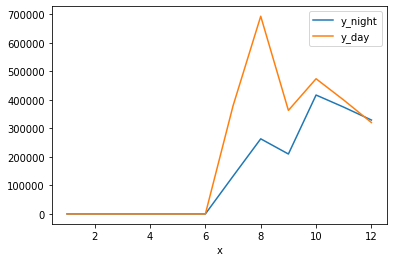

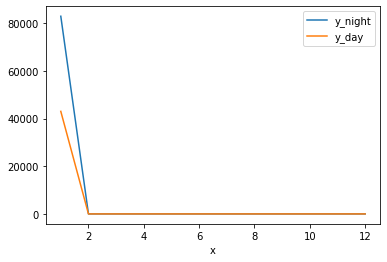

1 month
january day
82954.79494011785 january total distance at nigth
43694.97405689691 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
82954.79494011785
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
43694.97405689691
0
0
0
0
0
0
0
0
0
0
0


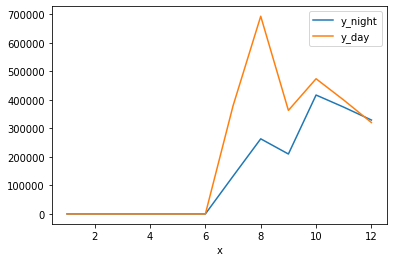

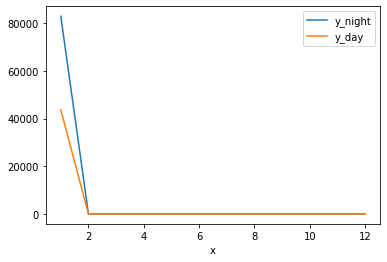

1 month
january day
82954.79494011785 january total distance at nigth
44134.53258152226 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
82954.79494011785
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
44134.53258152226
0
0
0
0
0
0
0
0
0
0
0


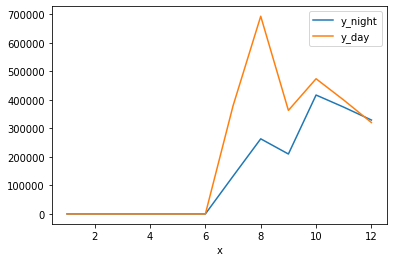

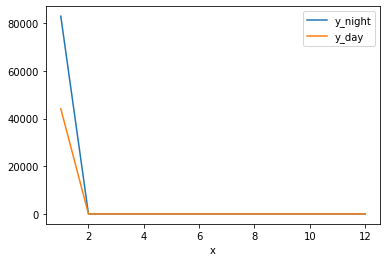

1 month
january day
82954.79494011785 january total distance at nigth
45312.495701848486 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
82954.79494011785
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
45312.495701848486
0
0
0
0
0
0
0
0
0
0
0


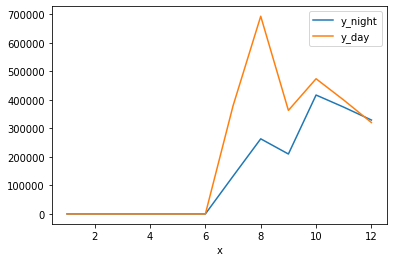

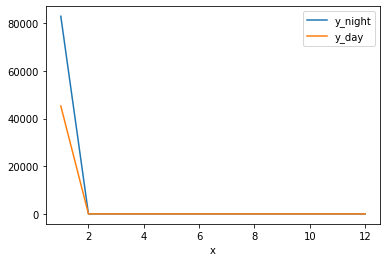

1 month
january day
82954.79494011785 january total distance at nigth
49374.132994677006 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
82954.79494011785
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
49374.132994677006
0
0
0
0
0
0
0
0
0
0
0


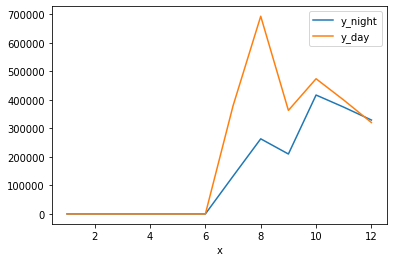

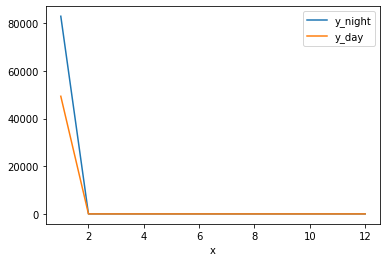

1 month
january day
82954.79494011785 january total distance at nigth
49602.65943731804 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
82954.79494011785
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
49602.65943731804
0
0
0
0
0
0
0
0
0
0
0


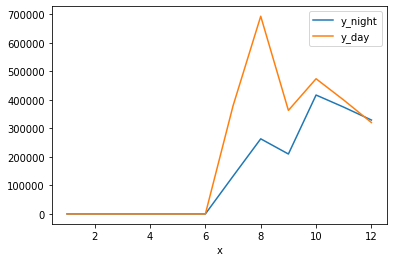

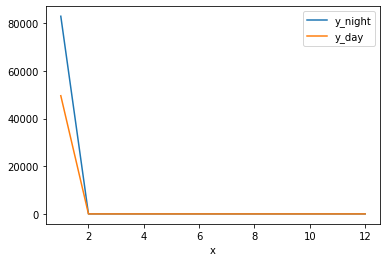

1 month
january day
82954.79494011785 january total distance at nigth
51382.51314733468 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
82954.79494011785
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
51382.51314733468
0
0
0
0
0
0
0
0
0
0
0


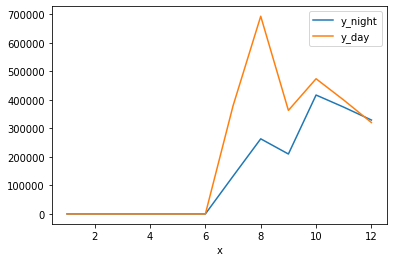

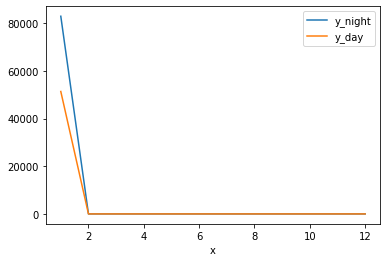

1 month
january day
82954.79494011785 january total distance at nigth
53269.22370829977 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
82954.79494011785
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
53269.22370829977
0
0
0
0
0
0
0
0
0
0
0


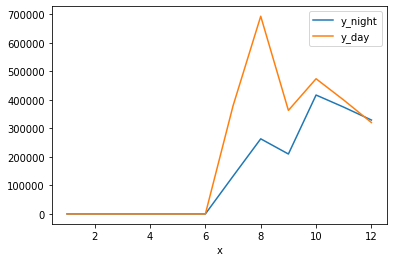

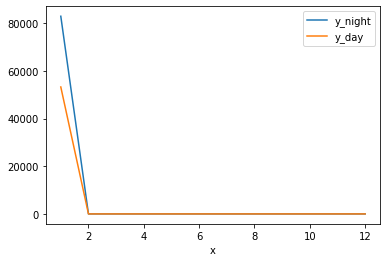

1 month
january nigth
86667.90439886216 january total distance at nigth
53269.22370829977 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
86667.90439886216
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
53269.22370829977
0
0
0
0
0
0
0
0
0
0
0


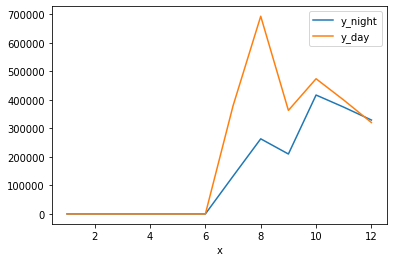

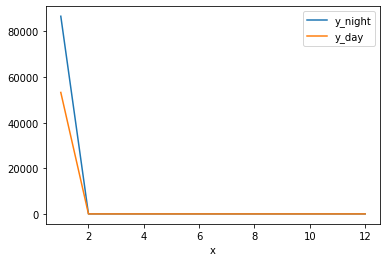

1 month
january nigth
89706.07621617817 january total distance at nigth
53269.22370829977 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
89706.07621617817
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
53269.22370829977
0
0
0
0
0
0
0
0
0
0
0


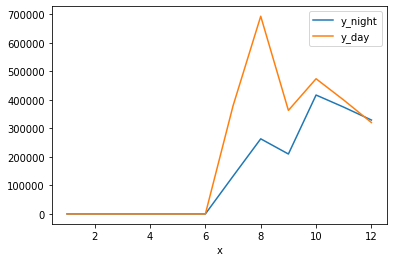

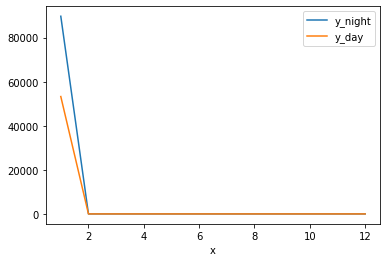

1 month
january nigth
91419.79051311854 january total distance at nigth
53269.22370829977 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
91419.79051311854
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
53269.22370829977
0
0
0
0
0
0
0
0
0
0
0


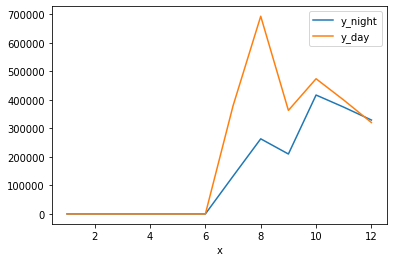

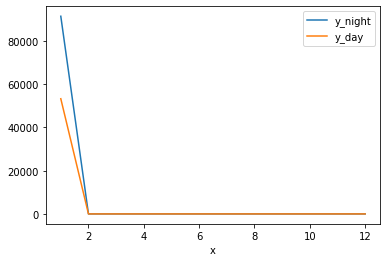

1 month
january nigth
93206.87007130498 january total distance at nigth
53269.22370829977 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
93206.87007130498
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
53269.22370829977
0
0
0
0
0
0
0
0
0
0
0


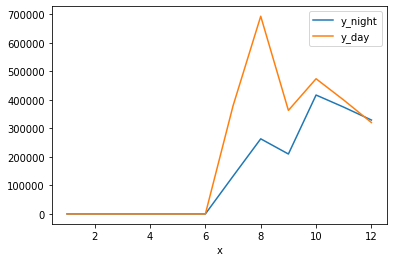

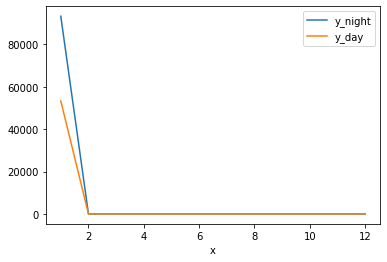

1 month
january nigth
96691.14131705927 january total distance at nigth
53269.22370829977 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
96691.14131705927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
53269.22370829977
0
0
0
0
0
0
0
0
0
0
0


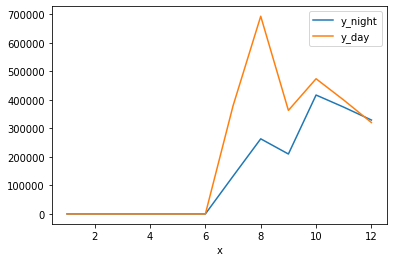

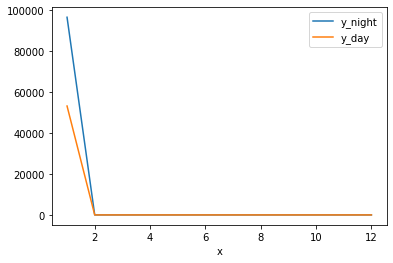

1 month
january nigth
97684.02091589688 january total distance at nigth
53269.22370829977 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
97684.02091589688
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
53269.22370829977
0
0
0
0
0
0
0
0
0
0
0


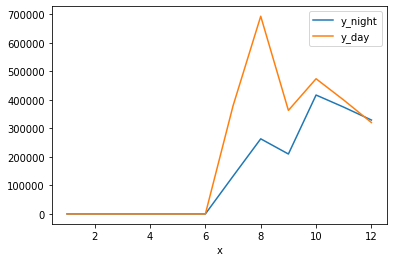

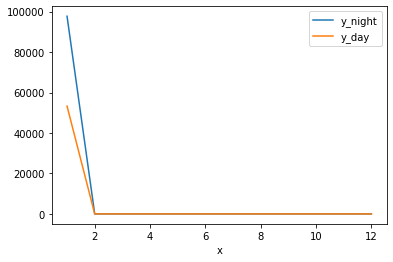

1 month
january nigth
101403.68145915505 january total distance at nigth
53269.22370829977 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
101403.68145915505
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
53269.22370829977
0
0
0
0
0
0
0
0
0
0
0


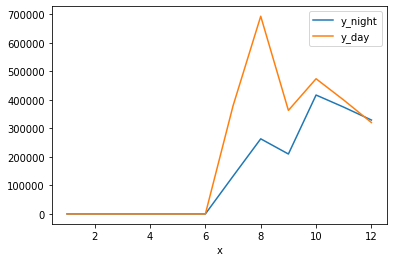

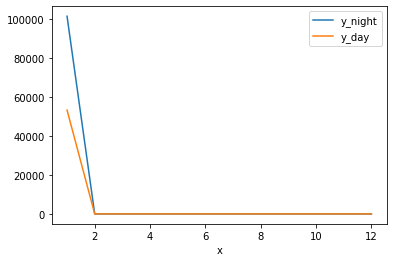

1 month
january nigth
103707.49808307689 january total distance at nigth
53269.22370829977 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
103707.49808307689
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
53269.22370829977
0
0
0
0
0
0
0
0
0
0
0


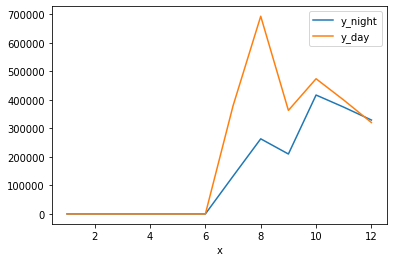

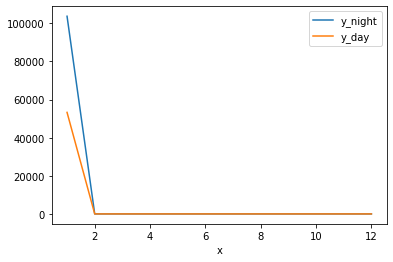

1 month
january nigth
104627.10268723736 january total distance at nigth
53269.22370829977 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
104627.10268723736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
53269.22370829977
0
0
0
0
0
0
0
0
0
0
0


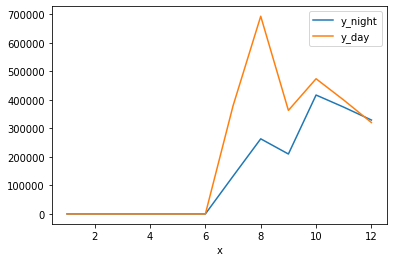

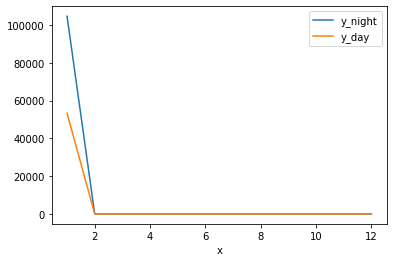

1 month
january day
104627.10268723736 january total distance at nigth
55391.995442981344 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
104627.10268723736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
55391.995442981344
0
0
0
0
0
0
0
0
0
0
0


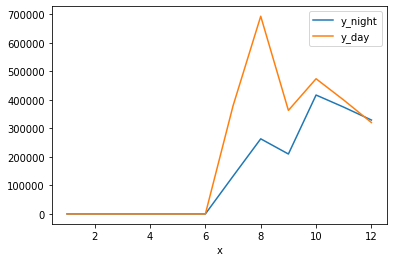

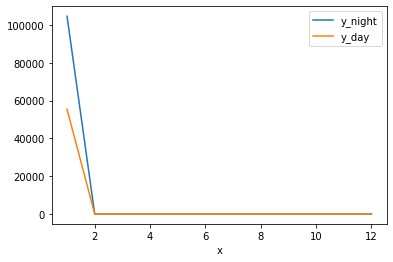

1 month
january day
104627.10268723736 january total distance at nigth
57280.64556550269 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
104627.10268723736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
57280.64556550269
0
0
0
0
0
0
0
0
0
0
0


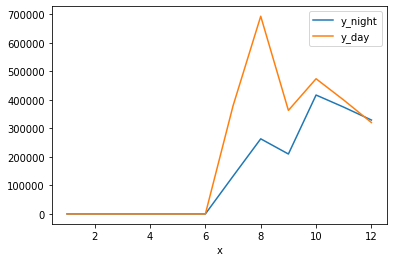

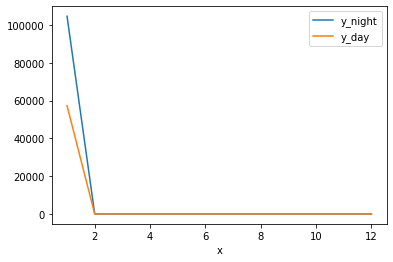

1 month
january day
104627.10268723736 january total distance at nigth
59916.46990714378 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
104627.10268723736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
59916.46990714378
0
0
0
0
0
0
0
0
0
0
0


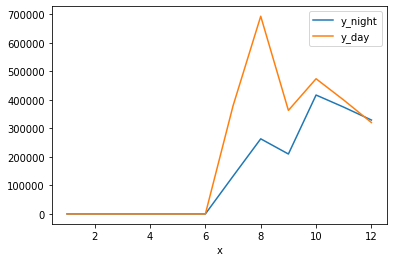

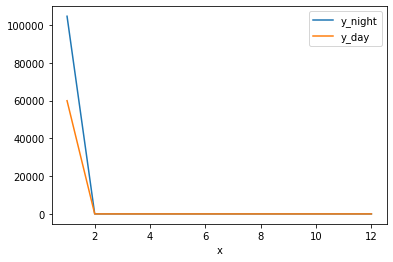

1 month
january day
104627.10268723736 january total distance at nigth
67712.14290710805 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
104627.10268723736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
67712.14290710805
0
0
0
0
0
0
0
0
0
0
0


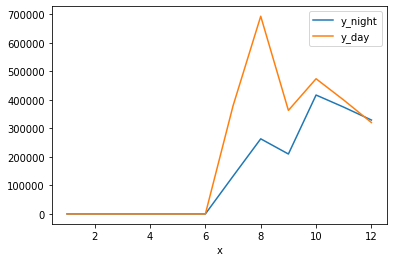

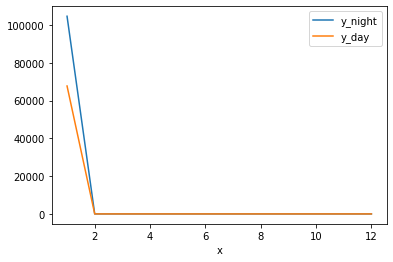

1 month
january day
104627.10268723736 january total distance at nigth
70588.05354161024 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
104627.10268723736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
70588.05354161024
0
0
0
0
0
0
0
0
0
0
0


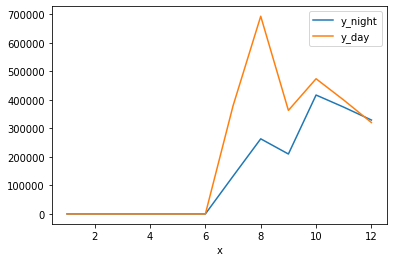

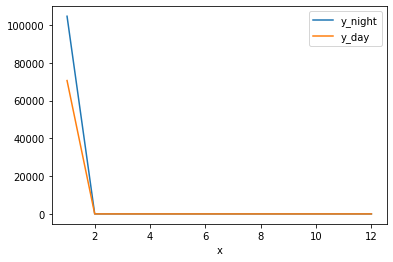

1 month
january day
104627.10268723736 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
104627.10268723736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


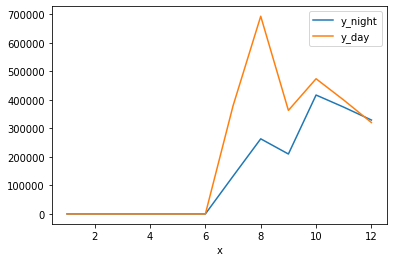

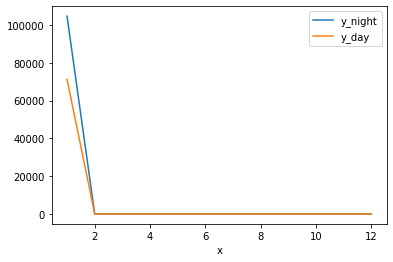

1 month
january nigth
110222.02834929965 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
110222.02834929965
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


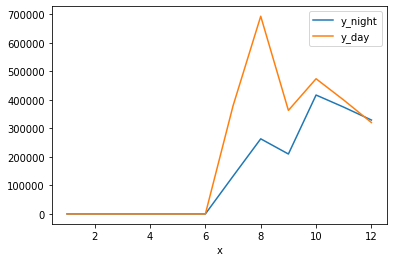

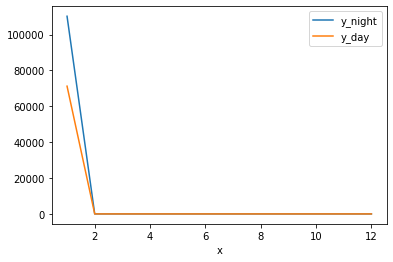

1 month
january nigth
111619.38048404678 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
111619.38048404678
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


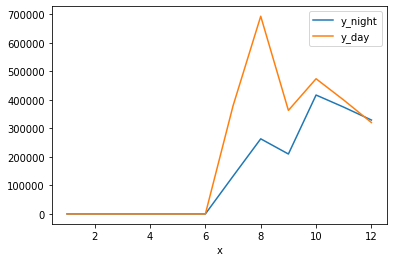

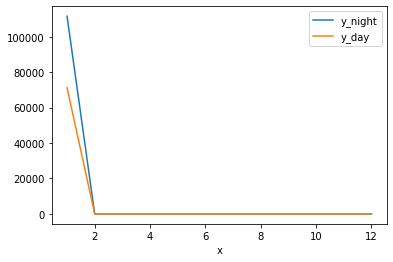

1 month
january nigth
112925.2263177378 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
112925.2263177378
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


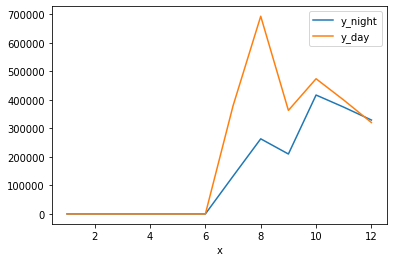

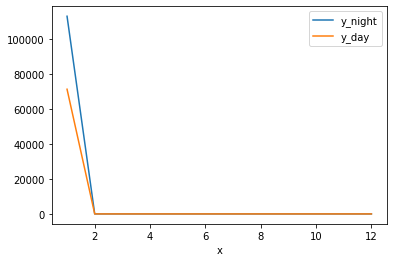

1 month
january nigth
114990.510952782 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
114990.510952782
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


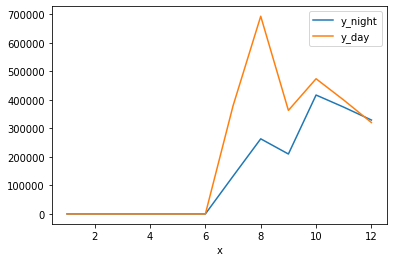

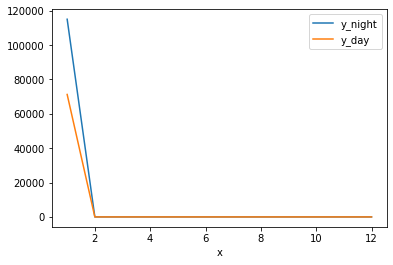

1 month
january nigth
116383.24018503023 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
116383.24018503023
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


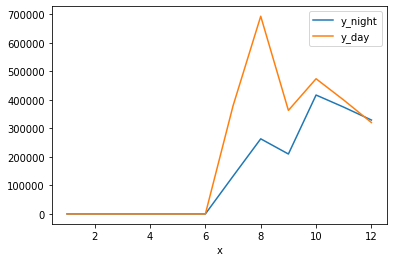

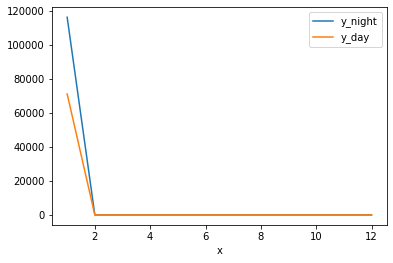

1 month
january nigth
117786.57172669892 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
117786.57172669892
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


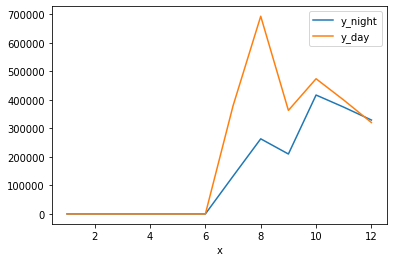

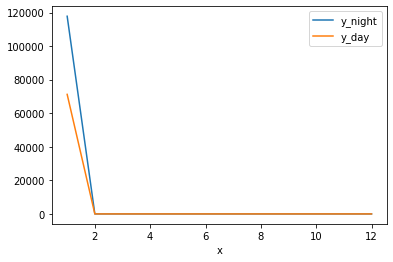

1 month
january nigth
119693.229349643 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
119693.229349643
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


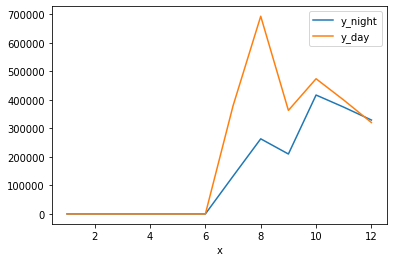

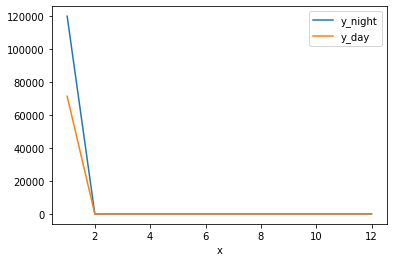

1 month
january nigth
121038.3071950647 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
121038.3071950647
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


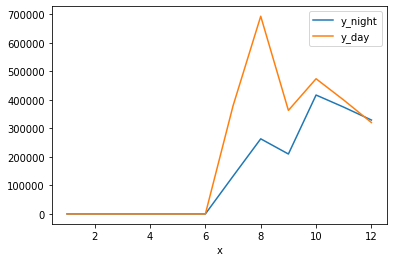

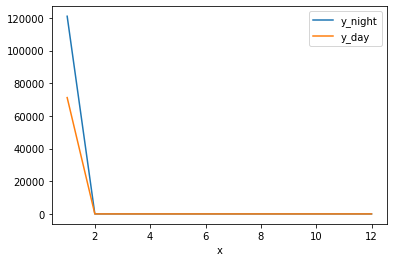

1 month
january nigth
122426.46947603599 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
122426.46947603599
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


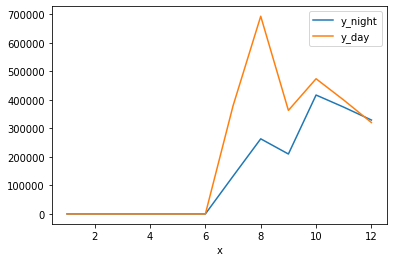

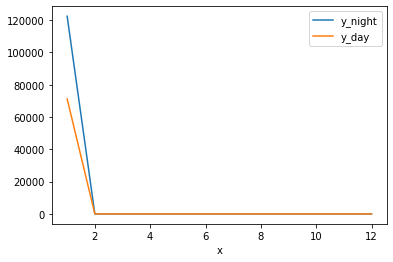

1 month
january nigth
123931.37473862195 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
123931.37473862195
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


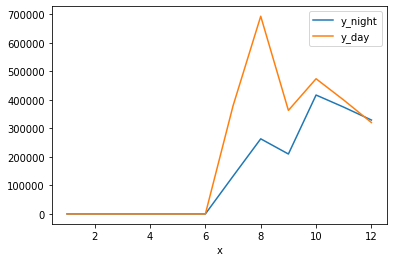

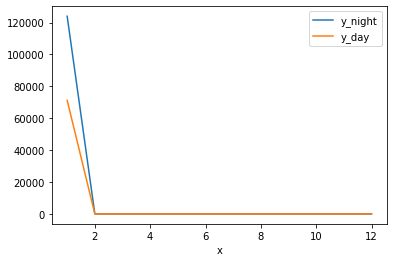

1 month
january nigth
125536.89549349468 january total distance at nigth
71230.61490900275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
125536.89549349468
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
71230.61490900275
0
0
0
0
0
0
0
0
0
0
0


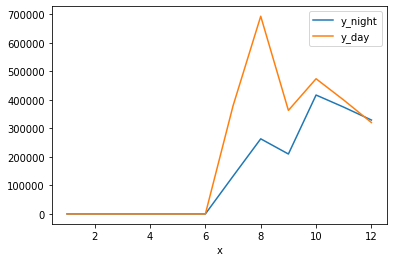

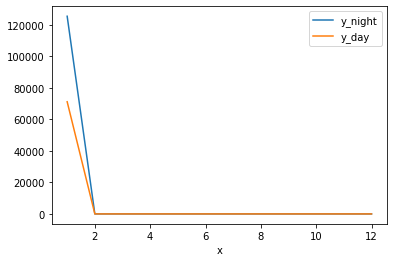

1 month
january day
125536.89549349468 january total distance at nigth
73275.25488782031 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
125536.89549349468
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
73275.25488782031
0
0
0
0
0
0
0
0
0
0
0


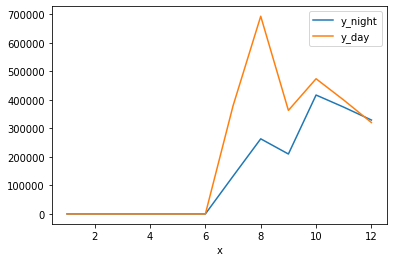

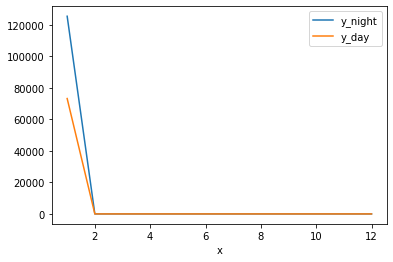

1 month
january day
125536.89549349468 january total distance at nigth
75891.78251765035 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
125536.89549349468
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
75891.78251765035
0
0
0
0
0
0
0
0
0
0
0


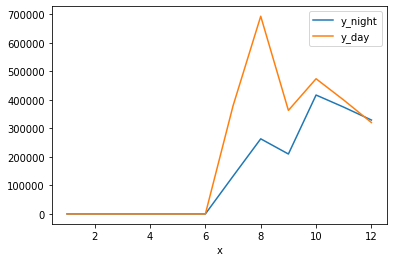

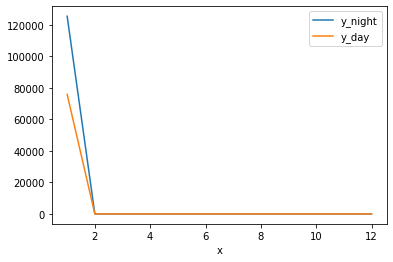

1 month
january day
125536.89549349468 january total distance at nigth
79506.9058794509 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
125536.89549349468
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
79506.9058794509
0
0
0
0
0
0
0
0
0
0
0


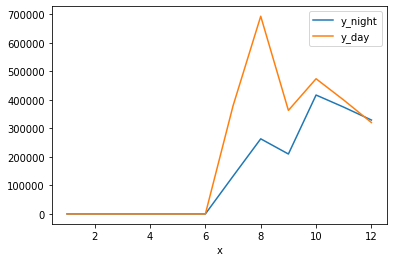

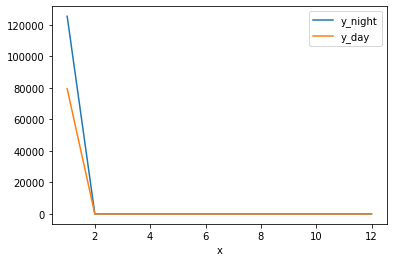

1 month
january day
125536.89549349468 january total distance at nigth
83389.08307819275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
125536.89549349468
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
83389.08307819275
0
0
0
0
0
0
0
0
0
0
0


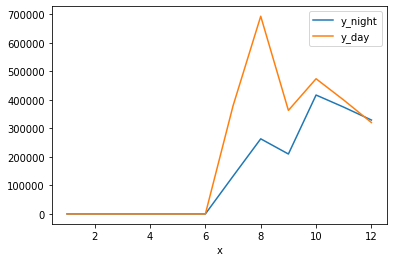

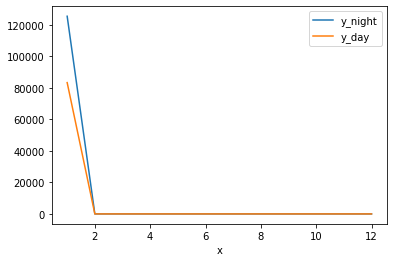

1 month
january day
125536.89549349468 january total distance at nigth
87005.0924531206 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
125536.89549349468
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
87005.0924531206
0
0
0
0
0
0
0
0
0
0
0


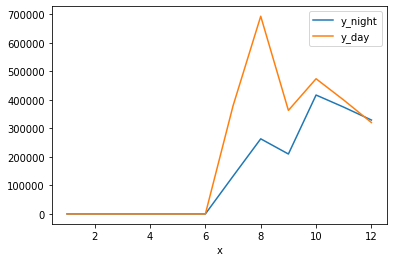

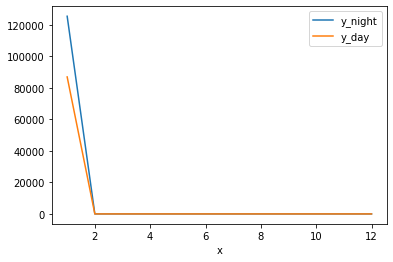

1 month
january nigth
128206.87568353345 january total distance at nigth
87005.0924531206 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
128206.87568353345
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
87005.0924531206
0
0
0
0
0
0
0
0
0
0
0


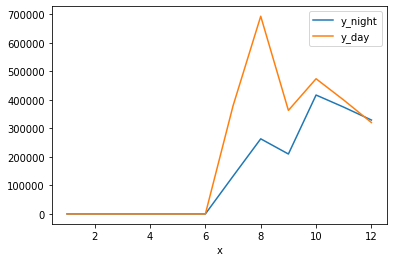

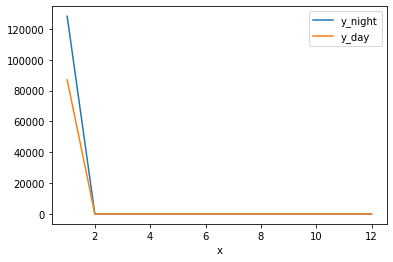

1 month
january nigth
130612.5919663428 january total distance at nigth
87005.0924531206 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
130612.5919663428
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
87005.0924531206
0
0
0
0
0
0
0
0
0
0
0


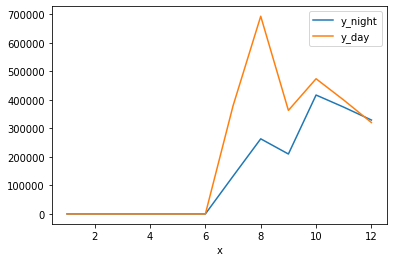

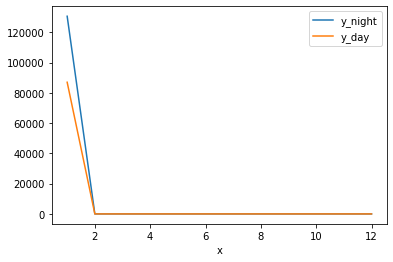

1 month
january nigth
132963.7715785073 january total distance at nigth
87005.0924531206 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
132963.7715785073
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
87005.0924531206
0
0
0
0
0
0
0
0
0
0
0


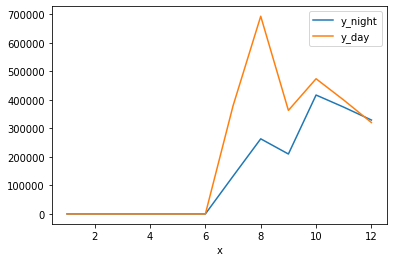

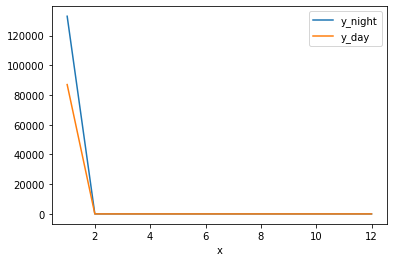

1 month
january nigth
133300.91820666808 january total distance at nigth
87005.0924531206 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
133300.91820666808
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
87005.0924531206
0
0
0
0
0
0
0
0
0
0
0


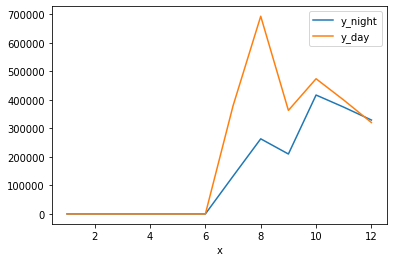

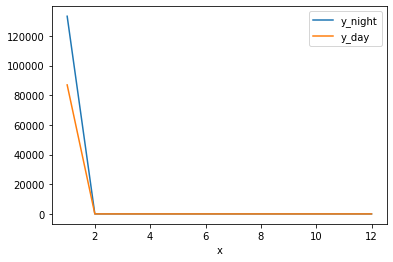

1 month
january nigth
134194.02605713537 january total distance at nigth
87005.0924531206 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
134194.02605713537
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
87005.0924531206
0
0
0
0
0
0
0
0
0
0
0


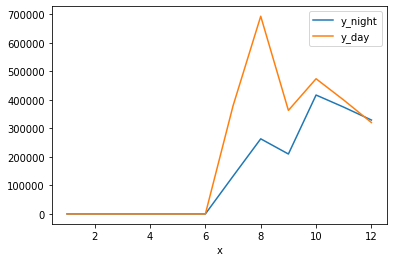

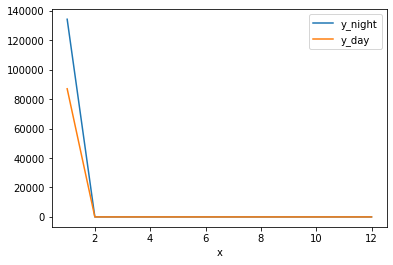

1 month
january nigth
134536.26923519318 january total distance at nigth
87005.0924531206 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
134536.26923519318
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
87005.0924531206
0
0
0
0
0
0
0
0
0
0
0


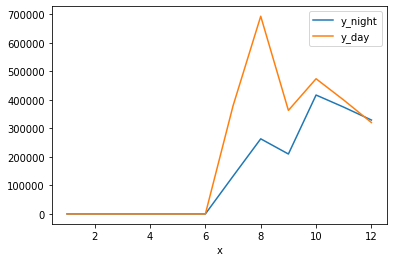

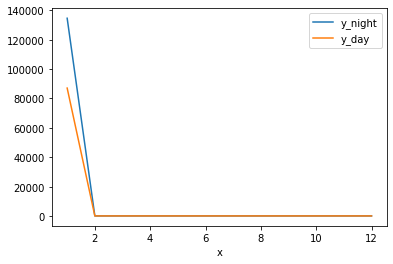

1 month
january nigth
135728.65907552734 january total distance at nigth
87005.0924531206 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
135728.65907552734
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
87005.0924531206
0
0
0
0
0
0
0
0
0
0
0


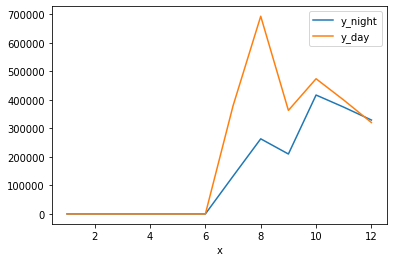

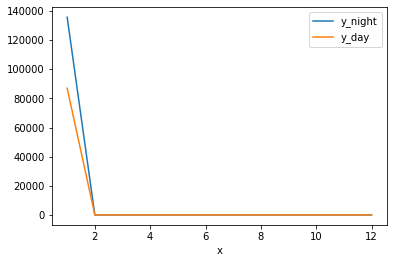

1 month
january day
135728.65907552734 january total distance at nigth
88190.45551944163 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
135728.65907552734
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
88190.45551944163
0
0
0
0
0
0
0
0
0
0
0


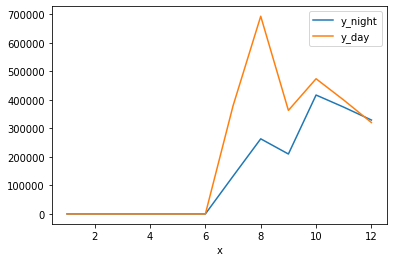

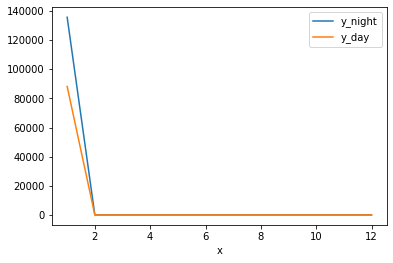

1 month
january day
135728.65907552734 january total distance at nigth
89809.43837759102 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
135728.65907552734
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
89809.43837759102
0
0
0
0
0
0
0
0
0
0
0


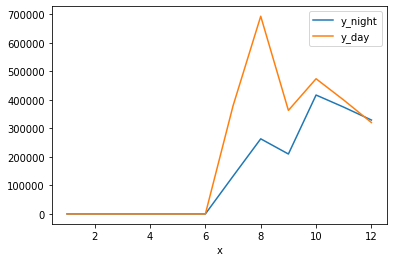

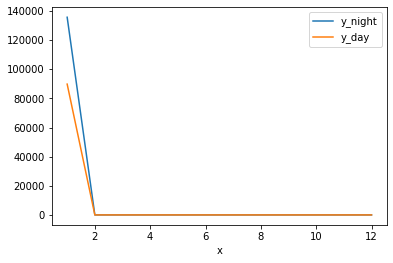

1 month
january day
135728.65907552734 january total distance at nigth
90635.61128837855 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
135728.65907552734
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
90635.61128837855
0
0
0
0
0
0
0
0
0
0
0


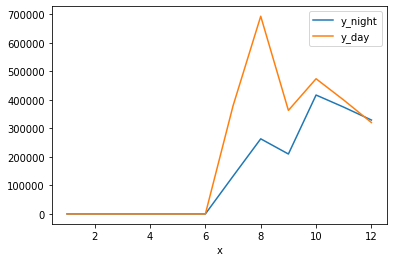

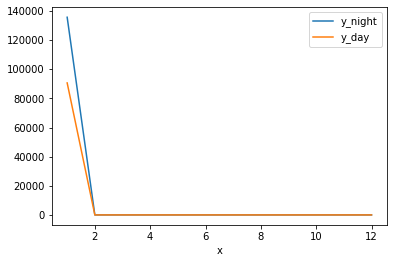

1 month
january day
135728.65907552734 january total distance at nigth
92867.2946830214 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
135728.65907552734
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
92867.2946830214
0
0
0
0
0
0
0
0
0
0
0


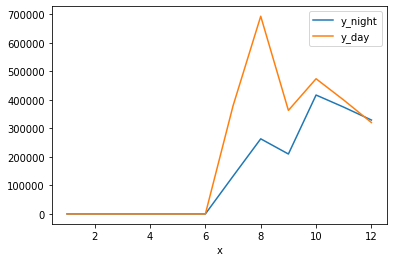

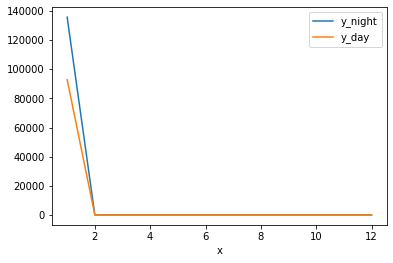

1 month
january day
135728.65907552734 january total distance at nigth
94327.06656395132 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
135728.65907552734
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
94327.06656395132
0
0
0
0
0
0
0
0
0
0
0


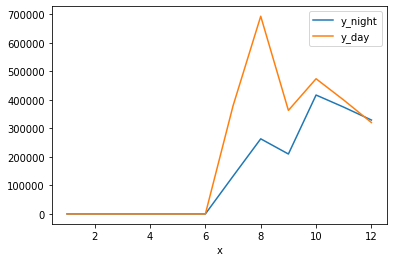

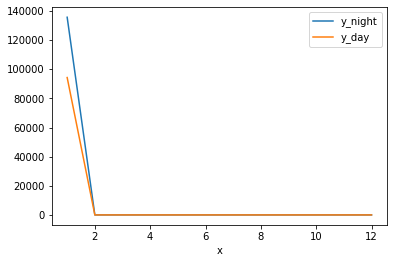

1 month
january day
135728.65907552734 january total distance at nigth
98888.47847750066 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
135728.65907552734
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
98888.47847750066
0
0
0
0
0
0
0
0
0
0
0


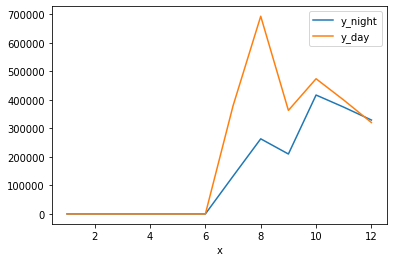

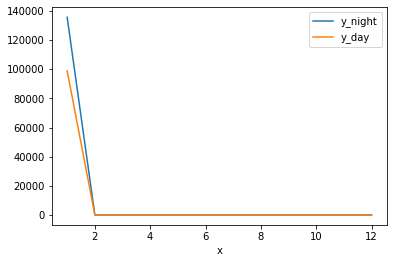

1 month
january nigth
136116.2547192971 january total distance at nigth
98888.47847750066 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
136116.2547192971
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
98888.47847750066
0
0
0
0
0
0
0
0
0
0
0


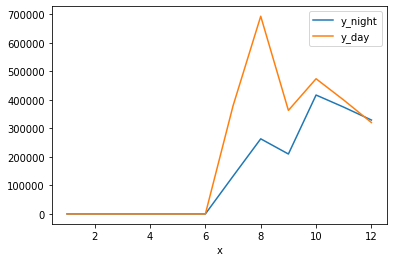

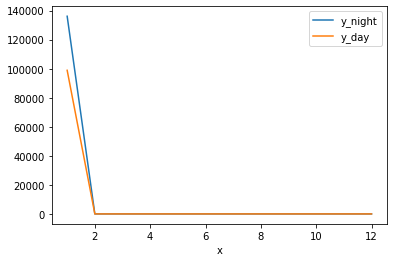

1 month
january nigth
137642.7612974262 january total distance at nigth
98888.47847750066 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
137642.7612974262
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
98888.47847750066
0
0
0
0
0
0
0
0
0
0
0


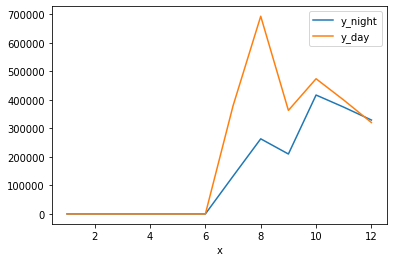

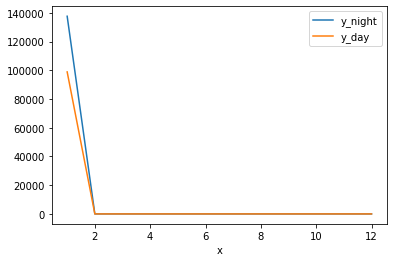

1 month
january nigth
138087.7538035945 january total distance at nigth
98888.47847750066 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
138087.7538035945
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
98888.47847750066
0
0
0
0
0
0
0
0
0
0
0


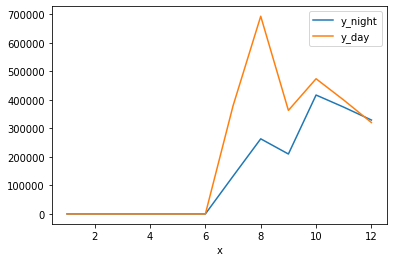

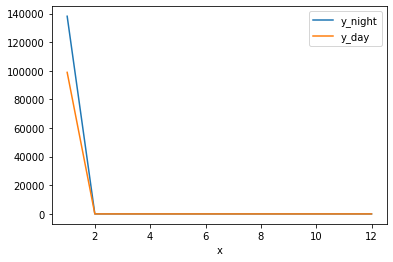

1 month
january nigth
139081.3436909772 january total distance at nigth
98888.47847750066 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
139081.3436909772
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
98888.47847750066
0
0
0
0
0
0
0
0
0
0
0


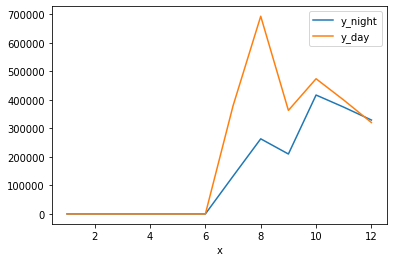

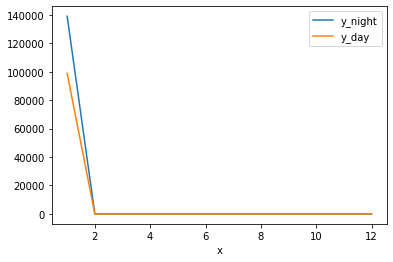

1 month
january nigth
139136.00830451978 january total distance at nigth
98888.47847750066 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
139136.00830451978
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
98888.47847750066
0
0
0
0
0
0
0
0
0
0
0


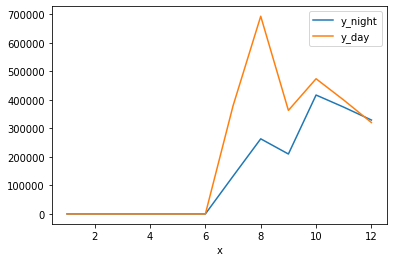

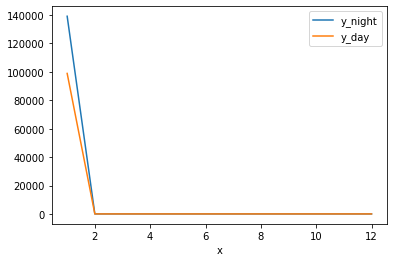

1 month
january nigth
140208.24303941778 january total distance at nigth
98888.47847750066 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
140208.24303941778
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
98888.47847750066
0
0
0
0
0
0
0
0
0
0
0


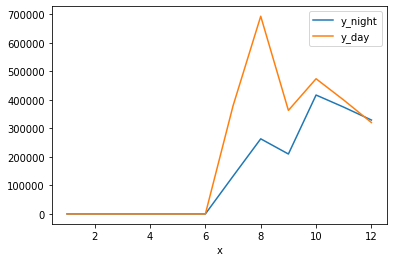

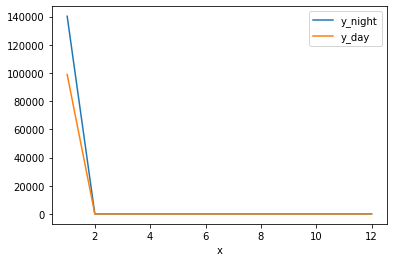

1 month
january nigth
142611.81119012262 january total distance at nigth
98888.47847750066 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
142611.81119012262
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
98888.47847750066
0
0
0
0
0
0
0
0
0
0
0


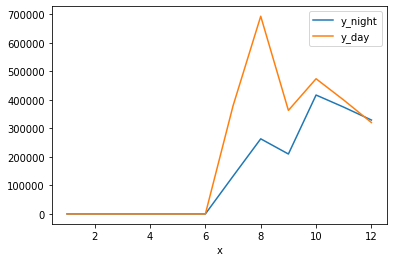

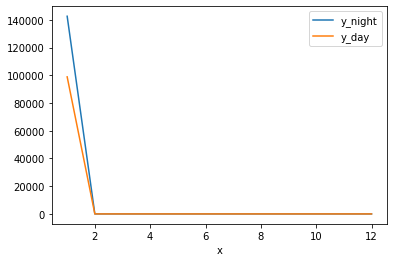

1 month
january nigth
142962.9997356108 january total distance at nigth
98888.47847750066 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
142962.9997356108
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
98888.47847750066
0
0
0
0
0
0
0
0
0
0
0


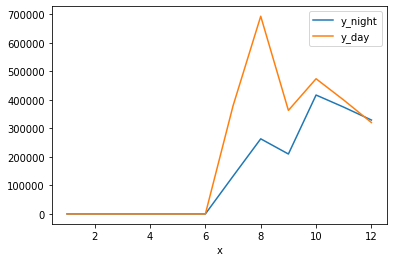

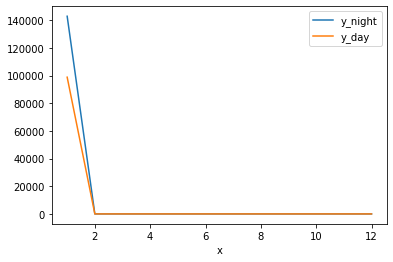

1 month
january nigth
142981.02951402118 january total distance at nigth
98888.47847750066 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
142981.02951402118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
98888.47847750066
0
0
0
0
0
0
0
0
0
0
0


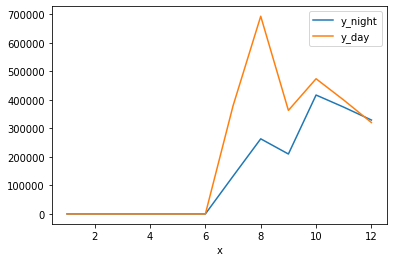

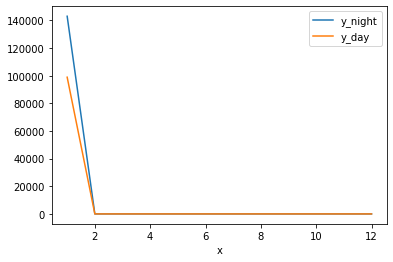

1 month
january day
142981.02951402118 january total distance at nigth
99563.5157096631 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
142981.02951402118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
99563.5157096631
0
0
0
0
0
0
0
0
0
0
0


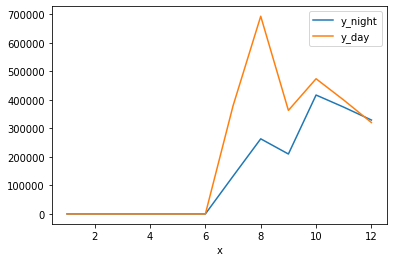

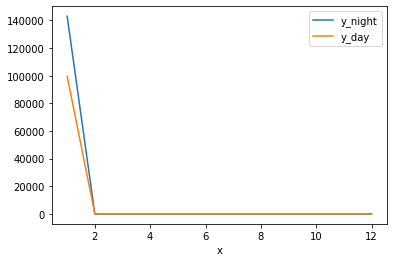

1 month
january day
142981.02951402118 january total distance at nigth
101136.38470144494 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
142981.02951402118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
101136.38470144494
0
0
0
0
0
0
0
0
0
0
0


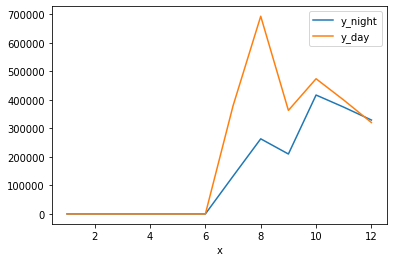

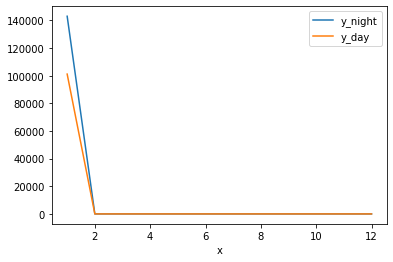

1 month
january day
142981.02951402118 january total distance at nigth
101171.88039458766 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
142981.02951402118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
101171.88039458766
0
0
0
0
0
0
0
0
0
0
0


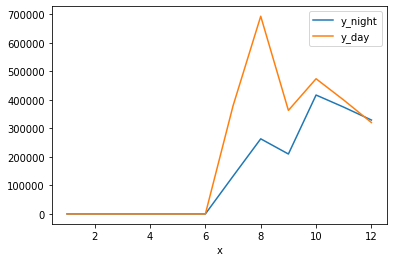

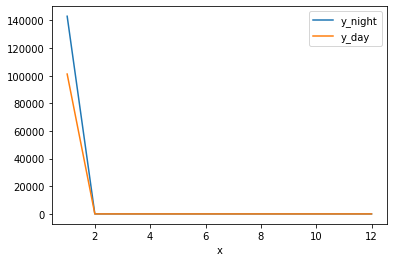

1 month
january day
142981.02951402118 january total distance at nigth
103044.51815036105 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
142981.02951402118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
103044.51815036105
0
0
0
0
0
0
0
0
0
0
0


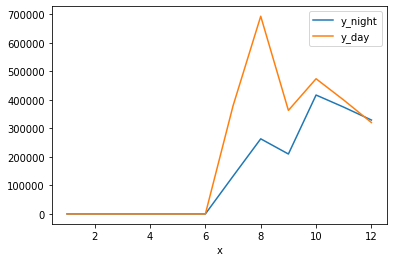

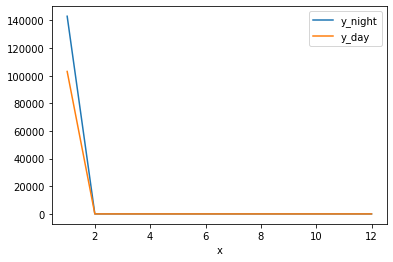

1 month
january day
142981.02951402118 january total distance at nigth
104395.28129195479 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
142981.02951402118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
104395.28129195479
0
0
0
0
0
0
0
0
0
0
0


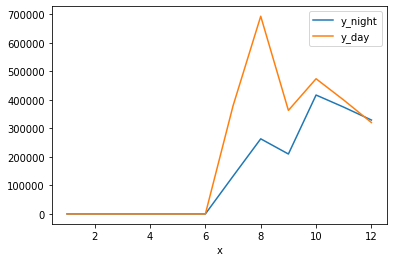

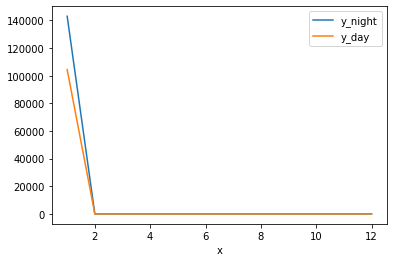

1 month
january day
142981.02951402118 january total distance at nigth
105438.1448723775 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
142981.02951402118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
105438.1448723775
0
0
0
0
0
0
0
0
0
0
0


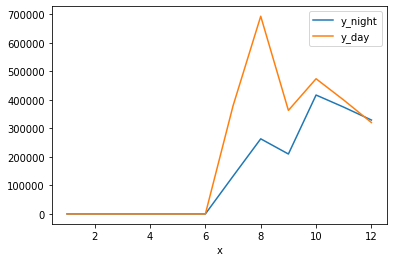

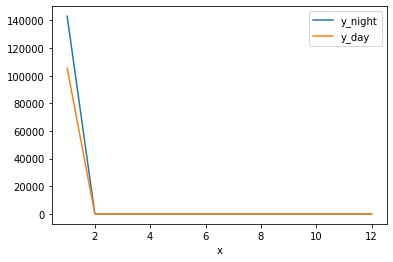

1 month
january day
142981.02951402118 january total distance at nigth
106955.90977598888 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
142981.02951402118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
106955.90977598888
0
0
0
0
0
0
0
0
0
0
0


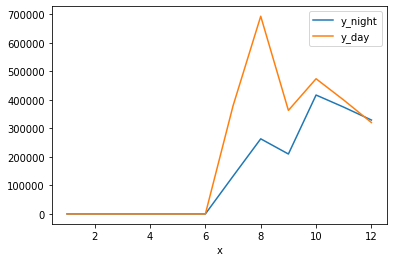

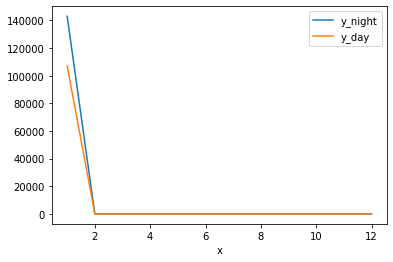

1 month
january nigth
145237.2478086617 january total distance at nigth
106955.90977598888 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
145237.2478086617
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
106955.90977598888
0
0
0
0
0
0
0
0
0
0
0


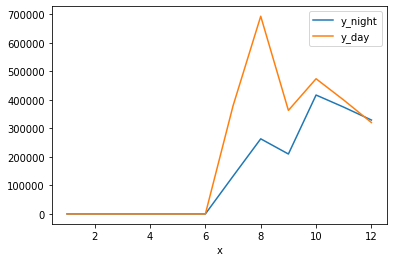

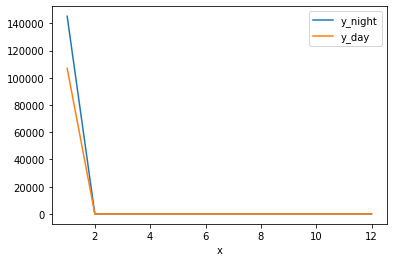

1 month
january nigth
145330.17844635632 january total distance at nigth
106955.90977598888 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
145330.17844635632
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
106955.90977598888
0
0
0
0
0
0
0
0
0
0
0


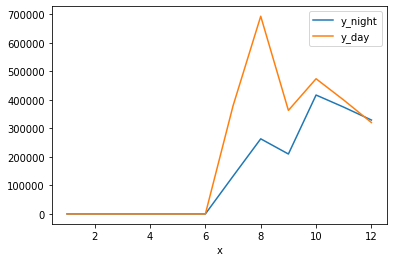

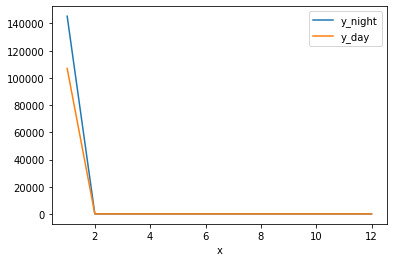

1 month
january nigth
145749.56641891666 january total distance at nigth
106955.90977598888 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
145749.56641891666
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
106955.90977598888
0
0
0
0
0
0
0
0
0
0
0


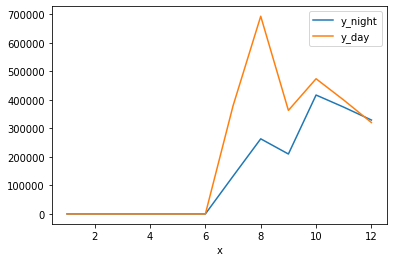

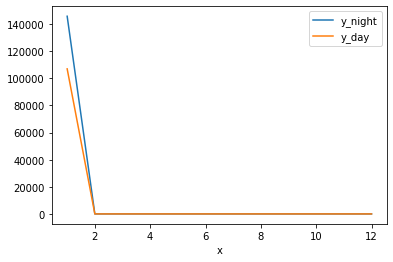

1 month
january nigth
145943.4226248868 january total distance at nigth
106955.90977598888 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
145943.4226248868
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
106955.90977598888
0
0
0
0
0
0
0
0
0
0
0


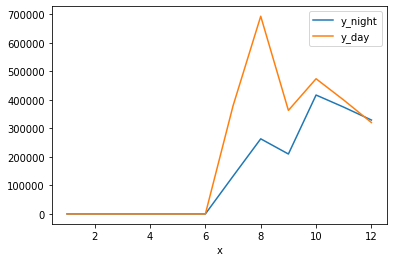

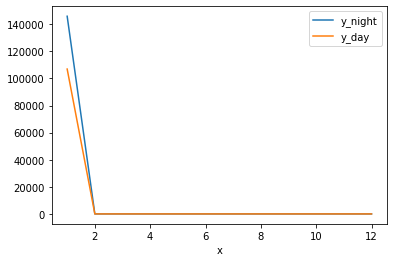

1 month
january nigth
148169.17193848637 january total distance at nigth
106955.90977598888 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
148169.17193848637
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
106955.90977598888
0
0
0
0
0
0
0
0
0
0
0


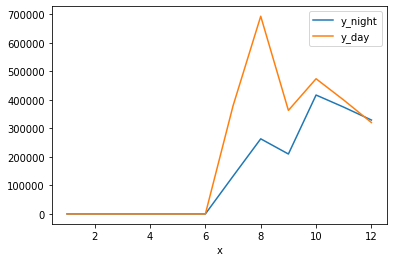

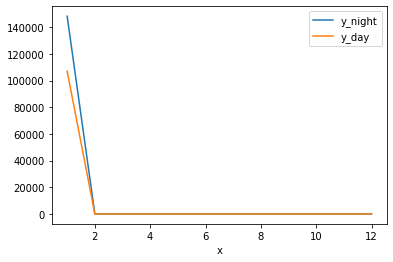

1 month
january day
148169.17193848637 january total distance at nigth
112294.23946167486 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
148169.17193848637
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
112294.23946167486
0
0
0
0
0
0
0
0
0
0
0


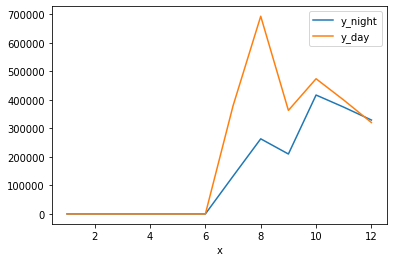

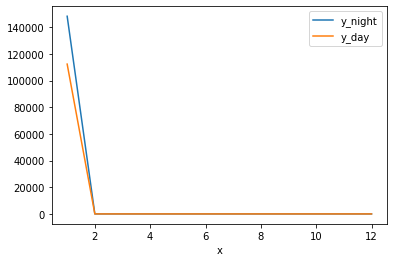

1 month
january day
148169.17193848637 january total distance at nigth
112320.06400634127 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
148169.17193848637
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
112320.06400634127
0
0
0
0
0
0
0
0
0
0
0


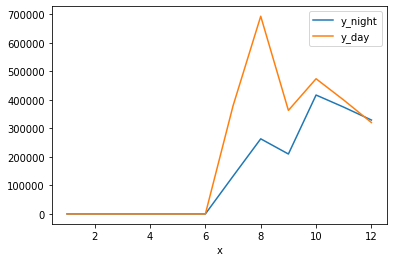

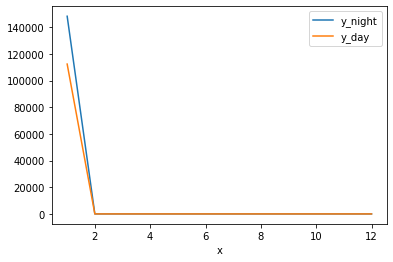

1 month
january day
148169.17193848637 january total distance at nigth
114520.92809015916 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
148169.17193848637
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
114520.92809015916
0
0
0
0
0
0
0
0
0
0
0


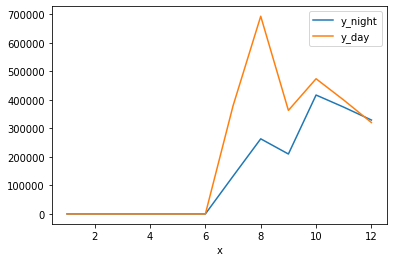

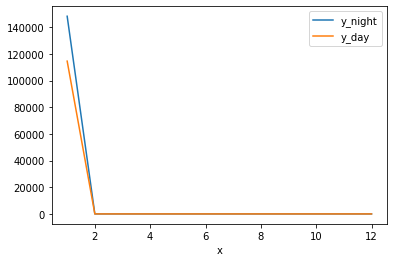

1 month
january day
148169.17193848637 january total distance at nigth
117869.8238783683 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
148169.17193848637
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
117869.8238783683
0
0
0
0
0
0
0
0
0
0
0


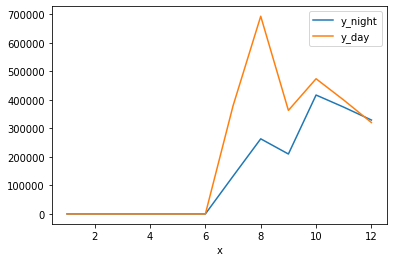

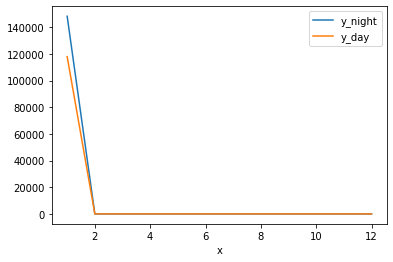

1 month
january day
148169.17193848637 january total distance at nigth
120091.83647026561 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
148169.17193848637
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
120091.83647026561
0
0
0
0
0
0
0
0
0
0
0


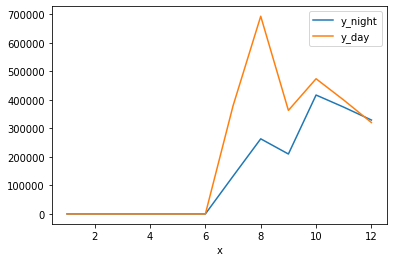

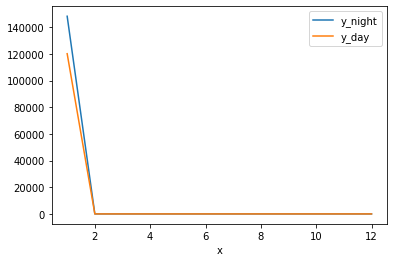

1 month
january day
148169.17193848637 january total distance at nigth
122694.6709128645 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
148169.17193848637
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
122694.6709128645
0
0
0
0
0
0
0
0
0
0
0


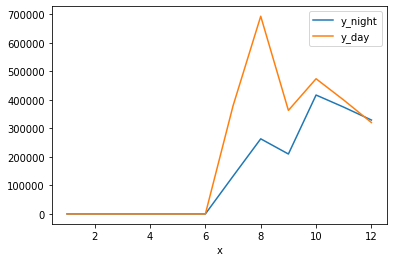

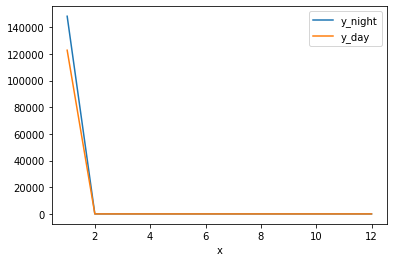

1 month
january day
148169.17193848637 january total distance at nigth
123013.83556493373 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
148169.17193848637
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
123013.83556493373
0
0
0
0
0
0
0
0
0
0
0


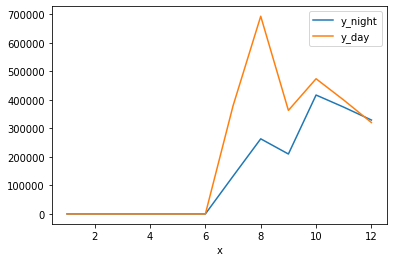

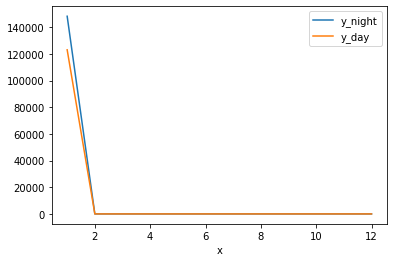

1 month
january nigth
149191.79661790212 january total distance at nigth
123013.83556493373 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
149191.79661790212
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
123013.83556493373
0
0
0
0
0
0
0
0
0
0
0


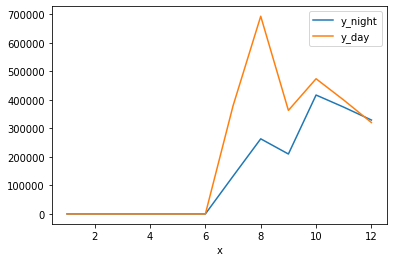

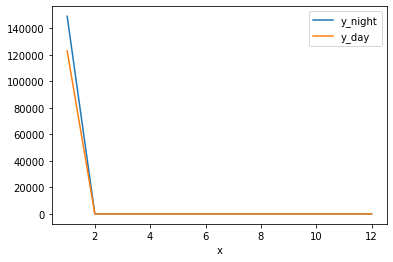

1 month
january nigth
150753.0126553728 january total distance at nigth
123013.83556493373 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
150753.0126553728
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
123013.83556493373
0
0
0
0
0
0
0
0
0
0
0


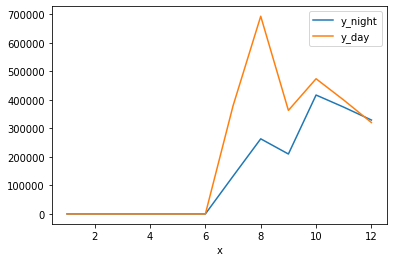

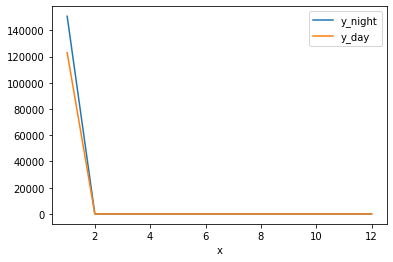

1 month
january nigth
153410.8368334791 january total distance at nigth
123013.83556493373 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
153410.8368334791
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
123013.83556493373
0
0
0
0
0
0
0
0
0
0
0


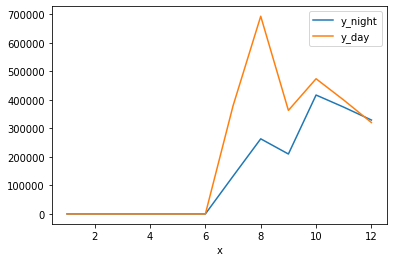

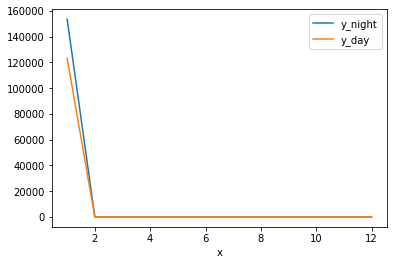

1 month
january nigth
155704.60535124794 january total distance at nigth
123013.83556493373 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
155704.60535124794
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
123013.83556493373
0
0
0
0
0
0
0
0
0
0
0


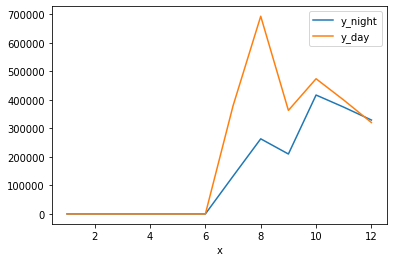

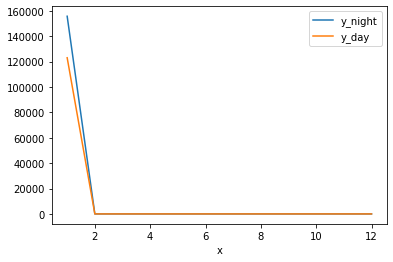

1 month
january nigth
157254.38750084734 january total distance at nigth
123013.83556493373 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
157254.38750084734
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
123013.83556493373
0
0
0
0
0
0
0
0
0
0
0


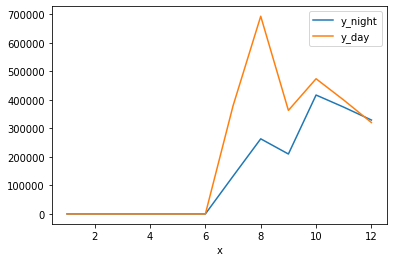

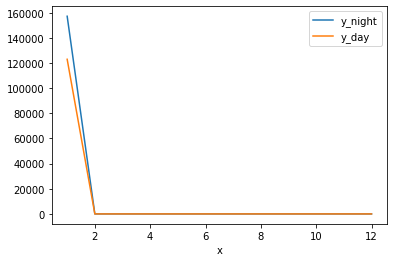

1 month
january nigth
160369.81457480366 january total distance at nigth
123013.83556493373 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
160369.81457480366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
123013.83556493373
0
0
0
0
0
0
0
0
0
0
0


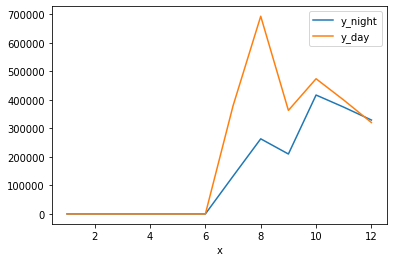

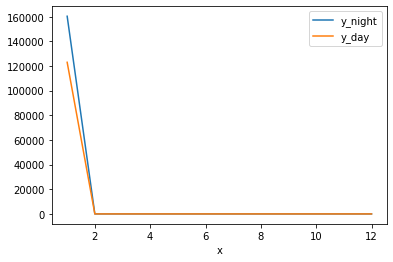

1 month
january day
160369.81457480366 january total distance at nigth
125090.98542807648 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
160369.81457480366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
125090.98542807648
0
0
0
0
0
0
0
0
0
0
0


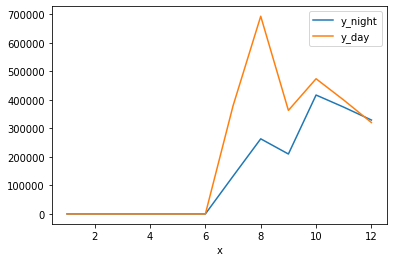

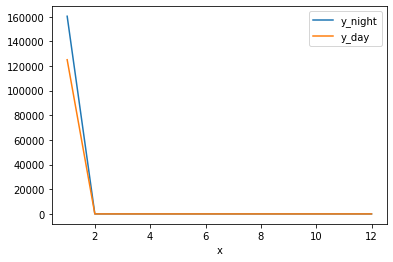

1 month
january day
160369.81457480366 january total distance at nigth
125546.93192002566 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
160369.81457480366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
125546.93192002566
0
0
0
0
0
0
0
0
0
0
0


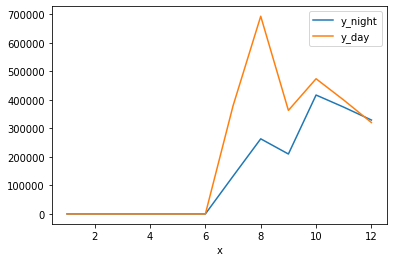

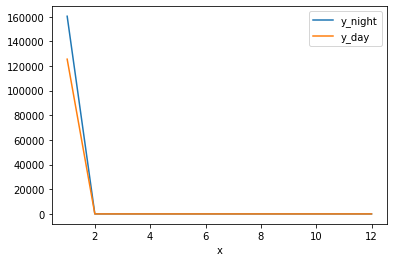

1 month
january day
160369.81457480366 january total distance at nigth
127842.824670557 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
160369.81457480366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
127842.824670557
0
0
0
0
0
0
0
0
0
0
0


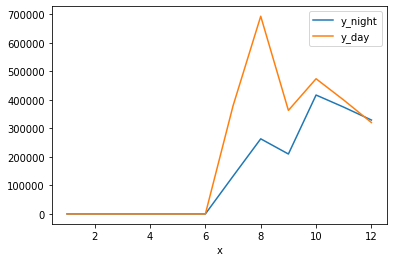

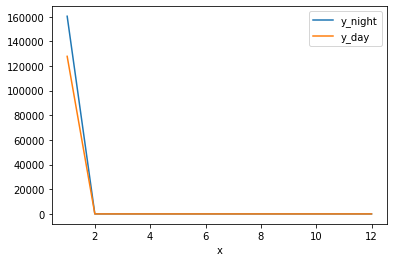

1 month
january day
160369.81457480366 january total distance at nigth
130989.13463652792 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
160369.81457480366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
130989.13463652792
0
0
0
0
0
0
0
0
0
0
0


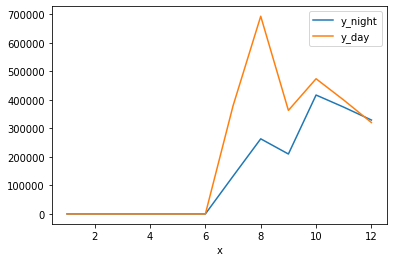

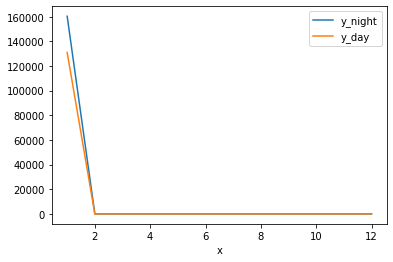

1 month
january day
160369.81457480366 january total distance at nigth
133370.65045878763 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
160369.81457480366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
133370.65045878763
0
0
0
0
0
0
0
0
0
0
0


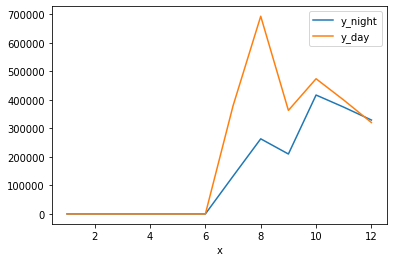

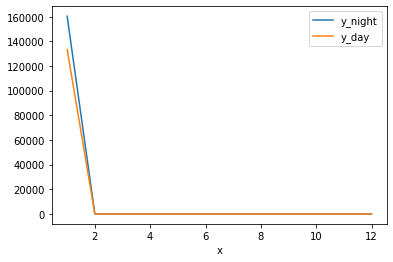

1 month
january nigth
163254.32605351778 january total distance at nigth
133370.65045878763 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
163254.32605351778
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
133370.65045878763
0
0
0
0
0
0
0
0
0
0
0


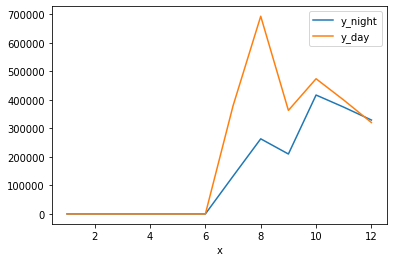

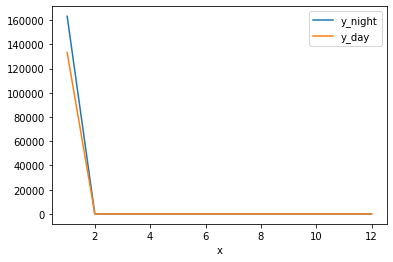

1 month
january nigth
165209.08063761445 january total distance at nigth
133370.65045878763 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
165209.08063761445
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
133370.65045878763
0
0
0
0
0
0
0
0
0
0
0


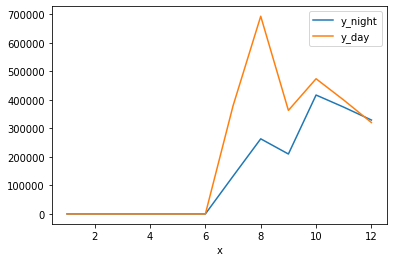

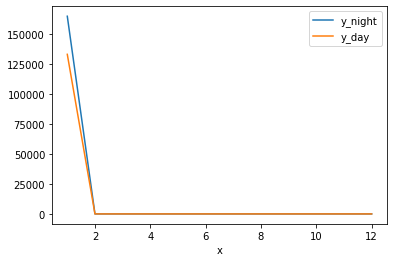

1 month
january nigth
166387.8351746138 january total distance at nigth
133370.65045878763 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
166387.8351746138
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
133370.65045878763
0
0
0
0
0
0
0
0
0
0
0


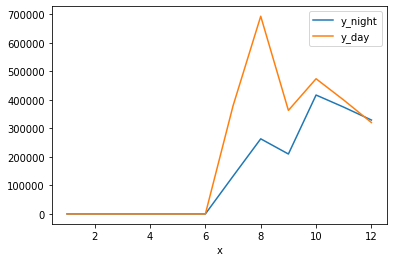

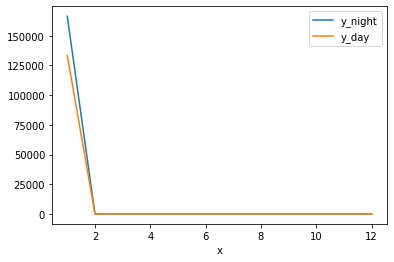

1 month
january nigth
167358.5134647855 january total distance at nigth
133370.65045878763 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
167358.5134647855
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
133370.65045878763
0
0
0
0
0
0
0
0
0
0
0


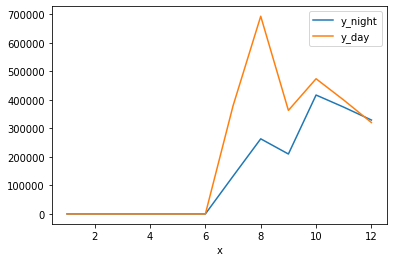

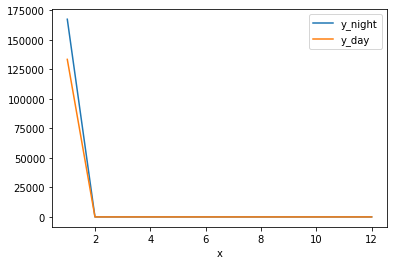

1 month
january nigth
167843.11997124826 january total distance at nigth
133370.65045878763 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
167843.11997124826
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
133370.65045878763
0
0
0
0
0
0
0
0
0
0
0


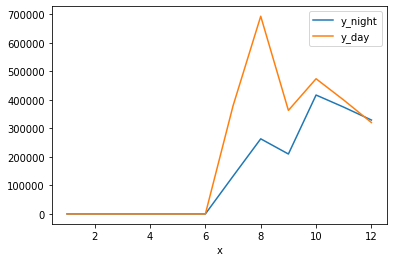

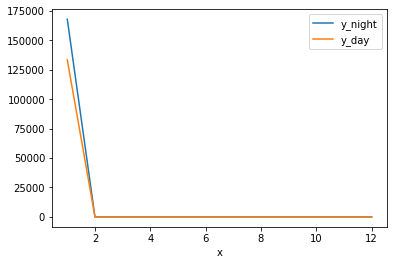

1 month
january day
167843.11997124826 january total distance at nigth
136476.62509296482 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
167843.11997124826
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
136476.62509296482
0
0
0
0
0
0
0
0
0
0
0


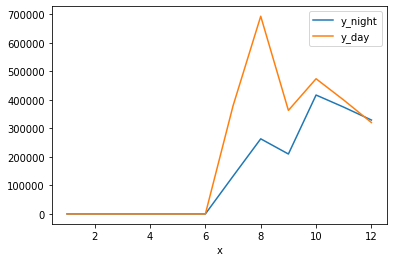

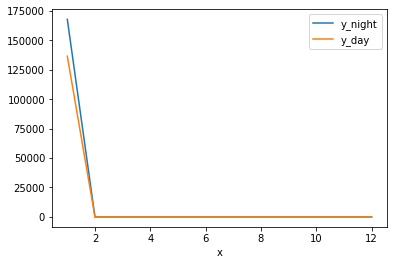

1 month
january day
167843.11997124826 january total distance at nigth
140662.12495178275 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
167843.11997124826
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
140662.12495178275
0
0
0
0
0
0
0
0
0
0
0


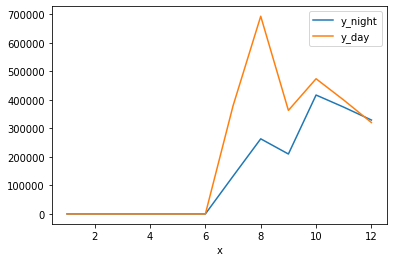

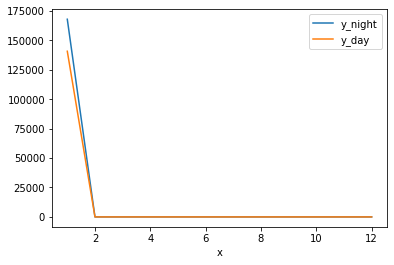

1 month
january day
167843.11997124826 january total distance at nigth
144573.05079127738 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
167843.11997124826
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
144573.05079127738
0
0
0
0
0
0
0
0
0
0
0


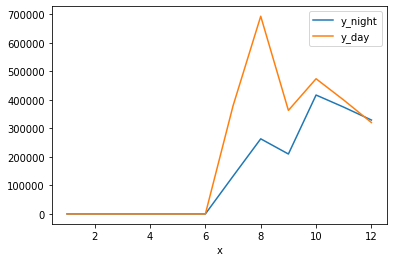

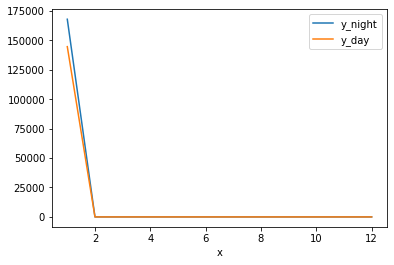

1 month
january day
167843.11997124826 january total distance at nigth
145394.1601748486 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
167843.11997124826
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
145394.1601748486
0
0
0
0
0
0
0
0
0
0
0


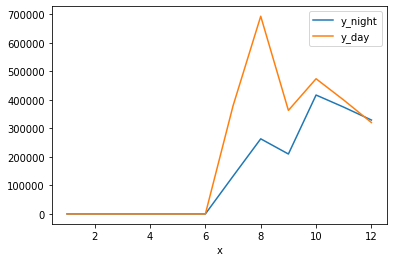

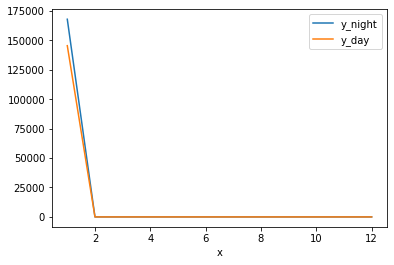

1 month
january nigth
168173.88722847824 january total distance at nigth
145394.1601748486 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
168173.88722847824
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
145394.1601748486
0
0
0
0
0
0
0
0
0
0
0


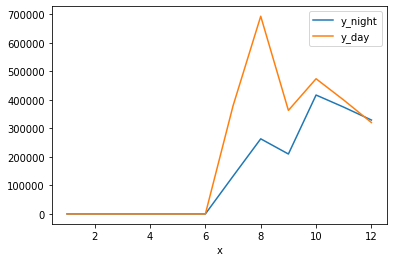

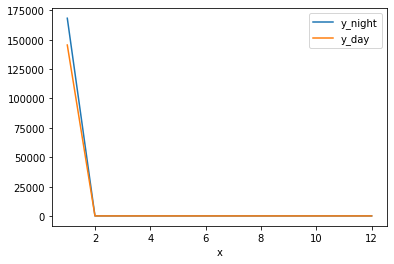

1 month
january nigth
169946.3398727662 january total distance at nigth
145394.1601748486 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
169946.3398727662
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
145394.1601748486
0
0
0
0
0
0
0
0
0
0
0


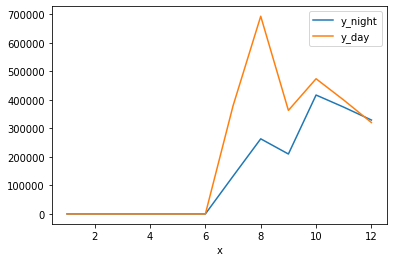

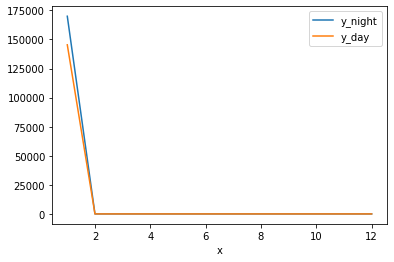

1 month
january nigth
172920.57132146714 january total distance at nigth
145394.1601748486 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
172920.57132146714
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
145394.1601748486
0
0
0
0
0
0
0
0
0
0
0


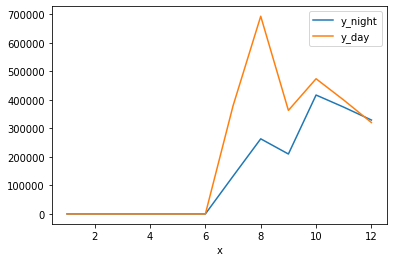

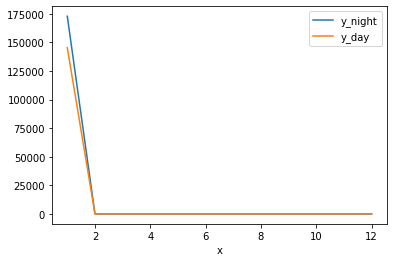

1 month
january nigth
172960.67382266655 january total distance at nigth
145394.1601748486 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
172960.67382266655
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
145394.1601748486
0
0
0
0
0
0
0
0
0
0
0


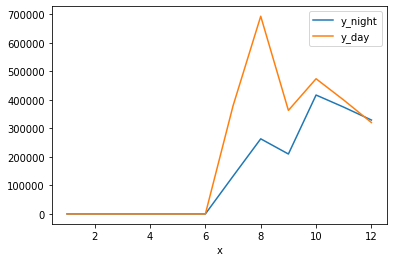

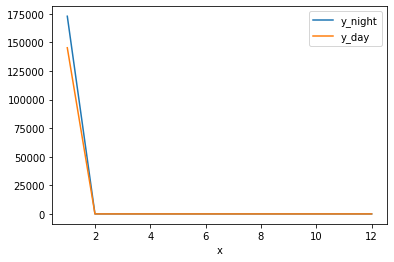

1 month
january nigth
176134.14561558896 january total distance at nigth
145394.1601748486 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
176134.14561558896
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
145394.1601748486
0
0
0
0
0
0
0
0
0
0
0


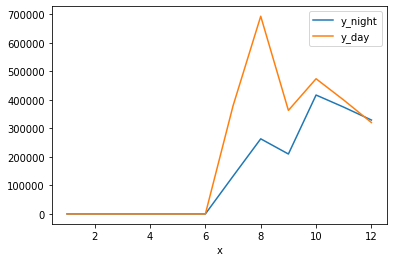

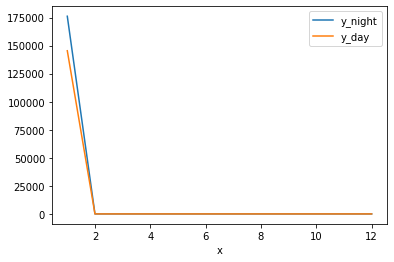

1 month
january day
176134.14561558896 january total distance at nigth
148761.04377624512 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
176134.14561558896
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
148761.04377624512
0
0
0
0
0
0
0
0
0
0
0


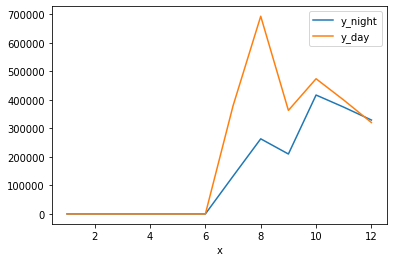

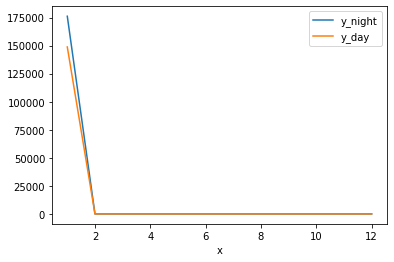

1 month
january day
176134.14561558896 january total distance at nigth
151532.16859186458 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
176134.14561558896
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
151532.16859186458
0
0
0
0
0
0
0
0
0
0
0


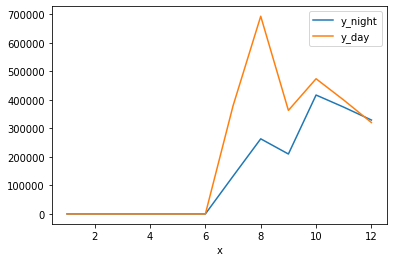

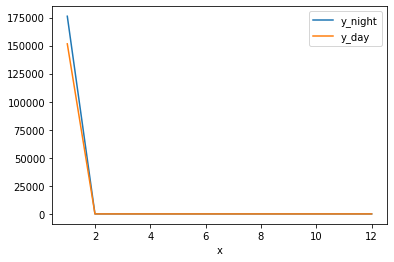

1 month
january day
176134.14561558896 january total distance at nigth
151568.62062811592 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
176134.14561558896
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
151568.62062811592
0
0
0
0
0
0
0
0
0
0
0


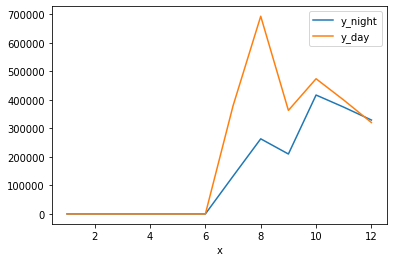

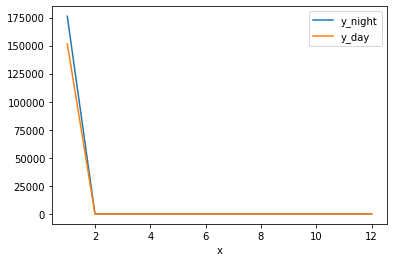

1 month
january day
176134.14561558896 january total distance at nigth
152516.26368031124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
176134.14561558896
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
152516.26368031124
0
0
0
0
0
0
0
0
0
0
0


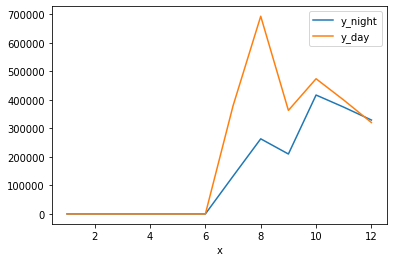

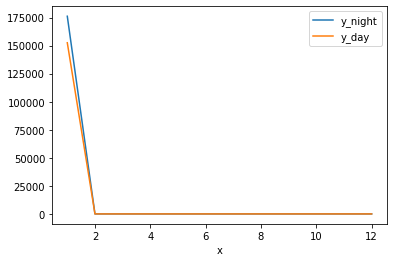

1 month
january nigth
179020.0804848235 january total distance at nigth
152516.26368031124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
179020.0804848235
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
152516.26368031124
0
0
0
0
0
0
0
0
0
0
0


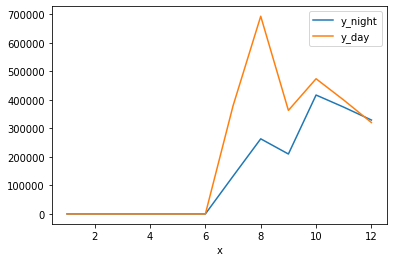

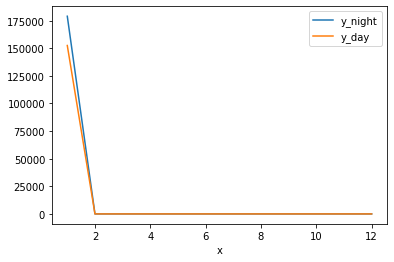

1 month
january nigth
183634.29040135595 january total distance at nigth
152516.26368031124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
183634.29040135595
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
152516.26368031124
0
0
0
0
0
0
0
0
0
0
0


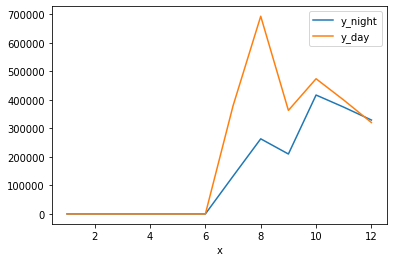

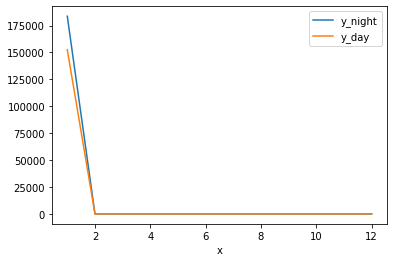

1 month
january nigth
188069.16864586357 january total distance at nigth
152516.26368031124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
188069.16864586357
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
152516.26368031124
0
0
0
0
0
0
0
0
0
0
0


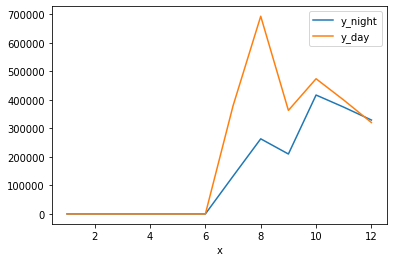

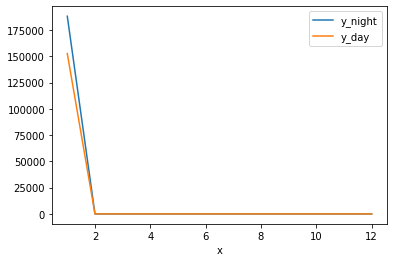

1 month
january nigth
190281.82863978177 january total distance at nigth
152516.26368031124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
190281.82863978177
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
152516.26368031124
0
0
0
0
0
0
0
0
0
0
0


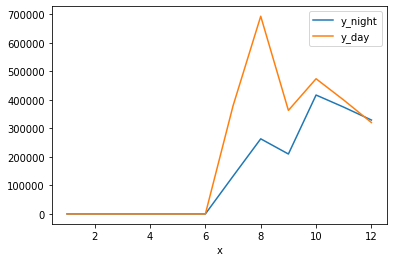

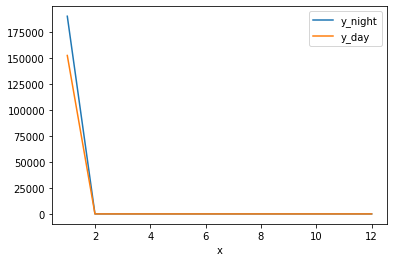

1 month
january nigth
190371.09798595816 january total distance at nigth
152516.26368031124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
190371.09798595816
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
152516.26368031124
0
0
0
0
0
0
0
0
0
0
0


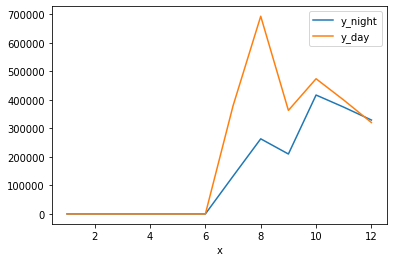

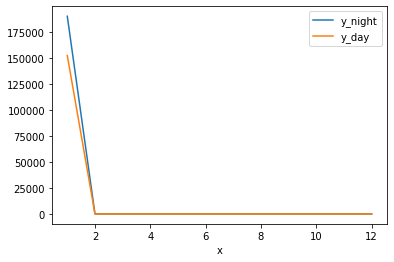

1 month
january day
190371.09798595816 january total distance at nigth
155050.63532585627 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
190371.09798595816
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
155050.63532585627
0
0
0
0
0
0
0
0
0
0
0


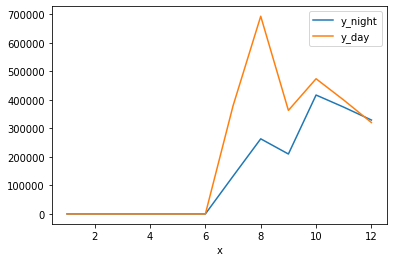

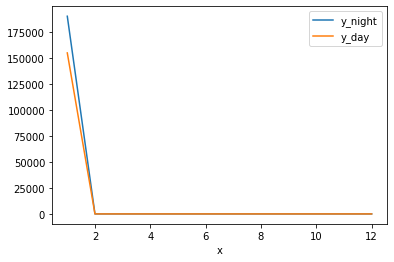

1 month
january nigth
196828.52959432022 january total distance at nigth
155050.63532585627 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
196828.52959432022
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
155050.63532585627
0
0
0
0
0
0
0
0
0
0
0


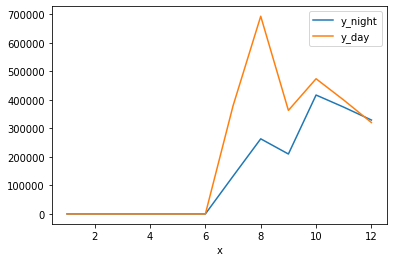

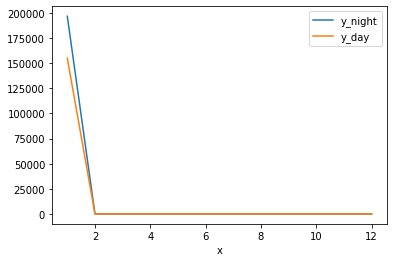

1 month
january nigth
199842.57227079407 january total distance at nigth
155050.63532585627 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
199842.57227079407
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
155050.63532585627
0
0
0
0
0
0
0
0
0
0
0


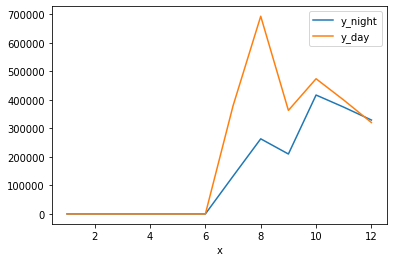

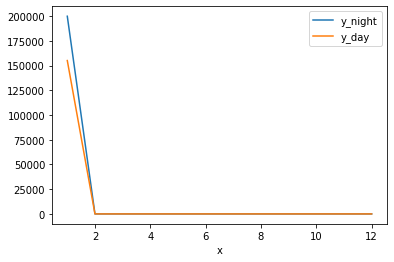

1 month
january nigth
201210.20562747045 january total distance at nigth
155050.63532585627 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
201210.20562747045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
155050.63532585627
0
0
0
0
0
0
0
0
0
0
0


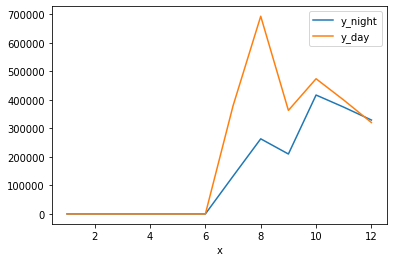

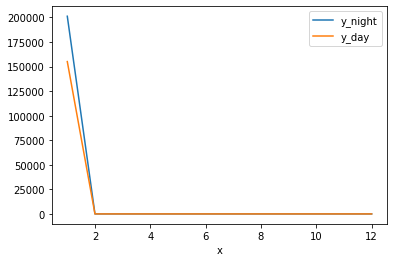

1 month
january nigth
201250.89824736342 january total distance at nigth
155050.63532585627 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
201250.89824736342
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
155050.63532585627
0
0
0
0
0
0
0
0
0
0
0


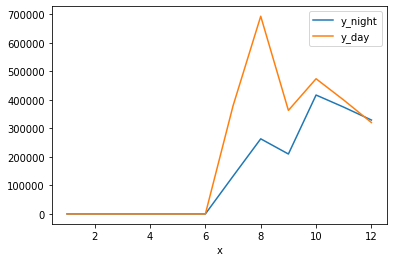

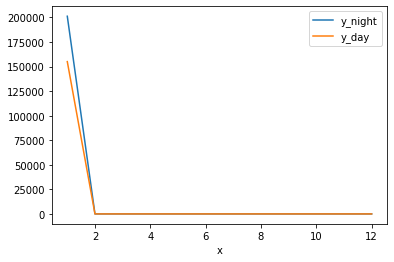

1 month
january day
201250.89824736342 january total distance at nigth
157886.38791586828 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
201250.89824736342
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
157886.38791586828
0
0
0
0
0
0
0
0
0
0
0


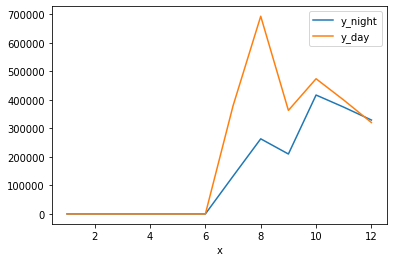

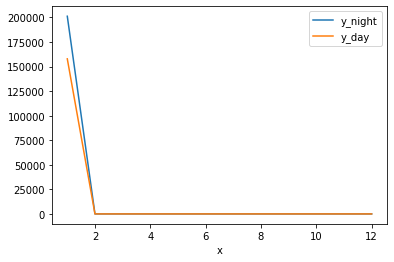

1 month
january day
201250.89824736342 january total distance at nigth
161330.43777756084 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
201250.89824736342
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
161330.43777756084
0
0
0
0
0
0
0
0
0
0
0


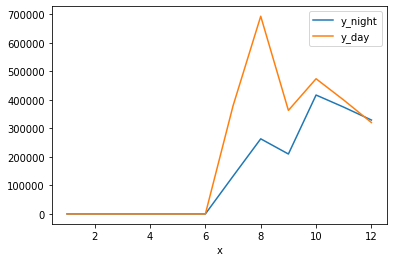

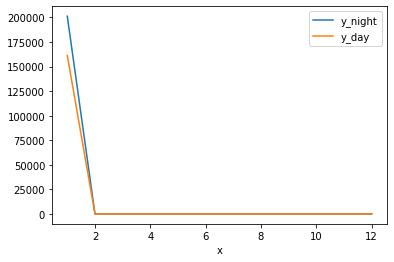

1 month
january day
201250.89824736342 january total distance at nigth
165395.92639797443 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
201250.89824736342
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
165395.92639797443
0
0
0
0
0
0
0
0
0
0
0


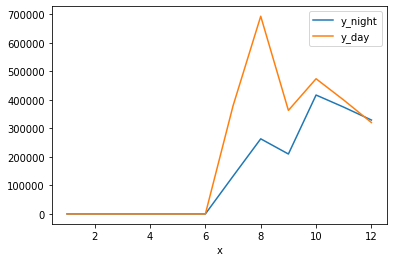

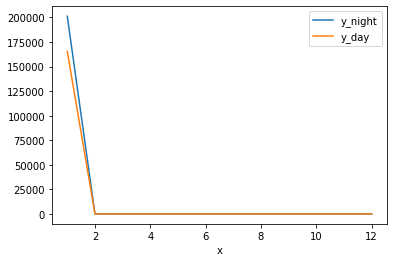

1 month
january nigth
203901.2103658169 january total distance at nigth
165395.92639797443 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
203901.2103658169
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
165395.92639797443
0
0
0
0
0
0
0
0
0
0
0


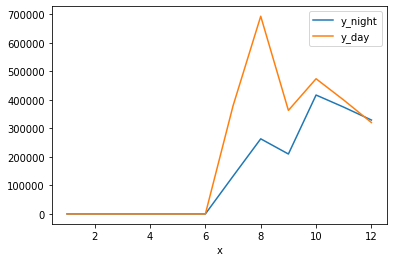

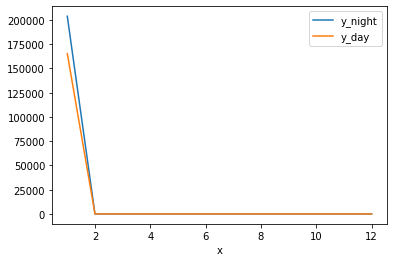

1 month
january nigth
205007.34302553665 january total distance at nigth
165395.92639797443 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
205007.34302553665
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
165395.92639797443
0
0
0
0
0
0
0
0
0
0
0


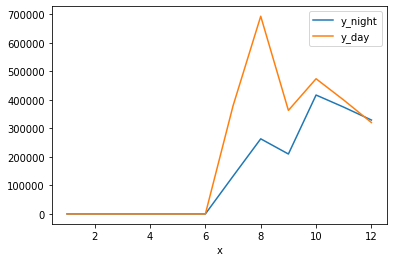

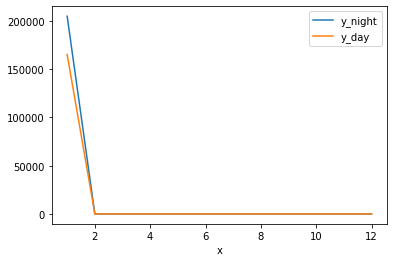

1 month
january nigth
208995.50686359027 january total distance at nigth
165395.92639797443 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
208995.50686359027
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
165395.92639797443
0
0
0
0
0
0
0
0
0
0
0


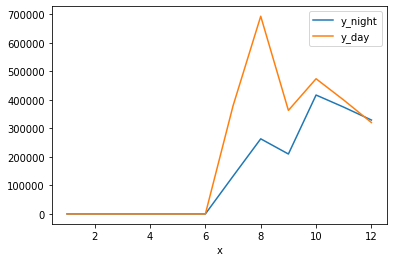

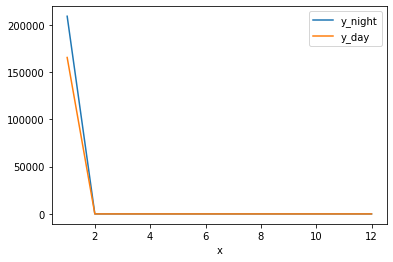

1 month
january nigth
215004.51222697852 january total distance at nigth
165395.92639797443 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
215004.51222697852
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
165395.92639797443
0
0
0
0
0
0
0
0
0
0
0


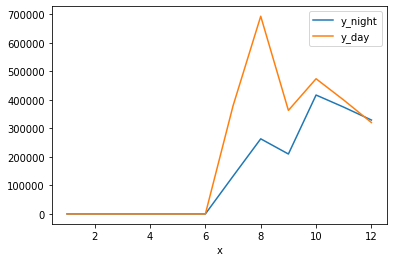

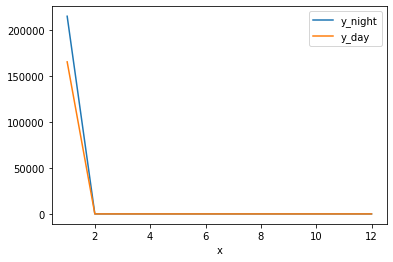

1 month
january day
215004.51222697852 january total distance at nigth
169749.5798895062 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
215004.51222697852
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
169749.5798895062
0
0
0
0
0
0
0
0
0
0
0


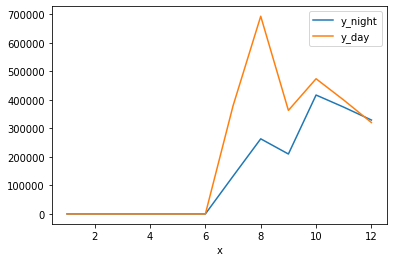

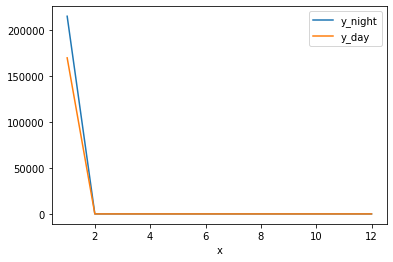

1 month
january day
215004.51222697852 january total distance at nigth
172944.57332073277 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
215004.51222697852
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
172944.57332073277
0
0
0
0
0
0
0
0
0
0
0


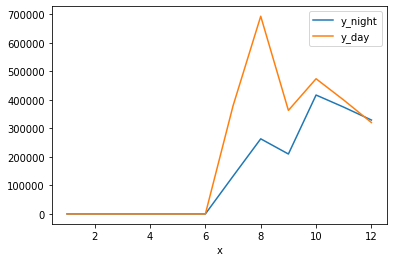

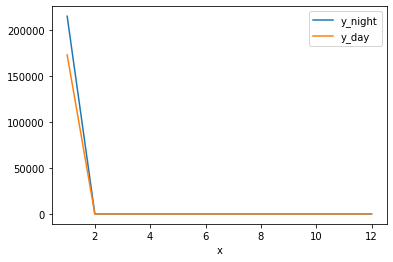

1 month
january nigth
220637.29178773472 january total distance at nigth
172944.57332073277 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
220637.29178773472
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
172944.57332073277
0
0
0
0
0
0
0
0
0
0
0


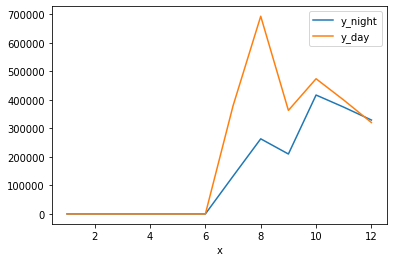

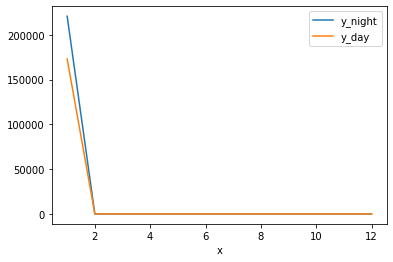

1 month
january nigth
226159.27692591154 january total distance at nigth
172944.57332073277 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
226159.27692591154
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
172944.57332073277
0
0
0
0
0
0
0
0
0
0
0


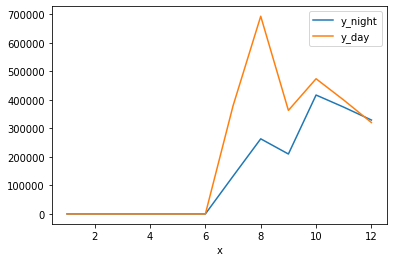

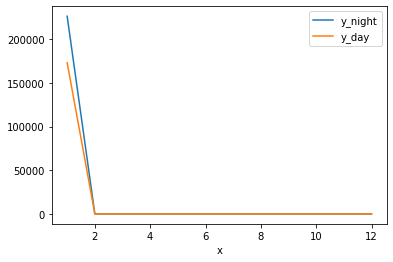

1 month
january nigth
226236.8621015041 january total distance at nigth
172944.57332073277 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
226236.8621015041
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
172944.57332073277
0
0
0
0
0
0
0
0
0
0
0


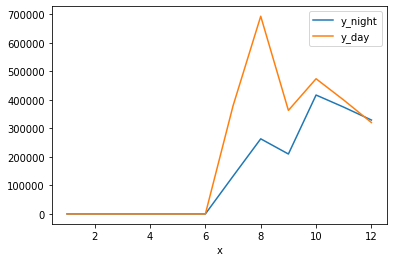

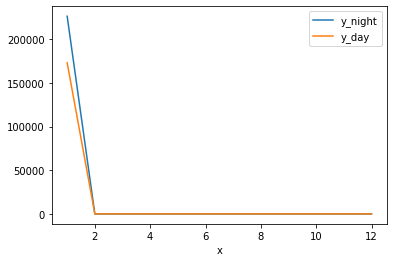

1 month
january day
226236.8621015041 january total distance at nigth
179303.2074115392 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
226236.8621015041
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
179303.2074115392
0
0
0
0
0
0
0
0
0
0
0


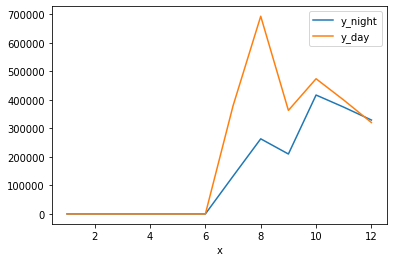

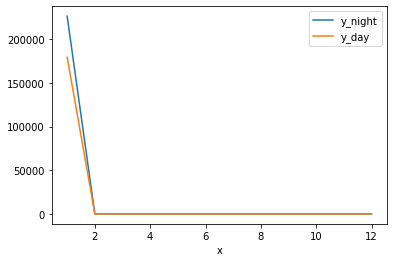

1 month
january day
226236.8621015041 january total distance at nigth
179454.7433039894 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
226236.8621015041
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
179454.7433039894
0
0
0
0
0
0
0
0
0
0
0


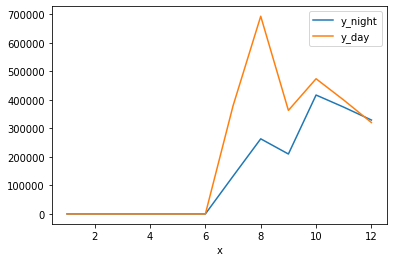

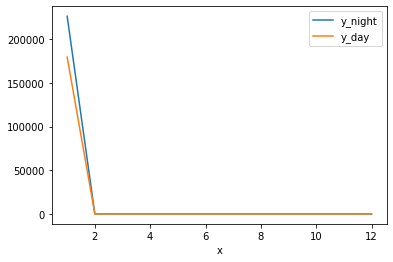

1 month
january day
226236.8621015041 january total distance at nigth
180683.47027602745 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
226236.8621015041
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
180683.47027602745
0
0
0
0
0
0
0
0
0
0
0


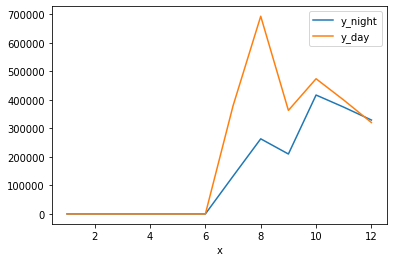

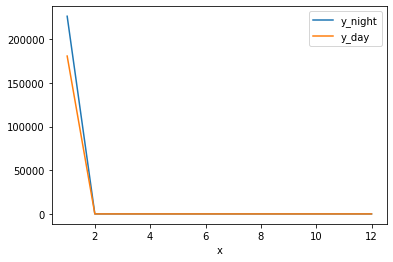

1 month
january day
226236.8621015041 january total distance at nigth
184613.83017765192 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
226236.8621015041
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
184613.83017765192
0
0
0
0
0
0
0
0
0
0
0


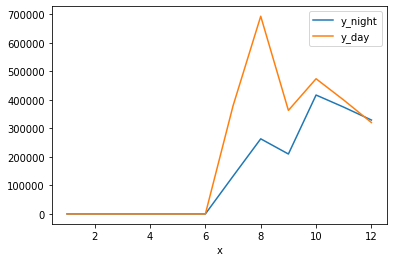

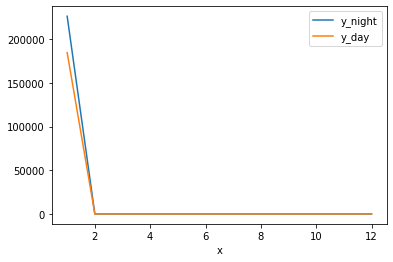

1 month
january day
226236.8621015041 january total distance at nigth
185612.30733917153 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
226236.8621015041
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
185612.30733917153
0
0
0
0
0
0
0
0
0
0
0


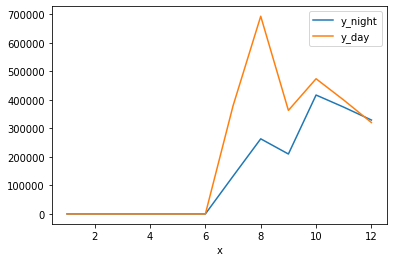

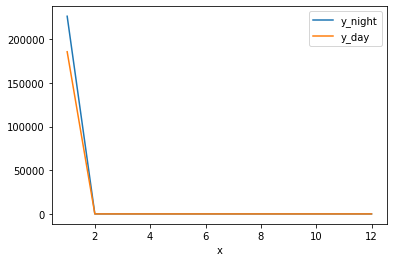

1 month
january day
226236.8621015041 january total distance at nigth
187684.96612342063 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
226236.8621015041
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
187684.96612342063
0
0
0
0
0
0
0
0
0
0
0


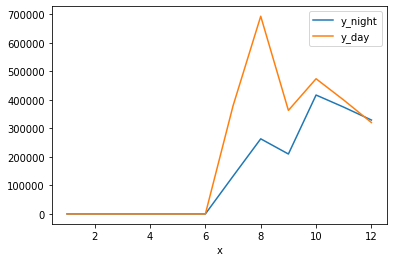

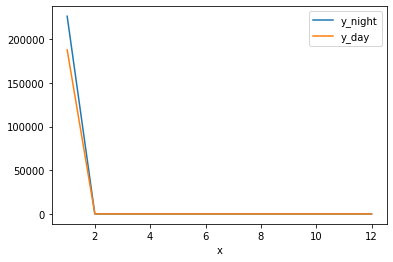

1 month
january nigth
231284.36675025418 january total distance at nigth
187684.96612342063 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
231284.36675025418
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
187684.96612342063
0
0
0
0
0
0
0
0
0
0
0


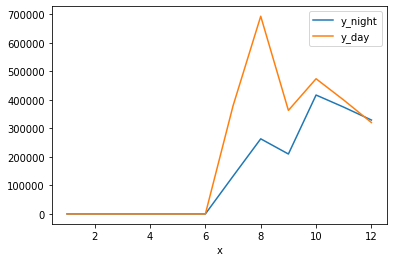

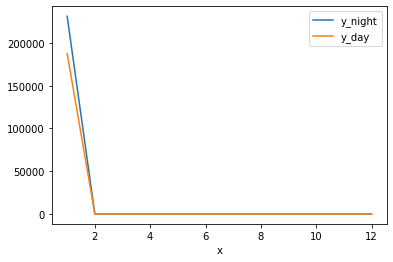

1 month
january nigth
231608.21191562462 january total distance at nigth
187684.96612342063 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
231608.21191562462
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
187684.96612342063
0
0
0
0
0
0
0
0
0
0
0


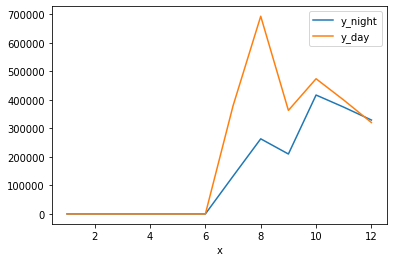

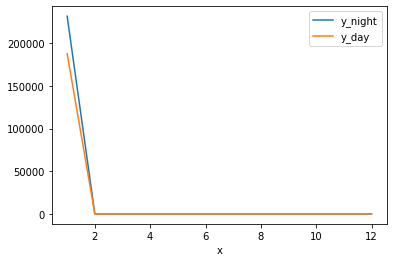

1 month
january nigth
235177.14889117132 january total distance at nigth
187684.96612342063 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
235177.14889117132
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
187684.96612342063
0
0
0
0
0
0
0
0
0
0
0


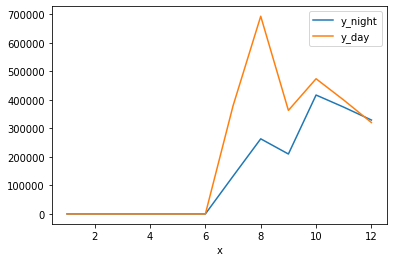

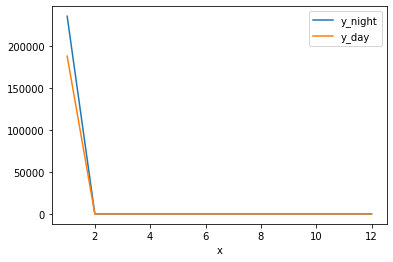

1 month
january nigth
237116.62463690643 january total distance at nigth
187684.96612342063 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
237116.62463690643
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
187684.96612342063
0
0
0
0
0
0
0
0
0
0
0


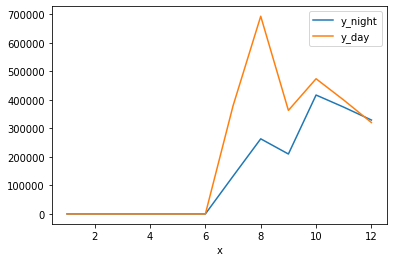

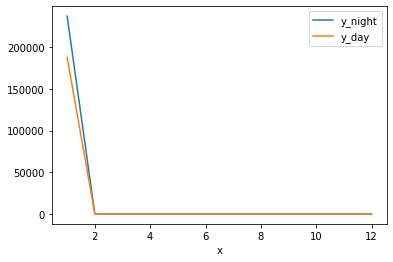

1 month
january nigth
238470.039252533 january total distance at nigth
187684.96612342063 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
238470.039252533
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
187684.96612342063
0
0
0
0
0
0
0
0
0
0
0


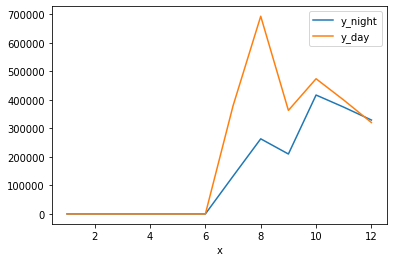

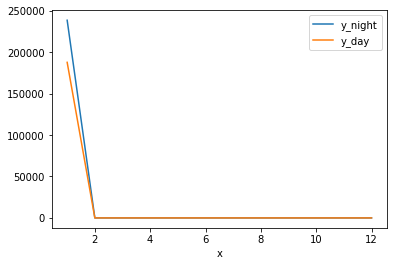

1 month
january day
238470.039252533 january total distance at nigth
197323.6003868642 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
238470.039252533
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
197323.6003868642
0
0
0
0
0
0
0
0
0
0
0


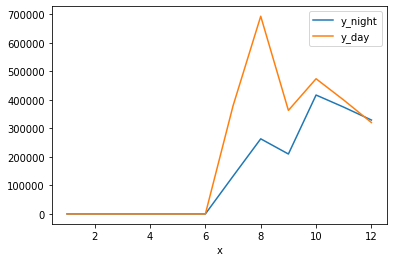

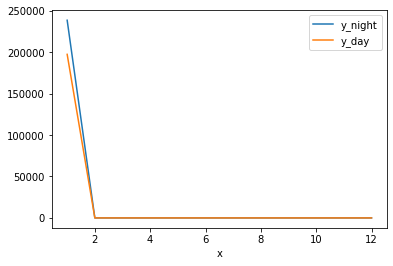

1 month
january nigth
244053.2226945667 january total distance at nigth
197323.6003868642 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
244053.2226945667
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
197323.6003868642
0
0
0
0
0
0
0
0
0
0
0


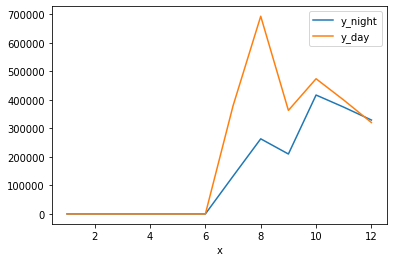

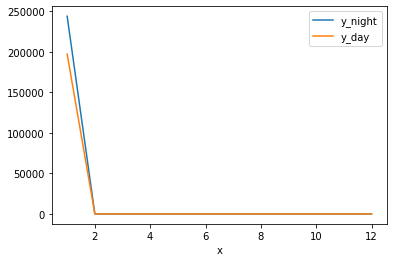

1 month
january nigth
244089.76467014212 january total distance at nigth
197323.6003868642 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
244089.76467014212
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
197323.6003868642
0
0
0
0
0
0
0
0
0
0
0


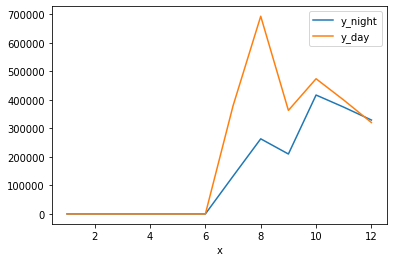

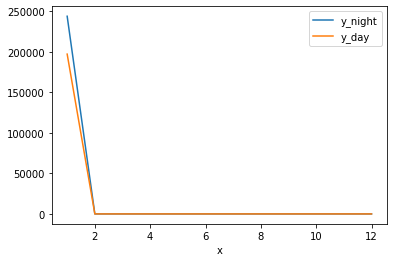

1 month
january nigth
244737.48554809252 january total distance at nigth
197323.6003868642 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
244737.48554809252
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
197323.6003868642
0
0
0
0
0
0
0
0
0
0
0


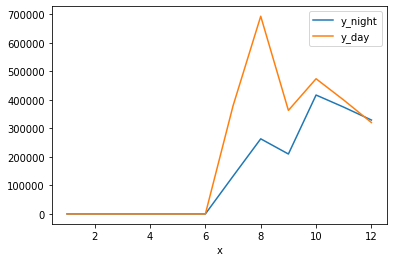

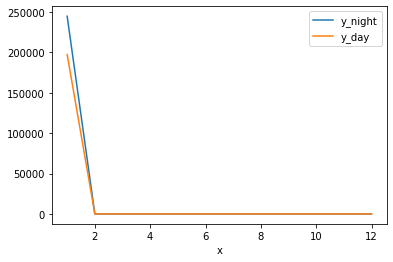

1 month
january nigth
247025.37432406563 january total distance at nigth
197323.6003868642 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
247025.37432406563
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
197323.6003868642
0
0
0
0
0
0
0
0
0
0
0


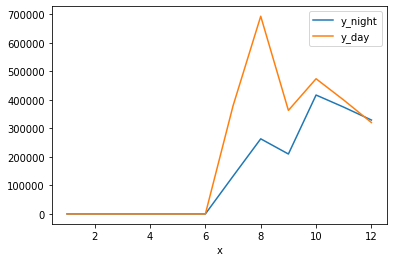

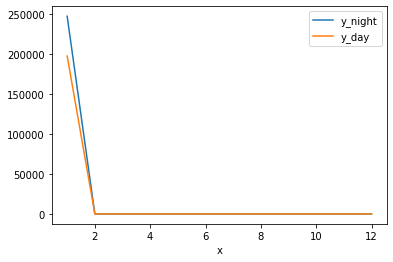

1 month
january day
247025.37432406563 january total distance at nigth
201660.78511150467 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
247025.37432406563
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
201660.78511150467
0
0
0
0
0
0
0
0
0
0
0


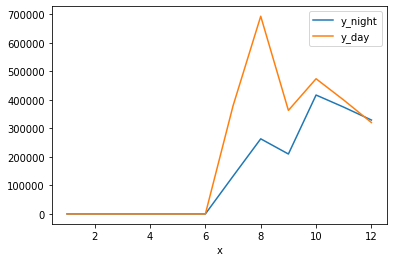

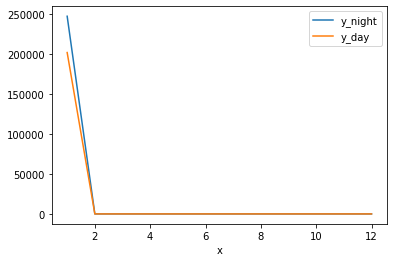

1 month
january day
247025.37432406563 january total distance at nigth
207503.3762098175 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
247025.37432406563
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
207503.3762098175
0
0
0
0
0
0
0
0
0
0
0


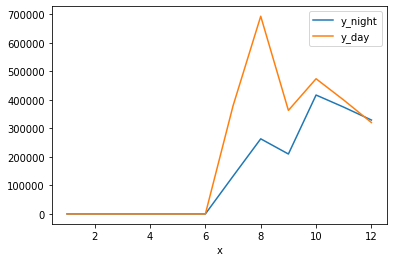

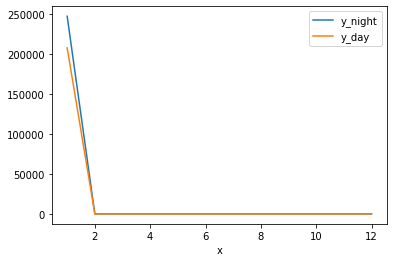

1 month
january day
247025.37432406563 january total distance at nigth
210429.3628668668 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
247025.37432406563
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
210429.3628668668
0
0
0
0
0
0
0
0
0
0
0


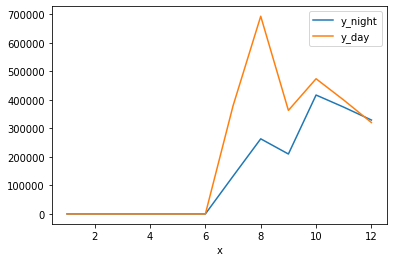

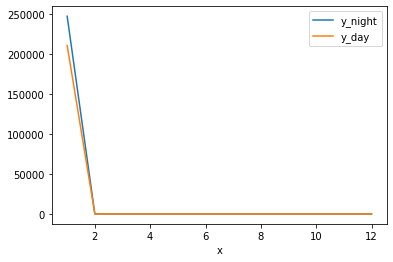

1 month
january day
247025.37432406563 january total distance at nigth
211663.19402182775 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
247025.37432406563
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
211663.19402182775
0
0
0
0
0
0
0
0
0
0
0


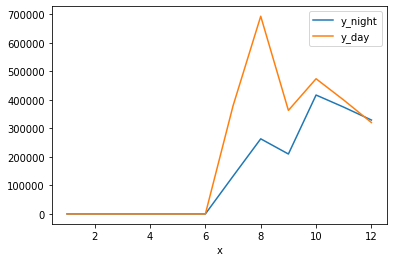

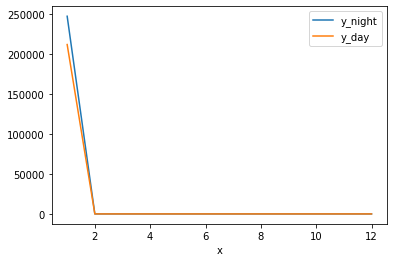

1 month
january nigth
248330.46980962178 january total distance at nigth
211663.19402182775 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
248330.46980962178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
211663.19402182775
0
0
0
0
0
0
0
0
0
0
0


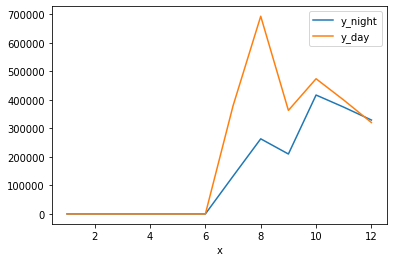

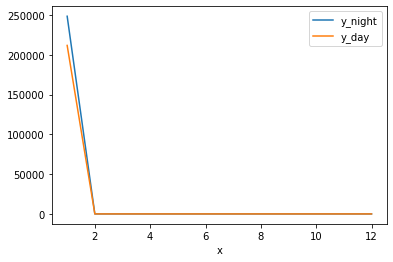

1 month
january nigth
250509.08389034218 january total distance at nigth
211663.19402182775 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
250509.08389034218
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
211663.19402182775
0
0
0
0
0
0
0
0
0
0
0


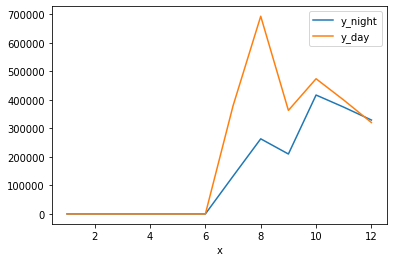

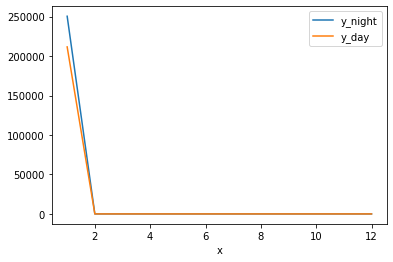

1 month
january nigth
254637.2273521063 january total distance at nigth
211663.19402182775 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
254637.2273521063
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
211663.19402182775
0
0
0
0
0
0
0
0
0
0
0


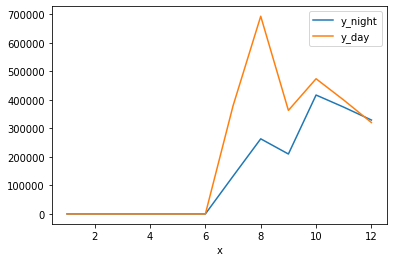

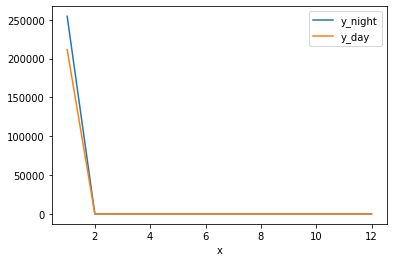

1 month
january nigth
254736.74856121454 january total distance at nigth
211663.19402182775 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
254736.74856121454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
211663.19402182775
0
0
0
0
0
0
0
0
0
0
0


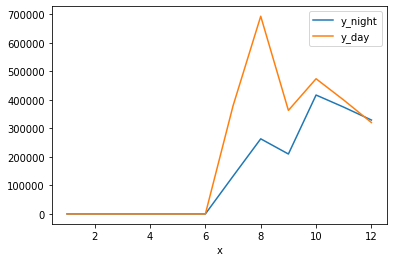

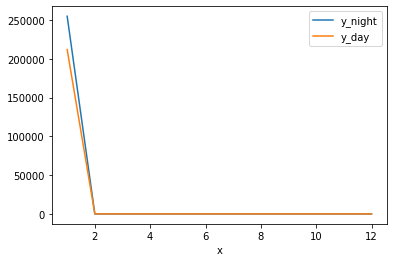

1 month
january day
254736.74856121454 january total distance at nigth
214943.0970407305 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
254736.74856121454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
214943.0970407305
0
0
0
0
0
0
0
0
0
0
0


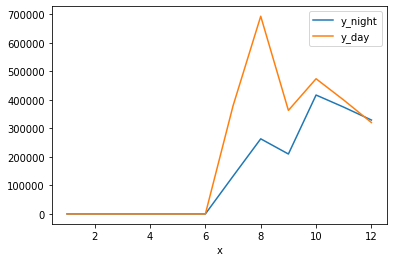

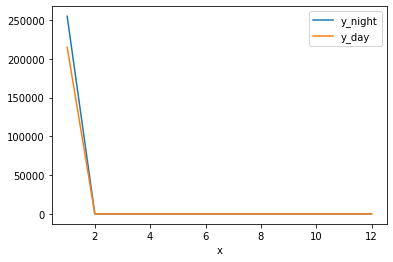

1 month
january day
254736.74856121454 january total distance at nigth
214982.12626180847 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
254736.74856121454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
214982.12626180847
0
0
0
0
0
0
0
0
0
0
0


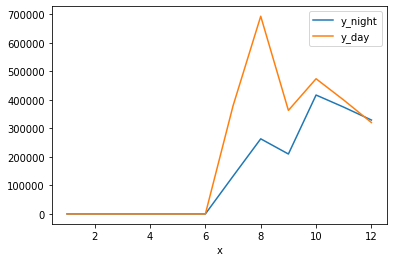

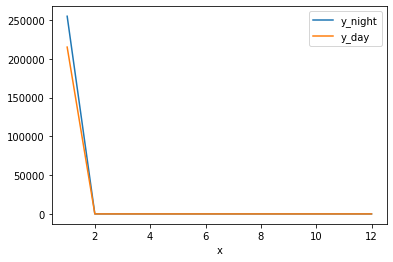

1 month
january day
254736.74856121454 january total distance at nigth
218236.22193607793 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
254736.74856121454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
218236.22193607793
0
0
0
0
0
0
0
0
0
0
0


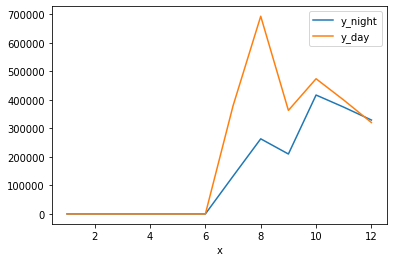

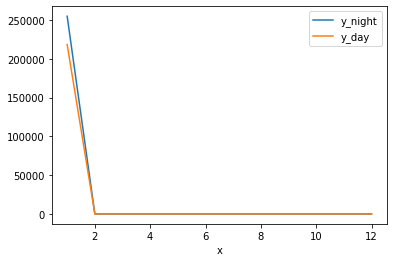

1 month
january day
254736.74856121454 january total distance at nigth
220971.91523163865 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
254736.74856121454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
220971.91523163865
0
0
0
0
0
0
0
0
0
0
0


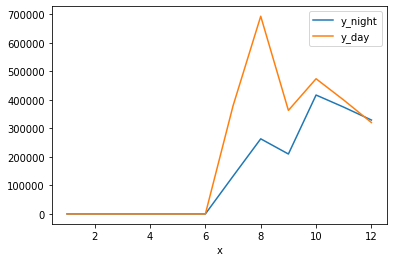

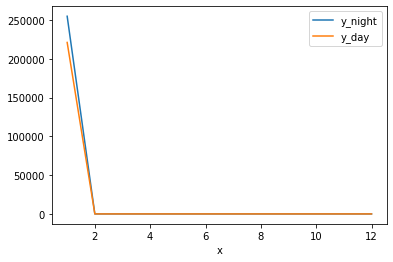

1 month
january day
254736.74856121454 january total distance at nigth
223078.3195860124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
254736.74856121454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
223078.3195860124
0
0
0
0
0
0
0
0
0
0
0


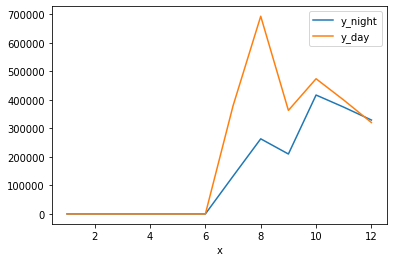

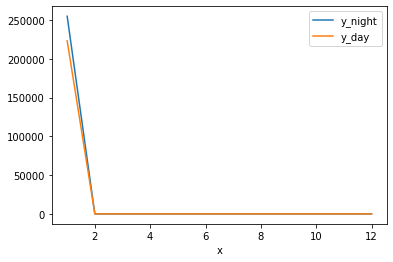

1 month
january nigth
256437.81338829082 january total distance at nigth
223078.3195860124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
256437.81338829082
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
223078.3195860124
0
0
0
0
0
0
0
0
0
0
0


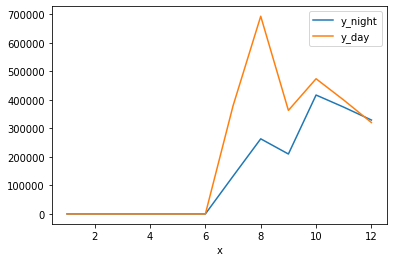

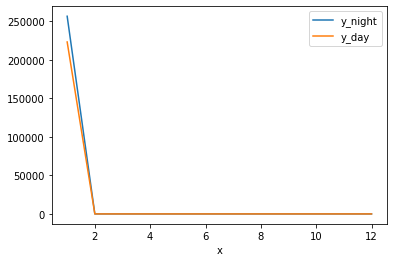

1 month
january nigth
258117.9968388682 january total distance at nigth
223078.3195860124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
258117.9968388682
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
223078.3195860124
0
0
0
0
0
0
0
0
0
0
0


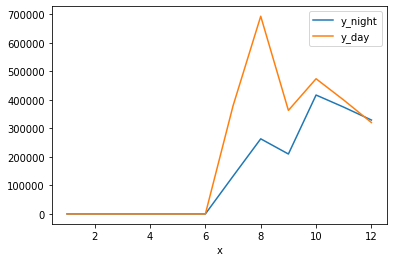

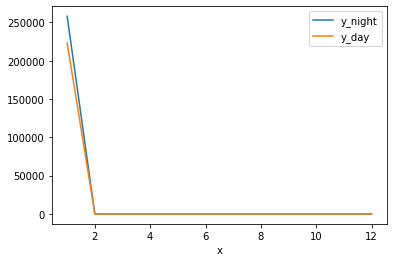

1 month
january nigth
258732.44353006905 january total distance at nigth
223078.3195860124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
258732.44353006905
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
223078.3195860124
0
0
0
0
0
0
0
0
0
0
0


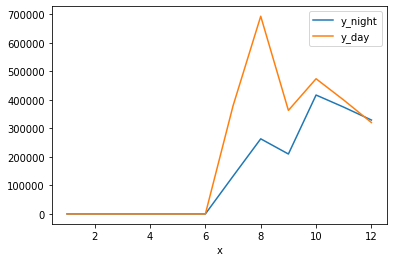

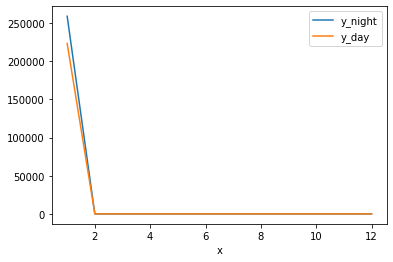

1 month
january nigth
259291.71028714257 january total distance at nigth
223078.3195860124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
259291.71028714257
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
223078.3195860124
0
0
0
0
0
0
0
0
0
0
0


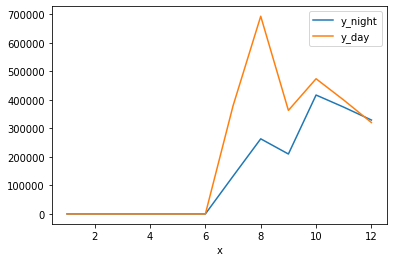

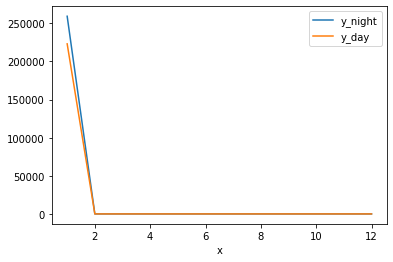

1 month
january nigth
259319.42181777544 january total distance at nigth
223078.3195860124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
259319.42181777544
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
223078.3195860124
0
0
0
0
0
0
0
0
0
0
0


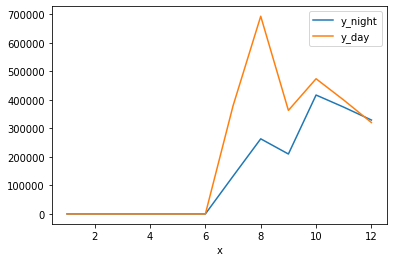

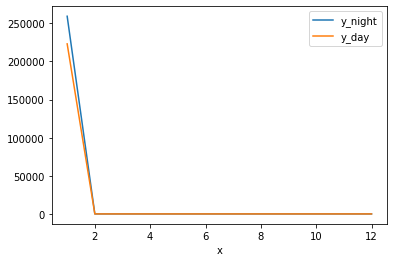

1 month
january nigth
261115.5683176448 january total distance at nigth
223078.3195860124 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
261115.5683176448
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
223078.3195860124
0
0
0
0
0
0
0
0
0
0
0


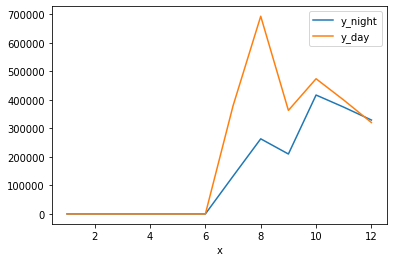

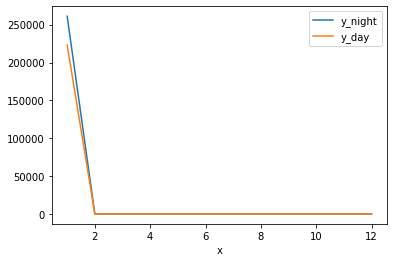

1 month
january day
261115.5683176448 january total distance at nigth
224898.42291638503 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
261115.5683176448
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
224898.42291638503
0
0
0
0
0
0
0
0
0
0
0


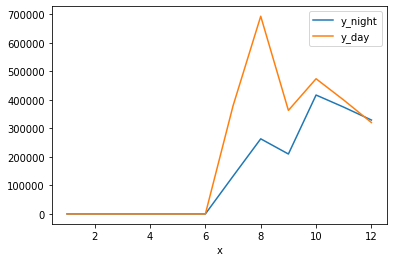

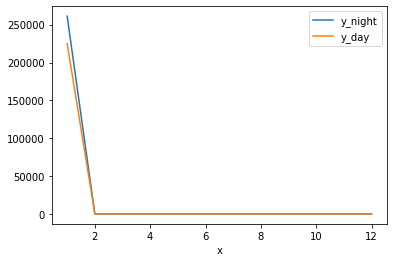

1 month
january day
261115.5683176448 january total distance at nigth
226146.99681203003 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
261115.5683176448
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
226146.99681203003
0
0
0
0
0
0
0
0
0
0
0


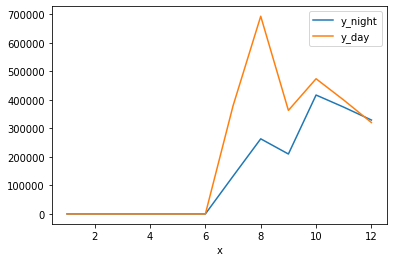

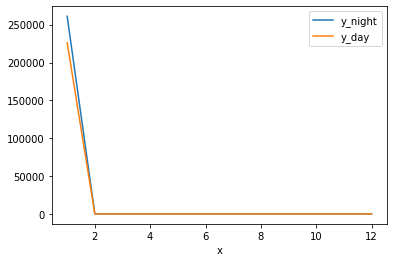

1 month
january day
261115.5683176448 january total distance at nigth
227388.28228671782 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
261115.5683176448
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
227388.28228671782
0
0
0
0
0
0
0
0
0
0
0


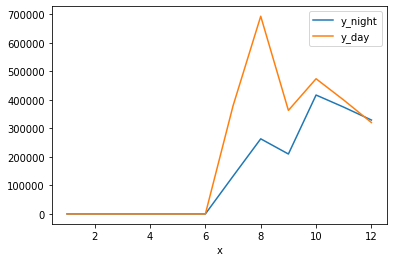

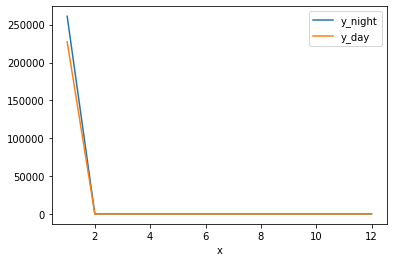

1 month
january day
261115.5683176448 january total distance at nigth
228207.8942117547 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
261115.5683176448
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
228207.8942117547
0
0
0
0
0
0
0
0
0
0
0


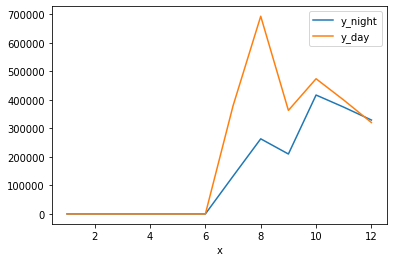

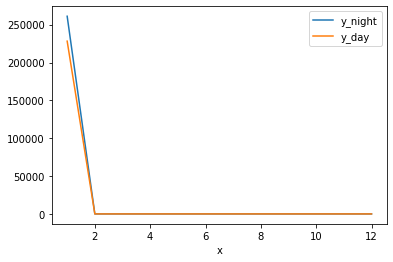

1 month
january day
261115.5683176448 january total distance at nigth
229532.14325562064 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
261115.5683176448
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
229532.14325562064
0
0
0
0
0
0
0
0
0
0
0


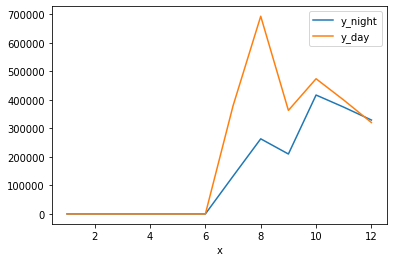

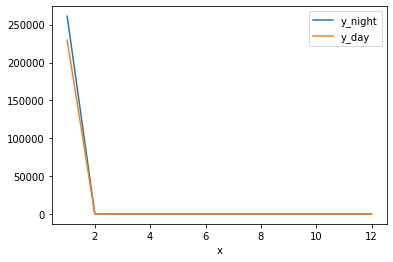

1 month
january nigth
263969.56411674526 january total distance at nigth
229532.14325562064 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
263969.56411674526
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
229532.14325562064
0
0
0
0
0
0
0
0
0
0
0


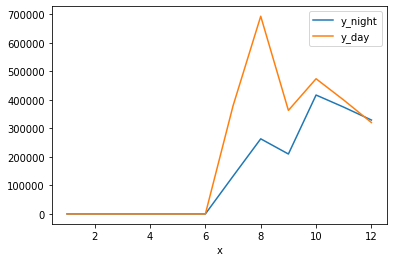

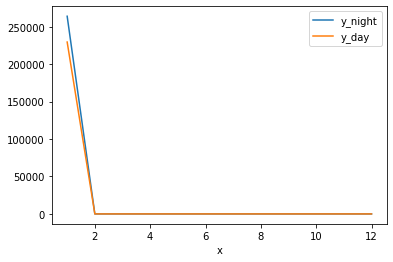

1 month
january nigth
267825.8878831407 january total distance at nigth
229532.14325562064 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
267825.8878831407
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
229532.14325562064
0
0
0
0
0
0
0
0
0
0
0


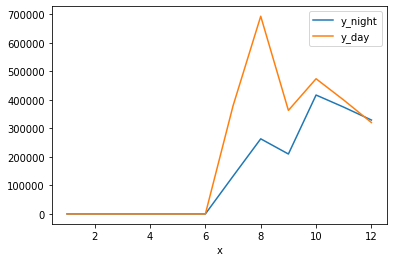

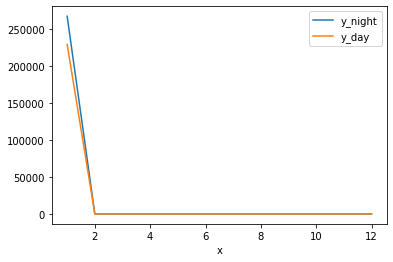

1 month
january nigth
269158.6326823456 january total distance at nigth
229532.14325562064 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
269158.6326823456
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
229532.14325562064
0
0
0
0
0
0
0
0
0
0
0


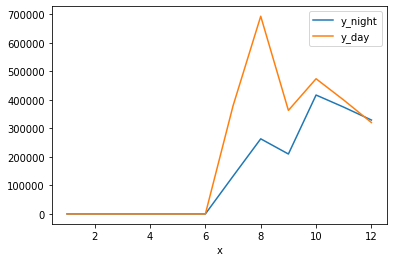

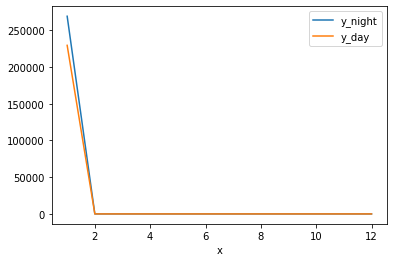

1 month
january nigth
269761.8121158006 january total distance at nigth
229532.14325562064 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
269761.8121158006
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
229532.14325562064
0
0
0
0
0
0
0
0
0
0
0


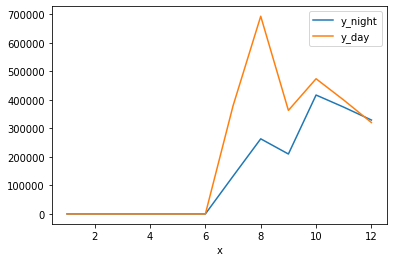

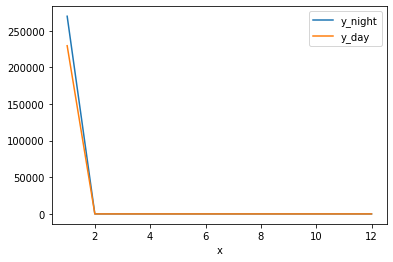

1 month
january nigth
272128.56859264645 january total distance at nigth
229532.14325562064 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
272128.56859264645
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
229532.14325562064
0
0
0
0
0
0
0
0
0
0
0


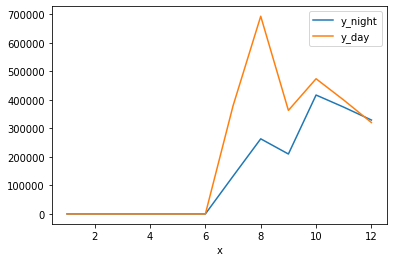

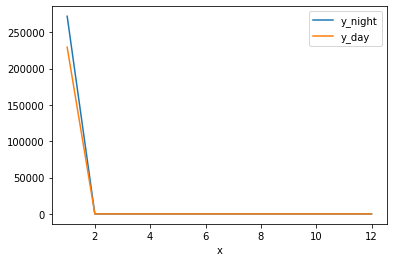

1 month
january nigth
277851.9755278454 january total distance at nigth
229532.14325562064 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
277851.9755278454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
229532.14325562064
0
0
0
0
0
0
0
0
0
0
0


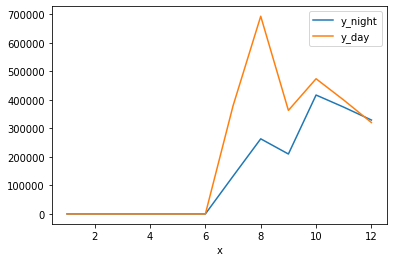

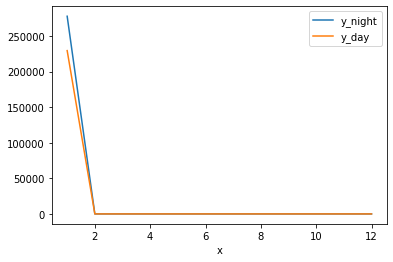

1 month
january day
277851.9755278454 january total distance at nigth
238214.7700445034 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
277851.9755278454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
238214.7700445034
0
0
0
0
0
0
0
0
0
0
0


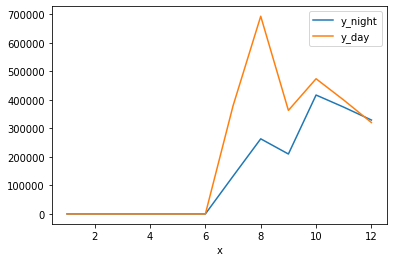

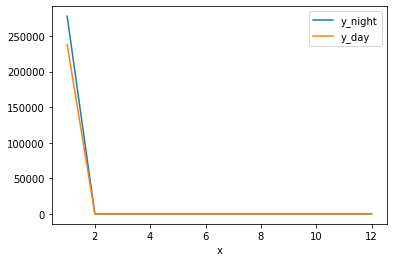

1 month
january day
277851.9755278454 january total distance at nigth
240265.11658711612 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
277851.9755278454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
240265.11658711612
0
0
0
0
0
0
0
0
0
0
0


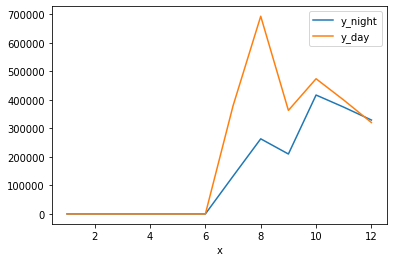

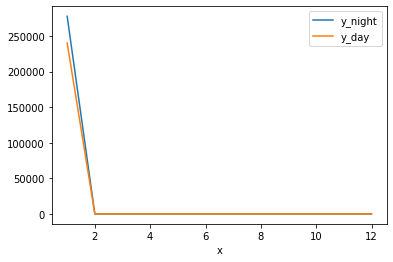

1 month
january day
277851.9755278454 january total distance at nigth
244595.83775978413 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
277851.9755278454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
244595.83775978413
0
0
0
0
0
0
0
0
0
0
0


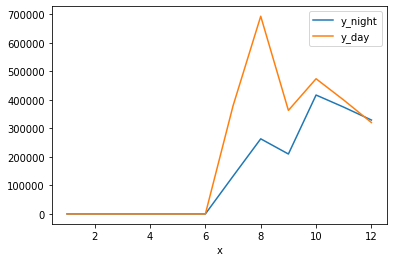

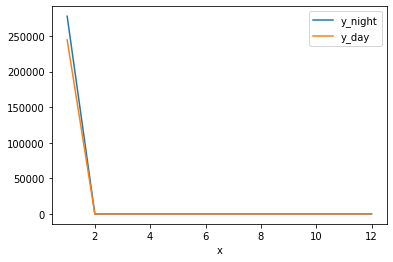

1 month
january day
277851.9755278454 january total distance at nigth
246604.06170636232 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
277851.9755278454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
246604.06170636232
0
0
0
0
0
0
0
0
0
0
0


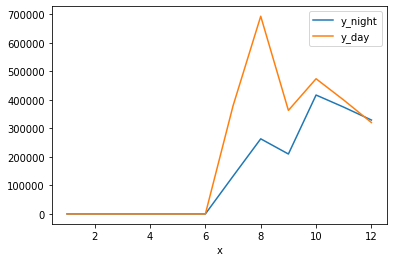

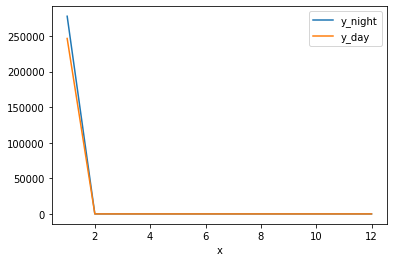

1 month
january day
277851.9755278454 january total distance at nigth
248942.3844409099 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
277851.9755278454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
248942.3844409099
0
0
0
0
0
0
0
0
0
0
0


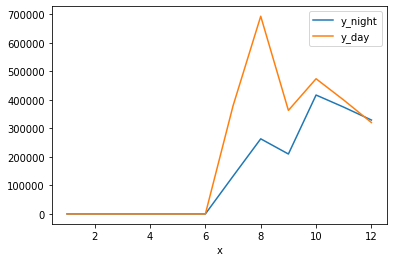

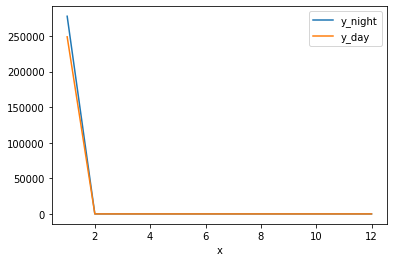

1 month
january nigth
284361.0134658104 january total distance at nigth
248942.3844409099 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
284361.0134658104
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
248942.3844409099
0
0
0
0
0
0
0
0
0
0
0


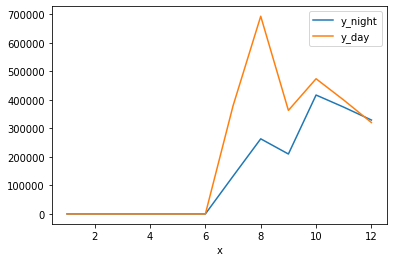

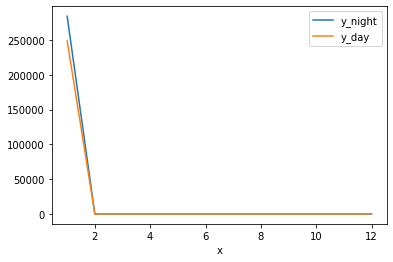

1 month
january nigth
289042.3315493985 january total distance at nigth
248942.3844409099 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
289042.3315493985
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
248942.3844409099
0
0
0
0
0
0
0
0
0
0
0


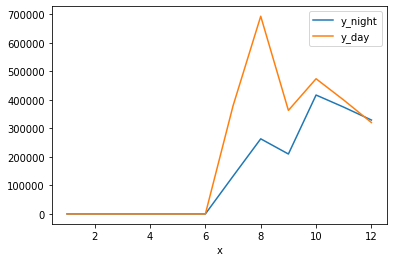

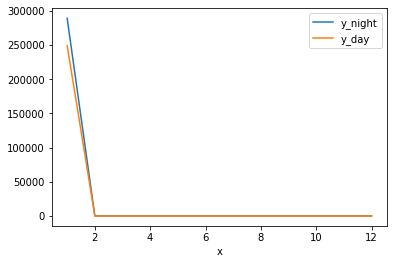

1 month
january nigth
292496.19245651114 january total distance at nigth
248942.3844409099 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
292496.19245651114
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
248942.3844409099
0
0
0
0
0
0
0
0
0
0
0


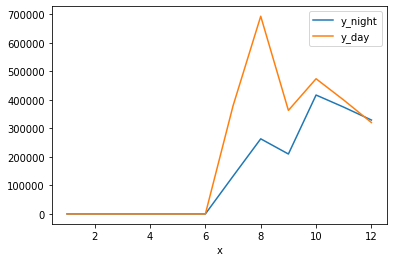

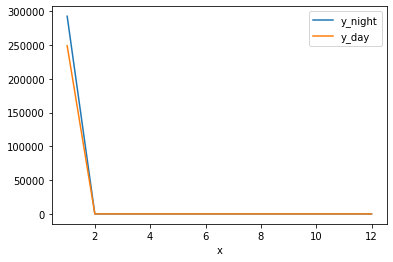

1 month
january nigth
296765.9880163189 january total distance at nigth
248942.3844409099 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
296765.9880163189
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
248942.3844409099
0
0
0
0
0
0
0
0
0
0
0


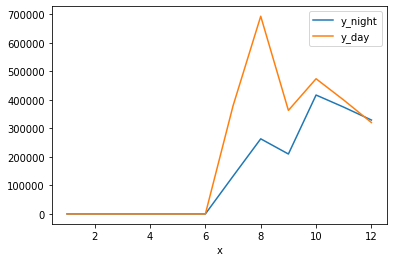

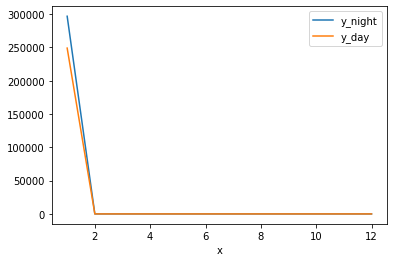

1 month
january nigth
297151.37031139666 january total distance at nigth
248942.3844409099 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
297151.37031139666
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
248942.3844409099
0
0
0
0
0
0
0
0
0
0
0


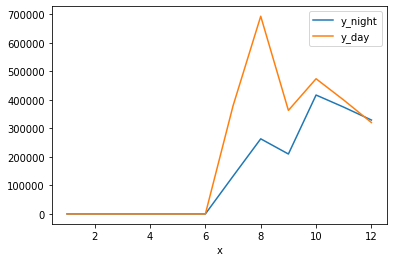

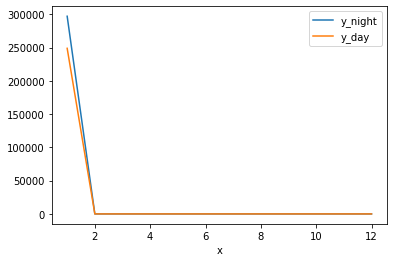

1 month
january nigth
302589.53704798524 january total distance at nigth
248942.3844409099 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
302589.53704798524
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
248942.3844409099
0
0
0
0
0
0
0
0
0
0
0


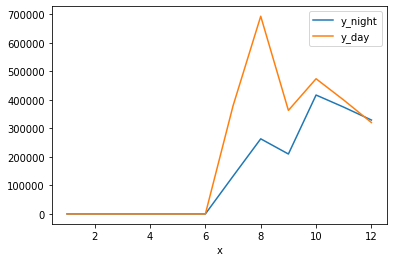

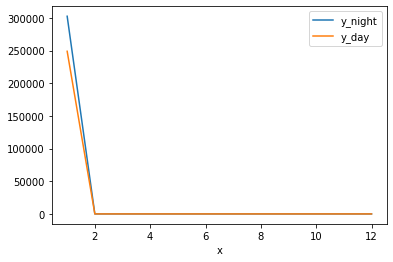

1 month
january nigth
308633.8581082773 january total distance at nigth
248942.3844409099 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
308633.8581082773
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
248942.3844409099
0
0
0
0
0
0
0
0
0
0
0


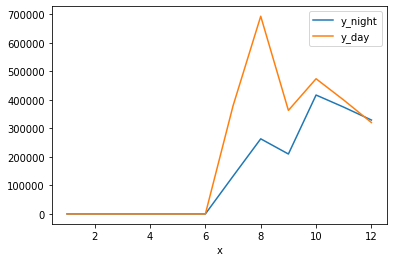

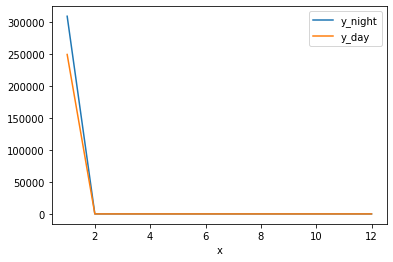

1 month
january nigth
308723.62179345445 january total distance at nigth
248942.3844409099 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
308723.62179345445
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
248942.3844409099
0
0
0
0
0
0
0
0
0
0
0


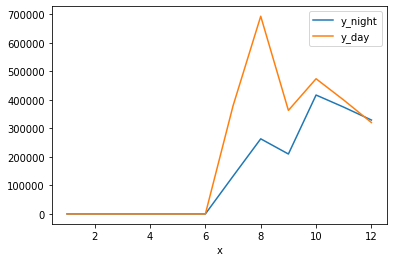

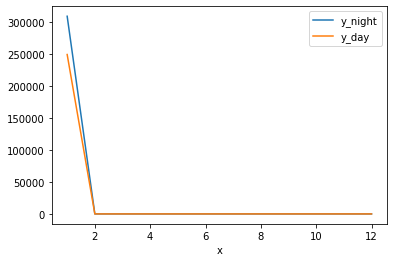

1 month
january day
308723.62179345445 january total distance at nigth
252822.60532670023 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
308723.62179345445
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
252822.60532670023
0
0
0
0
0
0
0
0
0
0
0


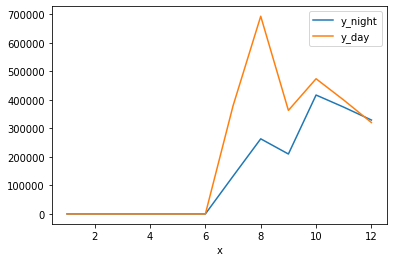

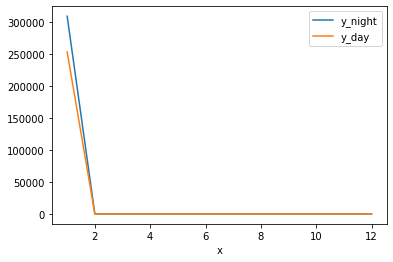

1 month
january day
308723.62179345445 january total distance at nigth
254572.56325981277 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
308723.62179345445
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
254572.56325981277
0
0
0
0
0
0
0
0
0
0
0


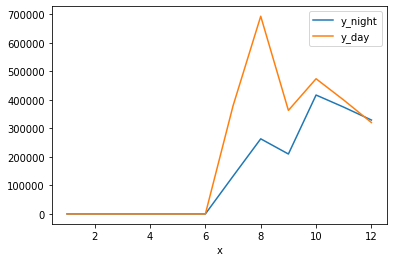

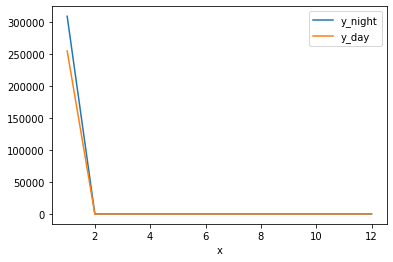

1 month
january day
308723.62179345445 january total distance at nigth
257261.3152999418 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
308723.62179345445
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
257261.3152999418
0
0
0
0
0
0
0
0
0
0
0


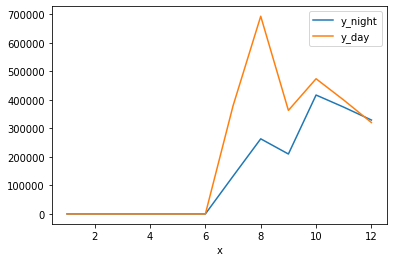

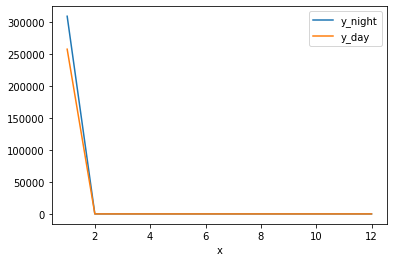

1 month
january day
308723.62179345445 january total distance at nigth
260308.28415289323 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
308723.62179345445
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
260308.28415289323
0
0
0
0
0
0
0
0
0
0
0


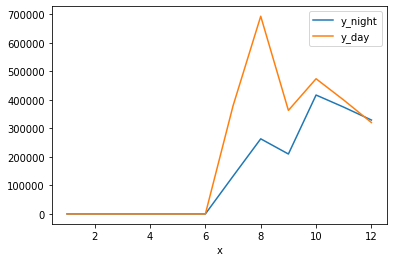

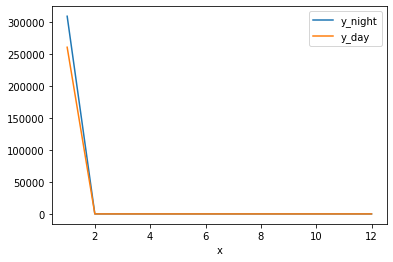

1 month
january day
308723.62179345445 january total distance at nigth
263224.56279552646 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
308723.62179345445
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
263224.56279552646
0
0
0
0
0
0
0
0
0
0
0


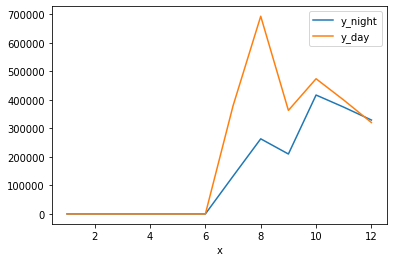

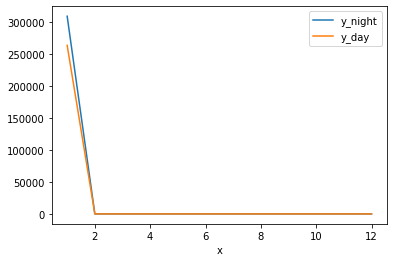

1 month
january nigth
314963.9354346227 january total distance at nigth
263224.56279552646 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
314963.9354346227
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
263224.56279552646
0
0
0
0
0
0
0
0
0
0
0


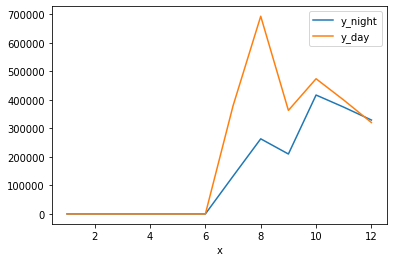

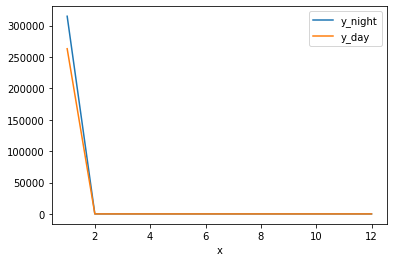

1 month
january nigth
316842.22051184496 january total distance at nigth
263224.56279552646 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
316842.22051184496
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
263224.56279552646
0
0
0
0
0
0
0
0
0
0
0


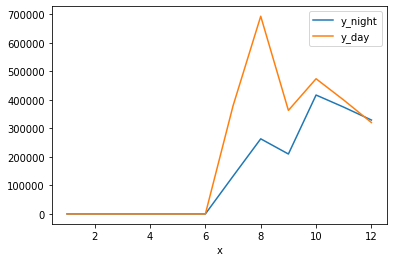

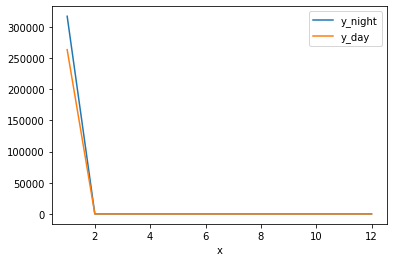

1 month
january nigth
321247.4635887805 january total distance at nigth
263224.56279552646 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
321247.4635887805
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
263224.56279552646
0
0
0
0
0
0
0
0
0
0
0


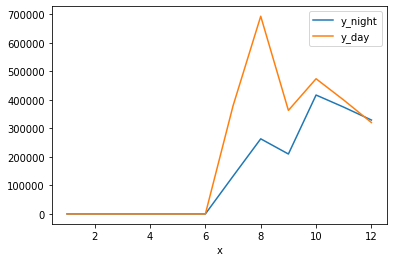

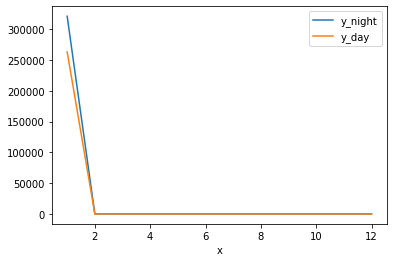

1 month
january nigth
323274.1441169648 january total distance at nigth
263224.56279552646 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
323274.1441169648
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
263224.56279552646
0
0
0
0
0
0
0
0
0
0
0


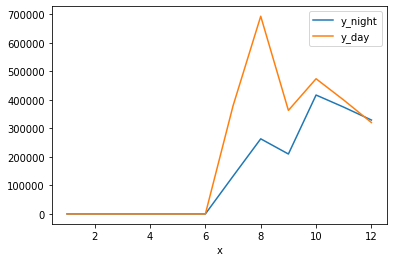

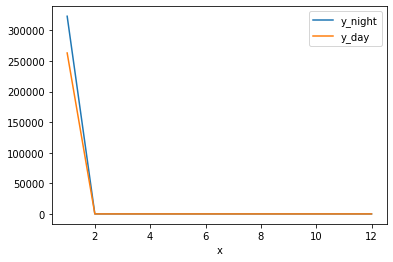

1 month
january nigth
332957.1199723511 january total distance at nigth
263224.56279552646 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
332957.1199723511
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
263224.56279552646
0
0
0
0
0
0
0
0
0
0
0


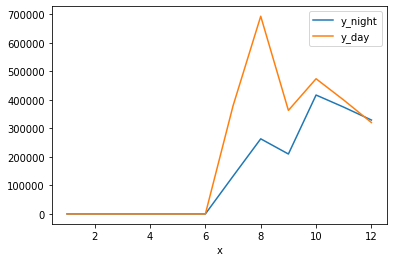

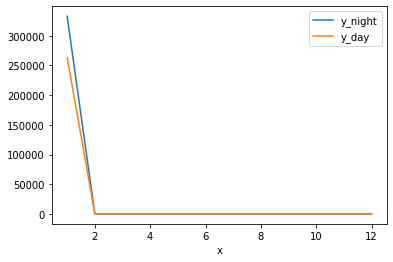

1 month
january day
332957.1199723511 january total distance at nigth
267671.954433707 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
332957.1199723511
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
267671.954433707
0
0
0
0
0
0
0
0
0
0
0


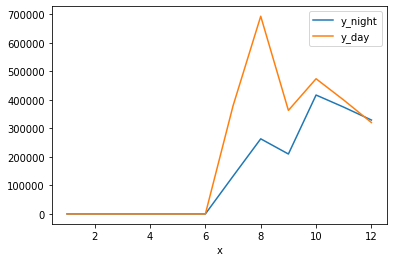

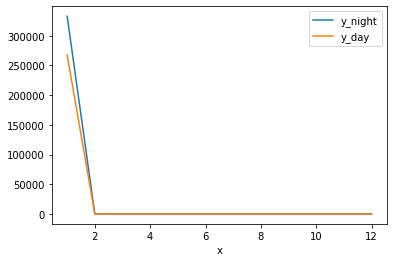

1 month
january day
332957.1199723511 january total distance at nigth
276203.4204037181 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
332957.1199723511
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
276203.4204037181
0
0
0
0
0
0
0
0
0
0
0


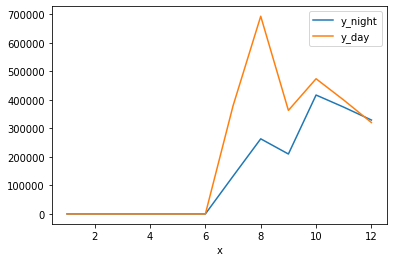

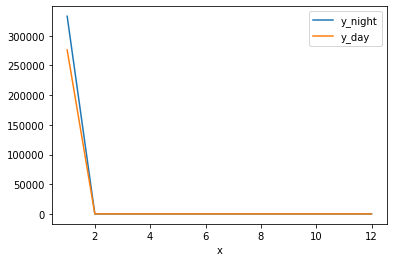

1 month
january day
332957.1199723511 january total distance at nigth
279065.14886484545 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
332957.1199723511
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
279065.14886484545
0
0
0
0
0
0
0
0
0
0
0


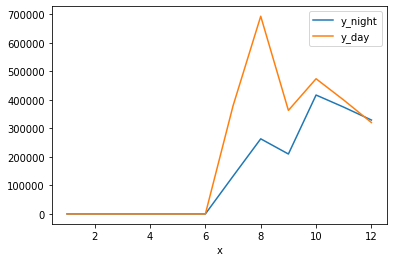

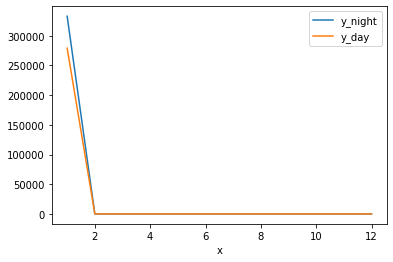

1 month
january day
332957.1199723511 january total distance at nigth
282807.11554590834 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
332957.1199723511
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
282807.11554590834
0
0
0
0
0
0
0
0
0
0
0


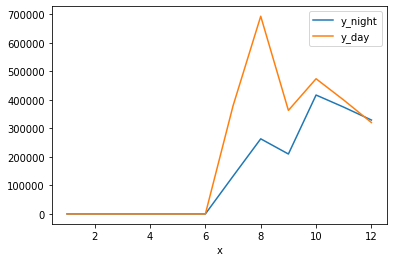

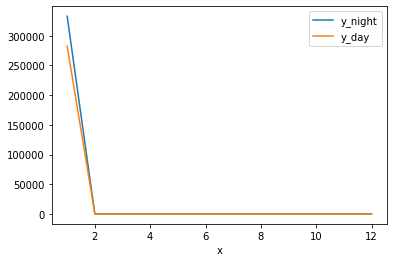

1 month
january day
332957.1199723511 january total distance at nigth
286502.43799319596 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
332957.1199723511
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
286502.43799319596
0
0
0
0
0
0
0
0
0
0
0


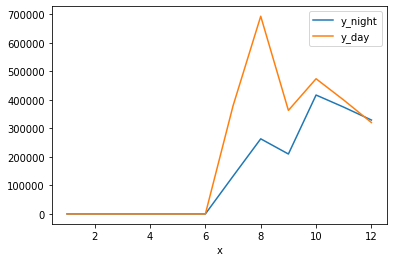

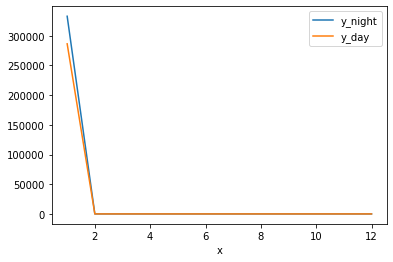

1 month
january day
332957.1199723511 january total distance at nigth
293346.0827678554 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
332957.1199723511
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
293346.0827678554
0
0
0
0
0
0
0
0
0
0
0


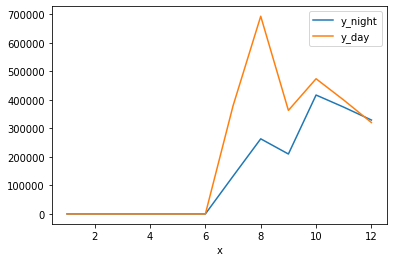

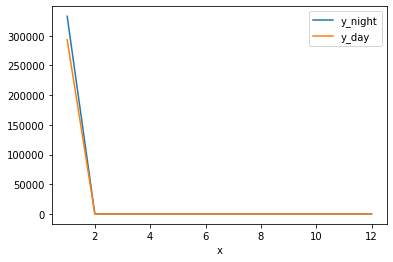

1 month
january nigth
337688.0282696679 january total distance at nigth
293346.0827678554 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
337688.0282696679
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
293346.0827678554
0
0
0
0
0
0
0
0
0
0
0


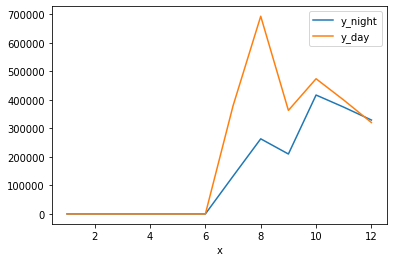

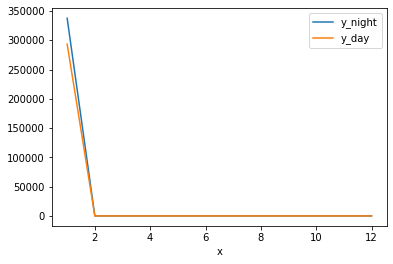

1 month
january nigth
342162.50158270414 january total distance at nigth
293346.0827678554 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
342162.50158270414
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
293346.0827678554
0
0
0
0
0
0
0
0
0
0
0


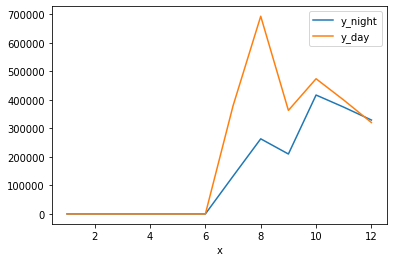

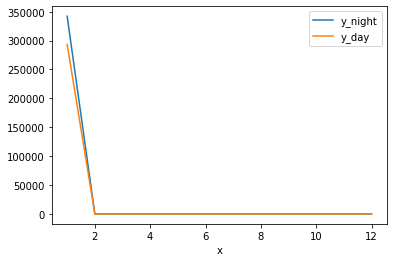

1 month
january nigth
346680.1587223309 january total distance at nigth
293346.0827678554 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
346680.1587223309
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
293346.0827678554
0
0
0
0
0
0
0
0
0
0
0


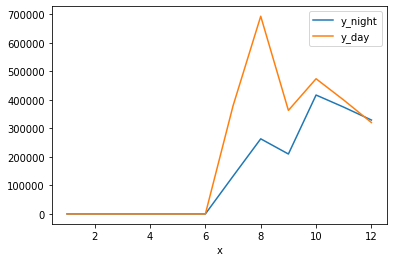

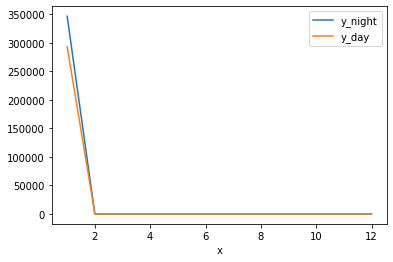

1 month
january nigth
351128.5957894413 january total distance at nigth
293346.0827678554 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
351128.5957894413
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
293346.0827678554
0
0
0
0
0
0
0
0
0
0
0


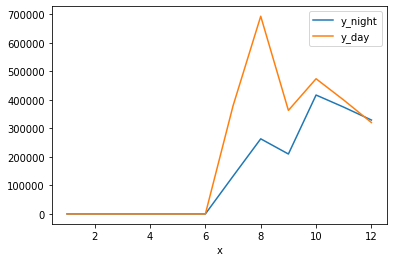

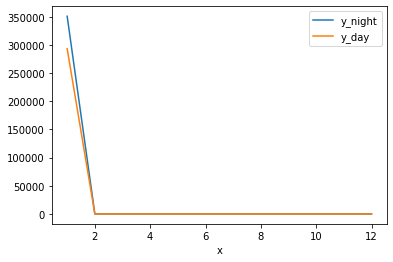

1 month
january nigth
357028.44094760256 january total distance at nigth
293346.0827678554 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
357028.44094760256
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
293346.0827678554
0
0
0
0
0
0
0
0
0
0
0


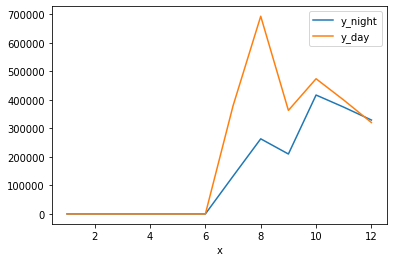

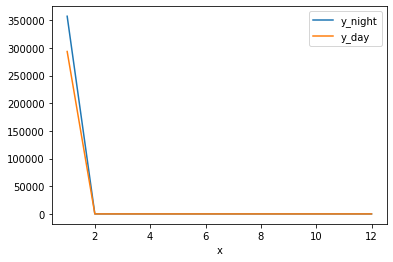

1 month
january day
357028.44094760256 january total distance at nigth
296448.8696782426 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
357028.44094760256
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
296448.8696782426
0
0
0
0
0
0
0
0
0
0
0


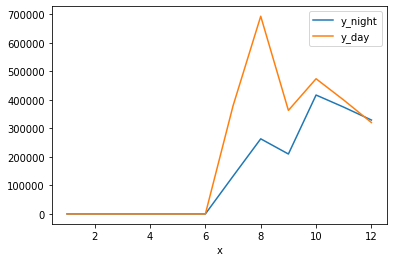

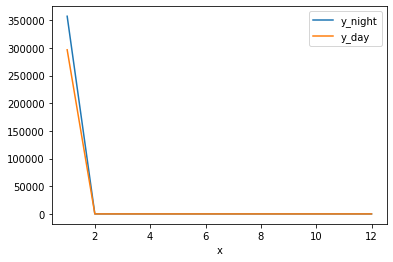

1 month
january day
357028.44094760256 january total distance at nigth
297860.35692681704 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
357028.44094760256
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
297860.35692681704
0
0
0
0
0
0
0
0
0
0
0


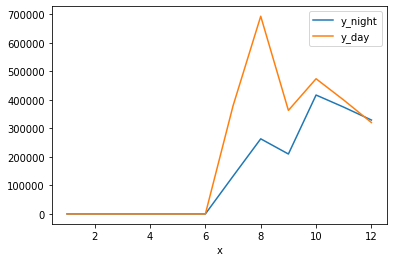

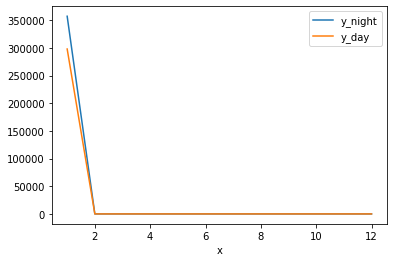

1 month
january day
357028.44094760256 january total distance at nigth
302032.34479521296 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
357028.44094760256
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
302032.34479521296
0
0
0
0
0
0
0
0
0
0
0


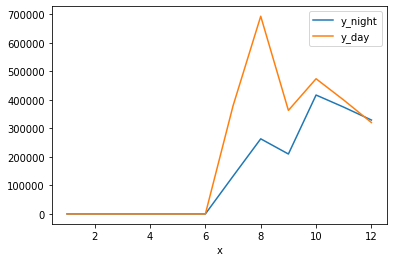

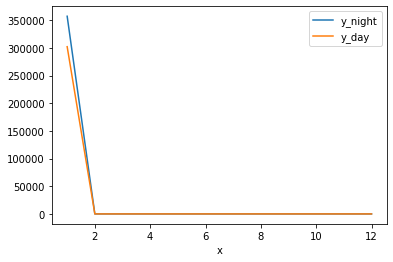

1 month
january day
357028.44094760256 january total distance at nigth
303962.1588120258 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
357028.44094760256
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
303962.1588120258
0
0
0
0
0
0
0
0
0
0
0


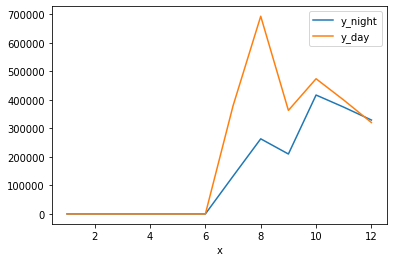

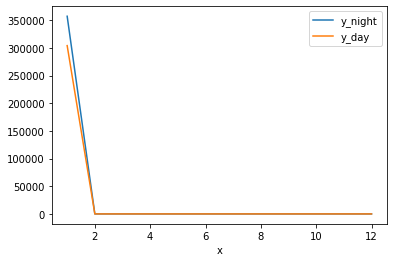

1 month
january day
357028.44094760256 january total distance at nigth
304224.0193982342 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
357028.44094760256
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
304224.0193982342
0
0
0
0
0
0
0
0
0
0
0


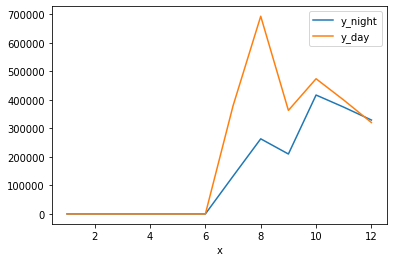

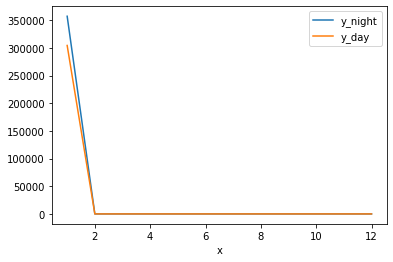

1 month
january day
357028.44094760256 january total distance at nigth
305438.86260060384 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
357028.44094760256
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
305438.86260060384
0
0
0
0
0
0
0
0
0
0
0


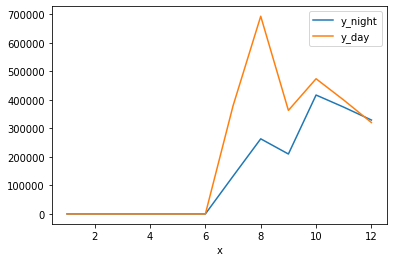

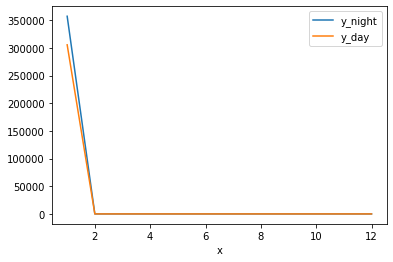

1 month
january nigth
361918.6390824462 january total distance at nigth
305438.86260060384 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
361918.6390824462
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
305438.86260060384
0
0
0
0
0
0
0
0
0
0
0


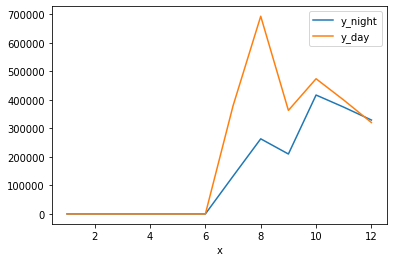

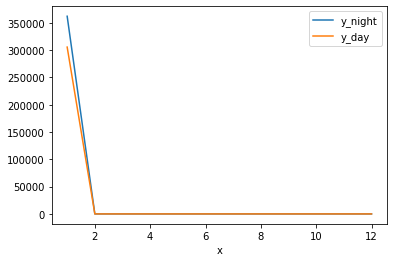

1 month
january nigth
363671.43563739804 january total distance at nigth
305438.86260060384 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
363671.43563739804
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
305438.86260060384
0
0
0
0
0
0
0
0
0
0
0


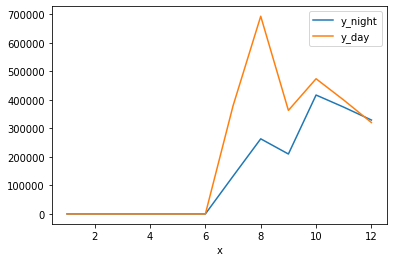

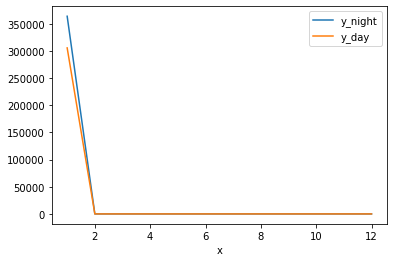

1 month
january nigth
366734.7299528577 january total distance at nigth
305438.86260060384 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
366734.7299528577
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
305438.86260060384
0
0
0
0
0
0
0
0
0
0
0


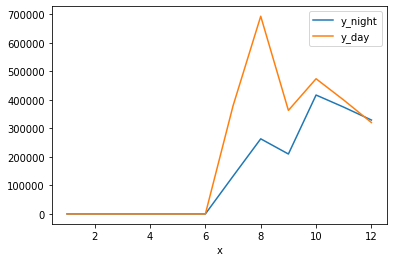

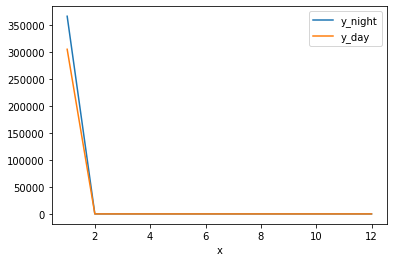

1 month
january nigth
368562.17958844366 january total distance at nigth
305438.86260060384 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
368562.17958844366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
305438.86260060384
0
0
0
0
0
0
0
0
0
0
0


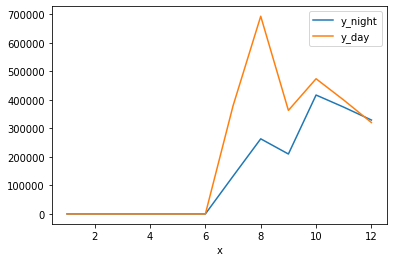

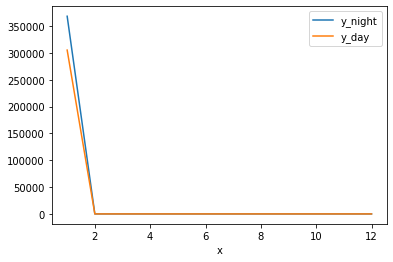

1 month
january nigth
370596.3675397155 january total distance at nigth
305438.86260060384 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
370596.3675397155
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
305438.86260060384
0
0
0
0
0
0
0
0
0
0
0


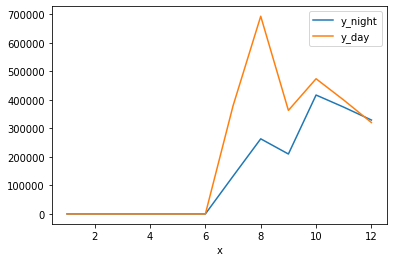

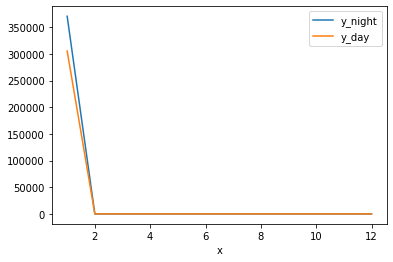

1 month
january day
370596.3675397155 january total distance at nigth
308143.14620598254 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
370596.3675397155
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
308143.14620598254
0
0
0
0
0
0
0
0
0
0
0


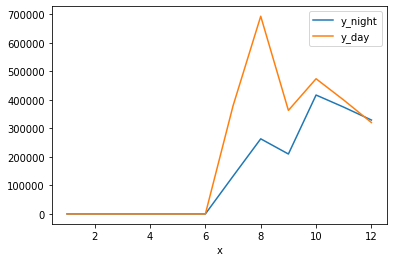

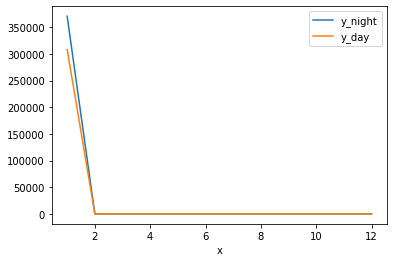

1 month
january day
370596.3675397155 january total distance at nigth
311931.74678184354 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
370596.3675397155
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
311931.74678184354
0
0
0
0
0
0
0
0
0
0
0


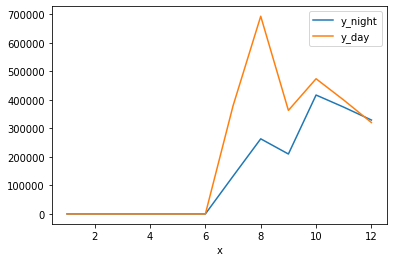

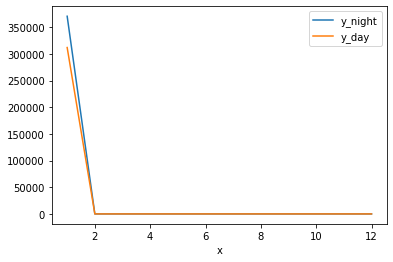

1 month
january day
370596.3675397155 january total distance at nigth
315260.5386419863 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
370596.3675397155
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
315260.5386419863
0
0
0
0
0
0
0
0
0
0
0


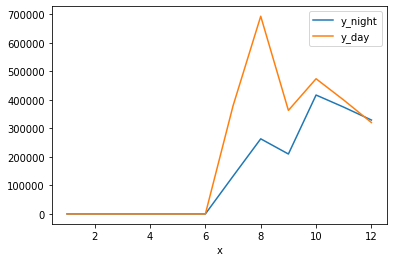

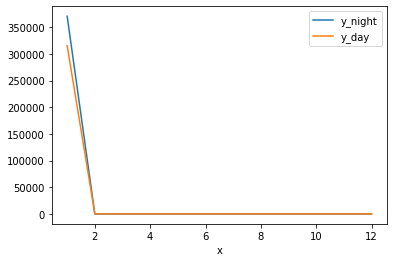

1 month
january day
370596.3675397155 january total distance at nigth
317259.192758296 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
370596.3675397155
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
317259.192758296
0
0
0
0
0
0
0
0
0
0
0


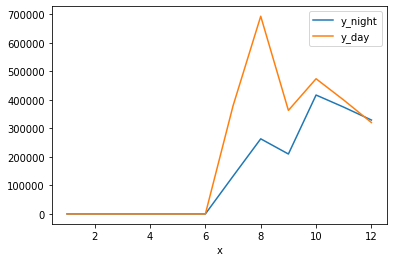

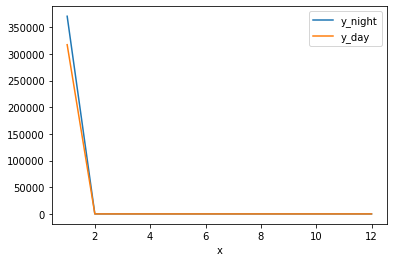

1 month
january day
370596.3675397155 january total distance at nigth
318993.0126593877 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
370596.3675397155
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
318993.0126593877
0
0
0
0
0
0
0
0
0
0
0


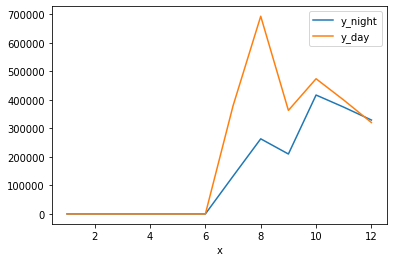

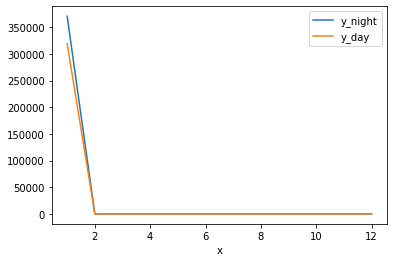

1 month
january day
370596.3675397155 january total distance at nigth
320493.2728296346 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
370596.3675397155
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
320493.2728296346
0
0
0
0
0
0
0
0
0
0
0


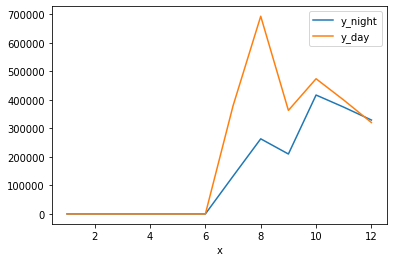

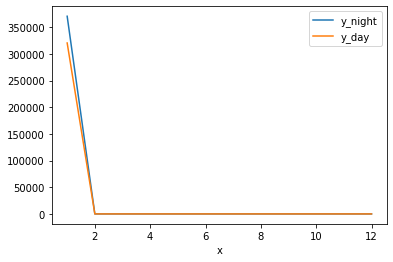

1 month
january nigth
377609.0107498338 january total distance at nigth
320493.2728296346 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
377609.0107498338
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
320493.2728296346
0
0
0
0
0
0
0
0
0
0
0


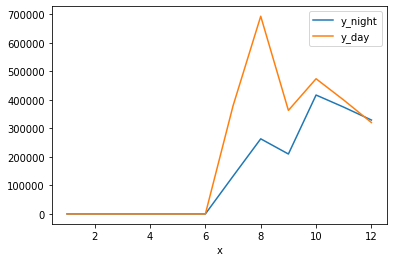

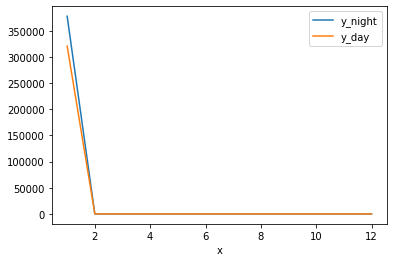

1 month
january nigth
379438.3351991094 january total distance at nigth
320493.2728296346 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
379438.3351991094
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
320493.2728296346
0
0
0
0
0
0
0
0
0
0
0


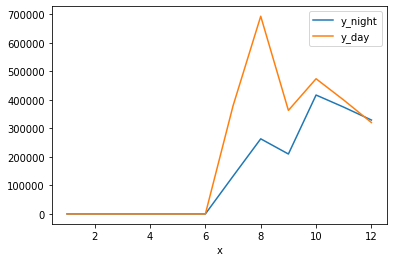

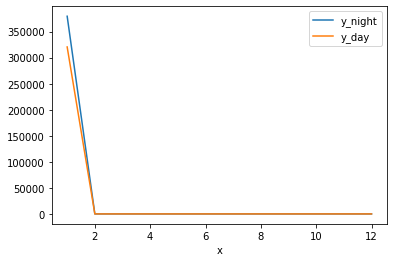

1 month
january nigth
387226.7329606856 january total distance at nigth
320493.2728296346 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
387226.7329606856
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
320493.2728296346
0
0
0
0
0
0
0
0
0
0
0


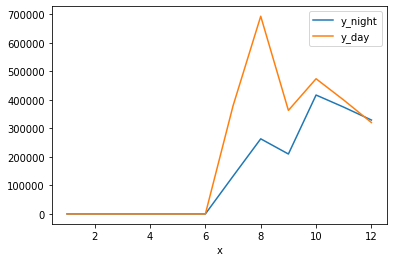

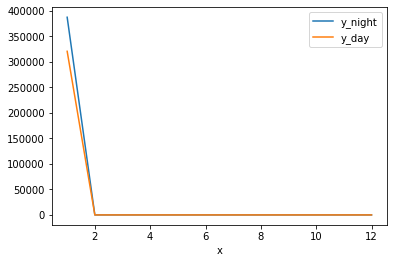

1 month
january nigth
392945.99192073446 january total distance at nigth
320493.2728296346 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
392945.99192073446
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
320493.2728296346
0
0
0
0
0
0
0
0
0
0
0


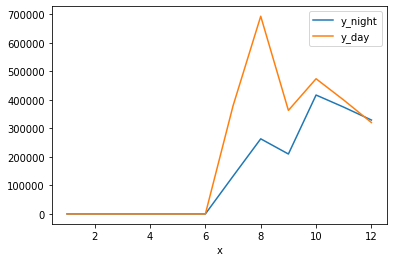

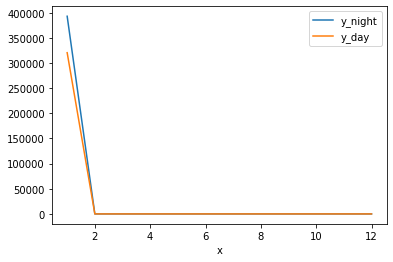

1 month
january day
392945.99192073446 january total distance at nigth
325192.5495152392 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
392945.99192073446
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
325192.5495152392
0
0
0
0
0
0
0
0
0
0
0


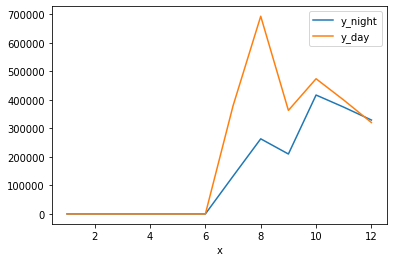

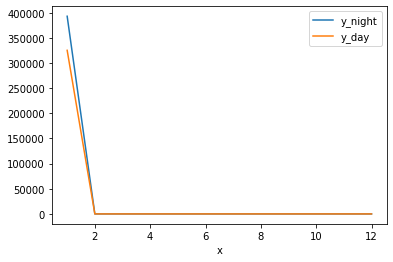

1 month
january day
392945.99192073446 january total distance at nigth
331312.74038493994 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
392945.99192073446
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
331312.74038493994
0
0
0
0
0
0
0
0
0
0
0


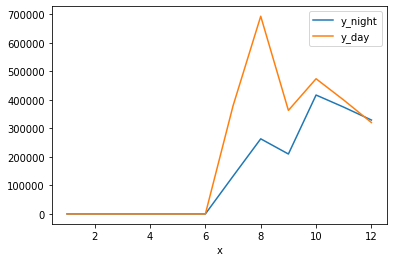

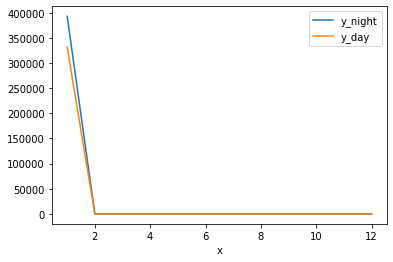

1 month
january day
392945.99192073446 january total distance at nigth
335711.35312542686 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
392945.99192073446
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
335711.35312542686
0
0
0
0
0
0
0
0
0
0
0


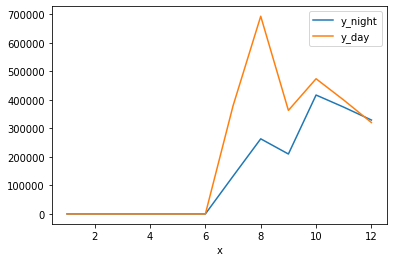

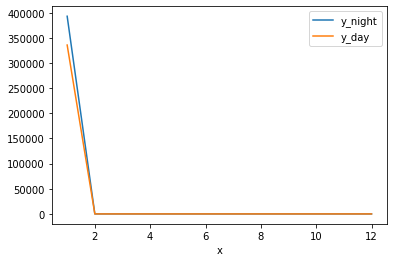

1 month
january nigth
398432.8519698593 january total distance at nigth
335711.35312542686 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
398432.8519698593
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
335711.35312542686
0
0
0
0
0
0
0
0
0
0
0


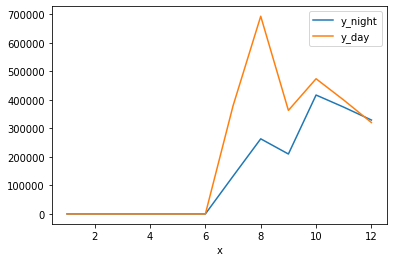

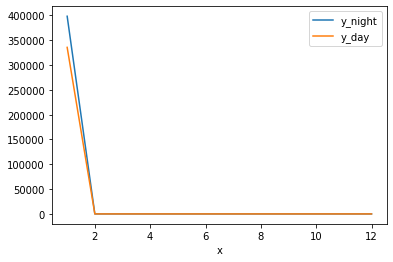

1 month
january nigth
400152.72391835134 january total distance at nigth
335711.35312542686 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
400152.72391835134
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
335711.35312542686
0
0
0
0
0
0
0
0
0
0
0


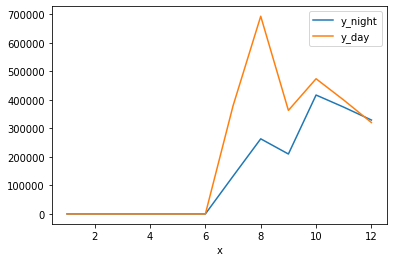

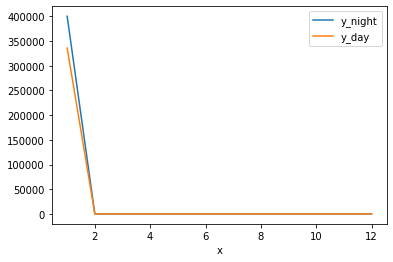

1 month
january nigth
403345.4434406389 january total distance at nigth
335711.35312542686 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
403345.4434406389
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
335711.35312542686
0
0
0
0
0
0
0
0
0
0
0


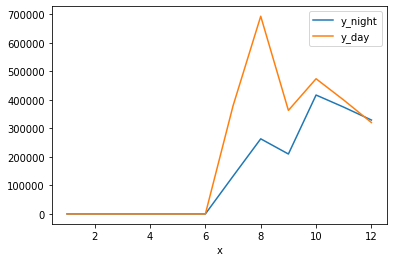

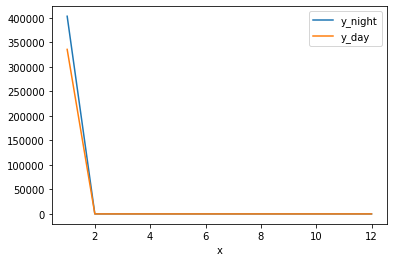

1 month
january nigth
406757.39931670146 january total distance at nigth
335711.35312542686 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
406757.39931670146
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
335711.35312542686
0
0
0
0
0
0
0
0
0
0
0


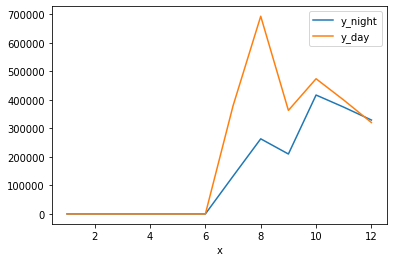

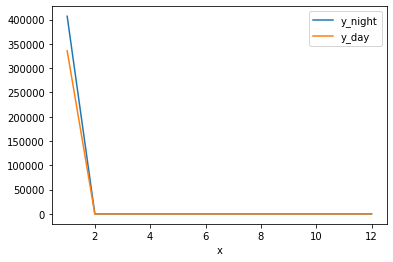

1 month
january nigth
409549.78829953715 january total distance at nigth
335711.35312542686 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
409549.78829953715
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
335711.35312542686
0
0
0
0
0
0
0
0
0
0
0


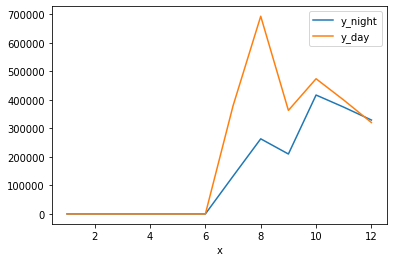

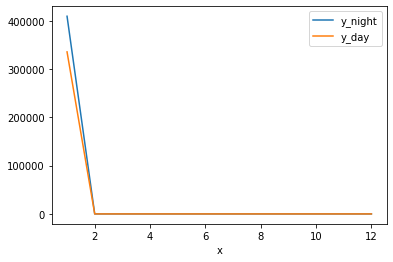

1 month
january day
409549.78829953715 january total distance at nigth
352109.9935612538 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
409549.78829953715
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
352109.9935612538
0
0
0
0
0
0
0
0
0
0
0


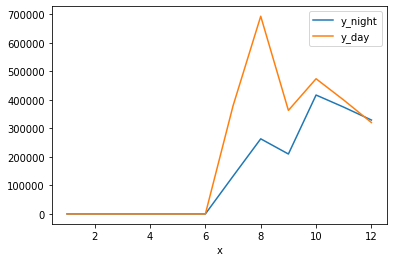

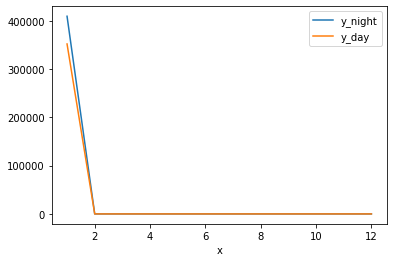

1 month
january day
409549.78829953715 january total distance at nigth
356008.1425710155 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
409549.78829953715
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
356008.1425710155
0
0
0
0
0
0
0
0
0
0
0


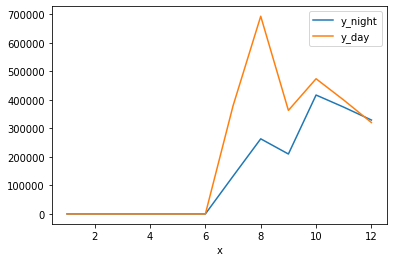

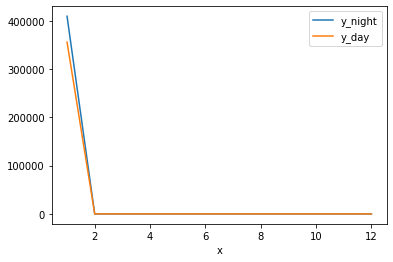

1 month
january day
409549.78829953715 january total distance at nigth
356180.31675291545 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
409549.78829953715
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
356180.31675291545
0
0
0
0
0
0
0
0
0
0
0


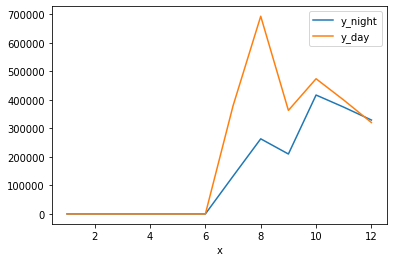

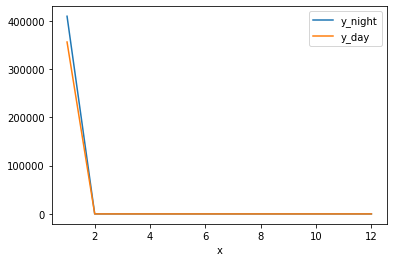

1 month
january day
409549.78829953715 january total distance at nigth
358043.37442943314 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
409549.78829953715
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
358043.37442943314
0
0
0
0
0
0
0
0
0
0
0


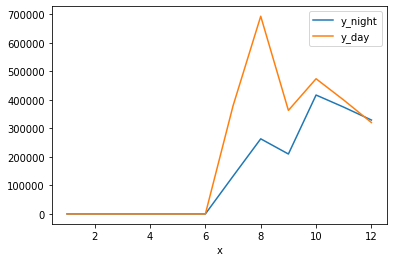

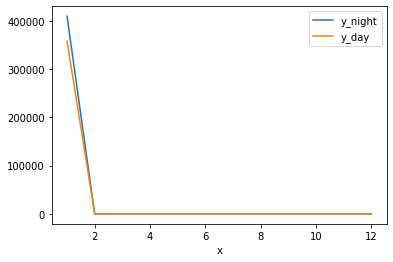

1 month
january nigth
414229.69919831207 january total distance at nigth
358043.37442943314 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
414229.69919831207
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
358043.37442943314
0
0
0
0
0
0
0
0
0
0
0


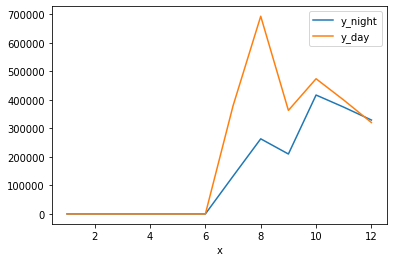

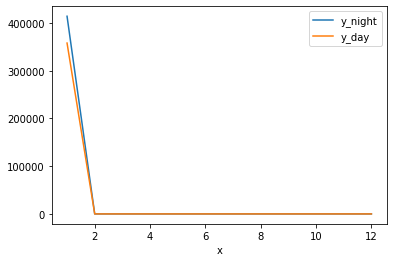

1 month
january nigth
416546.7376953985 january total distance at nigth
358043.37442943314 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
416546.7376953985
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
358043.37442943314
0
0
0
0
0
0
0
0
0
0
0


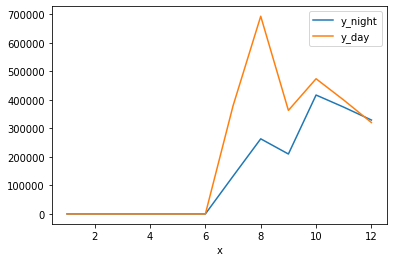

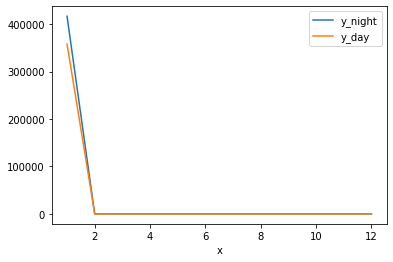

1 month
january nigth
417120.5403615306 january total distance at nigth
358043.37442943314 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
417120.5403615306
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
358043.37442943314
0
0
0
0
0
0
0
0
0
0
0


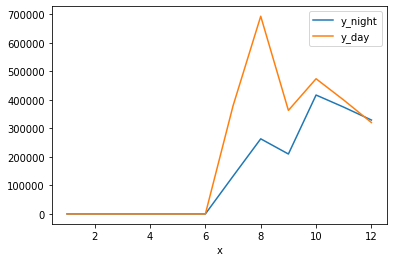

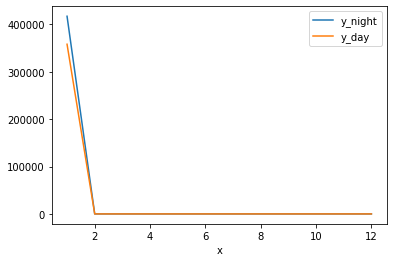

1 month
january nigth
418370.0811319711 january total distance at nigth
358043.37442943314 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
418370.0811319711
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
358043.37442943314
0
0
0
0
0
0
0
0
0
0
0


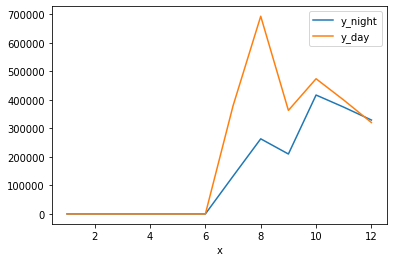

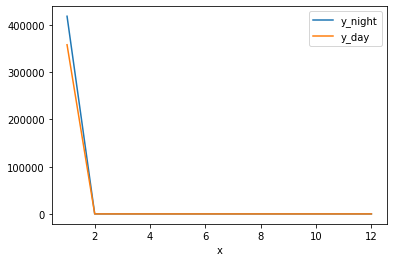

1 month
january nigth
418393.34352538566 january total distance at nigth
358043.37442943314 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
418393.34352538566
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
358043.37442943314
0
0
0
0
0
0
0
0
0
0
0


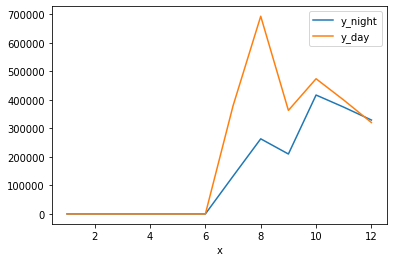

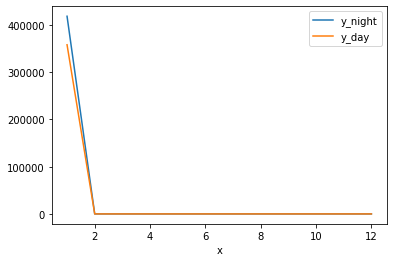

1 month
january nigth
420893.24086673104 january total distance at nigth
358043.37442943314 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
420893.24086673104
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
358043.37442943314
0
0
0
0
0
0
0
0
0
0
0


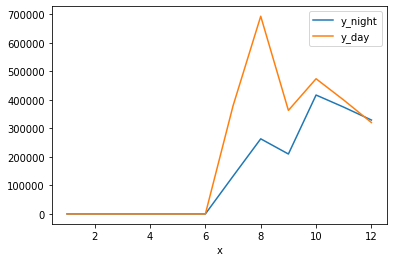

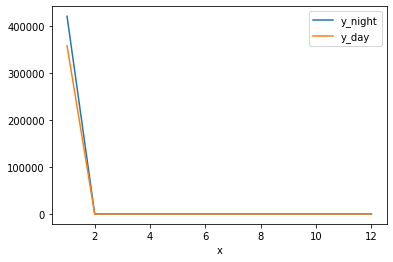

1 month
january nigth
423420.97062418703 january total distance at nigth
358043.37442943314 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
423420.97062418703
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
358043.37442943314
0
0
0
0
0
0
0
0
0
0
0


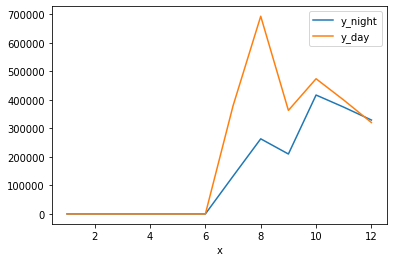

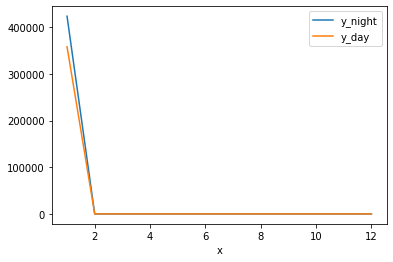

1 month
january day
423420.97062418703 january total distance at nigth
364646.28179171245 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
423420.97062418703
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
364646.28179171245
0
0
0
0
0
0
0
0
0
0
0


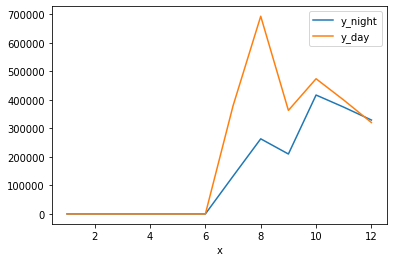

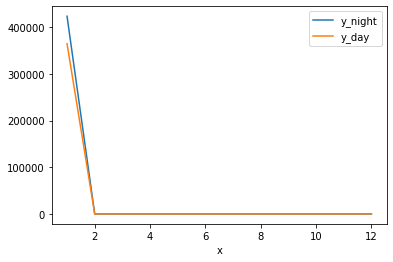

1 month
january day
423420.97062418703 january total distance at nigth
368081.4400947667 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
423420.97062418703
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
368081.4400947667
0
0
0
0
0
0
0
0
0
0
0


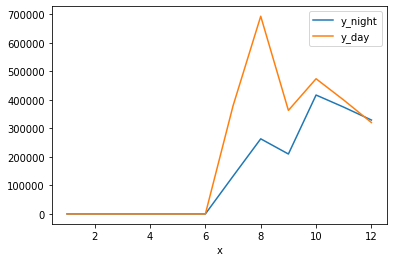

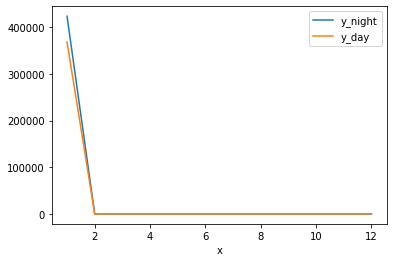

1 month
january day
423420.97062418703 january total distance at nigth
373962.75383462576 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
423420.97062418703
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
373962.75383462576
0
0
0
0
0
0
0
0
0
0
0


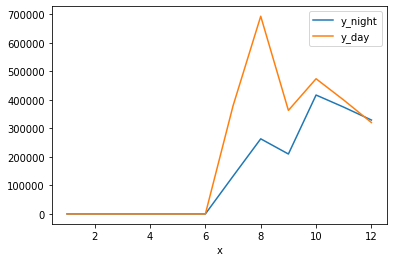

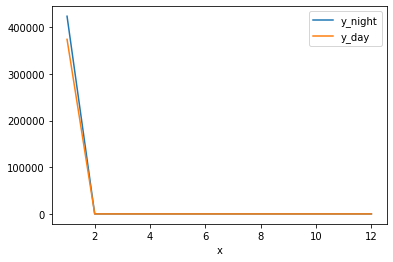

1 month
january day
423420.97062418703 january total distance at nigth
374162.79434931616 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
423420.97062418703
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
374162.79434931616
0
0
0
0
0
0
0
0
0
0
0


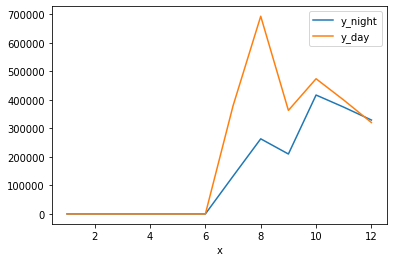

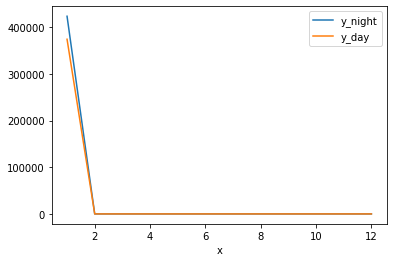

1 month
january day
423420.97062418703 january total distance at nigth
376081.4892370142 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
423420.97062418703
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
376081.4892370142
0
0
0
0
0
0
0
0
0
0
0


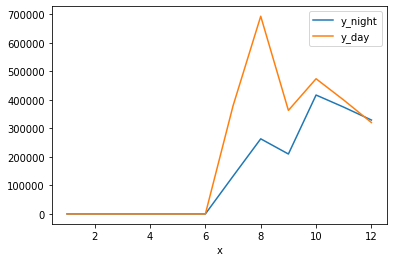

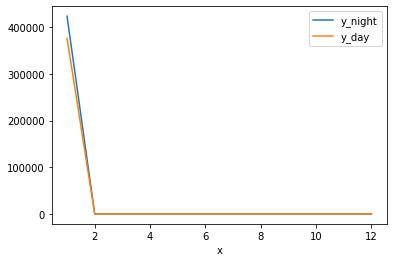

1 month
january day
423420.97062418703 january total distance at nigth
378622.7322520489 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
423420.97062418703
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
378622.7322520489
0
0
0
0
0
0
0
0
0
0
0


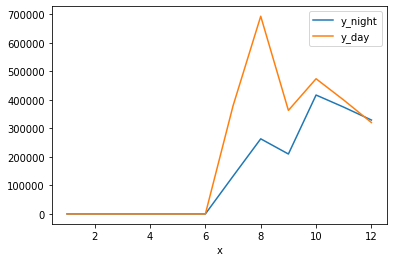

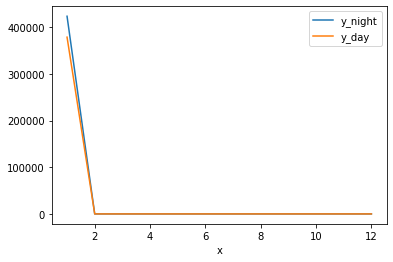

1 month
january nigth
424827.3764571432 january total distance at nigth
378622.7322520489 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
424827.3764571432
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
378622.7322520489
0
0
0
0
0
0
0
0
0
0
0


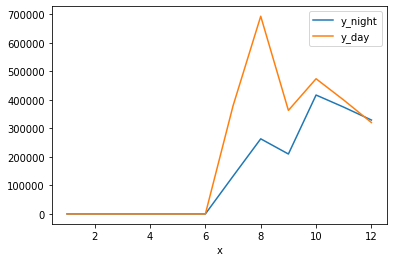

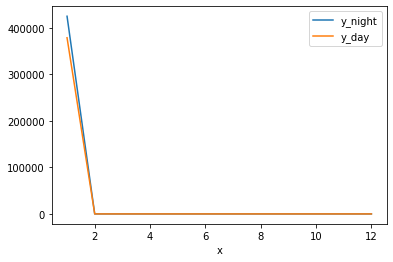

1 month
january nigth
426306.94755605364 january total distance at nigth
378622.7322520489 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
426306.94755605364
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
378622.7322520489
0
0
0
0
0
0
0
0
0
0
0


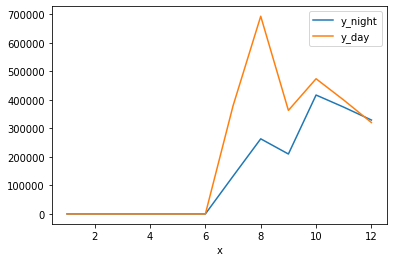

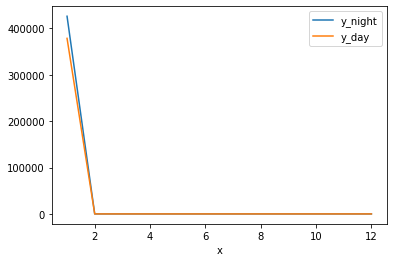

1 month
january nigth
428932.6271144539 january total distance at nigth
378622.7322520489 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
428932.6271144539
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
378622.7322520489
0
0
0
0
0
0
0
0
0
0
0


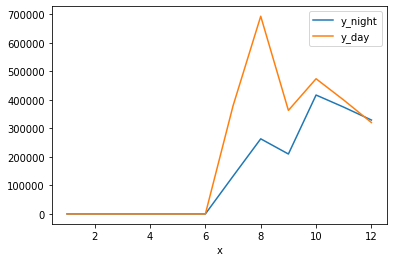

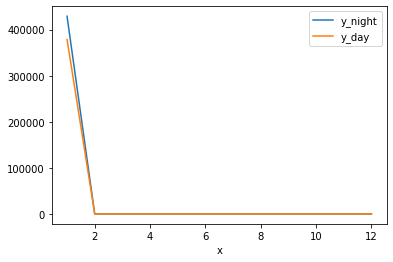

1 month
january nigth
432185.7015220244 january total distance at nigth
378622.7322520489 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
432185.7015220244
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
378622.7322520489
0
0
0
0
0
0
0
0
0
0
0


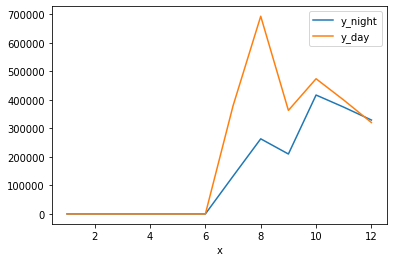

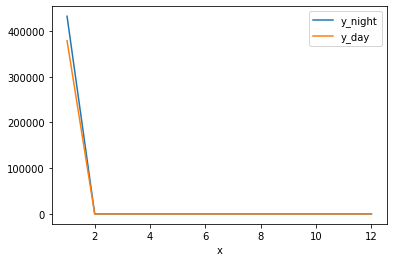

1 month
january nigth
434972.40718916926 january total distance at nigth
378622.7322520489 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
434972.40718916926
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
378622.7322520489
0
0
0
0
0
0
0
0
0
0
0


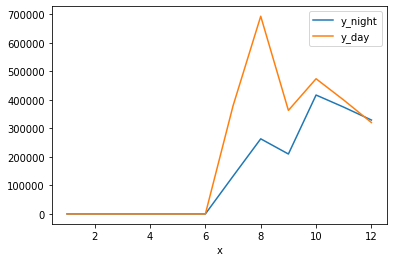

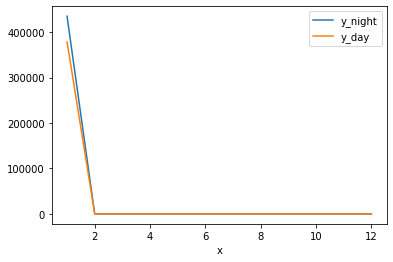

1 month
january day
434972.40718916926 january total distance at nigth
387365.44253660174 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
434972.40718916926
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
387365.44253660174
0
0
0
0
0
0
0
0
0
0
0


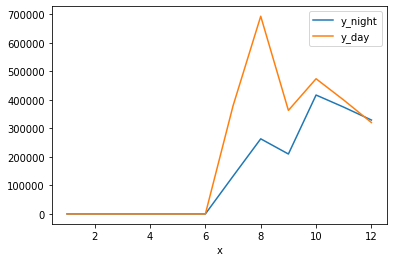

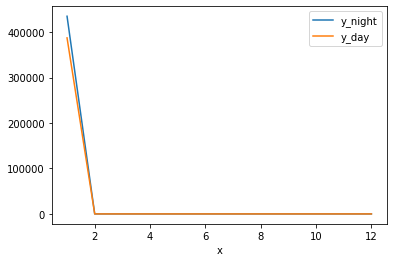

1 month
january day
434972.40718916926 january total distance at nigth
389096.88183275476 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
434972.40718916926
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
389096.88183275476
0
0
0
0
0
0
0
0
0
0
0


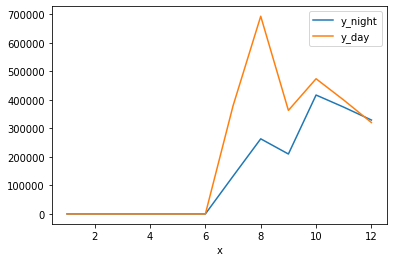

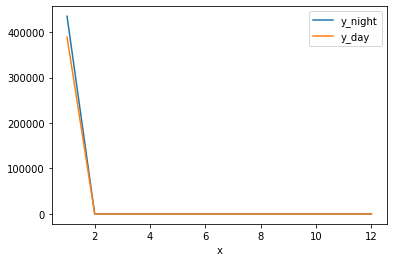

1 month
january day
434972.40718916926 january total distance at nigth
391473.7426608634 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
434972.40718916926
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
391473.7426608634
0
0
0
0
0
0
0
0
0
0
0


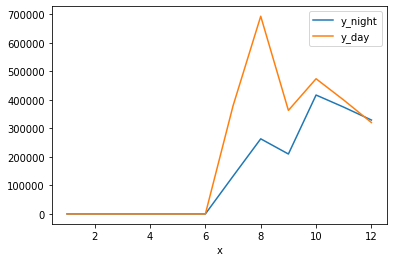

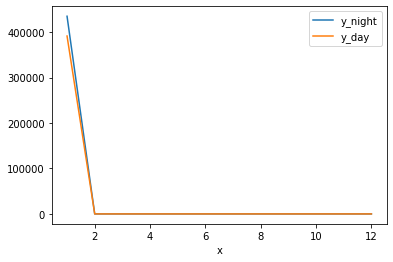

1 month
january day
434972.40718916926 january total distance at nigth
394264.8141136081 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
434972.40718916926
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
394264.8141136081
0
0
0
0
0
0
0
0
0
0
0


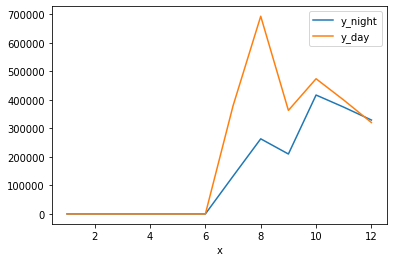

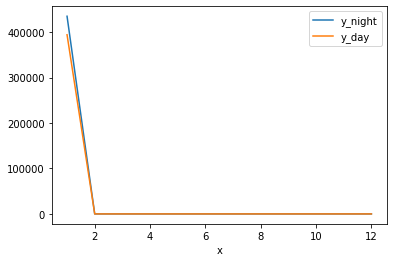

1 month
january nigth
437023.51868953573 january total distance at nigth
394264.8141136081 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
437023.51868953573
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
394264.8141136081
0
0
0
0
0
0
0
0
0
0
0


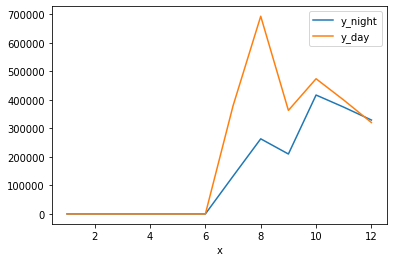

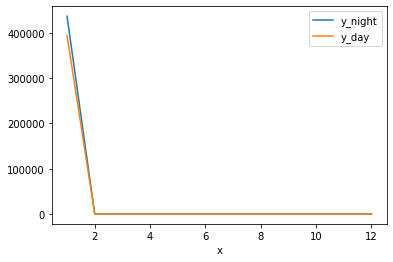

1 month
january nigth
440857.93071529316 january total distance at nigth
394264.8141136081 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
440857.93071529316
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
394264.8141136081
0
0
0
0
0
0
0
0
0
0
0


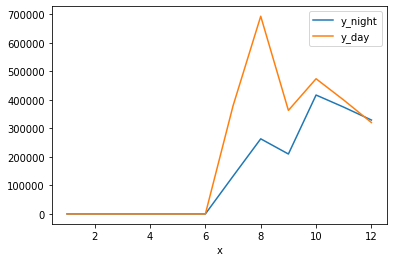

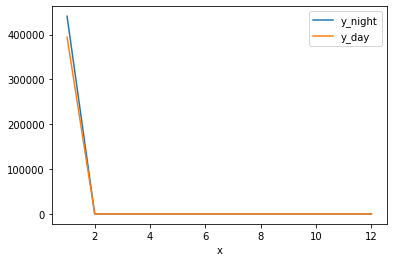

1 month
january nigth
443470.15640893753 january total distance at nigth
394264.8141136081 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
443470.15640893753
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
394264.8141136081
0
0
0
0
0
0
0
0
0
0
0


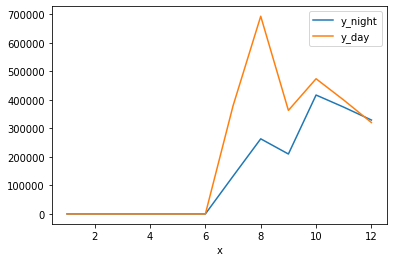

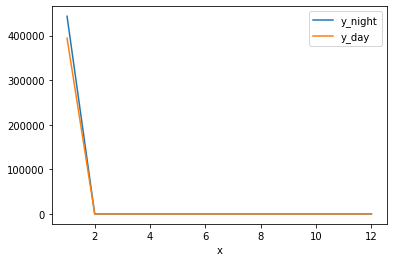

1 month
january nigth
445047.9088482123 january total distance at nigth
394264.8141136081 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
445047.9088482123
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
394264.8141136081
0
0
0
0
0
0
0
0
0
0
0


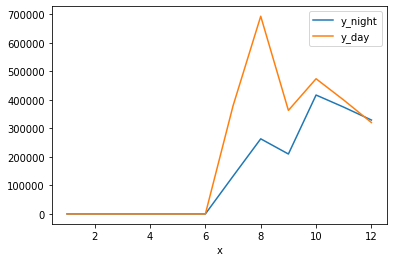

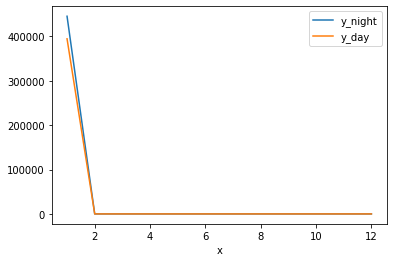

1 month
january nigth
446047.3150665028 january total distance at nigth
394264.8141136081 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
446047.3150665028
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
394264.8141136081
0
0
0
0
0
0
0
0
0
0
0


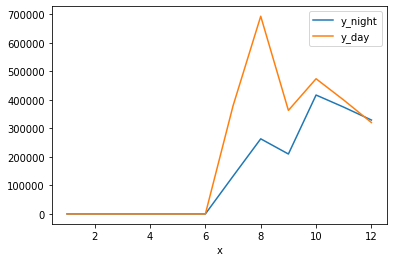

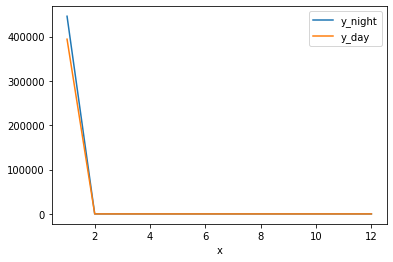

1 month
january day
446047.3150665028 january total distance at nigth
398036.9333761564 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
446047.3150665028
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
398036.9333761564
0
0
0
0
0
0
0
0
0
0
0


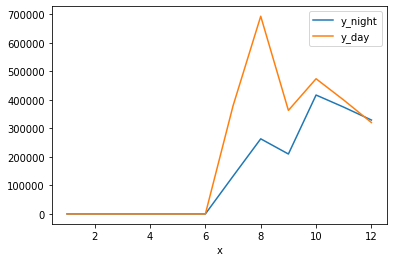

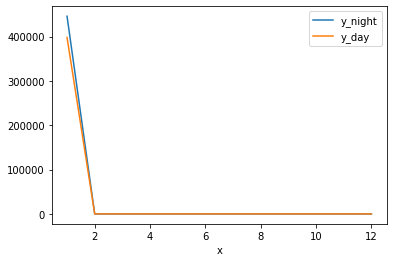

1 month
january day
446047.3150665028 january total distance at nigth
401154.4225213817 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
446047.3150665028
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
401154.4225213817
0
0
0
0
0
0
0
0
0
0
0


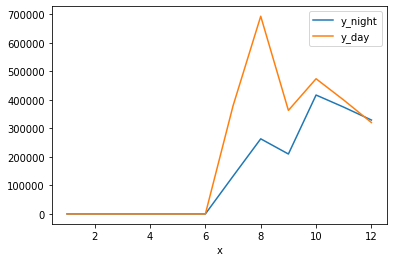

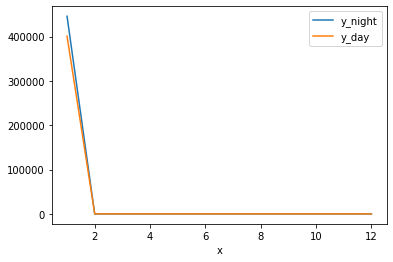

1 month
january day
446047.3150665028 january total distance at nigth
405023.8110410831 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
446047.3150665028
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
405023.8110410831
0
0
0
0
0
0
0
0
0
0
0


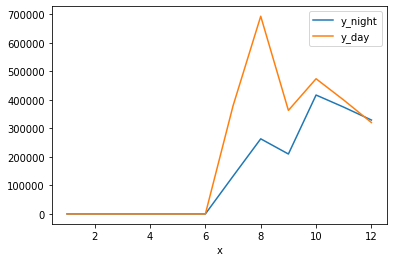

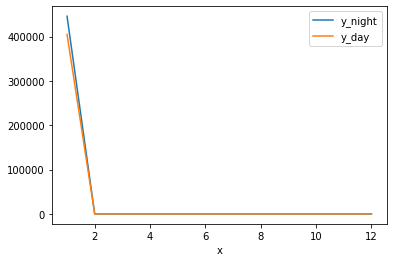

1 month
january day
446047.3150665028 january total distance at nigth
410649.8288404055 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
446047.3150665028
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
410649.8288404055
0
0
0
0
0
0
0
0
0
0
0


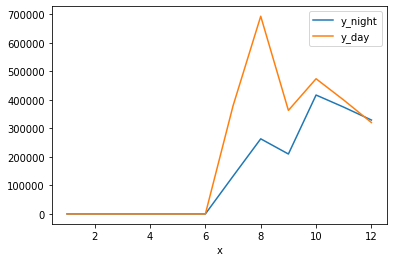

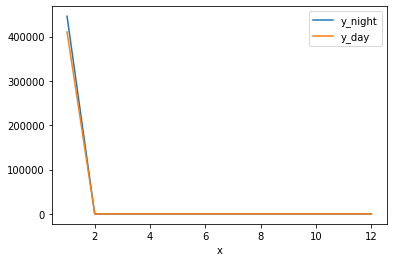

1 month
january nigth
448607.25395740627 january total distance at nigth
410649.8288404055 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
448607.25395740627
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
410649.8288404055
0
0
0
0
0
0
0
0
0
0
0


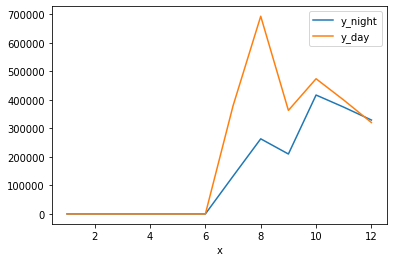

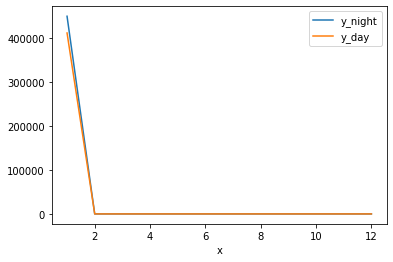

1 month
january nigth
450687.03678978333 january total distance at nigth
410649.8288404055 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
450687.03678978333
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
410649.8288404055
0
0
0
0
0
0
0
0
0
0
0


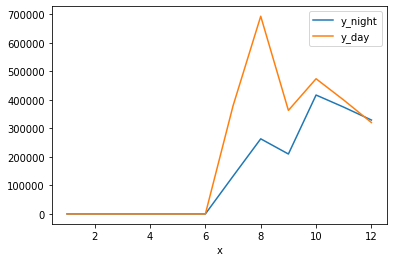

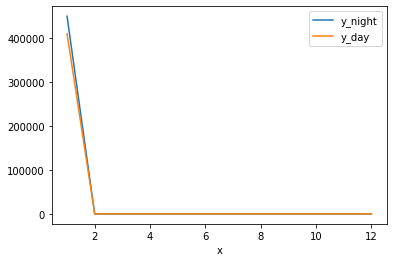

1 month
january nigth
451981.97719901835 january total distance at nigth
410649.8288404055 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
451981.97719901835
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
410649.8288404055
0
0
0
0
0
0
0
0
0
0
0


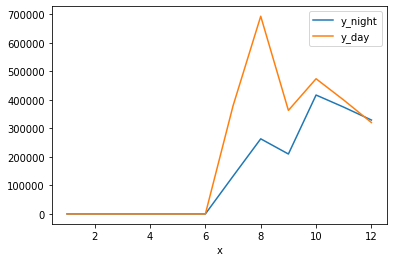

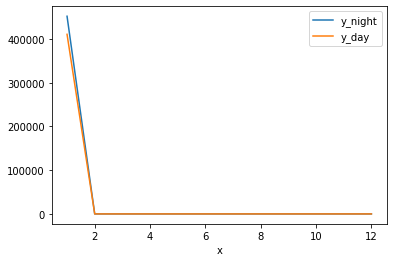

1 month
january nigth
452426.13592751225 january total distance at nigth
410649.8288404055 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
452426.13592751225
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
410649.8288404055
0
0
0
0
0
0
0
0
0
0
0


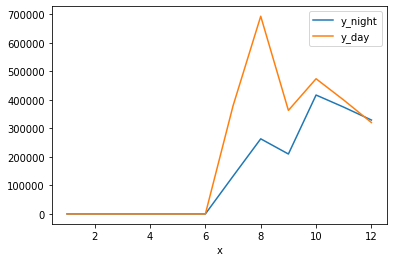

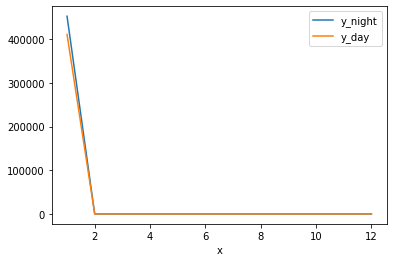

1 month
january nigth
453450.45171470015 january total distance at nigth
410649.8288404055 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
453450.45171470015
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
410649.8288404055
0
0
0
0
0
0
0
0
0
0
0


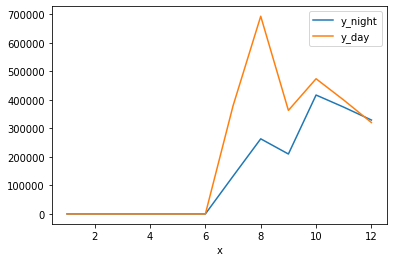

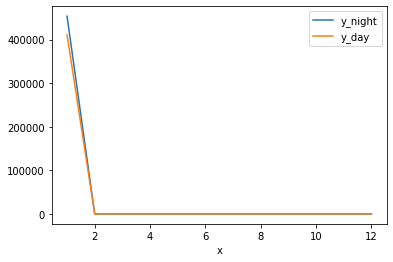

1 month
january day
453450.45171470015 january total distance at nigth
412729.5368495875 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
453450.45171470015
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
412729.5368495875
0
0
0
0
0
0
0
0
0
0
0


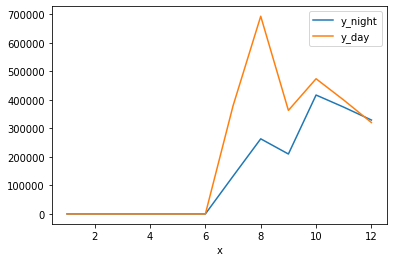

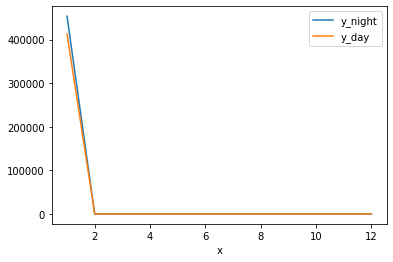

1 month
january day
453450.45171470015 january total distance at nigth
415150.8167930545 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
453450.45171470015
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
415150.8167930545
0
0
0
0
0
0
0
0
0
0
0


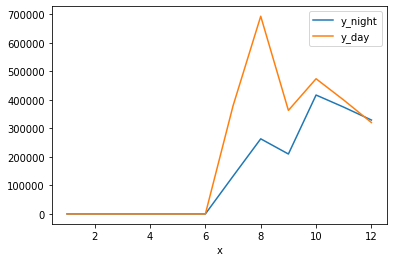

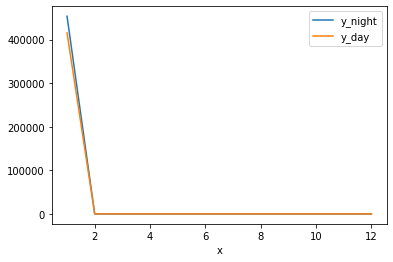

1 month
january day
453450.45171470015 january total distance at nigth
416528.6475586797 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
453450.45171470015
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
416528.6475586797
0
0
0
0
0
0
0
0
0
0
0


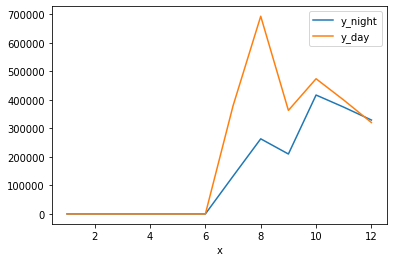

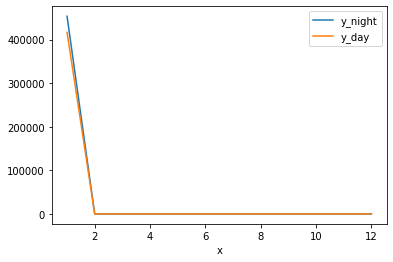

1 month
january day
453450.45171470015 january total distance at nigth
418044.565597342 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
453450.45171470015
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418044.565597342
0
0
0
0
0
0
0
0
0
0
0


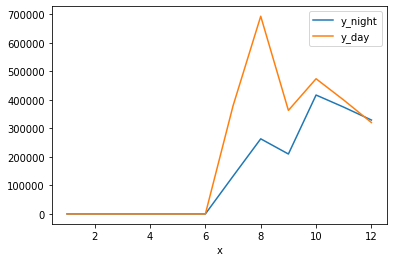

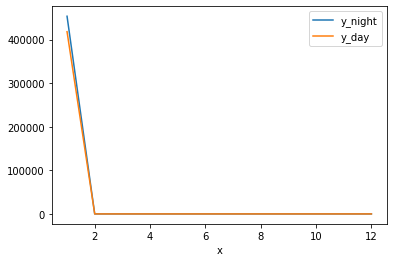

1 month
january day
453450.45171470015 january total distance at nigth
418082.3447454487 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
453450.45171470015
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
0
0
0
0
0
0
0
0
0
0
0


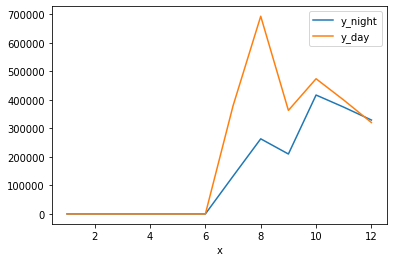

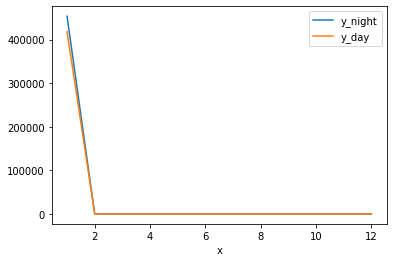

1 month
january nigth
455366.3385518356 january total distance at nigth
418082.3447454487 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
455366.3385518356
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
0
0
0
0
0
0
0
0
0
0
0


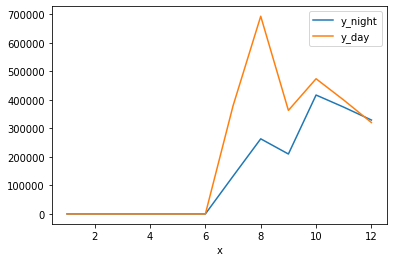

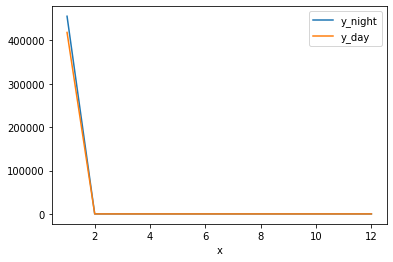

1 month
january nigth
456775.3207150544 january total distance at nigth
418082.3447454487 january total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
0
0
0
0
0
0
0
0
0
0
0


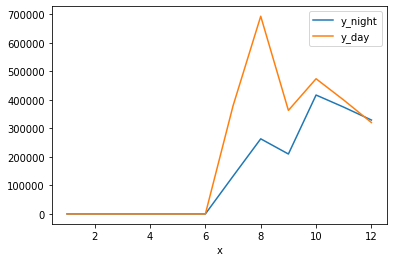

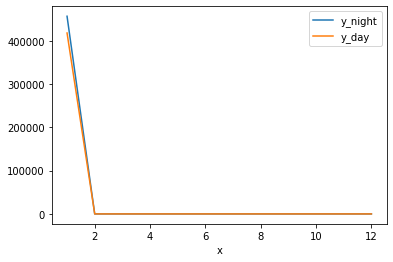

2 month
february nigth
3692.8543870346316 february total distance at nigth
0 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
3692.8543870346316
3692.8543870346316
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
0
0
0
0
0
0
0
0
0
0
0


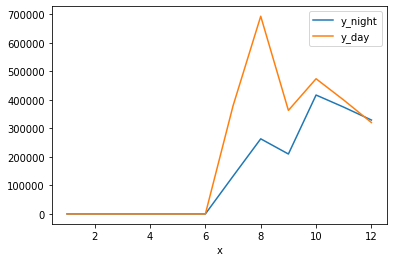

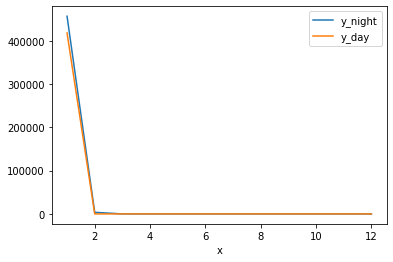

2 month
february nigth
3986.3300286151193 february total distance at nigth
0 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
3986.3300286151193
3986.3300286151193
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
0
0
0
0
0
0
0
0
0
0
0


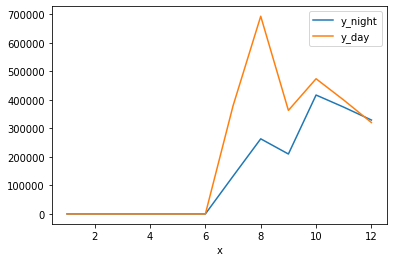

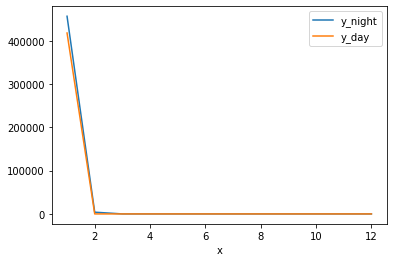

2 month
february nigth
7040.999917650011 february total distance at nigth
0 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
7040.999917650011
7040.999917650011
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
0
0
0
0
0
0
0
0
0
0
0


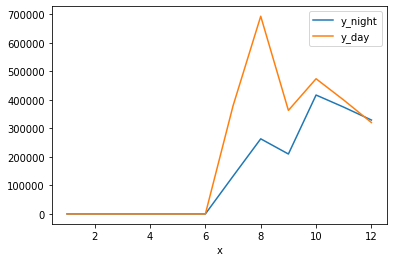

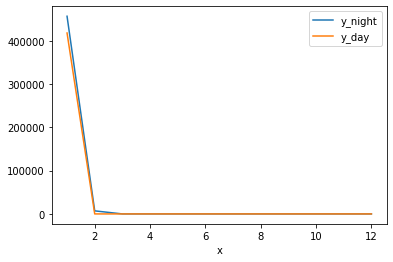

2 month
february day
7040.999917650011 february total distance at nigth
2621.3809557171708 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
7040.999917650011
7040.999917650011
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
2621.3809557171708
0
0
0
0
0
0
0
0
0
0


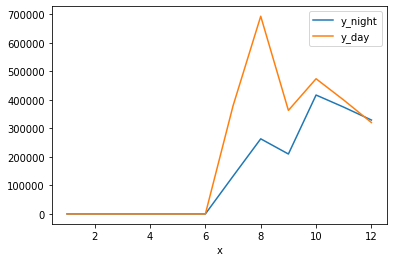

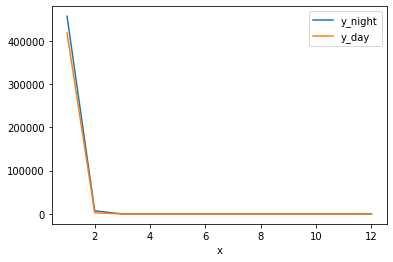

2 month
february day
7040.999917650011 february total distance at nigth
4938.340889233099 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
7040.999917650011
7040.999917650011
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
4938.340889233099
0
0
0
0
0
0
0
0
0
0


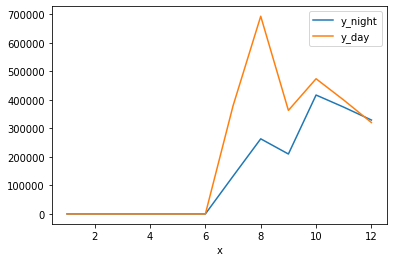

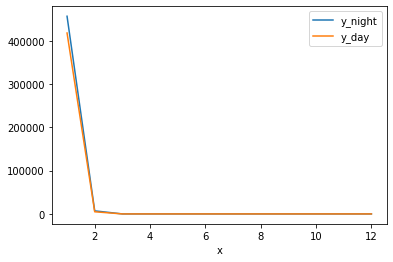

2 month
february day
7040.999917650011 february total distance at nigth
6783.9574165163285 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
7040.999917650011
7040.999917650011
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
6783.9574165163285
0
0
0
0
0
0
0
0
0
0


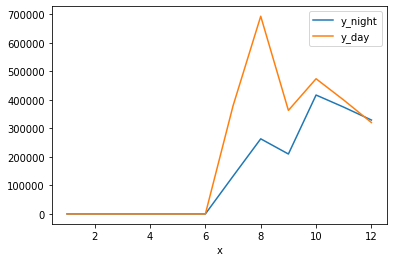

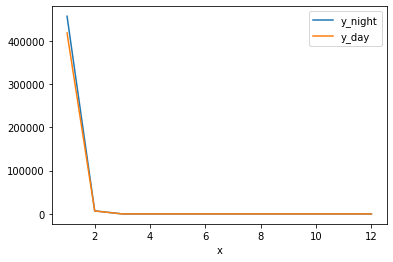

2 month
february day
7040.999917650011 february total distance at nigth
8808.241399558914 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
7040.999917650011
7040.999917650011
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
8808.241399558914
0
0
0
0
0
0
0
0
0
0


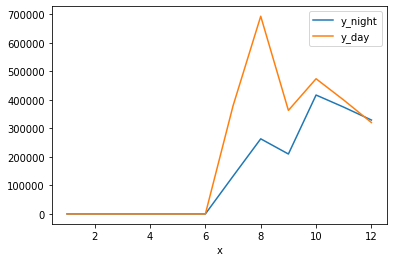

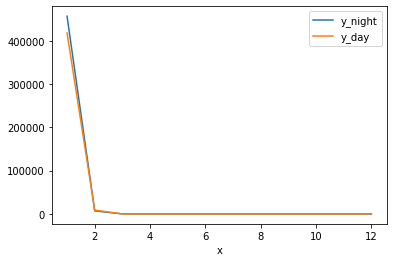

2 month
february nigth
9128.345534634804 february total distance at nigth
8808.241399558914 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
9128.345534634804
9128.345534634804
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
8808.241399558914
0
0
0
0
0
0
0
0
0
0


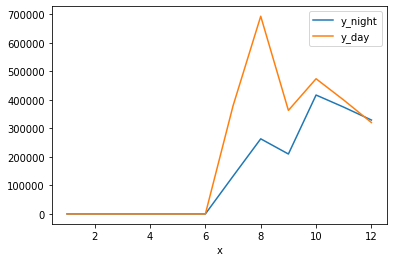

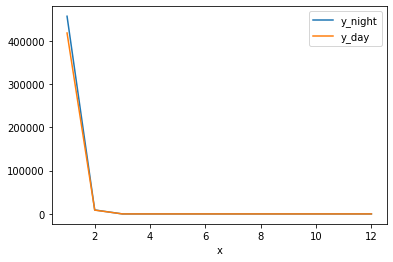

2 month
february nigth
10551.462156114138 february total distance at nigth
8808.241399558914 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
10551.462156114138
10551.462156114138
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
8808.241399558914
0
0
0
0
0
0
0
0
0
0


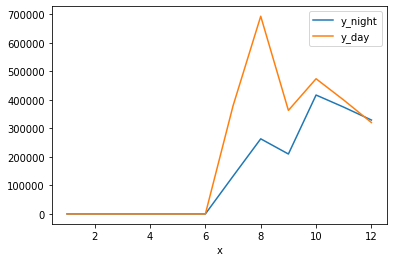

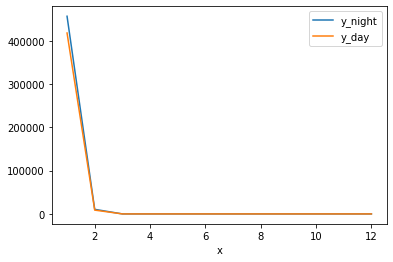

2 month
february nigth
12421.72486441099 february total distance at nigth
8808.241399558914 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
12421.72486441099
12421.72486441099
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
8808.241399558914
0
0
0
0
0
0
0
0
0
0


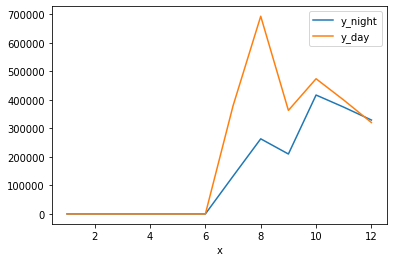

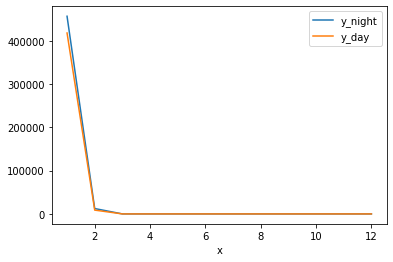

2 month
february nigth
15010.190045107096 february total distance at nigth
8808.241399558914 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
15010.190045107096
15010.190045107096
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
8808.241399558914
0
0
0
0
0
0
0
0
0
0


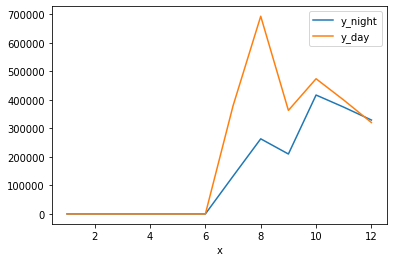

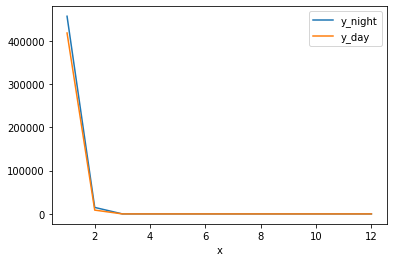

2 month
february nigth
15144.688537830452 february total distance at nigth
8808.241399558914 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
15144.688537830452
15144.688537830452
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
8808.241399558914
0
0
0
0
0
0
0
0
0
0


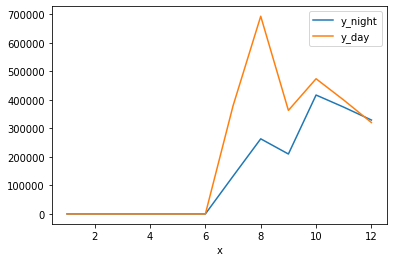

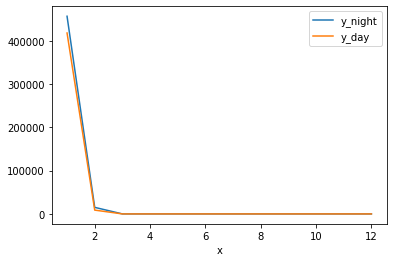

2 month
february nigth
18703.589616083933 february total distance at nigth
8808.241399558914 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
18703.589616083933
18703.589616083933
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
8808.241399558914
0
0
0
0
0
0
0
0
0
0


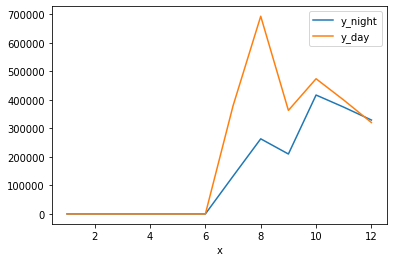

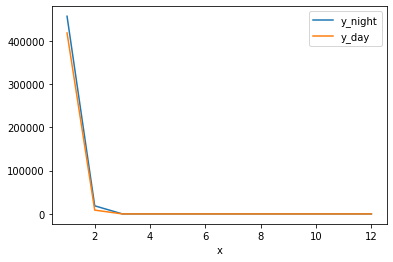

2 month
february nigth
18807.707212925645 february total distance at nigth
8808.241399558914 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
18807.707212925645
18807.707212925645
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
8808.241399558914
0
0
0
0
0
0
0
0
0
0


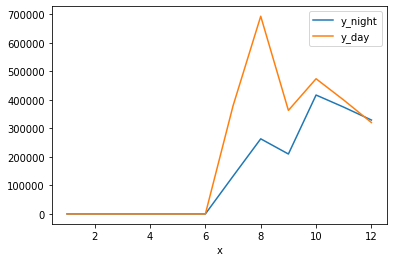

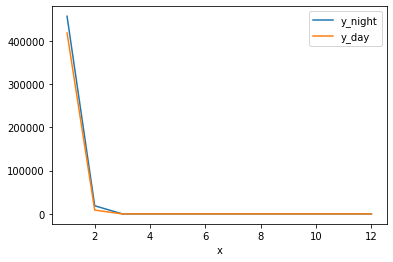

2 month
february day
18807.707212925645 february total distance at nigth
13889.973202083533 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
18807.707212925645
18807.707212925645
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
13889.973202083533
0
0
0
0
0
0
0
0
0
0


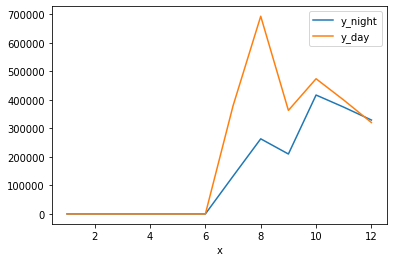

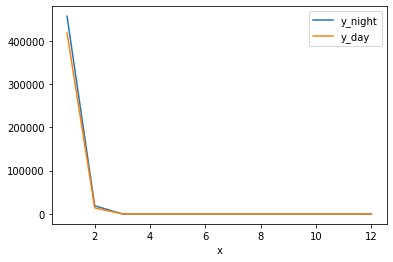

2 month
february day
18807.707212925645 february total distance at nigth
19870.07273835779 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
18807.707212925645
18807.707212925645
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
19870.07273835779
0
0
0
0
0
0
0
0
0
0


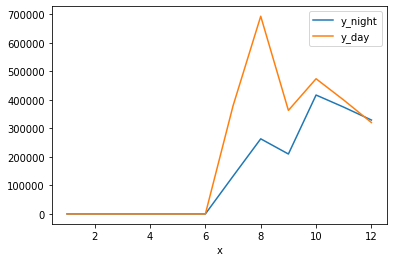

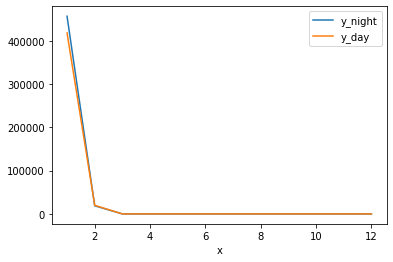

2 month
february day
18807.707212925645 february total distance at nigth
20063.805249342102 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
18807.707212925645
18807.707212925645
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
20063.805249342102
0
0
0
0
0
0
0
0
0
0


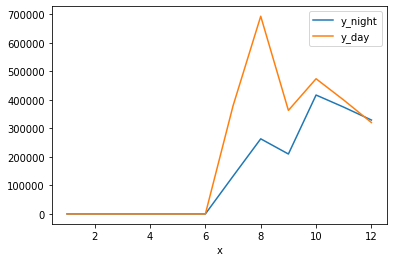

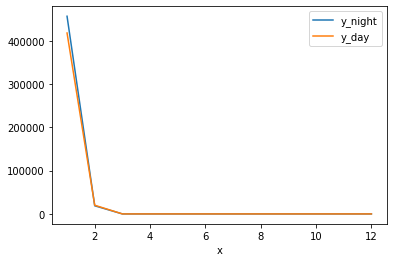

2 month
february day
18807.707212925645 february total distance at nigth
26821.61176471137 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
18807.707212925645
18807.707212925645
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
26821.61176471137
0
0
0
0
0
0
0
0
0
0


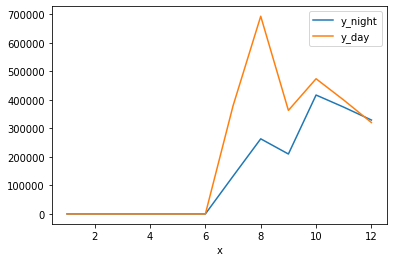

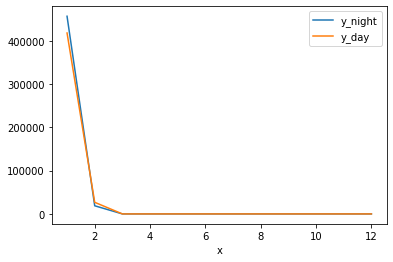

2 month
february day
18807.707212925645 february total distance at nigth
32163.331542627562 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
18807.707212925645
18807.707212925645
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
32163.331542627562
0
0
0
0
0
0
0
0
0
0


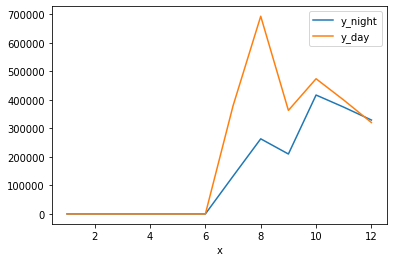

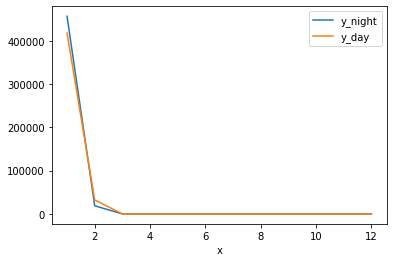

2 month
february nigth
21773.91723582315 february total distance at nigth
32163.331542627562 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
21773.91723582315
21773.91723582315
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
32163.331542627562
0
0
0
0
0
0
0
0
0
0


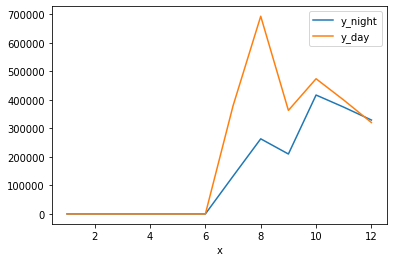

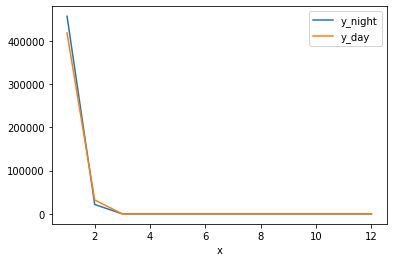

2 month
february nigth
24484.84474232113 february total distance at nigth
32163.331542627562 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
24484.84474232113
24484.84474232113
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
32163.331542627562
0
0
0
0
0
0
0
0
0
0


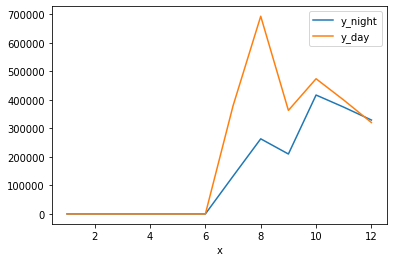

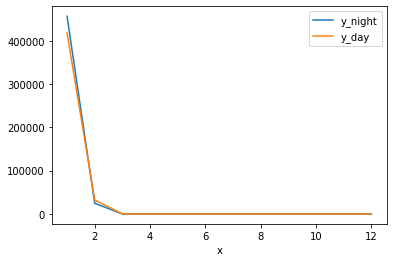

2 month
february nigth
25504.68025965439 february total distance at nigth
32163.331542627562 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
25504.68025965439
25504.68025965439
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
32163.331542627562
0
0
0
0
0
0
0
0
0
0


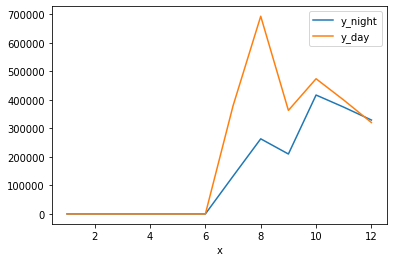

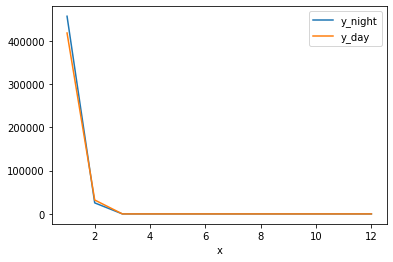

2 month
february nigth
26365.888442788193 february total distance at nigth
32163.331542627562 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
26365.888442788193
26365.888442788193
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
32163.331542627562
0
0
0
0
0
0
0
0
0
0


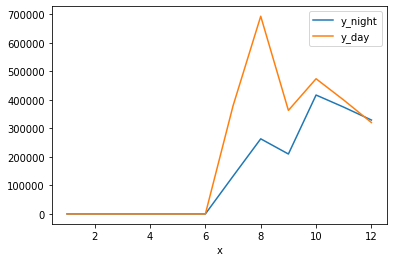

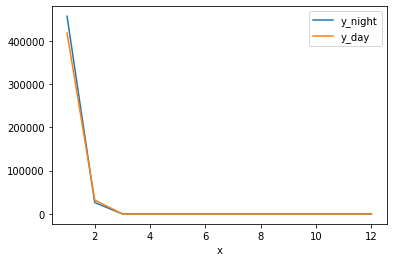

2 month
february nigth
28516.586388231437 february total distance at nigth
32163.331542627562 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
28516.586388231437
28516.586388231437
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
32163.331542627562
0
0
0
0
0
0
0
0
0
0


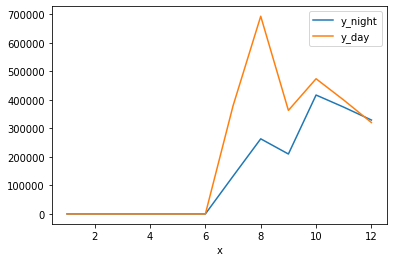

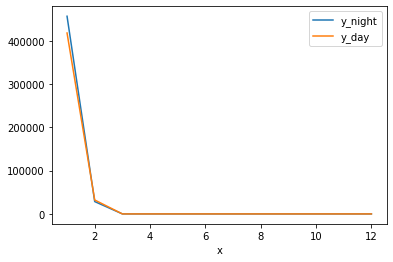

2 month
february day
28516.586388231437 february total distance at nigth
35186.18281996906 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
28516.586388231437
28516.586388231437
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
35186.18281996906
0
0
0
0
0
0
0
0
0
0


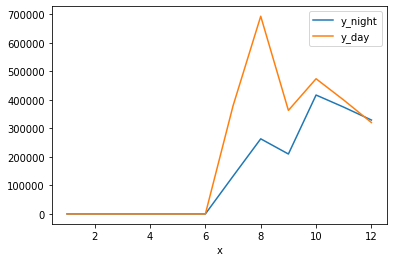

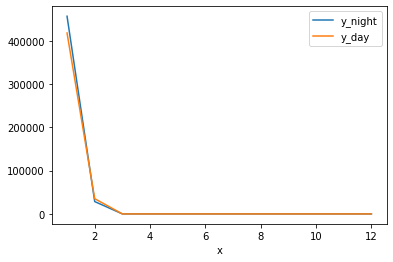

2 month
february day
28516.586388231437 february total distance at nigth
39890.453418316494 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
28516.586388231437
28516.586388231437
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
39890.453418316494
0
0
0
0
0
0
0
0
0
0


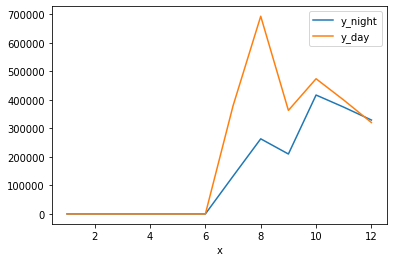

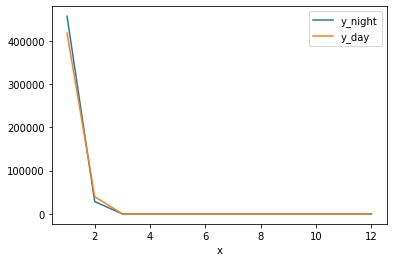

2 month
february day
28516.586388231437 february total distance at nigth
41829.21246265627 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
28516.586388231437
28516.586388231437
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
41829.21246265627
0
0
0
0
0
0
0
0
0
0


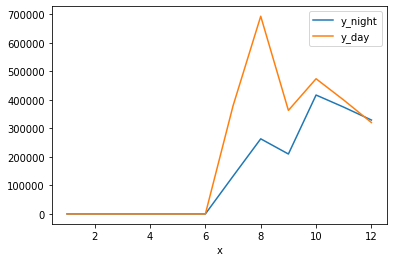

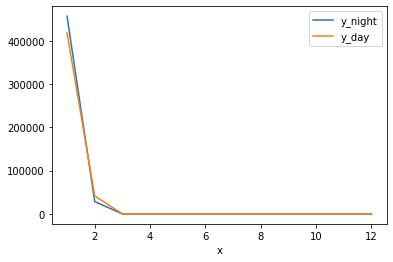

2 month
february day
28516.586388231437 february total distance at nigth
42697.10502116598 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
28516.586388231437
28516.586388231437
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
42697.10502116598
0
0
0
0
0
0
0
0
0
0


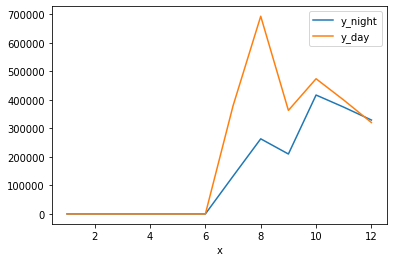

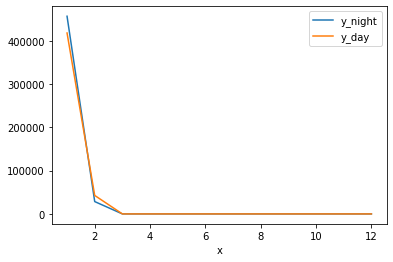

2 month
february day
28516.586388231437 february total distance at nigth
43391.08654464351 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
28516.586388231437
28516.586388231437
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
43391.08654464351
0
0
0
0
0
0
0
0
0
0


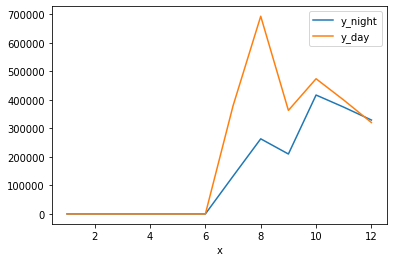

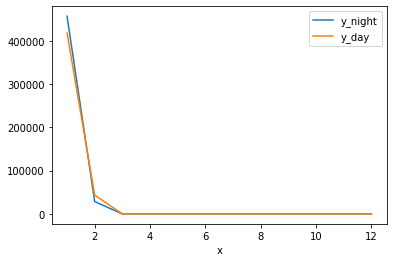

2 month
february nigth
33094.72939651024 february total distance at nigth
43391.08654464351 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
33094.72939651024
33094.72939651024
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
43391.08654464351
0
0
0
0
0
0
0
0
0
0


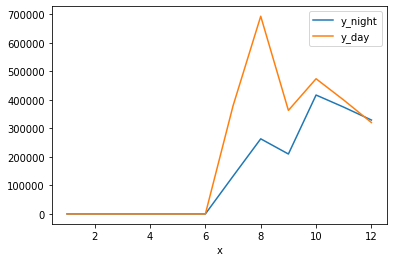

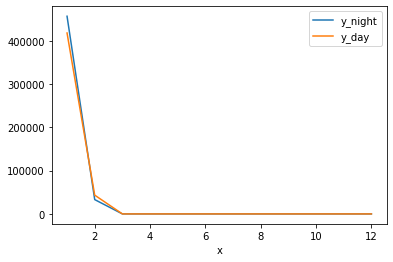

2 month
february nigth
36173.374497104436 february total distance at nigth
43391.08654464351 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
36173.374497104436
36173.374497104436
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
43391.08654464351
0
0
0
0
0
0
0
0
0
0


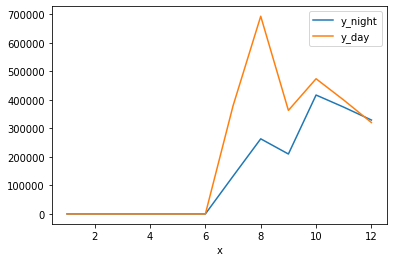

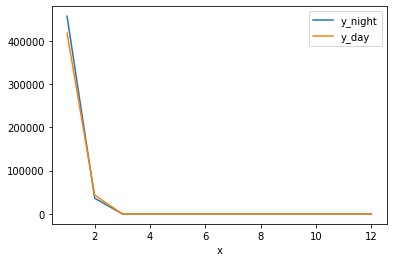

2 month
february nigth
36330.895846494146 february total distance at nigth
43391.08654464351 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
36330.895846494146
36330.895846494146
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
43391.08654464351
0
0
0
0
0
0
0
0
0
0


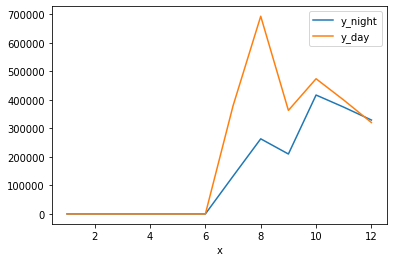

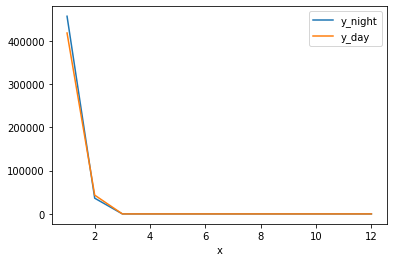

2 month
february nigth
37788.92866842045 february total distance at nigth
43391.08654464351 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
37788.92866842045
37788.92866842045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
43391.08654464351
0
0
0
0
0
0
0
0
0
0


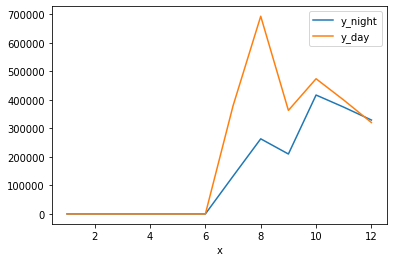

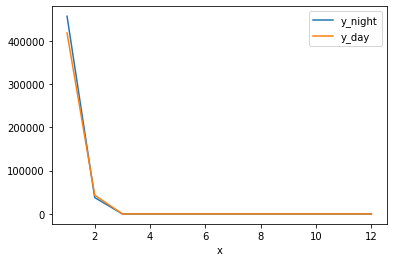

2 month
february day
37788.92866842045 february total distance at nigth
46014.67536892569 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
37788.92866842045
37788.92866842045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
46014.67536892569
0
0
0
0
0
0
0
0
0
0


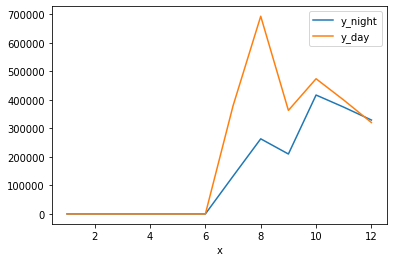

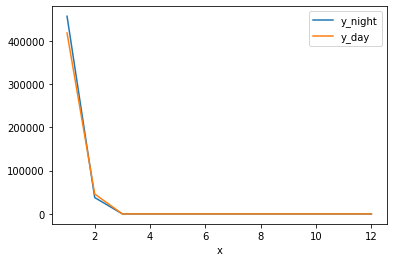

2 month
february day
37788.92866842045 february total distance at nigth
46969.24522080857 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
37788.92866842045
37788.92866842045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
46969.24522080857
0
0
0
0
0
0
0
0
0
0


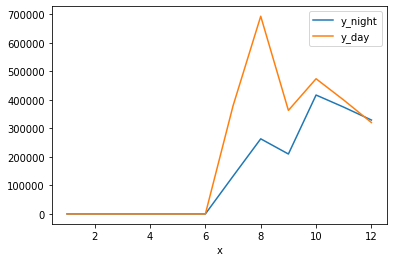

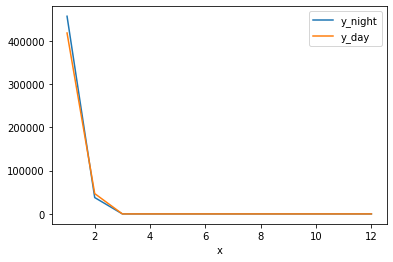

2 month
february day
37788.92866842045 february total distance at nigth
48246.70657763013 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
37788.92866842045
37788.92866842045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
48246.70657763013
0
0
0
0
0
0
0
0
0
0


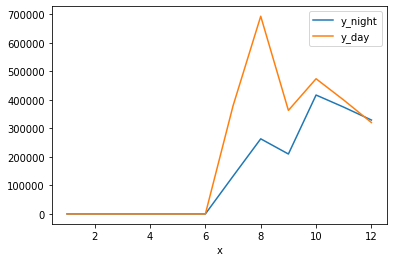

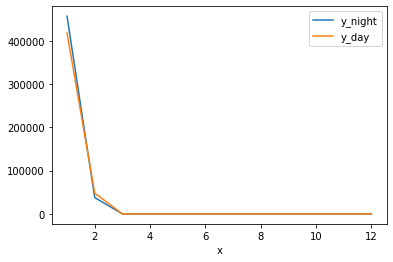

2 month
february day
37788.92866842045 february total distance at nigth
49792.351712285395 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
37788.92866842045
37788.92866842045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
49792.351712285395
0
0
0
0
0
0
0
0
0
0


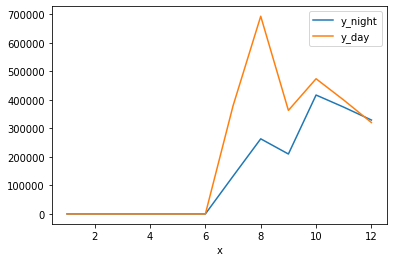

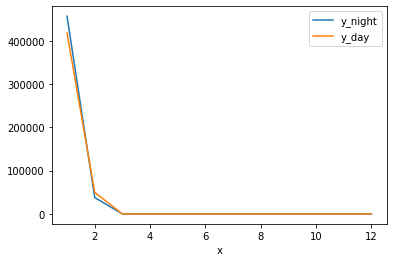

2 month
february day
37788.92866842045 february total distance at nigth
49855.88173147518 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
37788.92866842045
37788.92866842045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
49855.88173147518
0
0
0
0
0
0
0
0
0
0


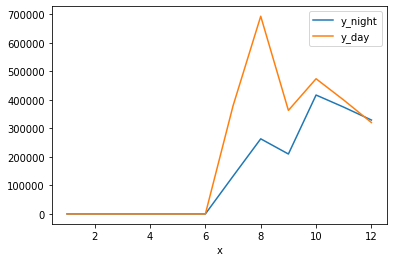

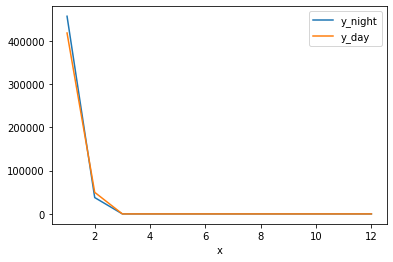

2 month
february day
37788.92866842045 february total distance at nigth
51107.24633189555 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
37788.92866842045
37788.92866842045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
51107.24633189555
0
0
0
0
0
0
0
0
0
0


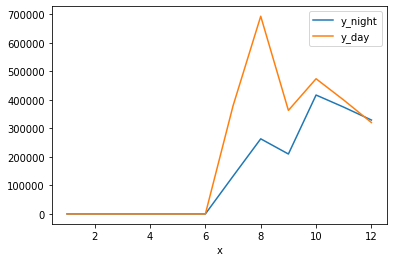

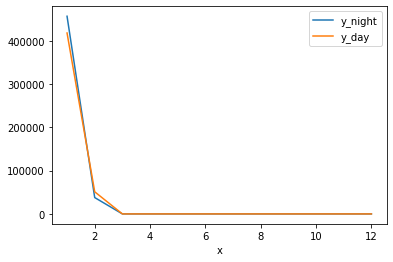

2 month
february day
37788.92866842045 february total distance at nigth
53867.74987361721 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
37788.92866842045
37788.92866842045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
53867.74987361721
0
0
0
0
0
0
0
0
0
0


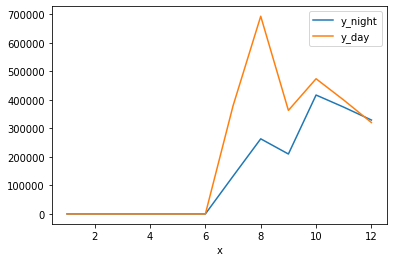

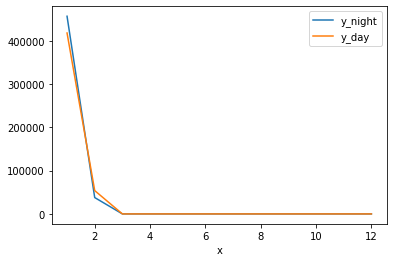

2 month
february day
37788.92866842045 february total distance at nigth
54892.81089840875 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
37788.92866842045
37788.92866842045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
54892.81089840875
0
0
0
0
0
0
0
0
0
0


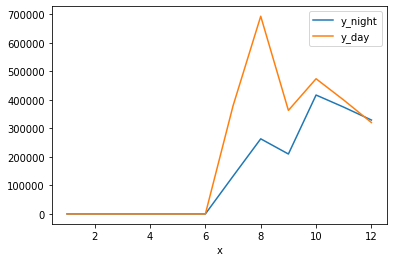

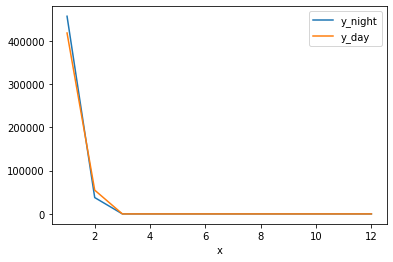

2 month
february day
37788.92866842045 february total distance at nigth
56445.823190400835 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
37788.92866842045
37788.92866842045
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
56445.823190400835
0
0
0
0
0
0
0
0
0
0


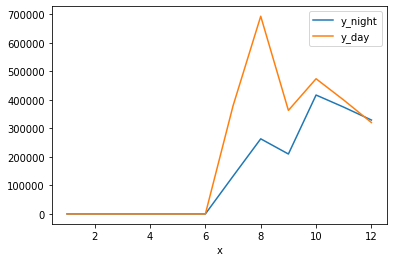

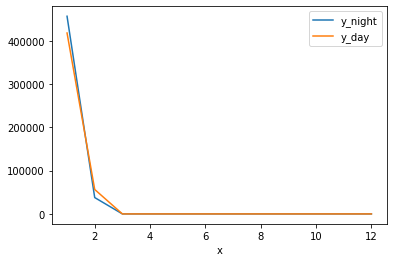

2 month
february nigth
39619.86358972196 february total distance at nigth
56445.823190400835 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
39619.86358972196
39619.86358972196
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
56445.823190400835
0
0
0
0
0
0
0
0
0
0


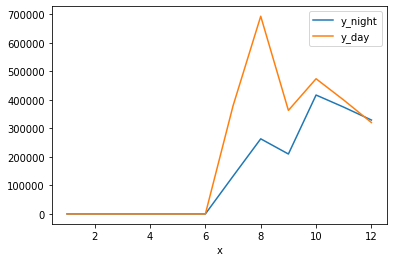

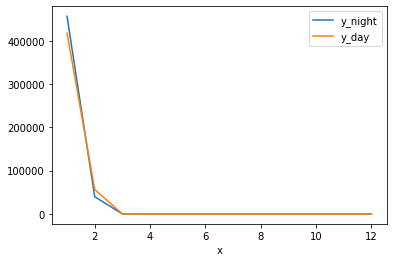

2 month
february nigth
40925.3007085836 february total distance at nigth
56445.823190400835 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
40925.3007085836
40925.3007085836
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
56445.823190400835
0
0
0
0
0
0
0
0
0
0


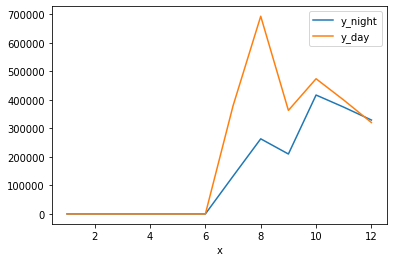

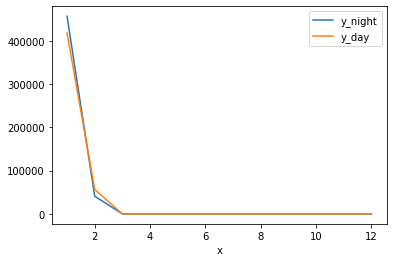

2 month
february nigth
41074.39575226767 february total distance at nigth
56445.823190400835 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
41074.39575226767
41074.39575226767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
56445.823190400835
0
0
0
0
0
0
0
0
0
0


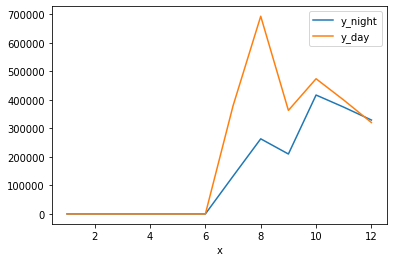

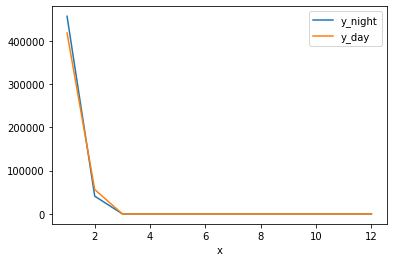

2 month
february nigth
41725.62127151159 february total distance at nigth
56445.823190400835 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
41725.62127151159
41725.62127151159
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
56445.823190400835
0
0
0
0
0
0
0
0
0
0


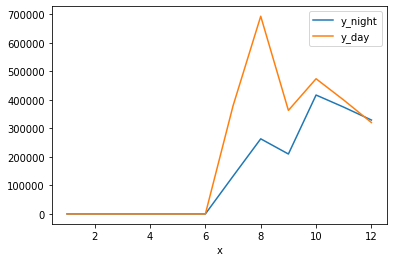

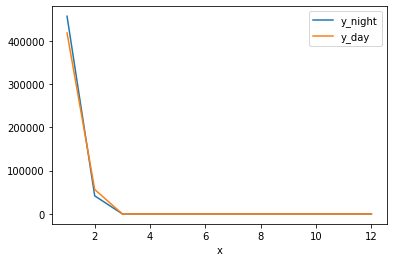

2 month
february nigth
41760.32891412371 february total distance at nigth
56445.823190400835 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
41760.32891412371
41760.32891412371
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
56445.823190400835
0
0
0
0
0
0
0
0
0
0


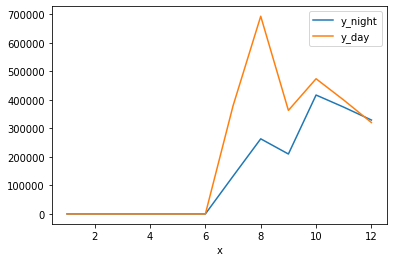

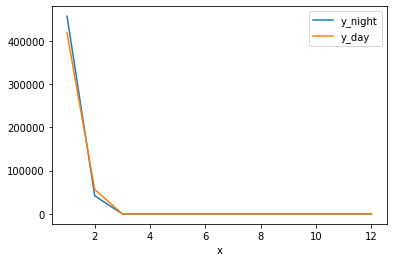

2 month
february nigth
41916.67134486921 february total distance at nigth
56445.823190400835 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
41916.67134486921
41916.67134486921
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
56445.823190400835
0
0
0
0
0
0
0
0
0
0


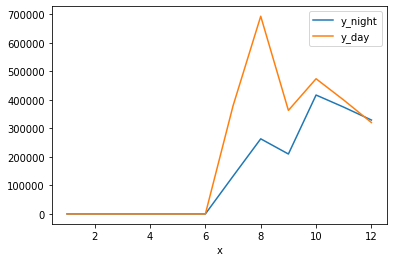

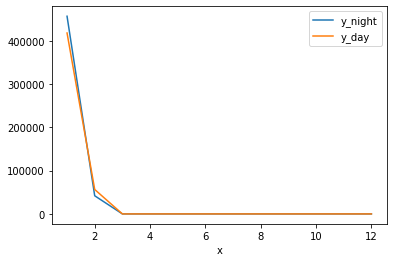

2 month
february nigth
42360.3303366341 february total distance at nigth
56445.823190400835 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
42360.3303366341
42360.3303366341
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
56445.823190400835
0
0
0
0
0
0
0
0
0
0


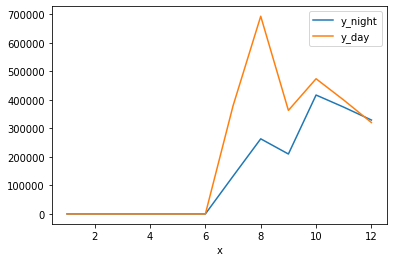

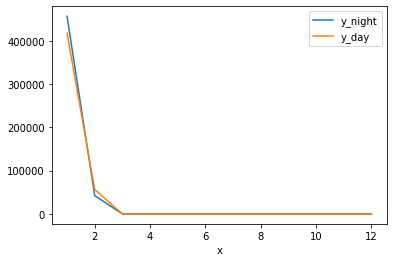

2 month
february day
42360.3303366341 february total distance at nigth
59104.26519287606 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
42360.3303366341
42360.3303366341
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
59104.26519287606
0
0
0
0
0
0
0
0
0
0


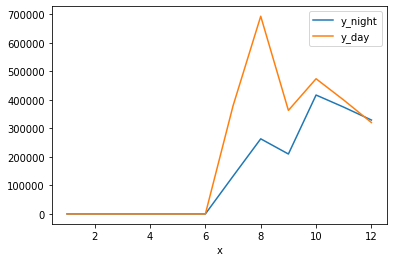

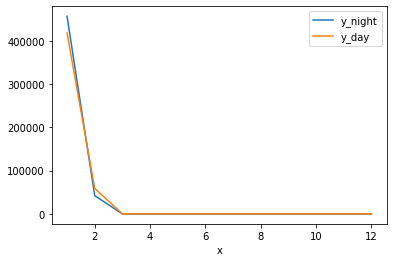

2 month
february day
42360.3303366341 february total distance at nigth
59460.95931607143 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
42360.3303366341
42360.3303366341
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
59460.95931607143
0
0
0
0
0
0
0
0
0
0


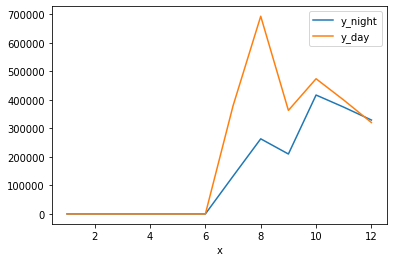

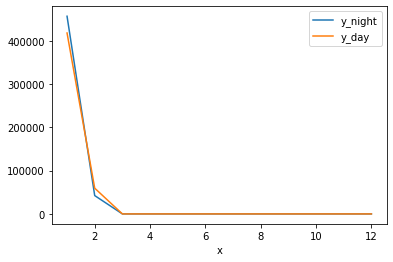

2 month
february day
42360.3303366341 february total distance at nigth
62663.46485731737 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
42360.3303366341
42360.3303366341
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
62663.46485731737
0
0
0
0
0
0
0
0
0
0


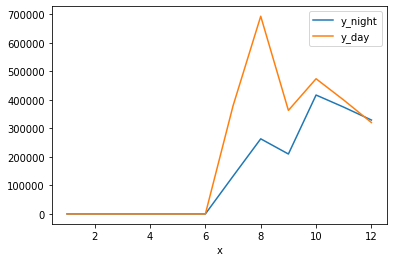

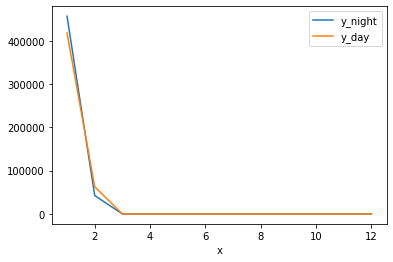

2 month
february day
42360.3303366341 february total distance at nigth
63393.40693359766 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
42360.3303366341
42360.3303366341
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
63393.40693359766
0
0
0
0
0
0
0
0
0
0


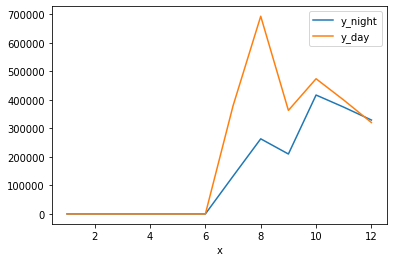

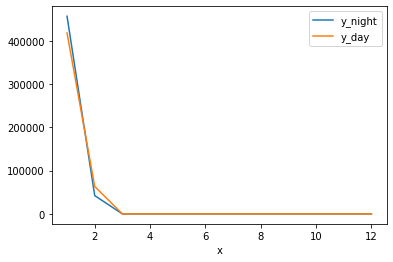

2 month
february day
42360.3303366341 february total distance at nigth
64952.28003475305 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
42360.3303366341
42360.3303366341
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
64952.28003475305
0
0
0
0
0
0
0
0
0
0


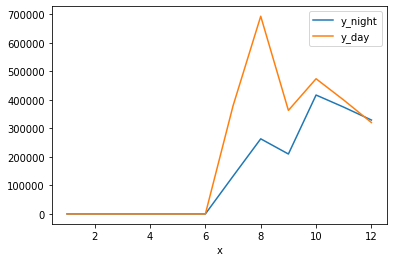

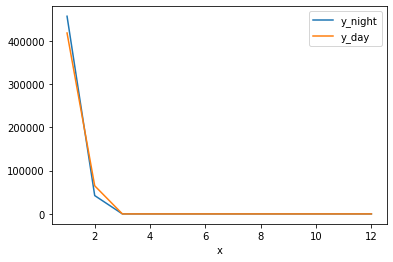

2 month
february day
42360.3303366341 february total distance at nigth
67854.22135164306 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
42360.3303366341
42360.3303366341
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
67854.22135164306
0
0
0
0
0
0
0
0
0
0


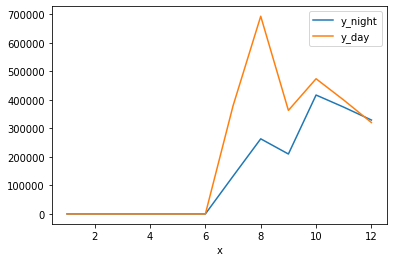

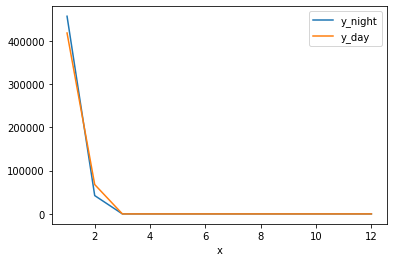

2 month
february nigth
43027.01194289151 february total distance at nigth
67854.22135164306 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
43027.01194289151
43027.01194289151
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
67854.22135164306
0
0
0
0
0
0
0
0
0
0


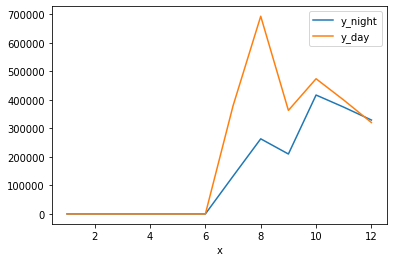

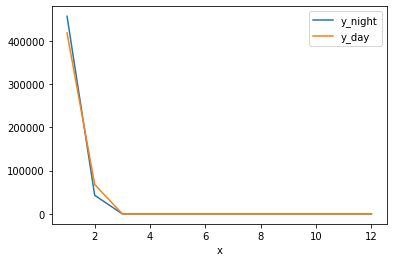

2 month
february nigth
43225.97053226965 february total distance at nigth
67854.22135164306 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
43225.97053226965
43225.97053226965
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
67854.22135164306
0
0
0
0
0
0
0
0
0
0


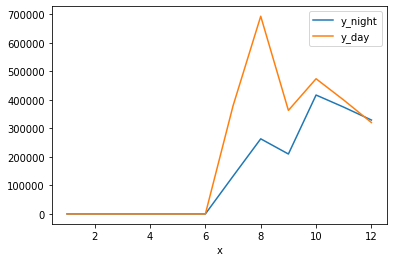

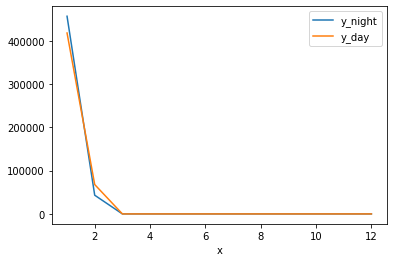

2 month
february nigth
43420.0582885407 february total distance at nigth
67854.22135164306 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
43420.0582885407
43420.0582885407
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
67854.22135164306
0
0
0
0
0
0
0
0
0
0


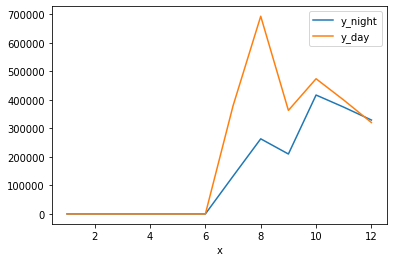

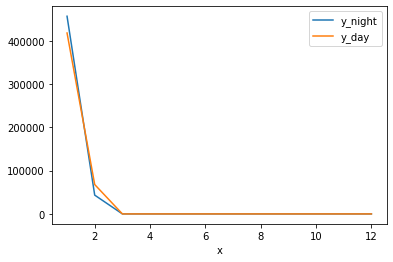

2 month
february nigth
44387.512951098084 february total distance at nigth
67854.22135164306 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
44387.512951098084
44387.512951098084
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
67854.22135164306
0
0
0
0
0
0
0
0
0
0


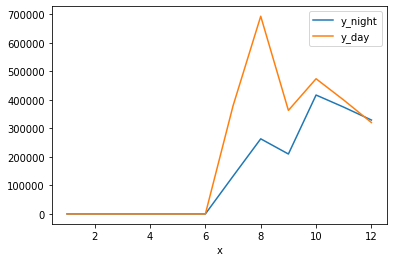

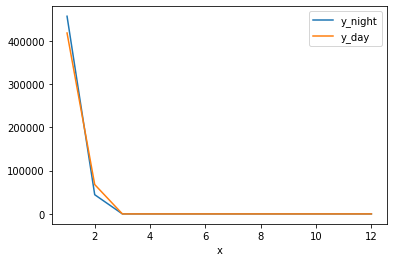

2 month
february nigth
46761.20541068929 february total distance at nigth
67854.22135164306 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
46761.20541068929
46761.20541068929
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
67854.22135164306
0
0
0
0
0
0
0
0
0
0


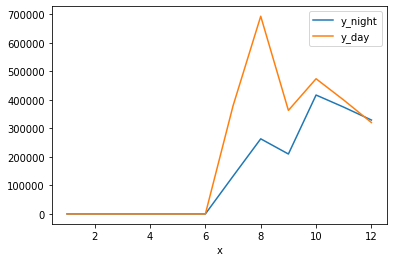

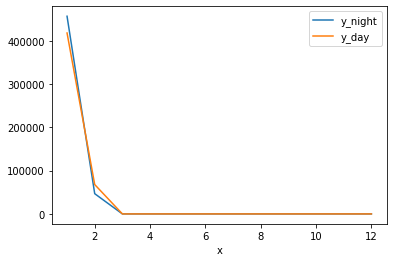

2 month
february nigth
49596.55913119385 february total distance at nigth
67854.22135164306 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
49596.55913119385
49596.55913119385
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
67854.22135164306
0
0
0
0
0
0
0
0
0
0


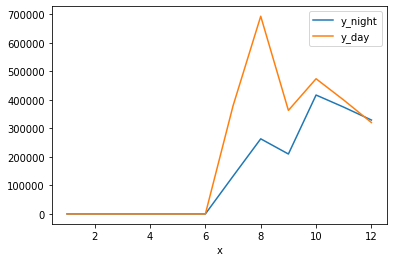

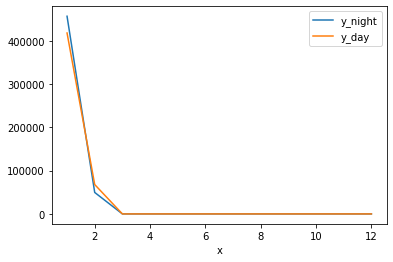

2 month
february day
49596.55913119385 february total distance at nigth
70322.27591706753 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
49596.55913119385
49596.55913119385
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
70322.27591706753
0
0
0
0
0
0
0
0
0
0


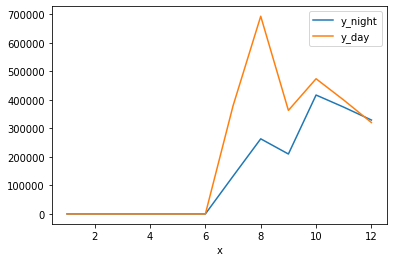

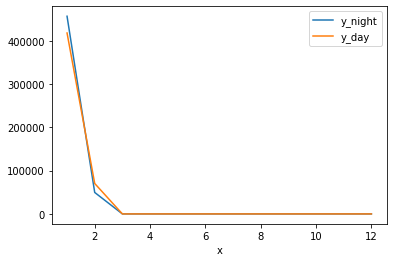

2 month
february day
49596.55913119385 february total distance at nigth
72247.32374975392 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
49596.55913119385
49596.55913119385
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
72247.32374975392
0
0
0
0
0
0
0
0
0
0


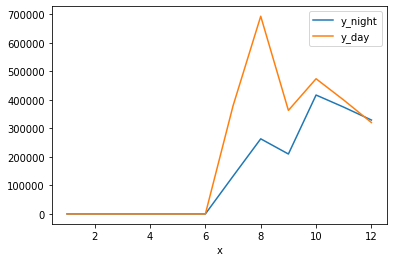

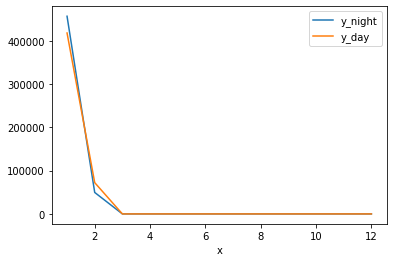

2 month
february day
49596.55913119385 february total distance at nigth
73526.95806674016 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
49596.55913119385
49596.55913119385
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
73526.95806674016
0
0
0
0
0
0
0
0
0
0


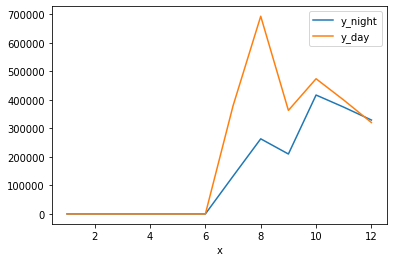

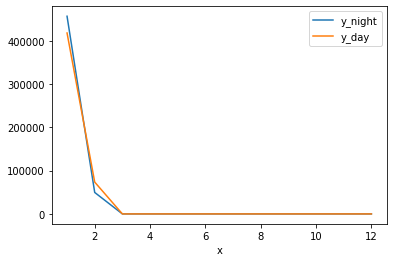

2 month
february day
49596.55913119385 february total distance at nigth
74705.2762883475 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
49596.55913119385
49596.55913119385
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
74705.2762883475
0
0
0
0
0
0
0
0
0
0


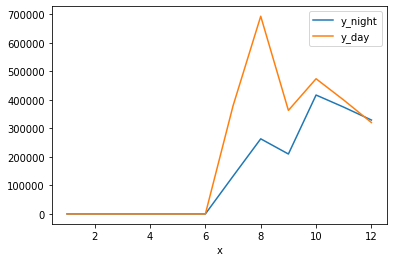

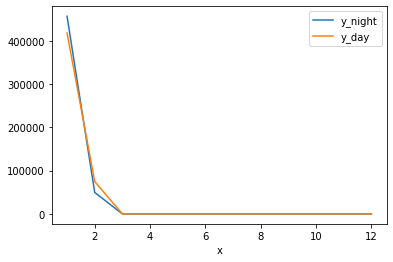

2 month
february day
49596.55913119385 february total distance at nigth
74832.62020439225 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
49596.55913119385
49596.55913119385
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
74832.62020439225
0
0
0
0
0
0
0
0
0
0


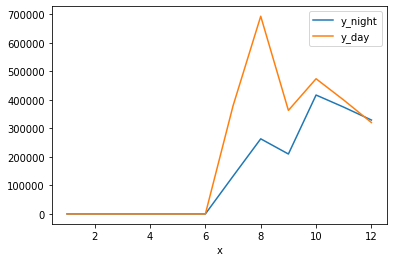

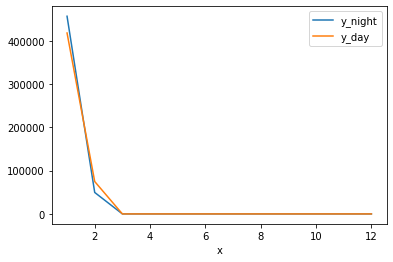

2 month
february day
49596.55913119385 february total distance at nigth
76102.73409549861 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
49596.55913119385
49596.55913119385
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
76102.73409549861
0
0
0
0
0
0
0
0
0
0


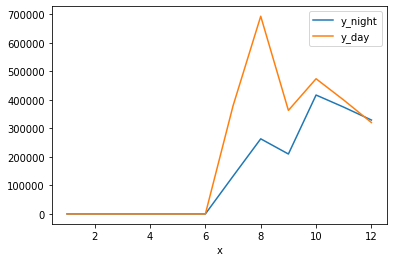

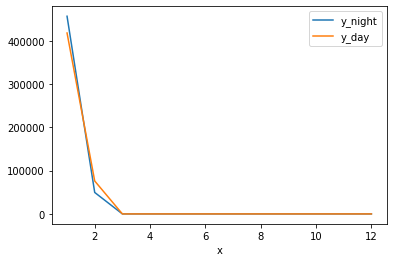

2 month
february nigth
51889.05624465031 february total distance at nigth
76102.73409549861 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
51889.05624465031
51889.05624465031
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
76102.73409549861
0
0
0
0
0
0
0
0
0
0


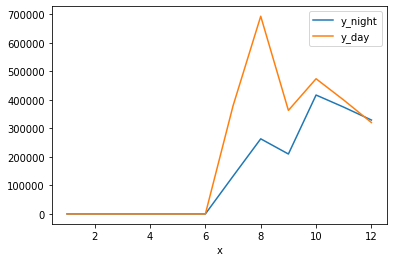

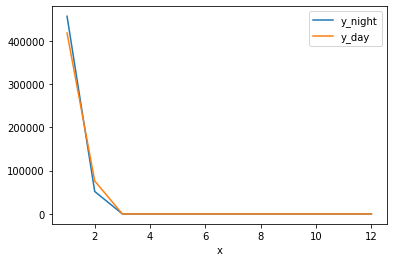

2 month
february nigth
53959.18167691716 february total distance at nigth
76102.73409549861 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
53959.18167691716
53959.18167691716
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
76102.73409549861
0
0
0
0
0
0
0
0
0
0


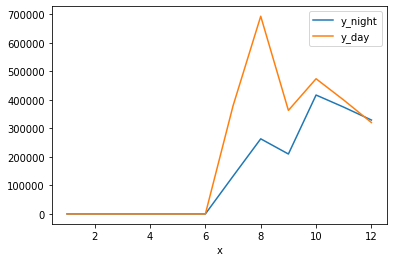

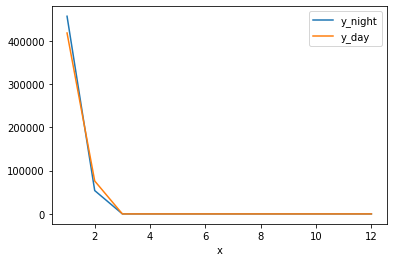

2 month
february nigth
56302.908066395066 february total distance at nigth
76102.73409549861 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
56302.908066395066
56302.908066395066
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
76102.73409549861
0
0
0
0
0
0
0
0
0
0


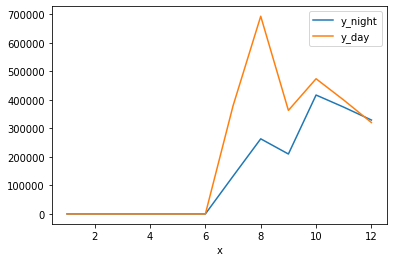

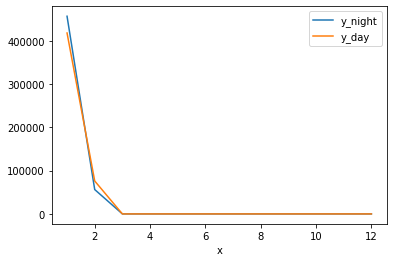

2 month
february nigth
56544.99662468892 february total distance at nigth
76102.73409549861 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
56544.99662468892
56544.99662468892
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
76102.73409549861
0
0
0
0
0
0
0
0
0
0


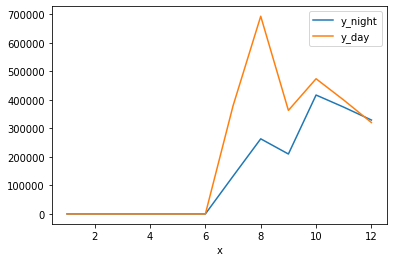

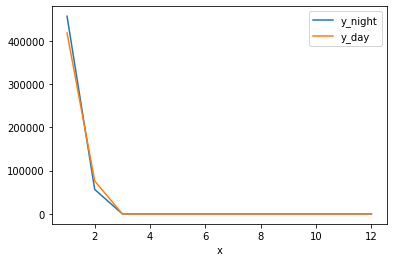

2 month
february nigth
59042.00538042404 february total distance at nigth
76102.73409549861 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
59042.00538042404
59042.00538042404
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
76102.73409549861
0
0
0
0
0
0
0
0
0
0


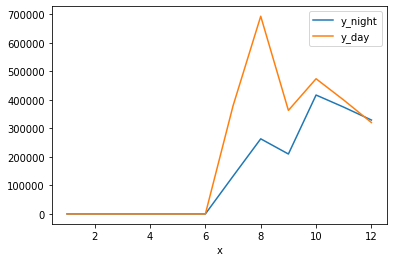

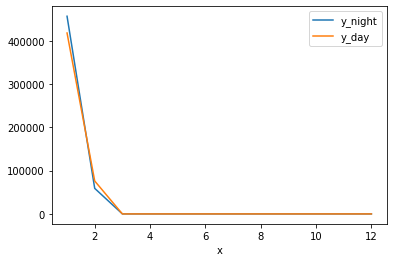

2 month
february day
59042.00538042404 february total distance at nigth
78329.18502419429 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
59042.00538042404
59042.00538042404
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
78329.18502419429
0
0
0
0
0
0
0
0
0
0


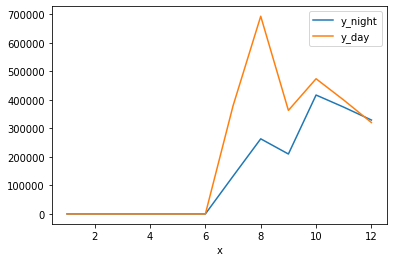

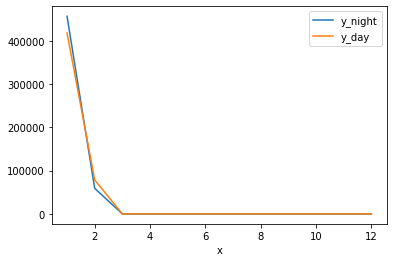

2 month
february day
59042.00538042404 february total distance at nigth
78400.06332231023 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
59042.00538042404
59042.00538042404
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
78400.06332231023
0
0
0
0
0
0
0
0
0
0


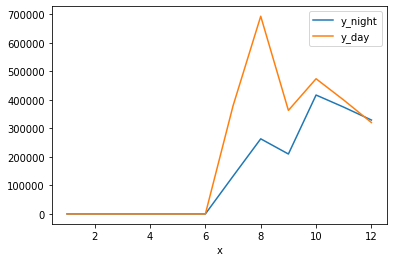

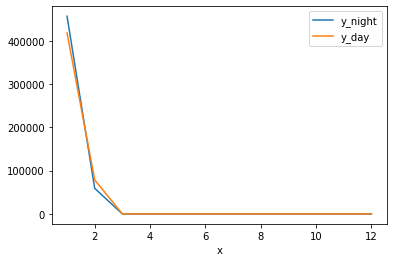

2 month
february day
59042.00538042404 february total distance at nigth
78902.29142527643 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
59042.00538042404
59042.00538042404
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
78902.29142527643
0
0
0
0
0
0
0
0
0
0


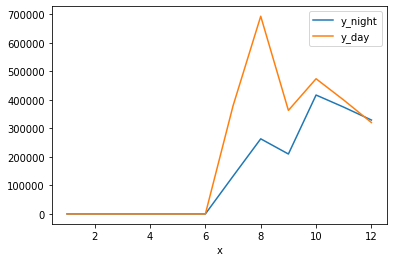

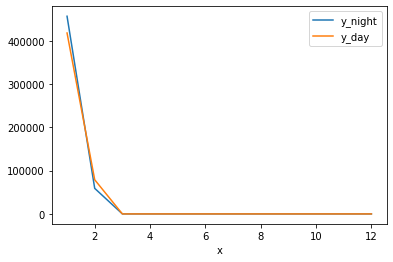

2 month
february day
59042.00538042404 february total distance at nigth
82050.73686889798 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
59042.00538042404
59042.00538042404
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
82050.73686889798
0
0
0
0
0
0
0
0
0
0


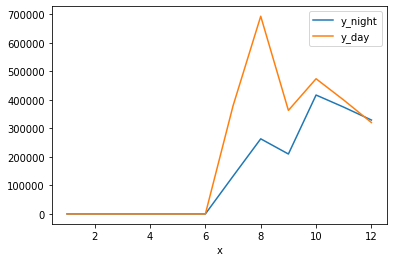

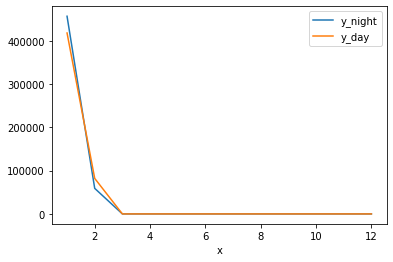

2 month
february day
59042.00538042404 february total distance at nigth
83441.7206769553 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
59042.00538042404
59042.00538042404
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
83441.7206769553
0
0
0
0
0
0
0
0
0
0


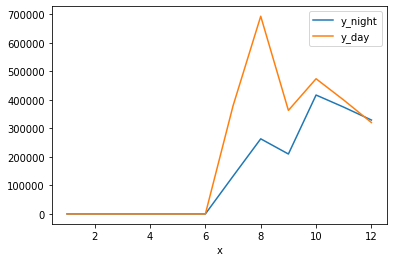

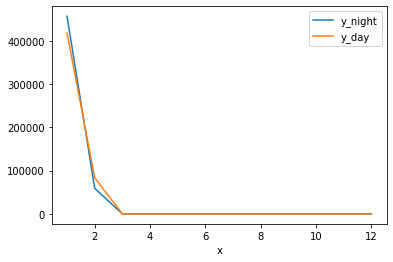

2 month
february nigth
59888.02767769978 february total distance at nigth
83441.7206769553 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
59888.02767769978
59888.02767769978
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
83441.7206769553
0
0
0
0
0
0
0
0
0
0


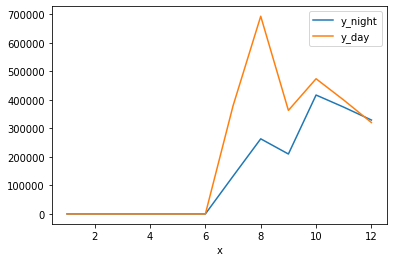

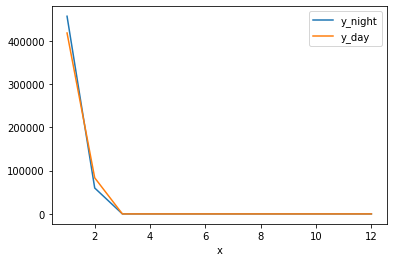

2 month
february nigth
61185.755420758804 february total distance at nigth
83441.7206769553 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
61185.755420758804
61185.755420758804
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
83441.7206769553
0
0
0
0
0
0
0
0
0
0


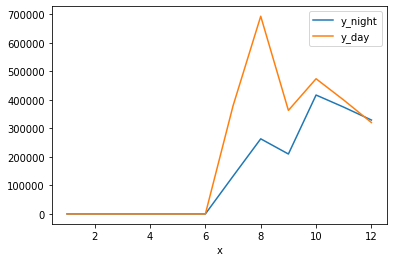

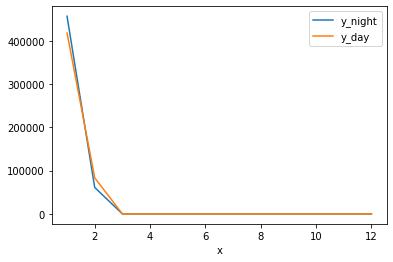

2 month
february nigth
62627.930891968266 february total distance at nigth
83441.7206769553 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
62627.930891968266
62627.930891968266
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
83441.7206769553
0
0
0
0
0
0
0
0
0
0


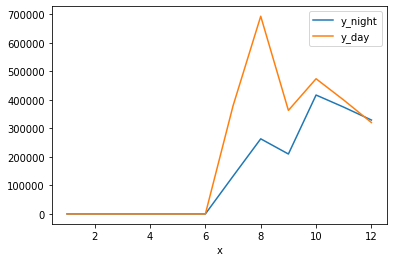

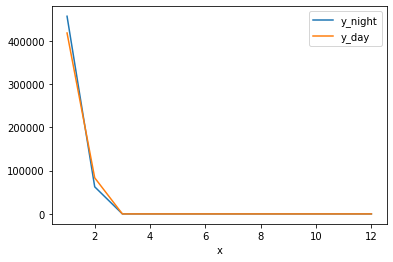

2 month
february nigth
64093.2346959675 february total distance at nigth
83441.7206769553 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
64093.2346959675
64093.2346959675
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
83441.7206769553
0
0
0
0
0
0
0
0
0
0


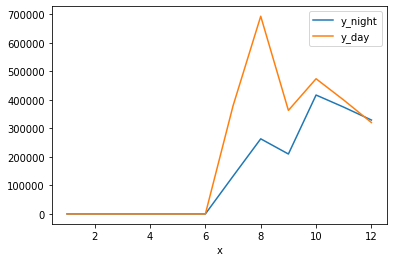

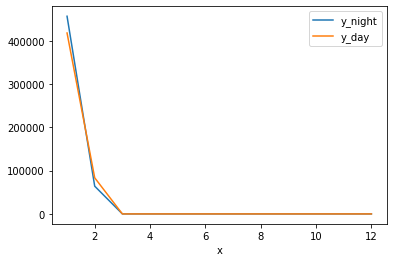

2 month
february nigth
64111.726896190296 february total distance at nigth
83441.7206769553 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
64111.726896190296
64111.726896190296
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
83441.7206769553
0
0
0
0
0
0
0
0
0
0


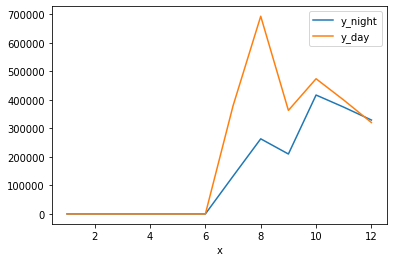

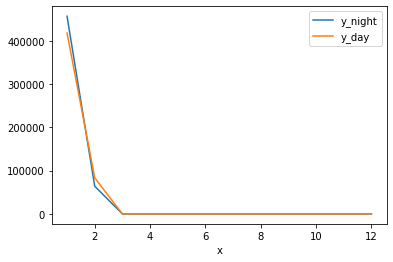

2 month
february day
64111.726896190296 february total distance at nigth
84659.45115504271 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
64111.726896190296
64111.726896190296
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
84659.45115504271
0
0
0
0
0
0
0
0
0
0


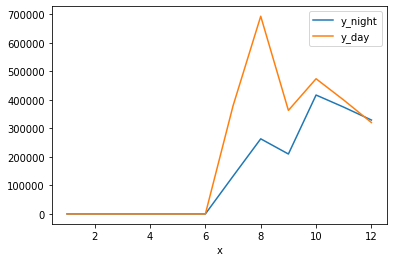

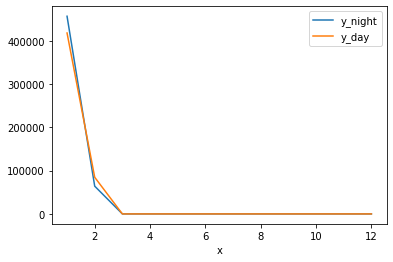

2 month
february day
64111.726896190296 february total distance at nigth
86226.73497807482 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
64111.726896190296
64111.726896190296
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
86226.73497807482
0
0
0
0
0
0
0
0
0
0


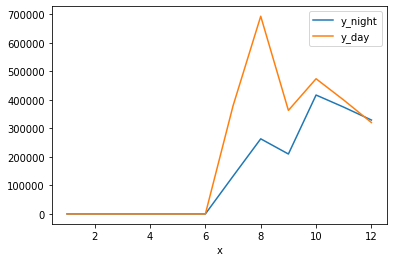

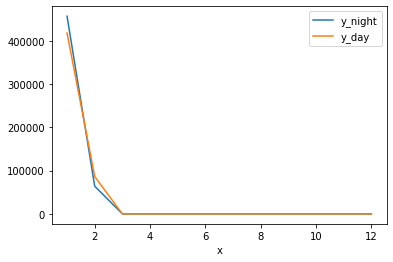

2 month
february nigth
65511.88439725622 february total distance at nigth
86226.73497807482 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
65511.88439725622
65511.88439725622
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
86226.73497807482
0
0
0
0
0
0
0
0
0
0


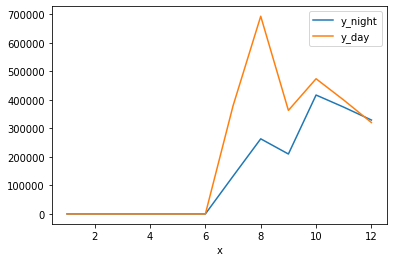

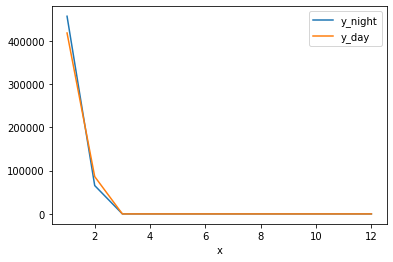

2 month
february nigth
66935.25710448758 february total distance at nigth
86226.73497807482 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
66935.25710448758
66935.25710448758
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
86226.73497807482
0
0
0
0
0
0
0
0
0
0


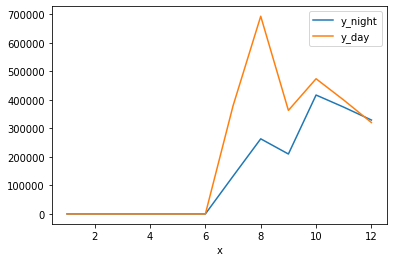

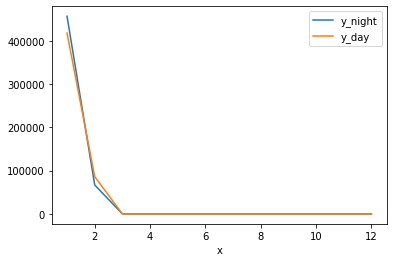

2 month
february nigth
69143.43745000935 february total distance at nigth
86226.73497807482 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
69143.43745000935
69143.43745000935
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
86226.73497807482
0
0
0
0
0
0
0
0
0
0


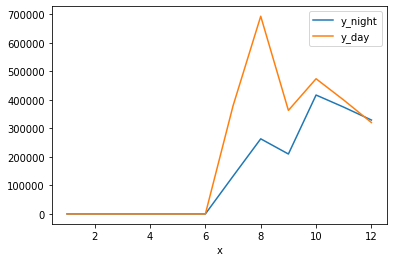

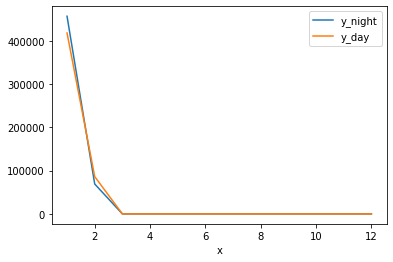

2 month
february day
69143.43745000935 february total distance at nigth
89770.57664546922 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
69143.43745000935
69143.43745000935
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
89770.57664546922
0
0
0
0
0
0
0
0
0
0


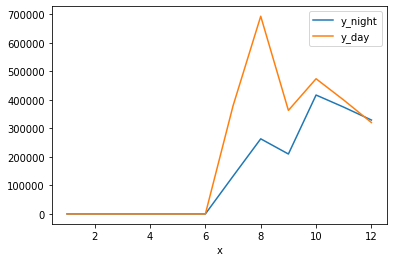

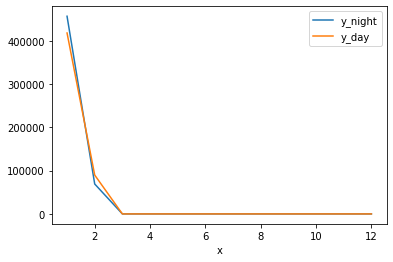

2 month
february day
69143.43745000935 february total distance at nigth
91192.28761712833 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
69143.43745000935
69143.43745000935
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
91192.28761712833
0
0
0
0
0
0
0
0
0
0


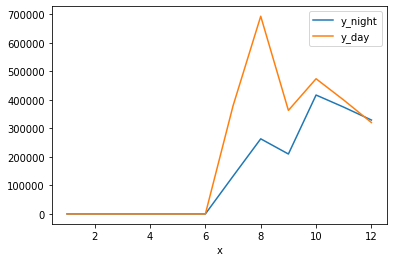

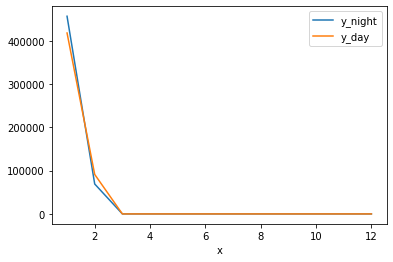

2 month
february day
69143.43745000935 february total distance at nigth
93416.52773879976 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
69143.43745000935
69143.43745000935
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
93416.52773879976
0
0
0
0
0
0
0
0
0
0


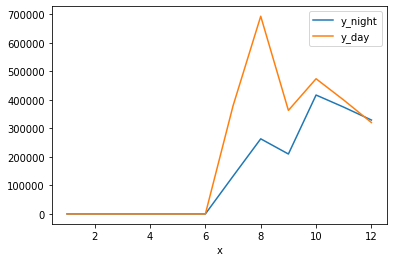

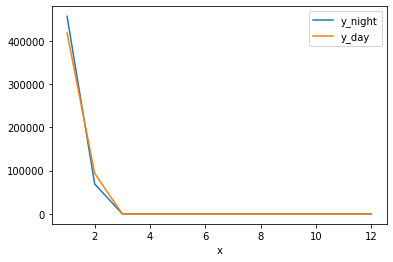

2 month
february nigth
69805.41276650057 february total distance at nigth
93416.52773879976 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
69805.41276650057
69805.41276650057
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
93416.52773879976
0
0
0
0
0
0
0
0
0
0


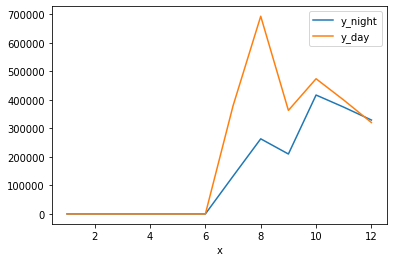

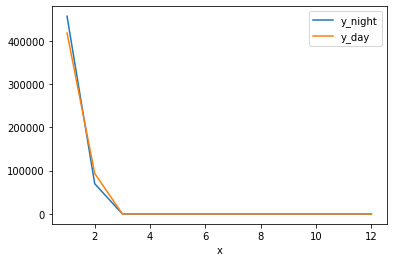

2 month
february nigth
70442.90691980024 february total distance at nigth
93416.52773879976 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
70442.90691980024
70442.90691980024
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
93416.52773879976
0
0
0
0
0
0
0
0
0
0


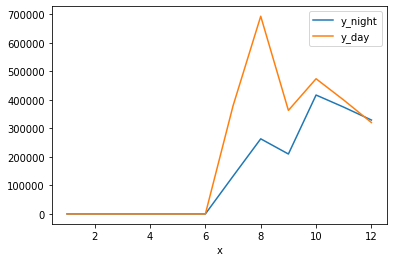

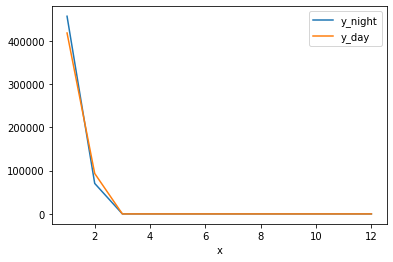

2 month
february nigth
70831.64138521065 february total distance at nigth
93416.52773879976 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
70831.64138521065
70831.64138521065
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
93416.52773879976
0
0
0
0
0
0
0
0
0
0


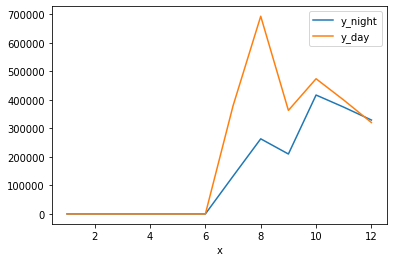

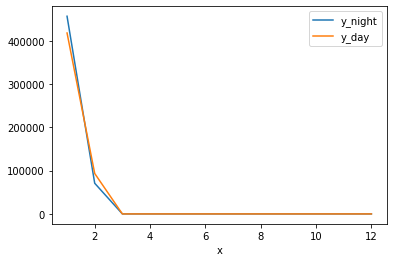

2 month
february day
70831.64138521065 february total distance at nigth
95474.87214385337 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
70831.64138521065
70831.64138521065
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
95474.87214385337
0
0
0
0
0
0
0
0
0
0


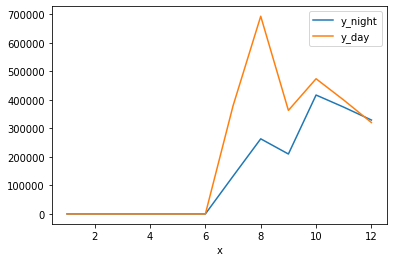

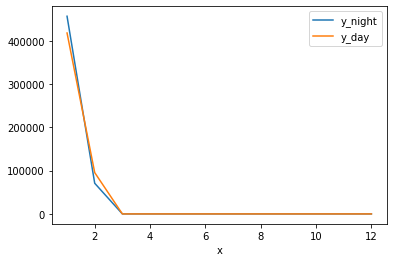

2 month
february day
70831.64138521065 february total distance at nigth
95541.24904090108 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
70831.64138521065
70831.64138521065
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
95541.24904090108
0
0
0
0
0
0
0
0
0
0


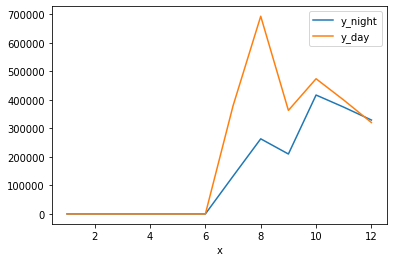

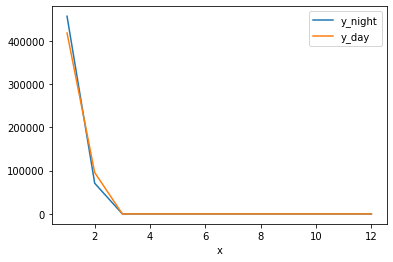

2 month
february day
70831.64138521065 february total distance at nigth
98578.54823160845 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
70831.64138521065
70831.64138521065
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
98578.54823160845
0
0
0
0
0
0
0
0
0
0


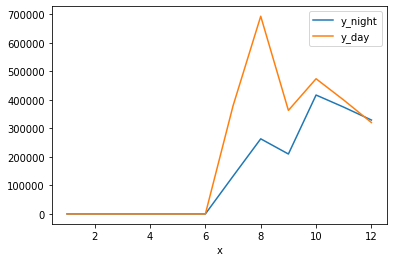

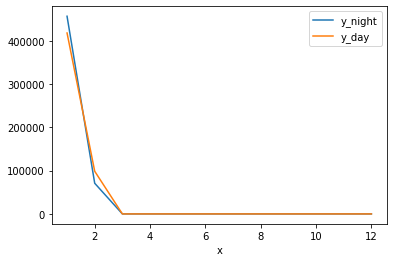

2 month
february nigth
72838.29050532213 february total distance at nigth
98578.54823160845 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
72838.29050532213
72838.29050532213
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
98578.54823160845
0
0
0
0
0
0
0
0
0
0


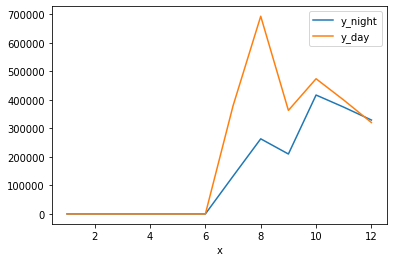

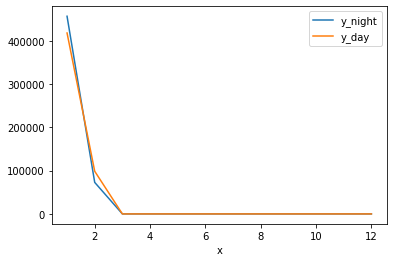

2 month
february nigth
74604.09911857411 february total distance at nigth
98578.54823160845 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
74604.09911857411
74604.09911857411
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
98578.54823160845
0
0
0
0
0
0
0
0
0
0


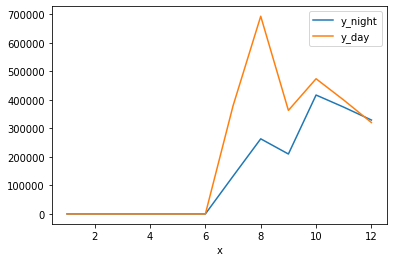

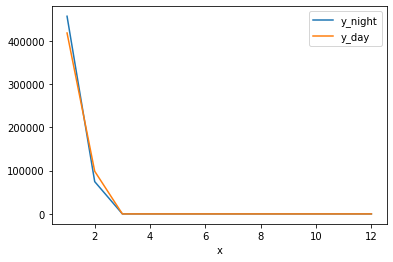

2 month
february nigth
76184.29479282 february total distance at nigth
98578.54823160845 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
76184.29479282
76184.29479282
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
98578.54823160845
0
0
0
0
0
0
0
0
0
0


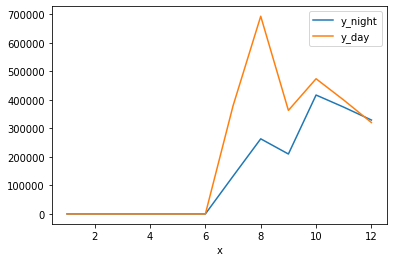

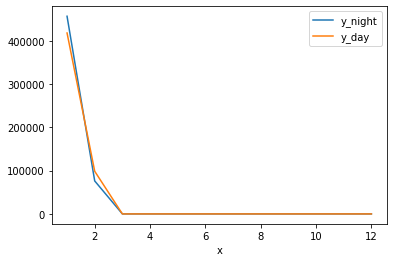

2 month
february day
76184.29479282 february total distance at nigth
99441.8688321928 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
76184.29479282
76184.29479282
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
99441.8688321928
0
0
0
0
0
0
0
0
0
0


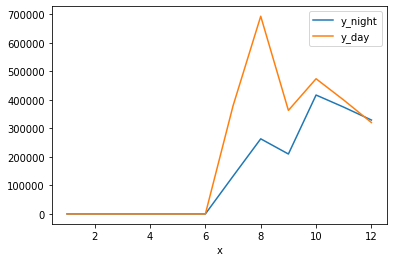

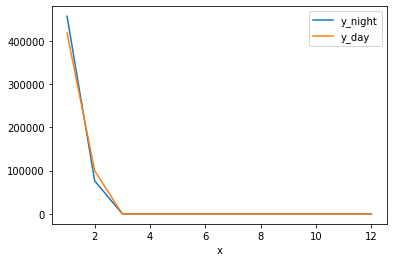

2 month
february day
76184.29479282 february total distance at nigth
99455.96432051544 february total distance in day
0
0
0
0
0
0
0
132379.1309072067
263480.0637701602
210207.72952569288
417158.63084430905
374641.61351172946
456775.3207150544
76184.29479282
76184.29479282
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
379448.9730221735
693629.2195393691
363308.92535631894
474252.94191415876
399514.1743418282
320609.36204441363
418082.3447454487
99455.96432051544
0
0
0
0
0
0
0
0
0
0


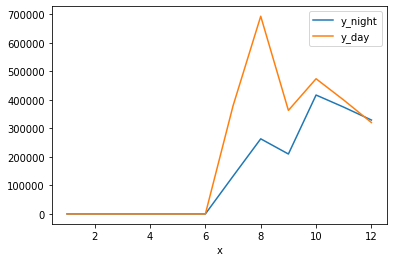

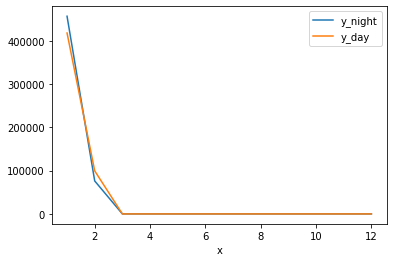

8 month
august nigth
0.0 august total distance at nigth
0 august total distance in day
8 month
august nigth
789.6777038518746 august total distance at nigth
0 august total distance in day
8 month
august nigth
1172.1420693028304 august total distance at nigth
0 august total distance in day
8 month
august nigth
1963.59917117756 august total distance at nigth
0 august total distance in day
8 month
august day
1963.59917117756 august total distance at nigth
2053.0927278881445 august total distance in day
8 month
august day
1963.59917117756 august total distance at nigth
6308.827905234051 august total distance in day
8 month
august day
1963.59917117756 august total distance at nigth
7051.290791122264 august total distance in day
8 month
august day
1963.59917117756 august total distance at nigth
8248.714376761473 august total distance in day
8 month
august day
1963.59917117756 august total distance at nigth
8308.76985715857 august total distance in day
8 month
august day
1963.59917117756 augu

85833.86091515583 august total distance at nigth
205325.32950223537 august total distance in day
8 month
august day
85833.86091515583 august total distance at nigth
206711.51286262667 august total distance in day
8 month
august day
85833.86091515583 august total distance at nigth
207983.88977746732 august total distance in day
8 month
august day
85833.86091515583 august total distance at nigth
209286.123400218 august total distance in day
8 month
august day
85833.86091515583 august total distance at nigth
210383.03694084796 august total distance in day
8 month
august day
85833.86091515583 august total distance at nigth
210843.30525225578 august total distance in day
8 month
august day
85833.86091515583 august total distance at nigth
212427.5322363297 august total distance in day
8 month
august day
85833.86091515583 august total distance at nigth
213828.17976153924 august total distance in day
8 month
august day
85833.86091515583 august total distance at nigth
215940.37057068312 august 

113916.70660977339 august total distance at nigth
290889.5852878563 august total distance in day
8 month
august nigth
114056.31829445923 august total distance at nigth
290889.5852878563 august total distance in day
8 month
august nigth
114205.21223455484 august total distance at nigth
290889.5852878563 august total distance in day
8 month
august nigth
114306.41681846426 august total distance at nigth
290889.5852878563 august total distance in day
8 month
august nigth
114545.11620616735 august total distance at nigth
290889.5852878563 august total distance in day
8 month
august nigth
114689.9708662375 august total distance at nigth
290889.5852878563 august total distance in day
8 month
august nigth
114778.72527262862 august total distance at nigth
290889.5852878563 august total distance in day
8 month
august nigth
114946.55981482234 august total distance at nigth
290889.5852878563 august total distance in day
8 month
august nigth
115096.40677041825 august total distance at nigth
290889.

9 month
september day
37888.01327579789 september total distance at nigth
93956.51235717615 september total distance in day
9 month
september day
37888.01327579789 september total distance at nigth
94051.5133372254 september total distance in day
9 month
september day
37888.01327579789 september total distance at nigth
94056.37569004772 september total distance in day
9 month
september day
37888.01327579789 september total distance at nigth
94333.19871058268 september total distance in day
9 month
september day
37888.01327579789 september total distance at nigth
94855.07752626708 september total distance in day
9 month
september day
37888.01327579789 september total distance at nigth
95312.52461637119 september total distance in day
9 month
september day
37888.01327579789 september total distance at nigth
96059.93012762695 september total distance in day
9 month
september day
37888.01327579789 september total distance at nigth
96252.43998360241 september total distance in day
9 month
s

9 month
september nigth
151251.70287262072 september total distance at nigth
283975.9163437619 september total distance in day
9 month
september nigth
151767.01894271676 september total distance at nigth
283975.9163437619 september total distance in day
9 month
september nigth
152686.63767277508 september total distance at nigth
283975.9163437619 september total distance in day
9 month
september nigth
154728.382713668 september total distance at nigth
283975.9163437619 september total distance in day
9 month
september nigth
157772.27269457752 september total distance at nigth
283975.9163437619 september total distance in day
9 month
september nigth
158716.41896980704 september total distance at nigth
283975.9163437619 september total distance in day
9 month
september day
158716.41896980704 september total distance at nigth
285619.11961438815 september total distance in day
9 month
september day
158716.41896980704 september total distance at nigth
286482.54142841854 september total dist

11 month
november day
40181.05136145004 november total distance at nigth
47830.641653963576 november total distance in day
11 month
november day
40181.05136145004 november total distance at nigth
48761.55265783488 november total distance in day
11 month
november nigth
41619.848732523235 november total distance at nigth
48761.55265783488 november total distance in day
11 month
november nigth
42782.662537443386 november total distance at nigth
48761.55265783488 november total distance in day
11 month
november nigth
45565.82196838352 november total distance at nigth
48761.55265783488 november total distance in day
11 month
november nigth
46190.39380934771 november total distance at nigth
48761.55265783488 november total distance in day
11 month
november nigth
52159.22933571686 november total distance at nigth
48761.55265783488 november total distance in day
11 month
november nigth
55086.59413837389 november total distance at nigth
48761.55265783488 november total distance in day
11 month


11 month
november nigth
381724.4841902305 november total distance at nigth
437133.38641351357 november total distance in day
11 month
november nigth
383176.640961974 november total distance at nigth
437133.38641351357 november total distance in day
11 month
november nigth
385228.9912818771 november total distance at nigth
437133.38641351357 november total distance in day
11 month
november nigth
386069.2701108962 november total distance at nigth
437133.38641351357 november total distance in day
11 month
november day
386069.2701108962 november total distance at nigth
439044.6472679708 november total distance in day
11 month
november day
386069.2701108962 november total distance at nigth
440363.59231928375 november total distance in day
11 month
november day
386069.2701108962 november total distance at nigth
441043.51427902136 november total distance in day
11 month
november day
386069.2701108962 november total distance at nigth
445647.18420081114 november total distance in day
11 month
n

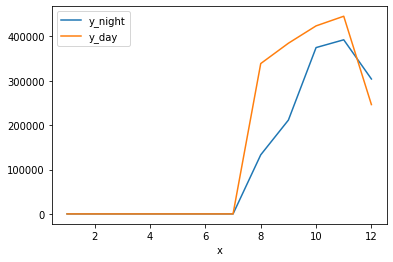

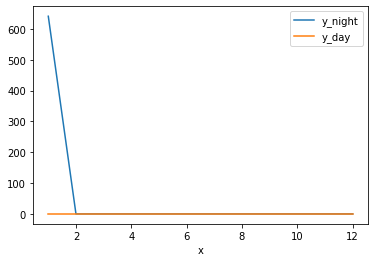

1 month
january nigth
647.0606809449366 january total distance at nigth
0 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
647.0606809449366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
0
0
0
0
0
0
0
0
0
0
0
0


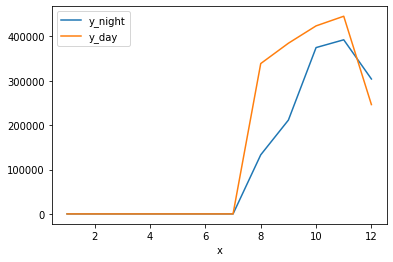

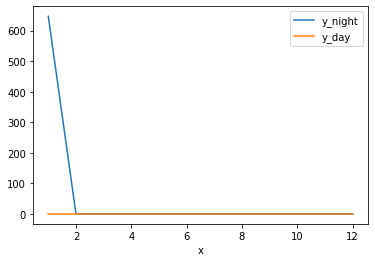

1 month
january nigth
1247.7113238609209 january total distance at nigth
0 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
1247.7113238609209
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
0
0
0
0
0
0
0
0
0
0
0
0


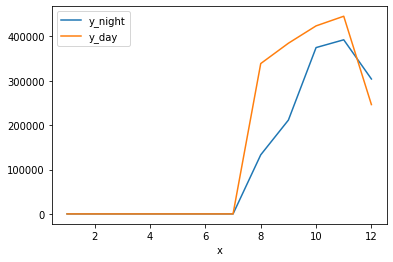

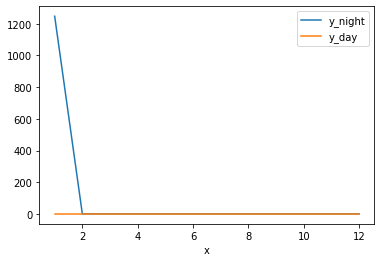

1 month
january day
1247.7113238609209 january total distance at nigth
663.6585184684635 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
1247.7113238609209
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
663.6585184684635
0
0
0
0
0
0
0
0
0
0
0


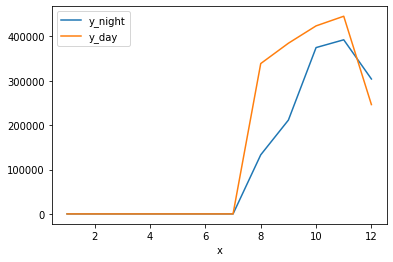

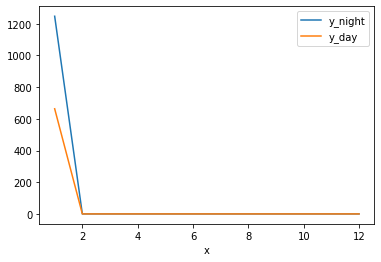

1 month
january day
1247.7113238609209 january total distance at nigth
1542.8893988730324 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
1247.7113238609209
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
1542.8893988730324
0
0
0
0
0
0
0
0
0
0
0


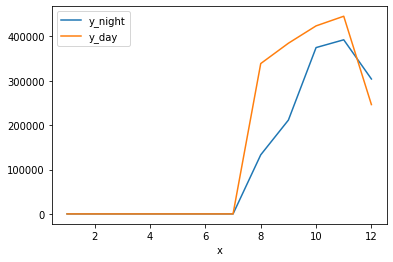

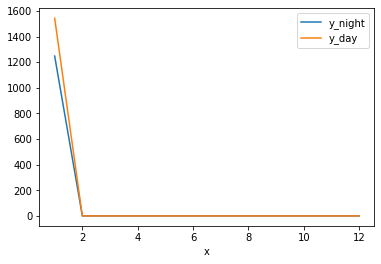

1 month
january day
1247.7113238609209 january total distance at nigth
2212.8906623084404 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
1247.7113238609209
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
2212.8906623084404
0
0
0
0
0
0
0
0
0
0
0


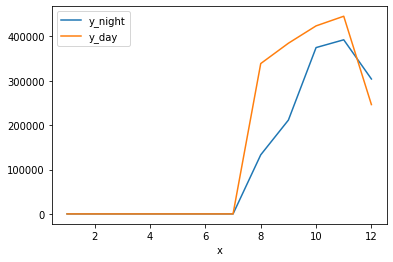

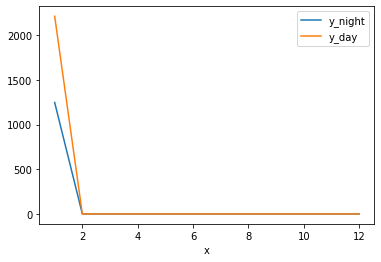

1 month
january day
1247.7113238609209 january total distance at nigth
4095.0157612813446 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
1247.7113238609209
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
4095.0157612813446
0
0
0
0
0
0
0
0
0
0
0


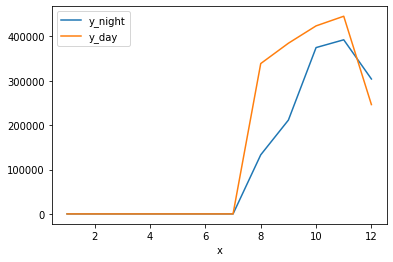

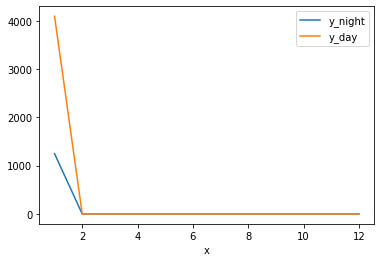

1 month
january day
1247.7113238609209 january total distance at nigth
4145.733939202856 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
1247.7113238609209
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
4145.733939202856
0
0
0
0
0
0
0
0
0
0
0


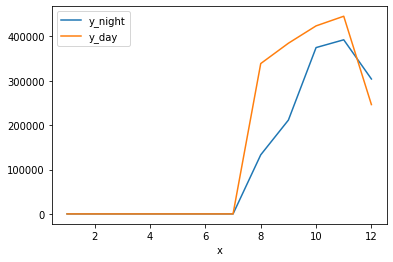

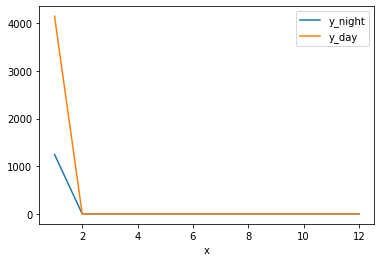

1 month
january nigth
3459.7965184921686 january total distance at nigth
4145.733939202856 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
3459.7965184921686
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
4145.733939202856
0
0
0
0
0
0
0
0
0
0
0


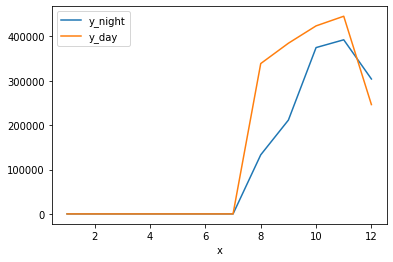

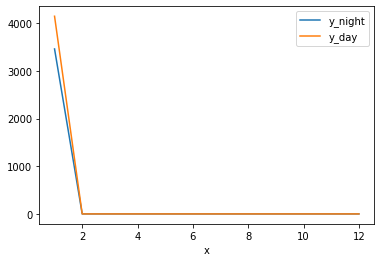

1 month
january nigth
3803.2025966702495 january total distance at nigth
4145.733939202856 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
3803.2025966702495
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
4145.733939202856
0
0
0
0
0
0
0
0
0
0
0


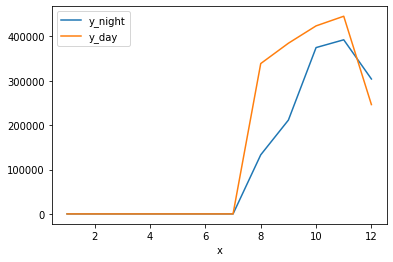

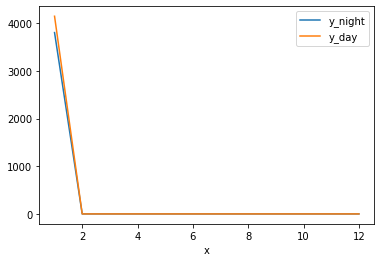

1 month
january nigth
4499.633034445015 january total distance at nigth
4145.733939202856 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
4499.633034445015
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
4145.733939202856
0
0
0
0
0
0
0
0
0
0
0


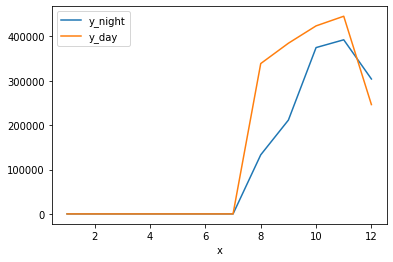

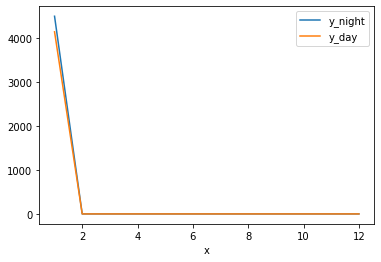

1 month
january nigth
5867.400401015365 january total distance at nigth
4145.733939202856 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
5867.400401015365
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
4145.733939202856
0
0
0
0
0
0
0
0
0
0
0


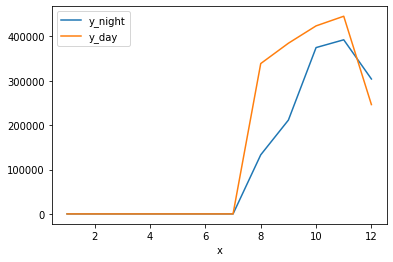

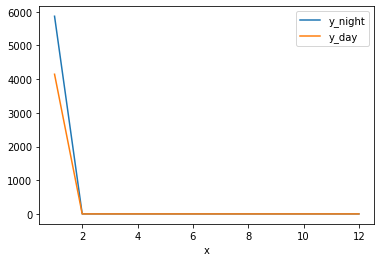

1 month
january nigth
7051.382533847409 january total distance at nigth
4145.733939202856 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
7051.382533847409
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
4145.733939202856
0
0
0
0
0
0
0
0
0
0
0


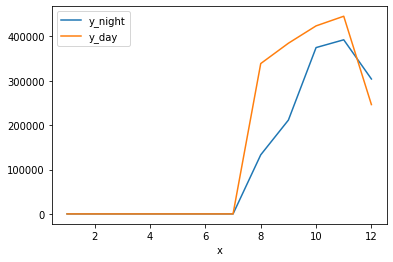

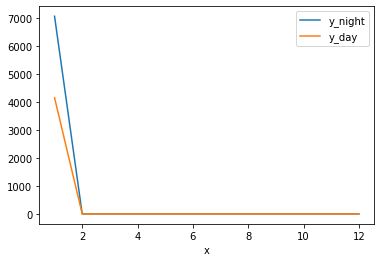

1 month
january day
7051.382533847409 january total distance at nigth
5170.735836643592 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
7051.382533847409
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
5170.735836643592
0
0
0
0
0
0
0
0
0
0
0


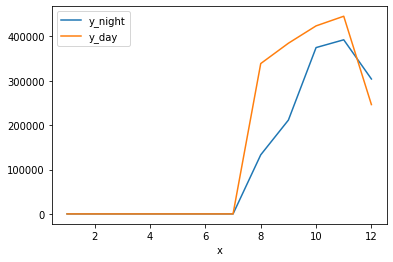

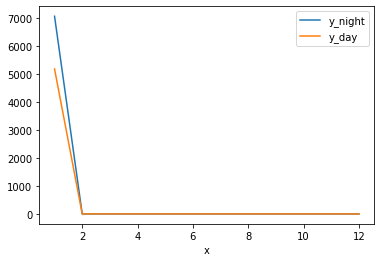

1 month
january day
7051.382533847409 january total distance at nigth
5769.1512649691485 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
7051.382533847409
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
5769.1512649691485
0
0
0
0
0
0
0
0
0
0
0


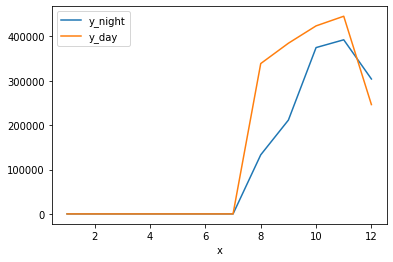

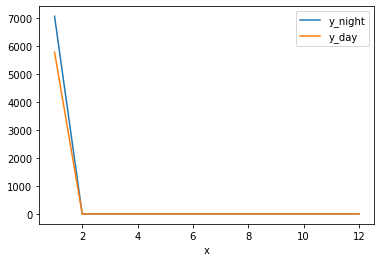

1 month
january day
7051.382533847409 january total distance at nigth
6830.89696054104 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
7051.382533847409
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
6830.89696054104
0
0
0
0
0
0
0
0
0
0
0


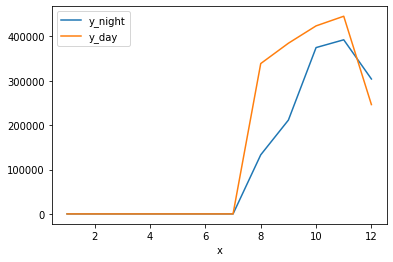

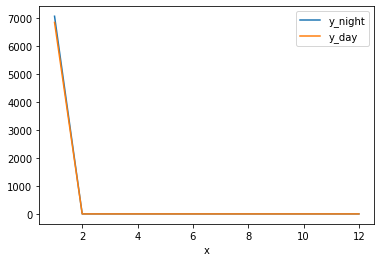

1 month
january day
7051.382533847409 january total distance at nigth
8665.504388568024 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
7051.382533847409
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
8665.504388568024
0
0
0
0
0
0
0
0
0
0
0


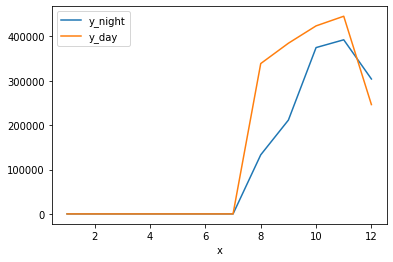

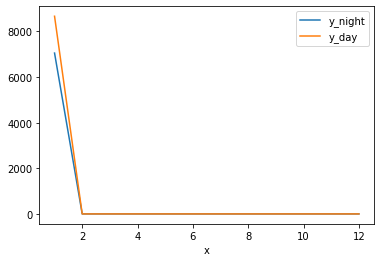

1 month
january day
7051.382533847409 january total distance at nigth
9762.99401142388 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
7051.382533847409
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
9762.99401142388
0
0
0
0
0
0
0
0
0
0
0


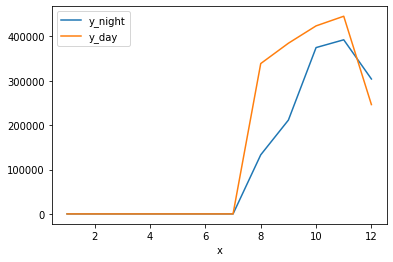

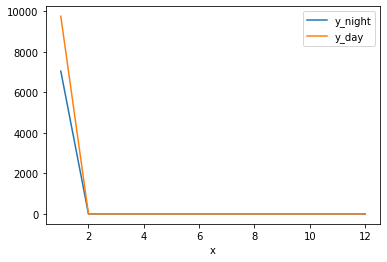

1 month
january nigth
8277.279116500918 january total distance at nigth
9762.99401142388 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
8277.279116500918
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
9762.99401142388
0
0
0
0
0
0
0
0
0
0
0


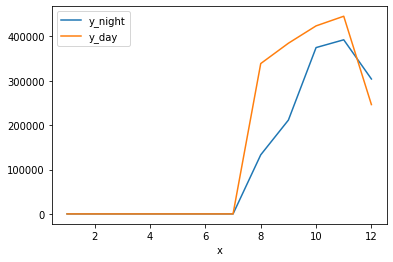

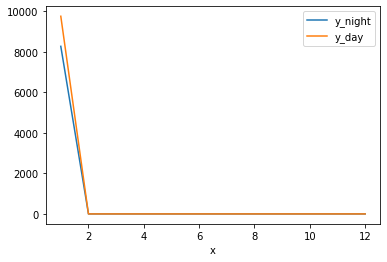

1 month
january nigth
9859.656857087642 january total distance at nigth
9762.99401142388 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
9859.656857087642
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
9762.99401142388
0
0
0
0
0
0
0
0
0
0
0


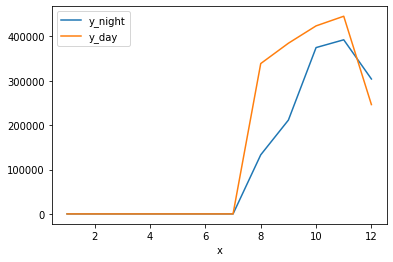

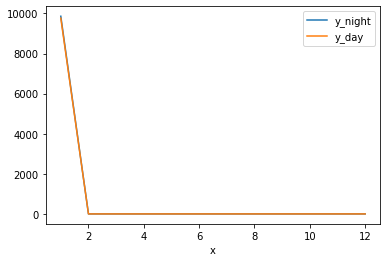

1 month
january nigth
10406.725038689903 january total distance at nigth
9762.99401142388 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
10406.725038689903
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
9762.99401142388
0
0
0
0
0
0
0
0
0
0
0


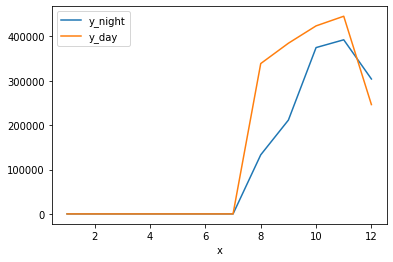

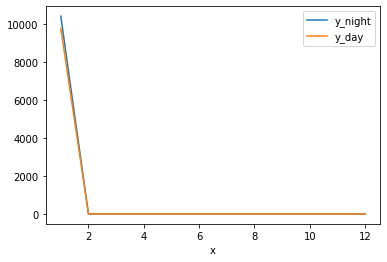

1 month
january nigth
10779.054744873882 january total distance at nigth
9762.99401142388 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
10779.054744873882
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
9762.99401142388
0
0
0
0
0
0
0
0
0
0
0


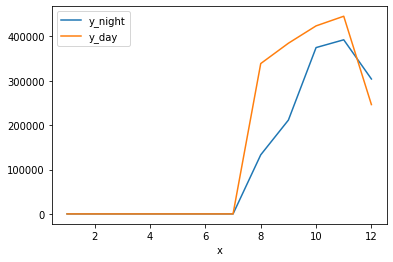

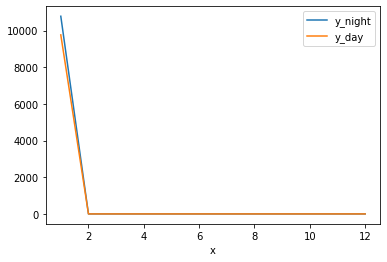

1 month
january day
10779.054744873882 january total distance at nigth
10219.0663074973 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
10779.054744873882
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
10219.0663074973
0
0
0
0
0
0
0
0
0
0
0


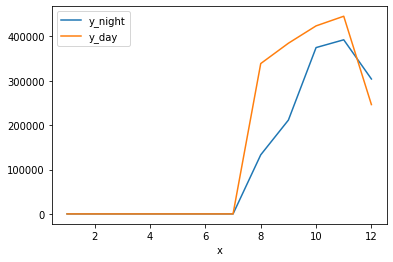

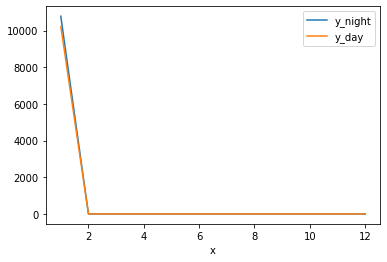

1 month
january day
10779.054744873882 january total distance at nigth
11968.365095104355 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
10779.054744873882
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
11968.365095104355
0
0
0
0
0
0
0
0
0
0
0


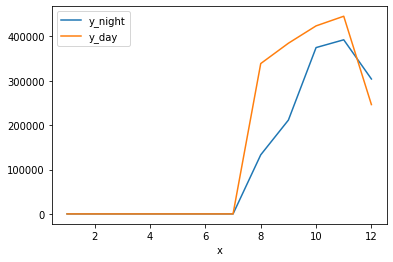

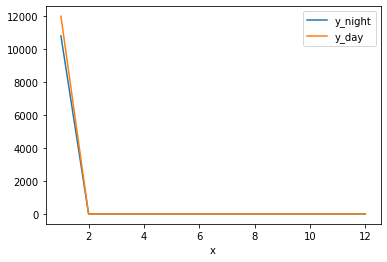

1 month
january nigth
14553.330488499802 january total distance at nigth
11968.365095104355 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
14553.330488499802
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
11968.365095104355
0
0
0
0
0
0
0
0
0
0
0


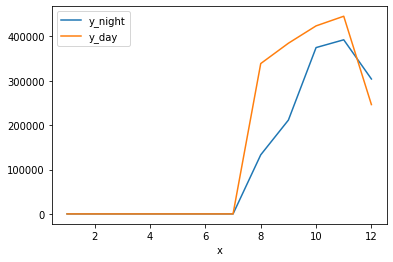

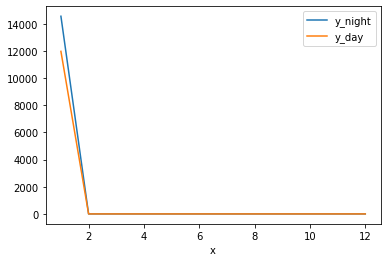

1 month
january nigth
17155.149419319547 january total distance at nigth
11968.365095104355 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
17155.149419319547
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
11968.365095104355
0
0
0
0
0
0
0
0
0
0
0


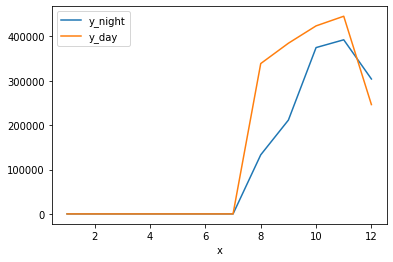

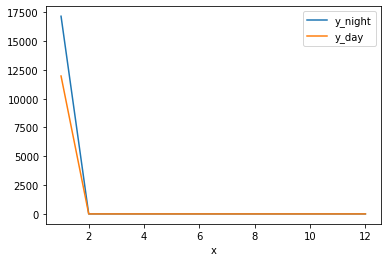

1 month
january nigth
18166.99554646107 january total distance at nigth
11968.365095104355 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
18166.99554646107
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
11968.365095104355
0
0
0
0
0
0
0
0
0
0
0


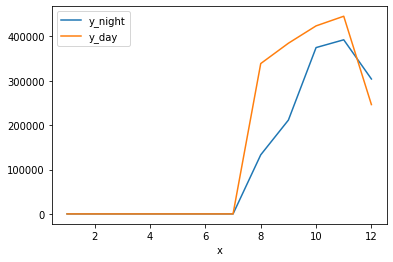

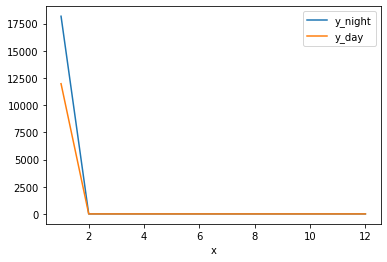

1 month
january day
18166.99554646107 january total distance at nigth
15000.20695394606 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
18166.99554646107
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
15000.20695394606
0
0
0
0
0
0
0
0
0
0
0


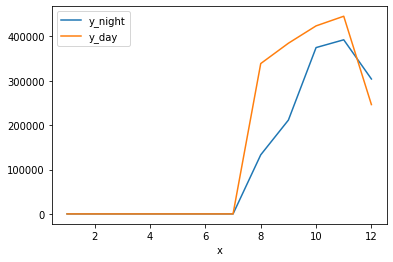

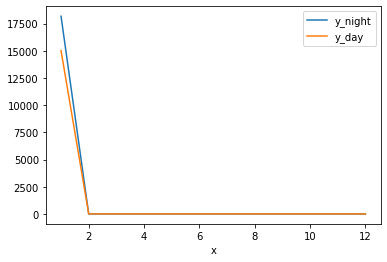

1 month
january nigth
31107.598531305575 january total distance at nigth
15000.20695394606 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
31107.598531305575
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
15000.20695394606
0
0
0
0
0
0
0
0
0
0
0


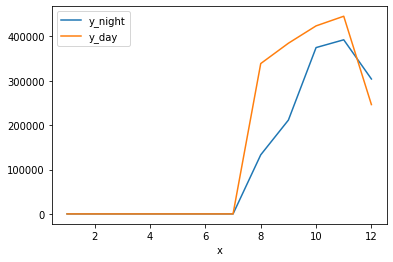

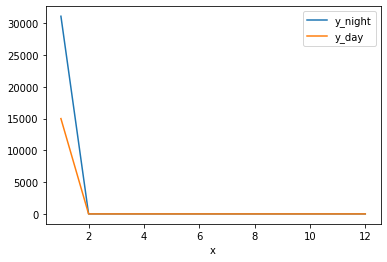

1 month
january nigth
33694.15377068249 january total distance at nigth
15000.20695394606 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
33694.15377068249
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
15000.20695394606
0
0
0
0
0
0
0
0
0
0
0


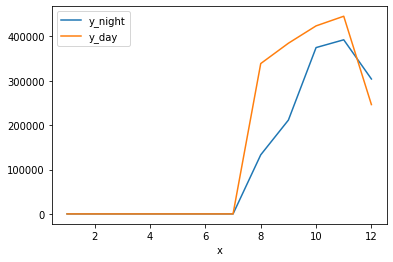

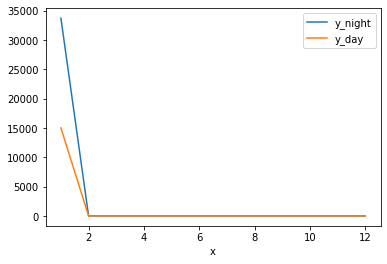

1 month
january nigth
40213.96922978533 january total distance at nigth
15000.20695394606 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
40213.96922978533
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
15000.20695394606
0
0
0
0
0
0
0
0
0
0
0


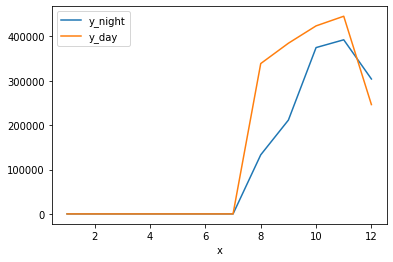

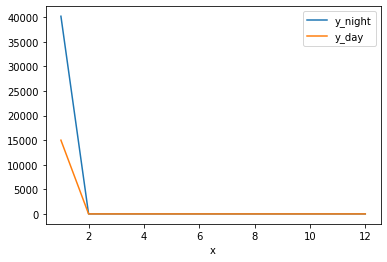

1 month
january day
40213.96922978533 january total distance at nigth
20795.853168655158 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
40213.96922978533
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
20795.853168655158
0
0
0
0
0
0
0
0
0
0
0


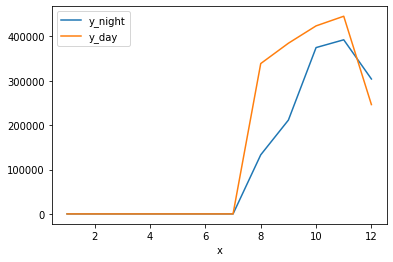

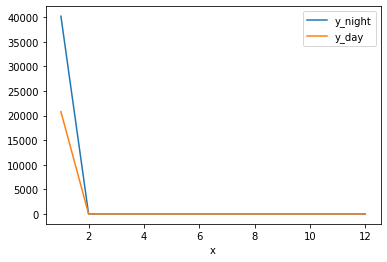

1 month
january day
40213.96922978533 january total distance at nigth
28186.209176037082 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
40213.96922978533
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
28186.209176037082
0
0
0
0
0
0
0
0
0
0
0


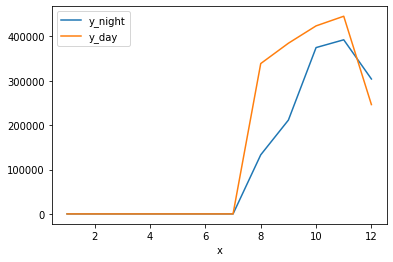

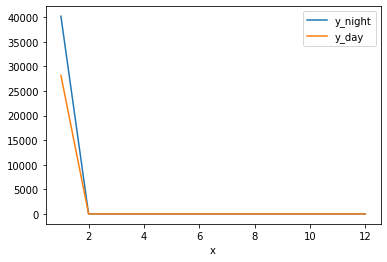

1 month
january day
40213.96922978533 january total distance at nigth
31513.982434657748 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
40213.96922978533
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
31513.982434657748
0
0
0
0
0
0
0
0
0
0
0


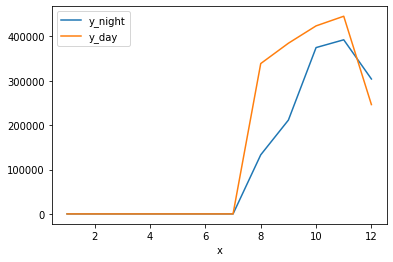

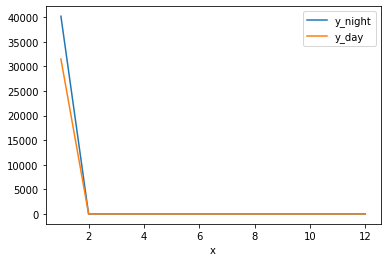

1 month
january day
40213.96922978533 january total distance at nigth
34973.02412322437 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
40213.96922978533
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
34973.02412322437
0
0
0
0
0
0
0
0
0
0
0


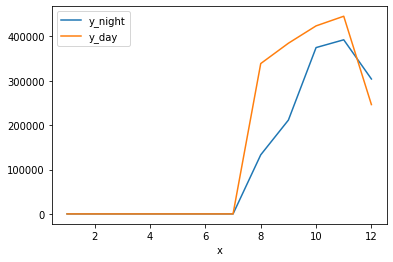

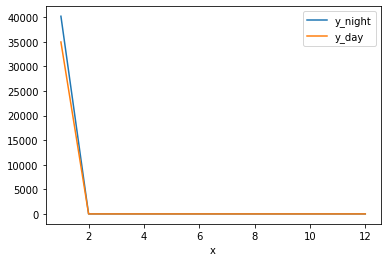

1 month
january nigth
47706.77921488564 january total distance at nigth
34973.02412322437 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
47706.77921488564
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
34973.02412322437
0
0
0
0
0
0
0
0
0
0
0


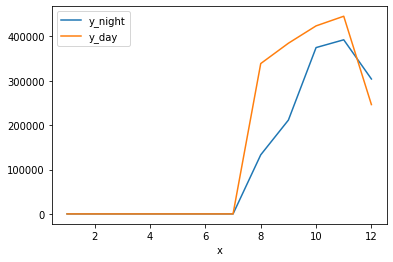

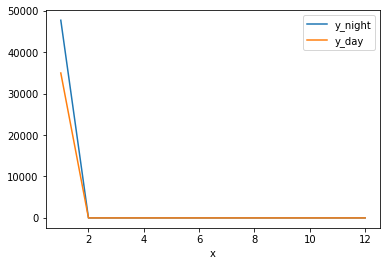

1 month
january nigth
54242.54199611444 january total distance at nigth
34973.02412322437 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
54242.54199611444
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
34973.02412322437
0
0
0
0
0
0
0
0
0
0
0


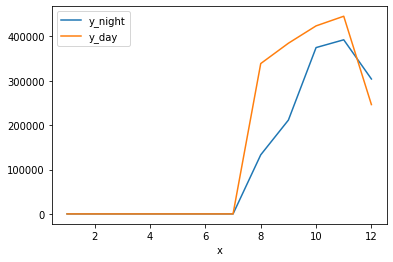

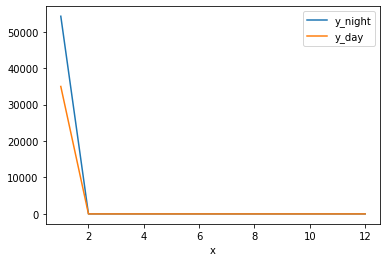

1 month
january day
54242.54199611444 january total distance at nigth
40725.25301717708 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
54242.54199611444
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
40725.25301717708
0
0
0
0
0
0
0
0
0
0
0


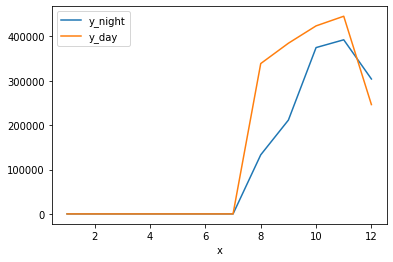

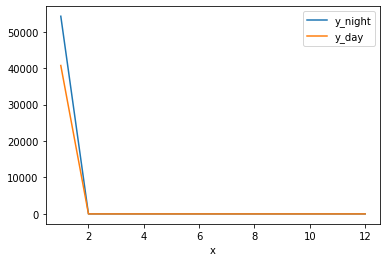

1 month
january day
54242.54199611444 january total distance at nigth
44790.34655312598 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
54242.54199611444
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
44790.34655312598
0
0
0
0
0
0
0
0
0
0
0


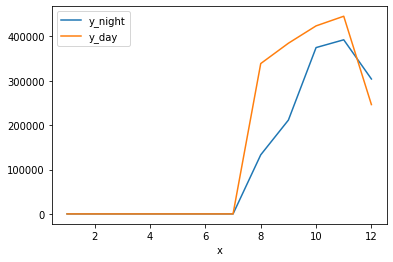

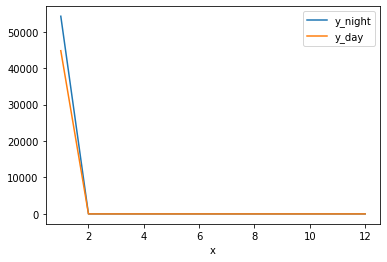

1 month
january day
54242.54199611444 january total distance at nigth
49284.43287483731 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
54242.54199611444
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
49284.43287483731
0
0
0
0
0
0
0
0
0
0
0


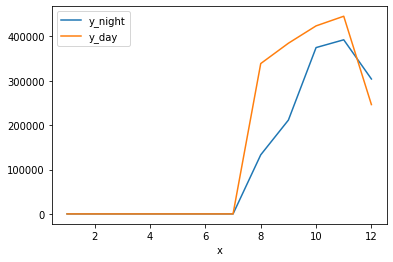

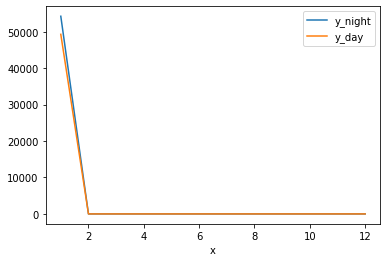

1 month
january nigth
60428.249704326794 january total distance at nigth
49284.43287483731 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
60428.249704326794
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
49284.43287483731
0
0
0
0
0
0
0
0
0
0
0


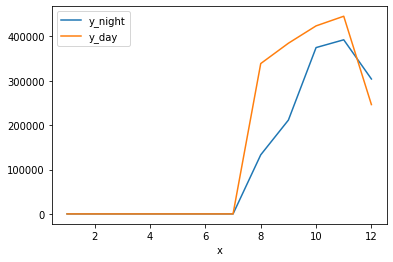

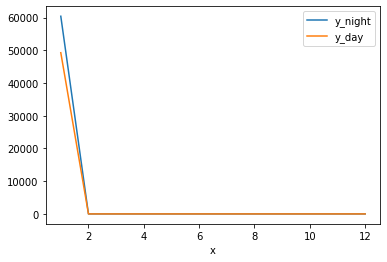

1 month
january nigth
63499.742608424174 january total distance at nigth
49284.43287483731 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
63499.742608424174
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
49284.43287483731
0
0
0
0
0
0
0
0
0
0
0


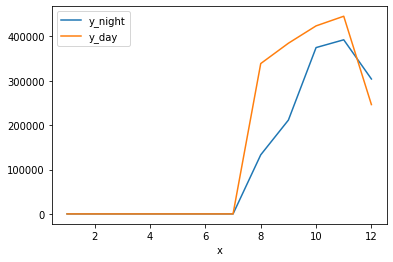

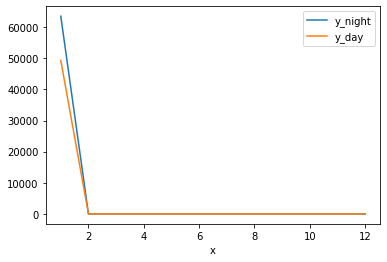

1 month
january nigth
67724.22583833181 january total distance at nigth
49284.43287483731 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
67724.22583833181
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
49284.43287483731
0
0
0
0
0
0
0
0
0
0
0


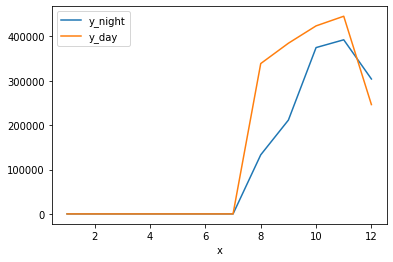

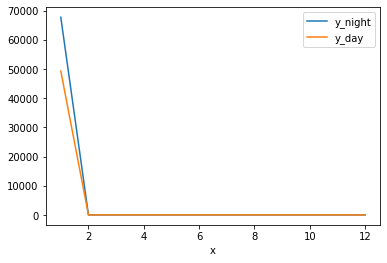

1 month
january day
67724.22583833181 january total distance at nigth
53048.59447853948 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
67724.22583833181
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
53048.59447853948
0
0
0
0
0
0
0
0
0
0
0


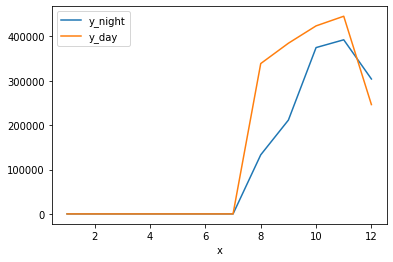

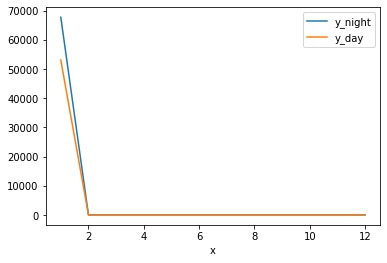

1 month
january day
67724.22583833181 january total distance at nigth
58091.50047814039 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
67724.22583833181
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
58091.50047814039
0
0
0
0
0
0
0
0
0
0
0


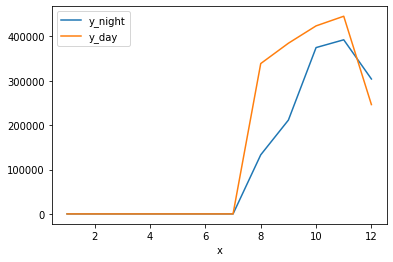

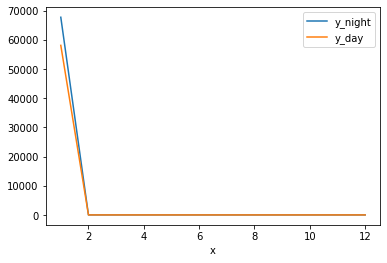

1 month
january day
67724.22583833181 january total distance at nigth
60786.638865671885 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
67724.22583833181
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
60786.638865671885
0
0
0
0
0
0
0
0
0
0
0


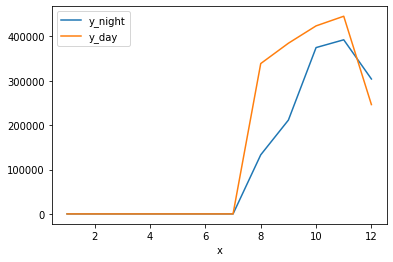

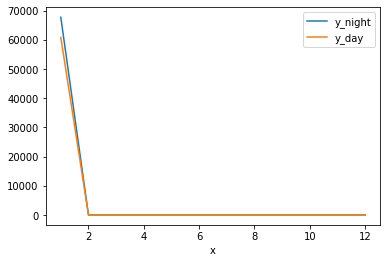

1 month
january nigth
72792.86219913898 january total distance at nigth
60786.638865671885 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
72792.86219913898
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
60786.638865671885
0
0
0
0
0
0
0
0
0
0
0


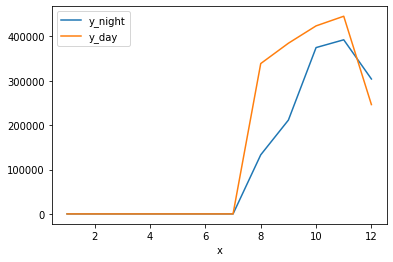

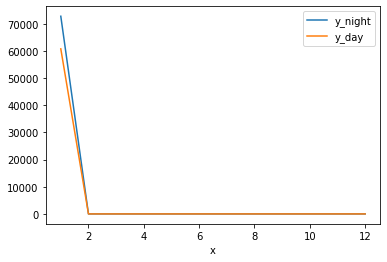

1 month
january nigth
77370.13293880415 january total distance at nigth
60786.638865671885 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
77370.13293880415
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
60786.638865671885
0
0
0
0
0
0
0
0
0
0
0


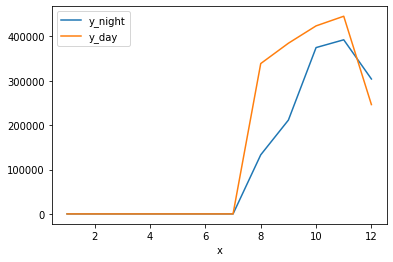

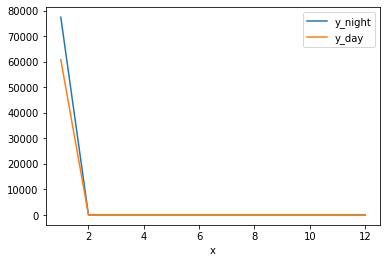

1 month
january nigth
81306.61003478363 january total distance at nigth
60786.638865671885 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
81306.61003478363
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
60786.638865671885
0
0
0
0
0
0
0
0
0
0
0


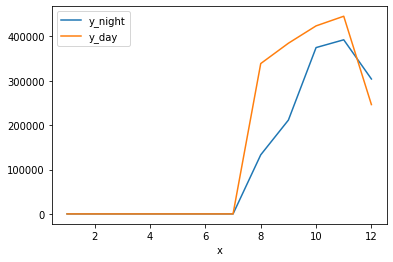

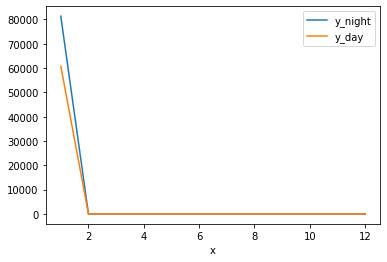

1 month
january day
81306.61003478363 january total distance at nigth
62383.97865295267 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
81306.61003478363
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
62383.97865295267
0
0
0
0
0
0
0
0
0
0
0


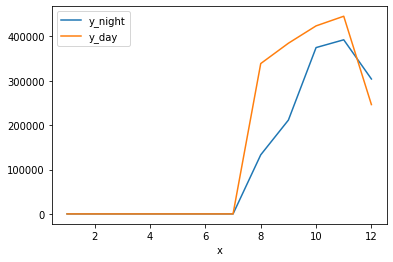

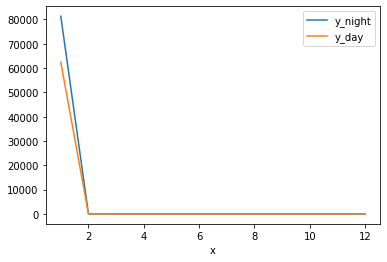

1 month
january day
81306.61003478363 january total distance at nigth
63018.88876478267 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
81306.61003478363
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
63018.88876478267
0
0
0
0
0
0
0
0
0
0
0


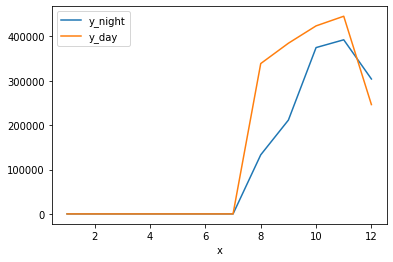

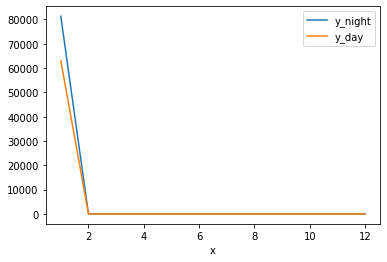

1 month
january day
81306.61003478363 january total distance at nigth
66680.44478126084 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
81306.61003478363
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
66680.44478126084
0
0
0
0
0
0
0
0
0
0
0


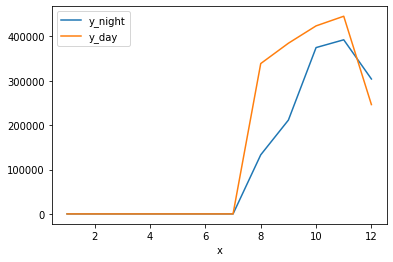

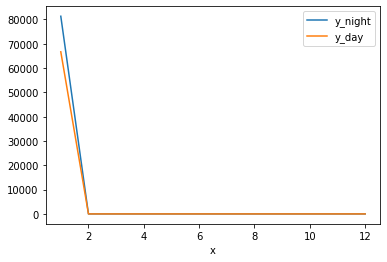

1 month
january day
81306.61003478363 january total distance at nigth
70065.50635791422 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
81306.61003478363
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
70065.50635791422
0
0
0
0
0
0
0
0
0
0
0


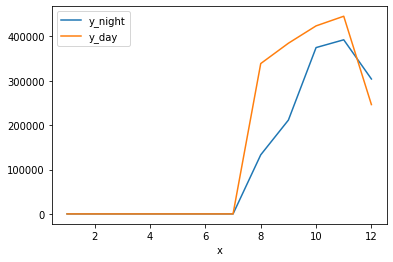

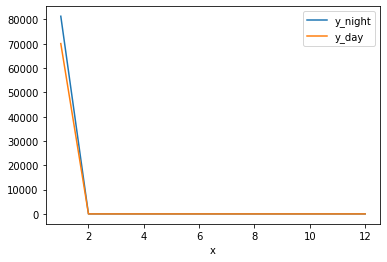

1 month
january nigth
85204.58094810699 january total distance at nigth
70065.50635791422 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
85204.58094810699
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
70065.50635791422
0
0
0
0
0
0
0
0
0
0
0


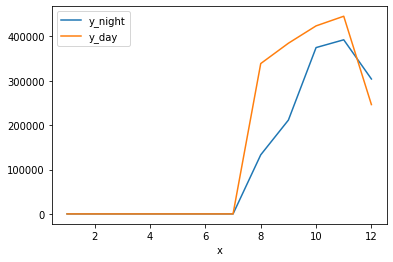

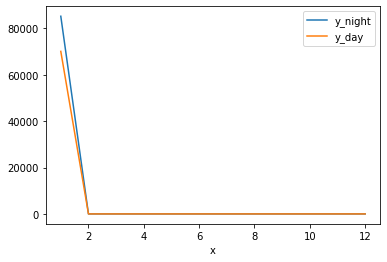

1 month
january nigth
85234.4127042519 january total distance at nigth
70065.50635791422 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
85234.4127042519
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
70065.50635791422
0
0
0
0
0
0
0
0
0
0
0


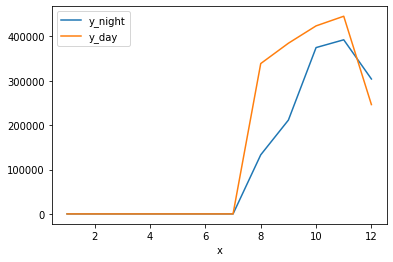

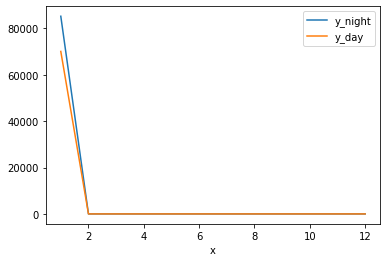

1 month
january nigth
87116.65863063323 january total distance at nigth
70065.50635791422 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
87116.65863063323
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
70065.50635791422
0
0
0
0
0
0
0
0
0
0
0


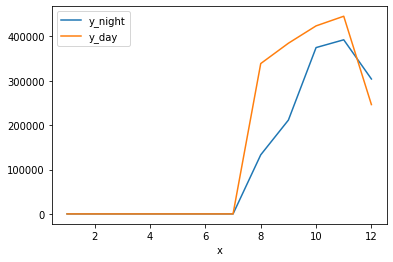

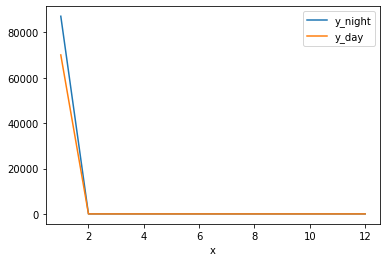

1 month
january nigth
88681.1596661484 january total distance at nigth
70065.50635791422 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
88681.1596661484
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
70065.50635791422
0
0
0
0
0
0
0
0
0
0
0


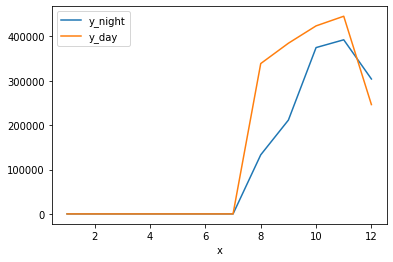

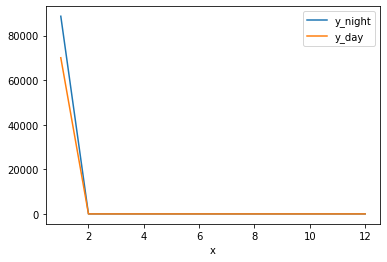

1 month
january day
88681.1596661484 january total distance at nigth
71415.08774295027 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
88681.1596661484
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
71415.08774295027
0
0
0
0
0
0
0
0
0
0
0


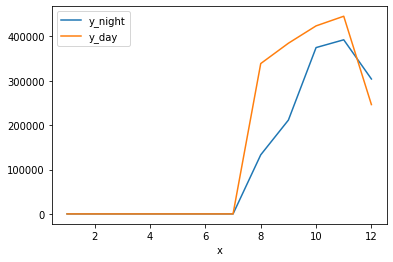

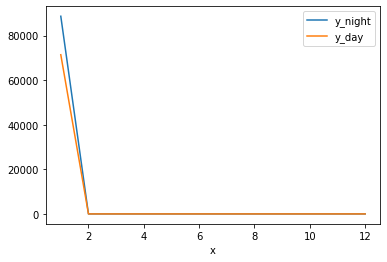

1 month
january day
88681.1596661484 january total distance at nigth
71547.09710124241 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
88681.1596661484
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
71547.09710124241
0
0
0
0
0
0
0
0
0
0
0


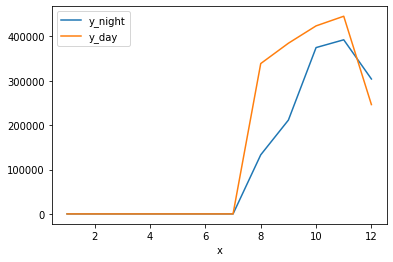

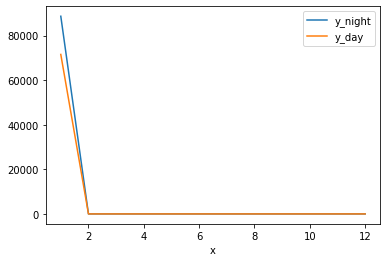

1 month
january day
88681.1596661484 january total distance at nigth
77789.6716978729 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
88681.1596661484
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
77789.6716978729
0
0
0
0
0
0
0
0
0
0
0


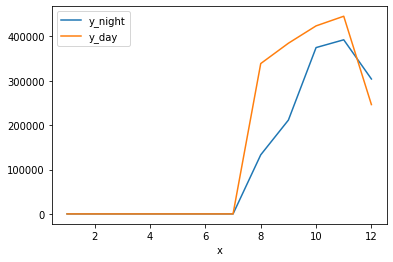

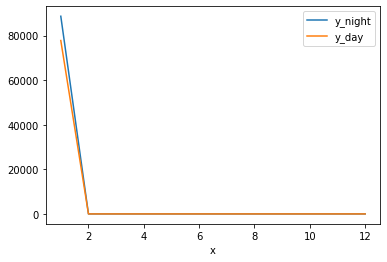

1 month
january day
88681.1596661484 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
88681.1596661484
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


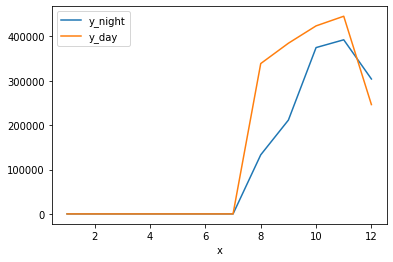

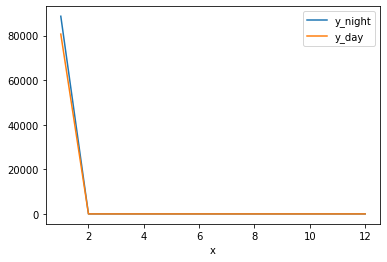

1 month
january nigth
89963.70630496914 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
89963.70630496914
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


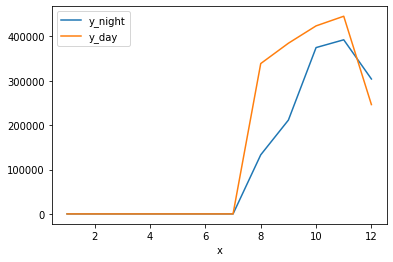

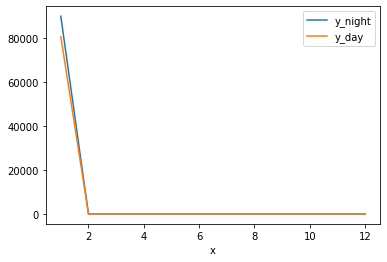

1 month
january nigth
90153.74457859408 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
90153.74457859408
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


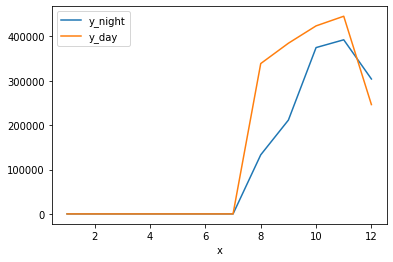

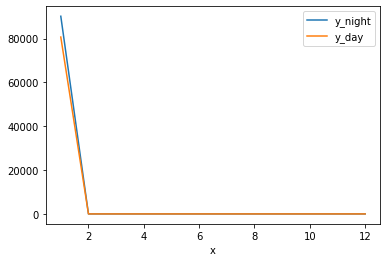

1 month
january nigth
90641.69370495631 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
90641.69370495631
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


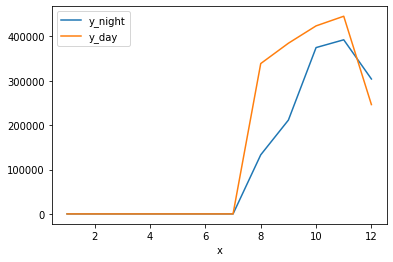

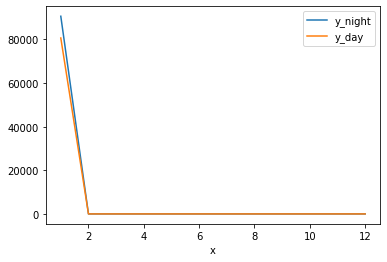

1 month
january nigth
91206.08462375781 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
91206.08462375781
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


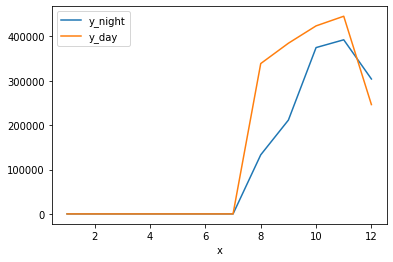

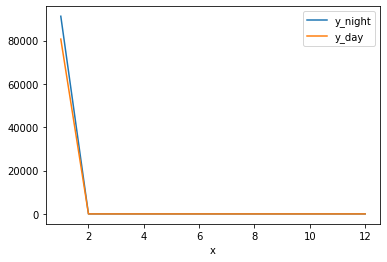

1 month
january nigth
91934.3091071547 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
91934.3091071547
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


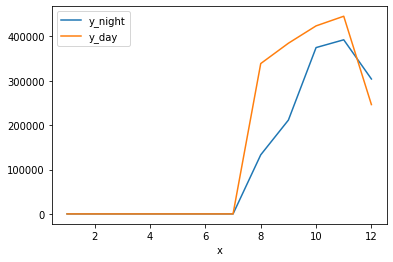

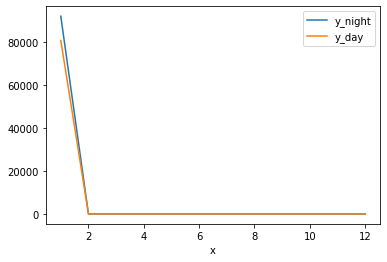

1 month
january nigth
93011.099377637 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
93011.099377637
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


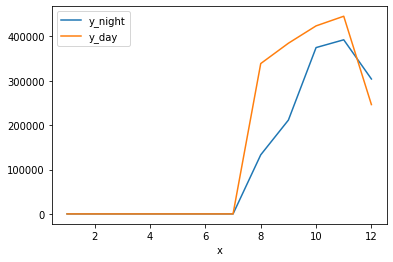

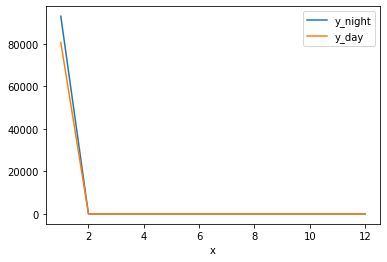

1 month
january nigth
94217.87325110717 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
94217.87325110717
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


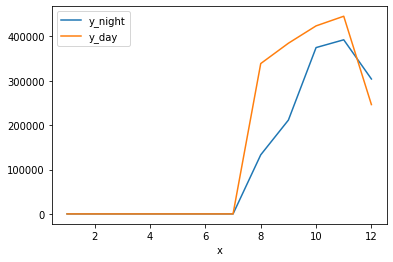

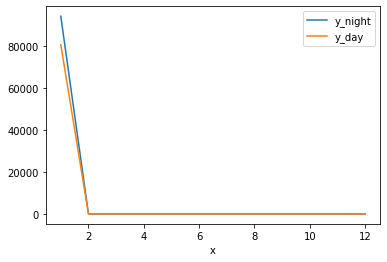

1 month
january nigth
95519.67661899232 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
95519.67661899232
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


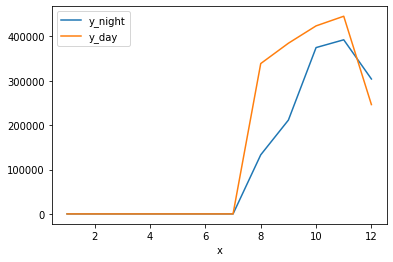

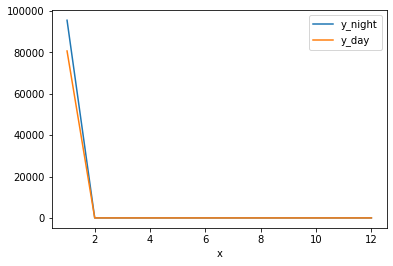

1 month
january nigth
96777.07991429926 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
96777.07991429926
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


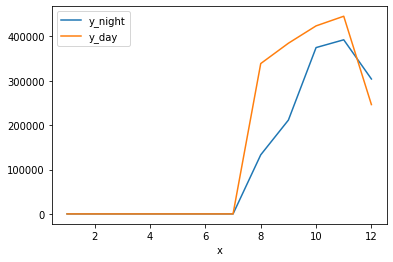

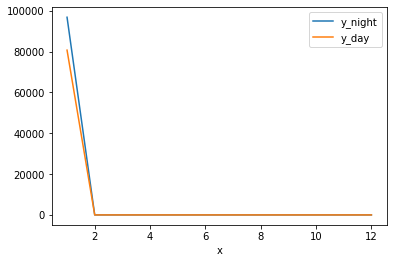

1 month
january nigth
97614.50304527913 january total distance at nigth
80666.06357238523 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
97614.50304527913
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
80666.06357238523
0
0
0
0
0
0
0
0
0
0
0


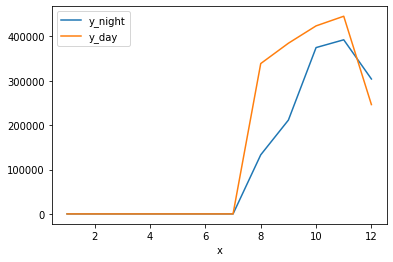

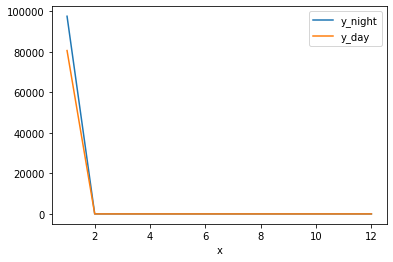

1 month
january day
97614.50304527913 january total distance at nigth
81175.04131476524 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
97614.50304527913
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
81175.04131476524
0
0
0
0
0
0
0
0
0
0
0


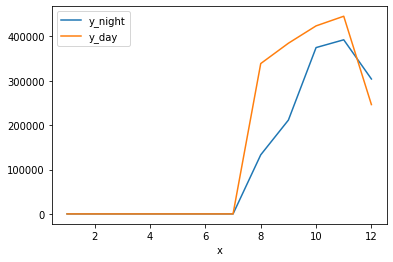

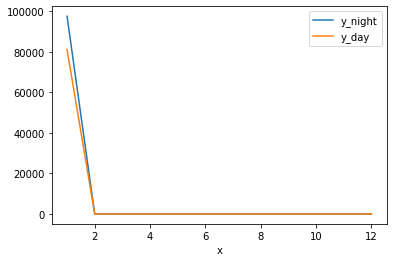

1 month
january day
97614.50304527913 january total distance at nigth
81181.25530271059 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
97614.50304527913
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
81181.25530271059
0
0
0
0
0
0
0
0
0
0
0


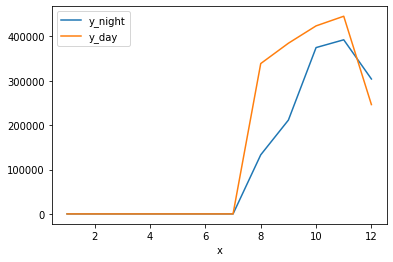

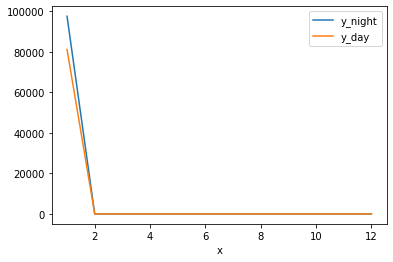

1 month
january day
97614.50304527913 january total distance at nigth
85605.14739847009 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
97614.50304527913
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
85605.14739847009
0
0
0
0
0
0
0
0
0
0
0


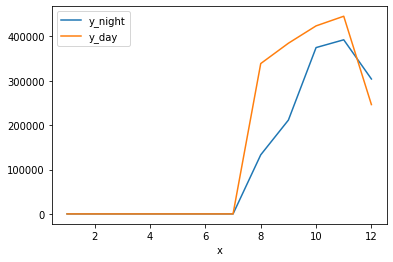

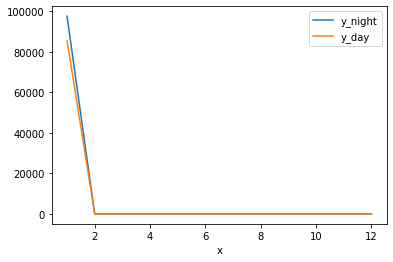

1 month
january nigth
100847.31695233316 january total distance at nigth
85605.14739847009 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
100847.31695233316
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
85605.14739847009
0
0
0
0
0
0
0
0
0
0
0


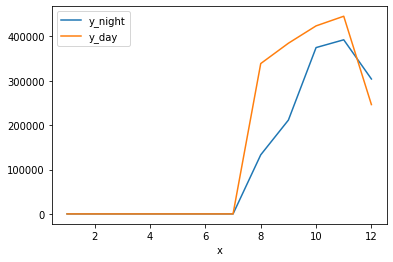

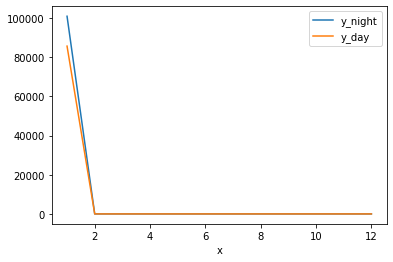

1 month
january nigth
100895.4052697346 january total distance at nigth
85605.14739847009 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
100895.4052697346
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
85605.14739847009
0
0
0
0
0
0
0
0
0
0
0


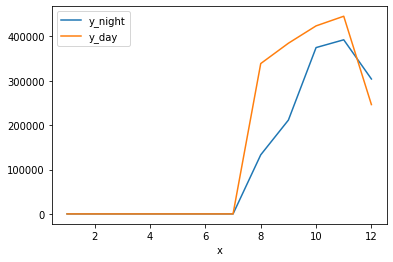

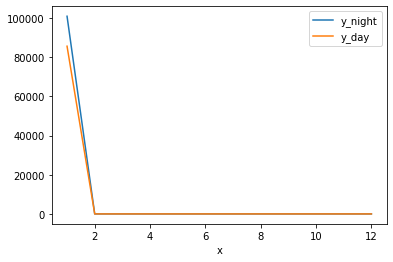

1 month
january nigth
102040.0967828977 january total distance at nigth
85605.14739847009 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
102040.0967828977
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
85605.14739847009
0
0
0
0
0
0
0
0
0
0
0


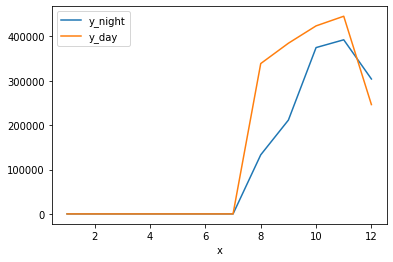

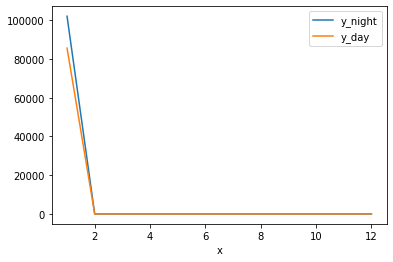

1 month
january nigth
103241.55249027499 january total distance at nigth
85605.14739847009 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
103241.55249027499
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
85605.14739847009
0
0
0
0
0
0
0
0
0
0
0


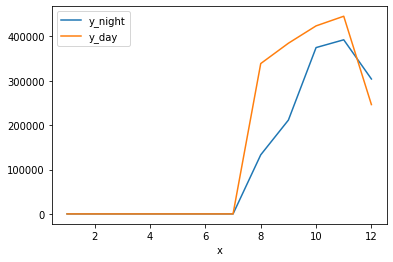

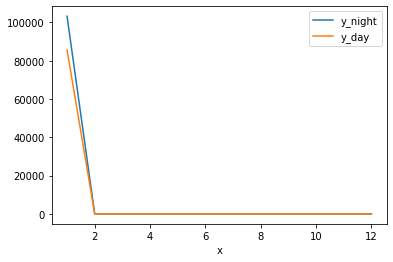

1 month
january nigth
104857.23903083203 january total distance at nigth
85605.14739847009 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
104857.23903083203
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
85605.14739847009
0
0
0
0
0
0
0
0
0
0
0


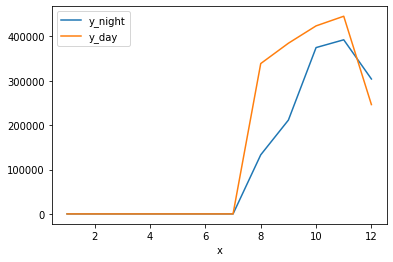

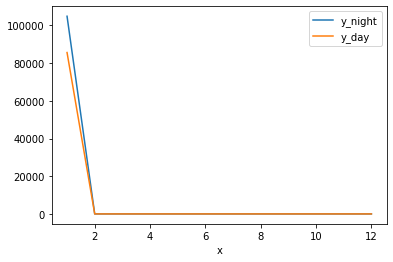

1 month
january day
104857.23903083203 january total distance at nigth
86314.50062054001 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
104857.23903083203
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
86314.50062054001
0
0
0
0
0
0
0
0
0
0
0


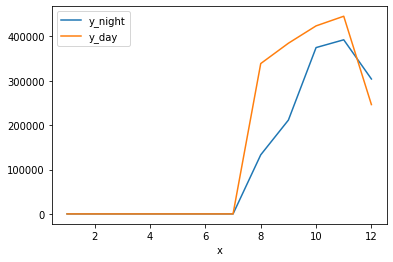

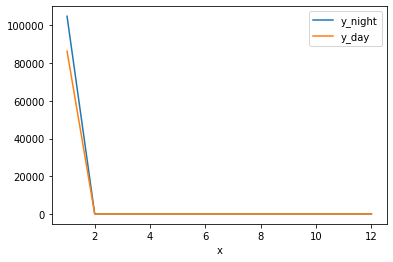

1 month
january day
104857.23903083203 january total distance at nigth
87024.65124303017 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
104857.23903083203
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
87024.65124303017
0
0
0
0
0
0
0
0
0
0
0


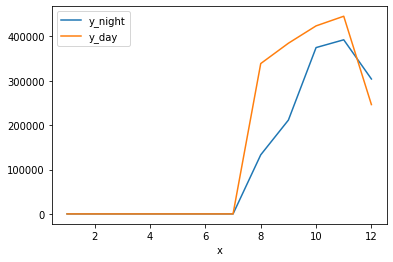

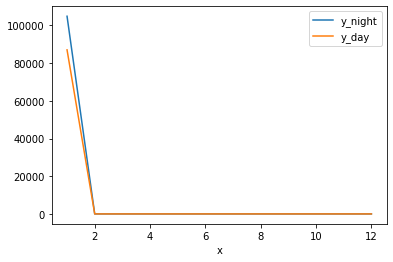

1 month
january day
104857.23903083203 january total distance at nigth
88711.8289559215 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
104857.23903083203
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
88711.8289559215
0
0
0
0
0
0
0
0
0
0
0


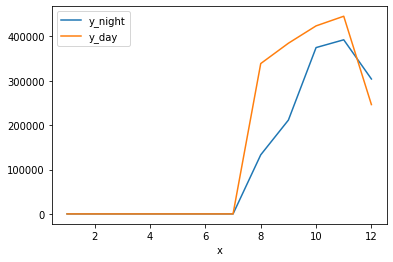

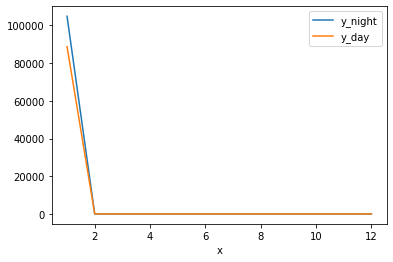

1 month
january nigth
109697.21936364943 january total distance at nigth
88711.8289559215 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
109697.21936364943
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
88711.8289559215
0
0
0
0
0
0
0
0
0
0
0


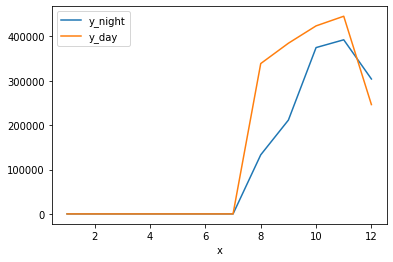

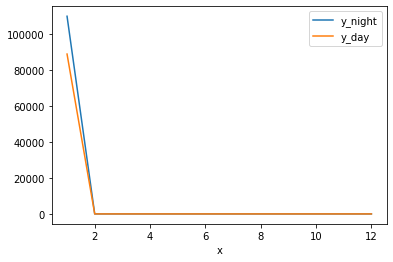

1 month
january nigth
111485.93937929426 january total distance at nigth
88711.8289559215 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
111485.93937929426
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
88711.8289559215
0
0
0
0
0
0
0
0
0
0
0


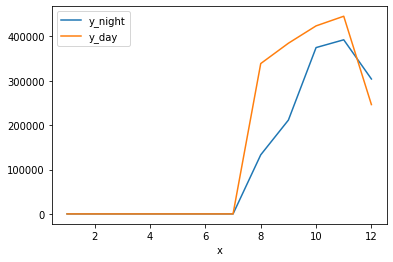

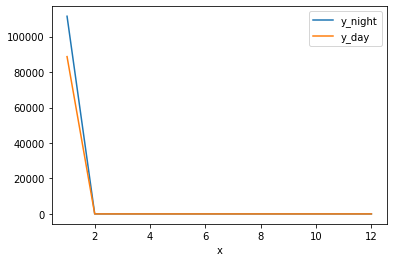

1 month
january nigth
112074.37377621078 january total distance at nigth
88711.8289559215 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
112074.37377621078
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
88711.8289559215
0
0
0
0
0
0
0
0
0
0
0


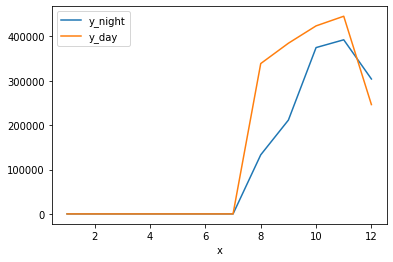

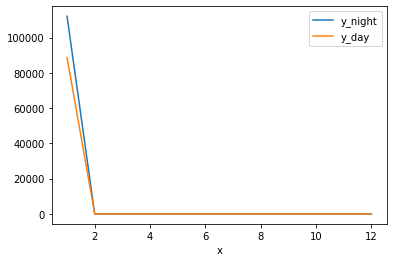

1 month
january day
112074.37377621078 january total distance at nigth
90272.38962818225 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
112074.37377621078
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
90272.38962818225
0
0
0
0
0
0
0
0
0
0
0


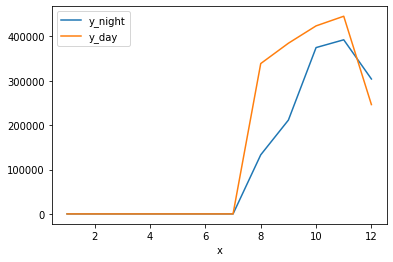

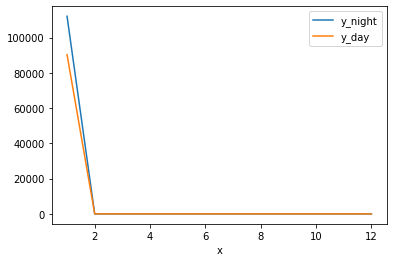

1 month
january day
112074.37377621078 january total distance at nigth
90321.9211456037 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
112074.37377621078
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
90321.9211456037
0
0
0
0
0
0
0
0
0
0
0


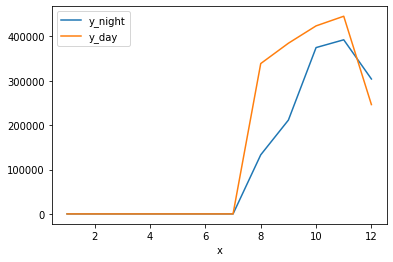

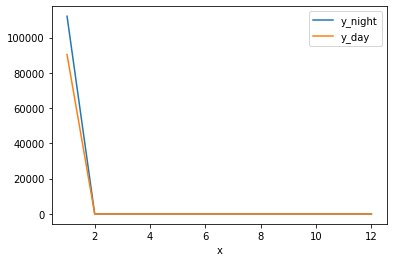

1 month
january day
112074.37377621078 january total distance at nigth
91543.38288099549 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
112074.37377621078
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
91543.38288099549
0
0
0
0
0
0
0
0
0
0
0


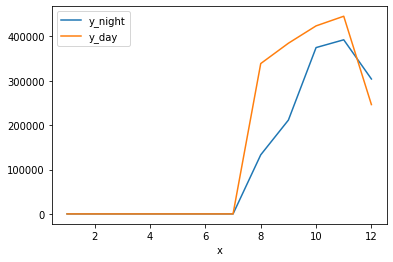

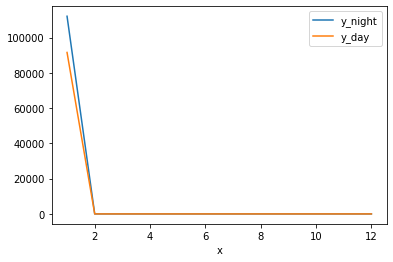

1 month
january day
112074.37377621078 january total distance at nigth
93991.64315162828 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
112074.37377621078
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
93991.64315162828
0
0
0
0
0
0
0
0
0
0
0


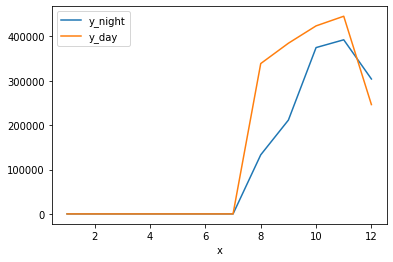

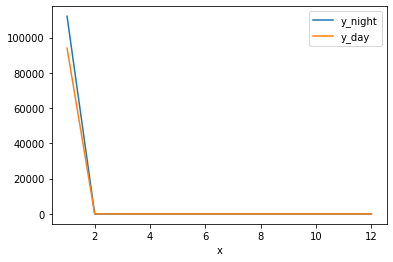

1 month
january day
112074.37377621078 january total distance at nigth
100480.89101934302 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
112074.37377621078
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
100480.89101934302
0
0
0
0
0
0
0
0
0
0
0


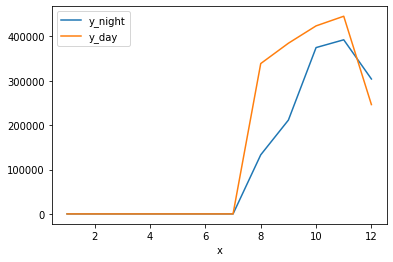

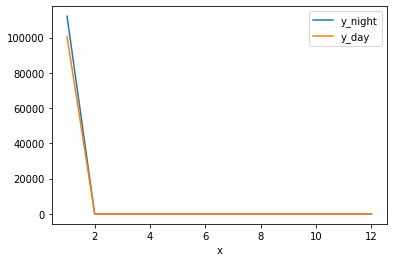

1 month
january day
112074.37377621078 january total distance at nigth
101806.38431144651 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
112074.37377621078
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
101806.38431144651
0
0
0
0
0
0
0
0
0
0
0


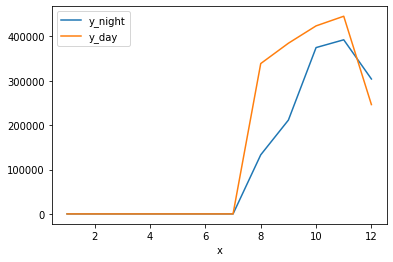

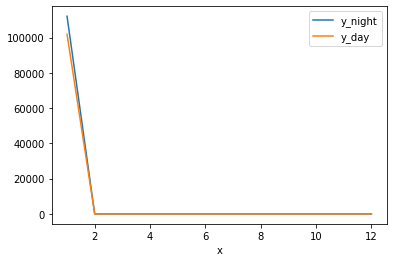

1 month
january day
112074.37377621078 january total distance at nigth
103598.45001297041 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
112074.37377621078
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
103598.45001297041
0
0
0
0
0
0
0
0
0
0
0


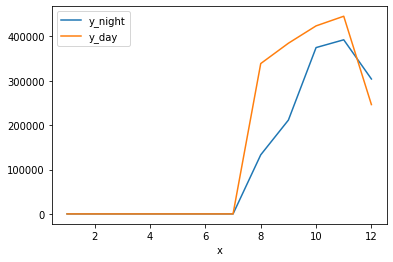

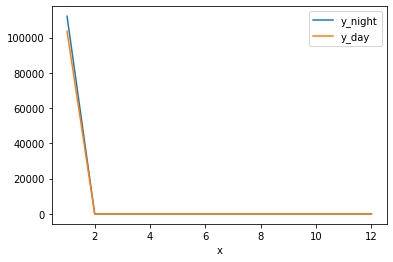

1 month
january day
112074.37377621078 january total distance at nigth
104927.63185590909 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
112074.37377621078
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
104927.63185590909
0
0
0
0
0
0
0
0
0
0
0


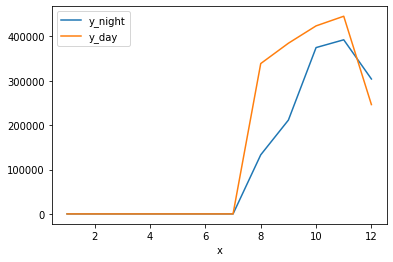

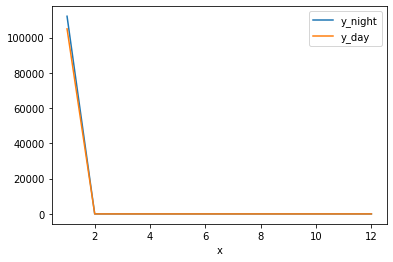

1 month
january nigth
115379.55583428656 january total distance at nigth
104927.63185590909 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
115379.55583428656
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
104927.63185590909
0
0
0
0
0
0
0
0
0
0
0


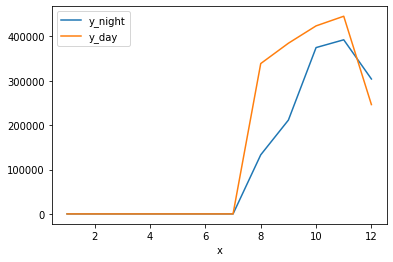

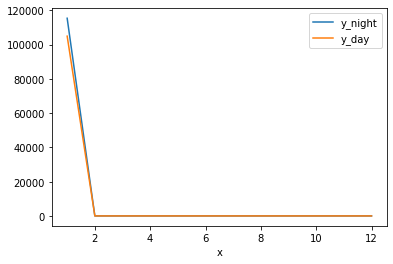

1 month
january nigth
119564.26968072819 january total distance at nigth
104927.63185590909 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
119564.26968072819
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
104927.63185590909
0
0
0
0
0
0
0
0
0
0
0


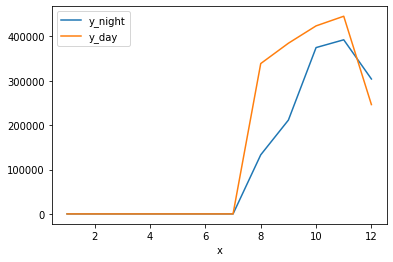

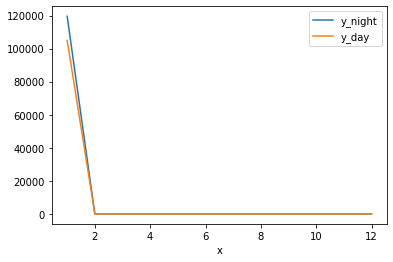

1 month
january nigth
123198.48645087334 january total distance at nigth
104927.63185590909 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
123198.48645087334
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
104927.63185590909
0
0
0
0
0
0
0
0
0
0
0


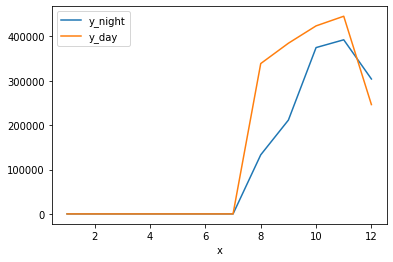

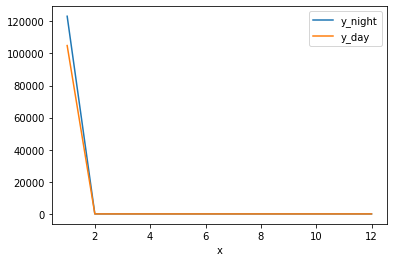

1 month
january day
123198.48645087334 january total distance at nigth
107174.17370283995 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
123198.48645087334
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
107174.17370283995
0
0
0
0
0
0
0
0
0
0
0


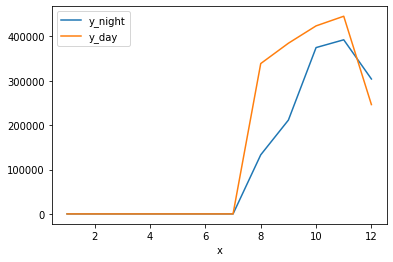

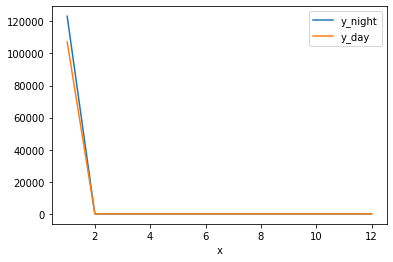

1 month
january day
123198.48645087334 january total distance at nigth
109528.00666315193 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
123198.48645087334
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
109528.00666315193
0
0
0
0
0
0
0
0
0
0
0


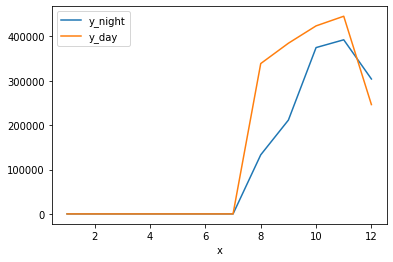

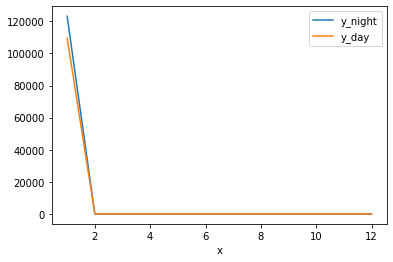

1 month
january nigth
125625.47368746973 january total distance at nigth
109528.00666315193 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
125625.47368746973
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
109528.00666315193
0
0
0
0
0
0
0
0
0
0
0


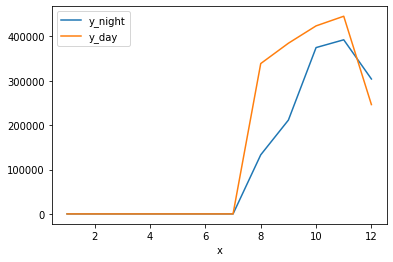

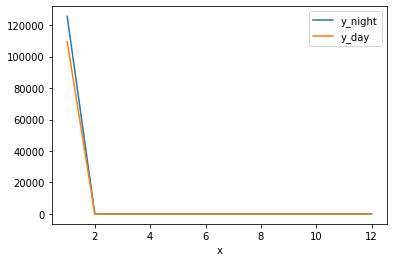

1 month
january nigth
126438.82207172785 january total distance at nigth
109528.00666315193 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
126438.82207172785
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
109528.00666315193
0
0
0
0
0
0
0
0
0
0
0


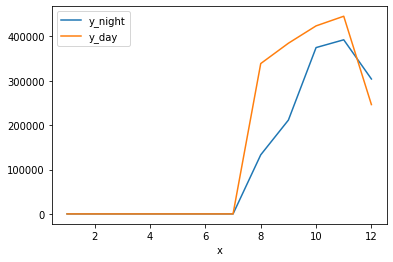

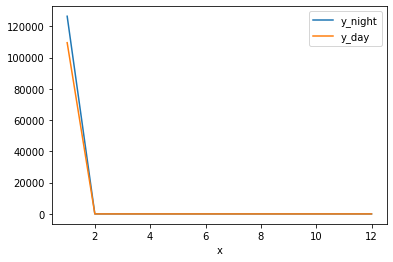

1 month
january nigth
126801.0956633661 january total distance at nigth
109528.00666315193 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
126801.0956633661
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
109528.00666315193
0
0
0
0
0
0
0
0
0
0
0


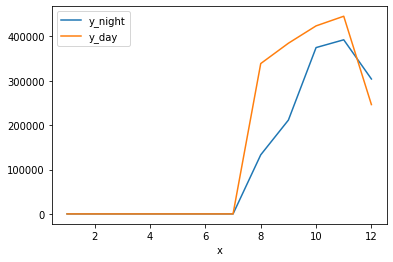

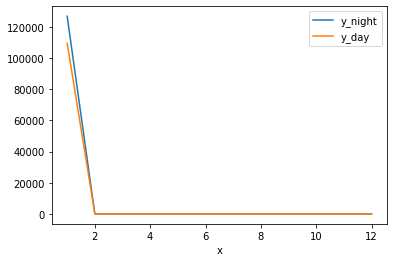

1 month
january nigth
126838.75554019457 january total distance at nigth
109528.00666315193 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
126838.75554019457
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
109528.00666315193
0
0
0
0
0
0
0
0
0
0
0


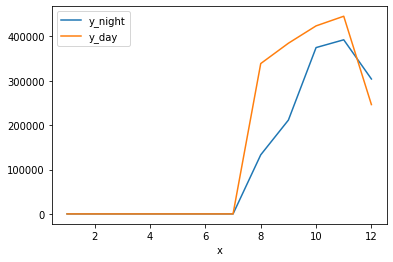

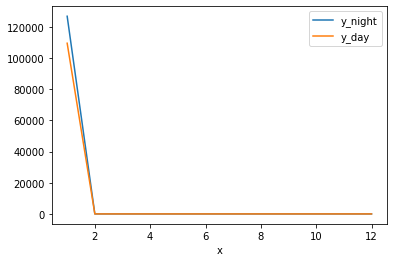

1 month
january nigth
127326.32811234752 january total distance at nigth
109528.00666315193 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
127326.32811234752
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
109528.00666315193
0
0
0
0
0
0
0
0
0
0
0


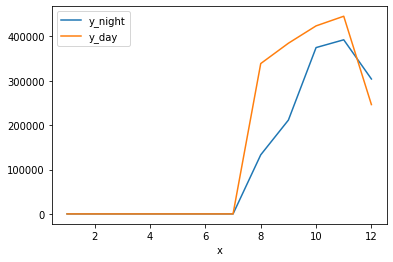

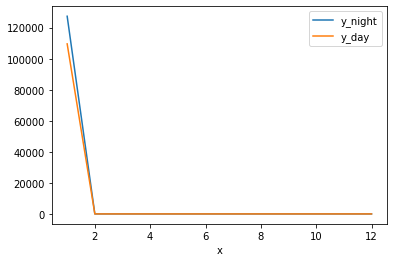

1 month
january nigth
128364.72439896809 january total distance at nigth
109528.00666315193 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
128364.72439896809
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
109528.00666315193
0
0
0
0
0
0
0
0
0
0
0


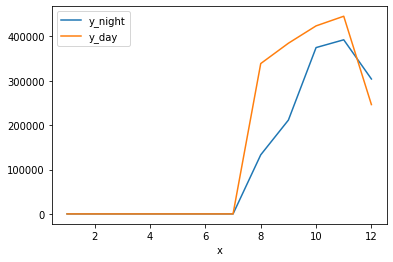

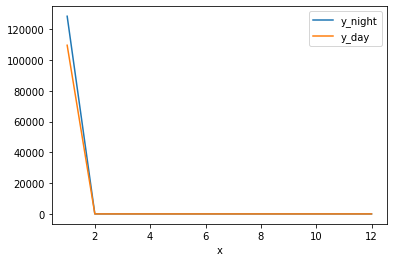

1 month
january day
128364.72439896809 january total distance at nigth
111022.26199502581 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
128364.72439896809
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
111022.26199502581
0
0
0
0
0
0
0
0
0
0
0


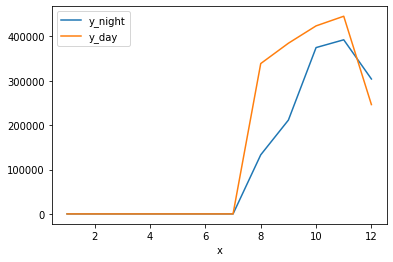

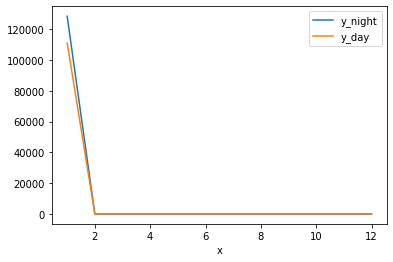

1 month
january day
128364.72439896809 january total distance at nigth
111057.9807521668 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
128364.72439896809
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
111057.9807521668
0
0
0
0
0
0
0
0
0
0
0


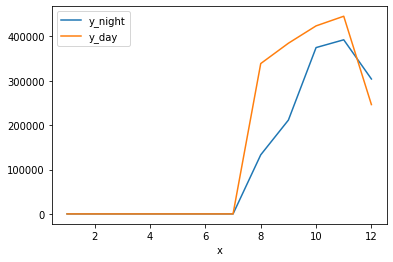

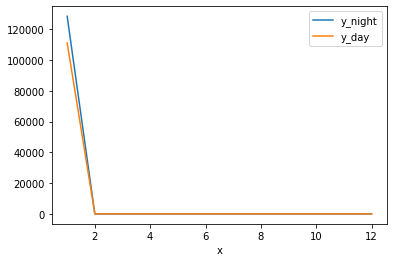

1 month
january day
128364.72439896809 january total distance at nigth
111817.77160154519 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
128364.72439896809
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
111817.77160154519
0
0
0
0
0
0
0
0
0
0
0


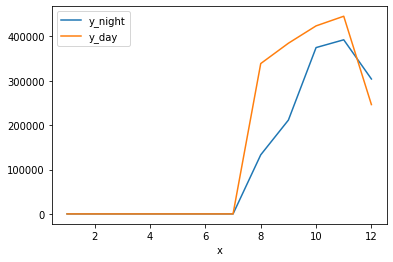

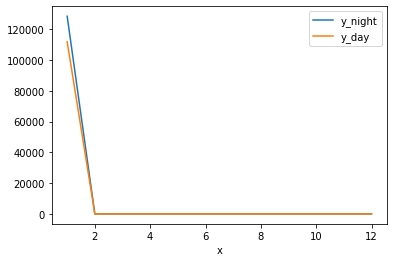

1 month
january day
128364.72439896809 january total distance at nigth
112645.19800170072 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
128364.72439896809
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
112645.19800170072
0
0
0
0
0
0
0
0
0
0
0


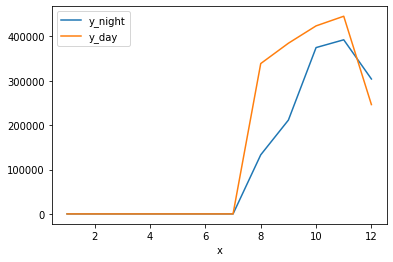

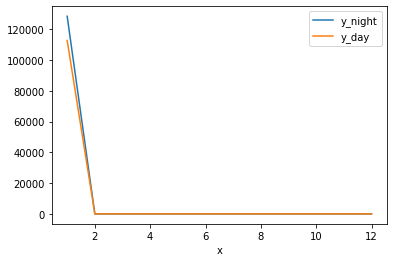

1 month
january day
128364.72439896809 january total distance at nigth
112955.71967627679 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
128364.72439896809
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
112955.71967627679
0
0
0
0
0
0
0
0
0
0
0


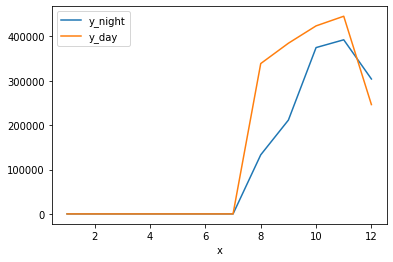

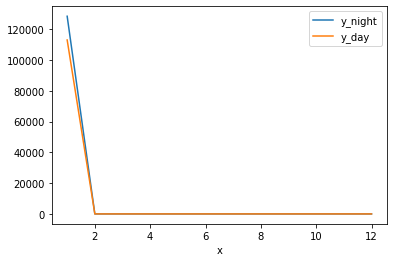

1 month
january day
128364.72439896809 january total distance at nigth
113370.6490636564 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
128364.72439896809
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
113370.6490636564
0
0
0
0
0
0
0
0
0
0
0


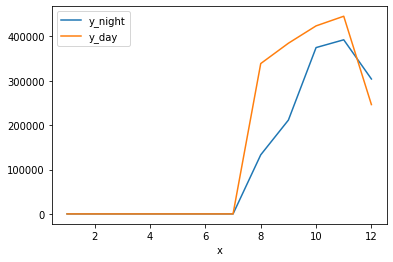

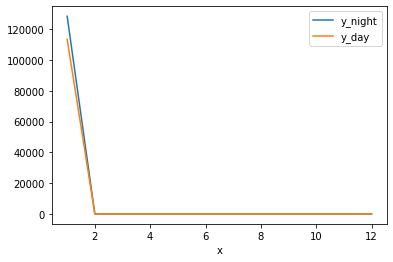

1 month
january nigth
129605.30097075584 january total distance at nigth
113370.6490636564 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
129605.30097075584
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
113370.6490636564
0
0
0
0
0
0
0
0
0
0
0


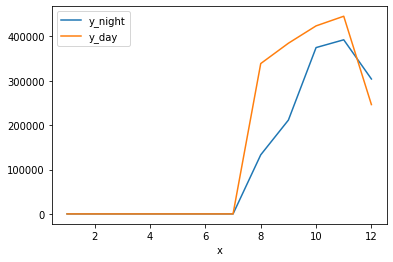

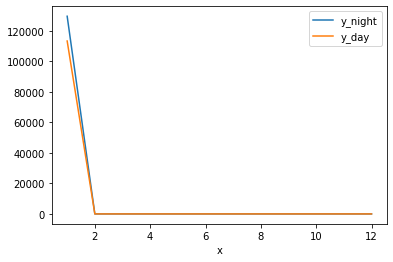

1 month
january nigth
129623.27987656316 january total distance at nigth
113370.6490636564 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
129623.27987656316
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
113370.6490636564
0
0
0
0
0
0
0
0
0
0
0


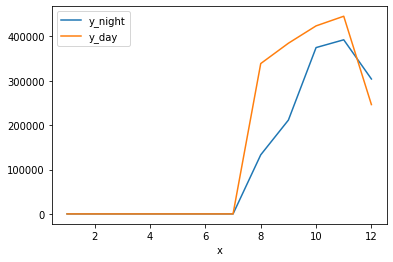

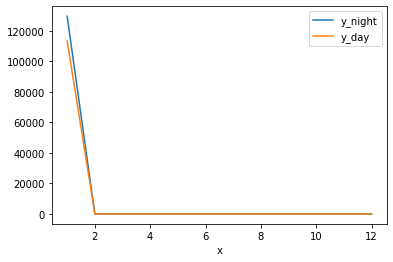

1 month
january nigth
133934.94474522094 january total distance at nigth
113370.6490636564 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
133934.94474522094
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
113370.6490636564
0
0
0
0
0
0
0
0
0
0
0


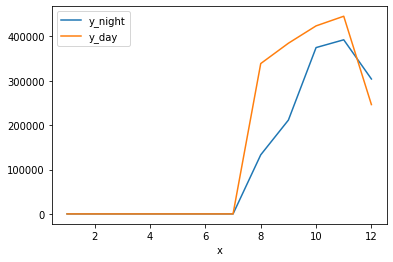

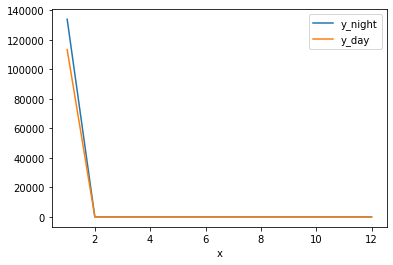

1 month
january nigth
136770.2012443128 january total distance at nigth
113370.6490636564 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
136770.2012443128
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
113370.6490636564
0
0
0
0
0
0
0
0
0
0
0


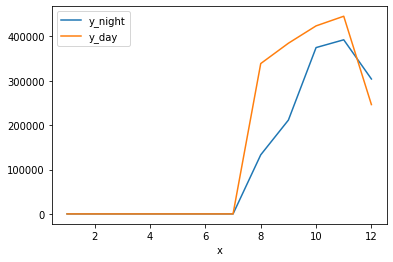

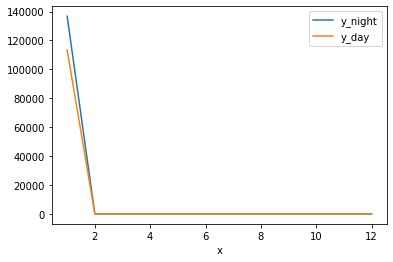

1 month
january nigth
139740.10420260121 january total distance at nigth
113370.6490636564 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
139740.10420260121
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
113370.6490636564
0
0
0
0
0
0
0
0
0
0
0


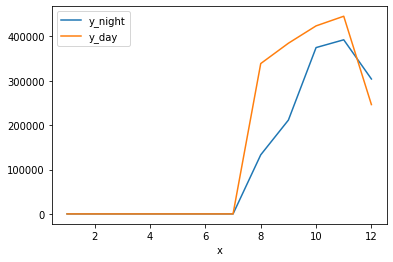

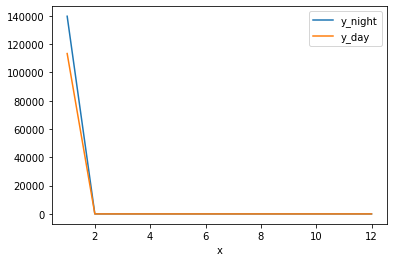

1 month
january day
139740.10420260121 january total distance at nigth
116206.54573772983 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
139740.10420260121
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
116206.54573772983
0
0
0
0
0
0
0
0
0
0
0


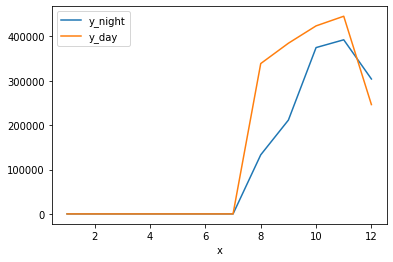

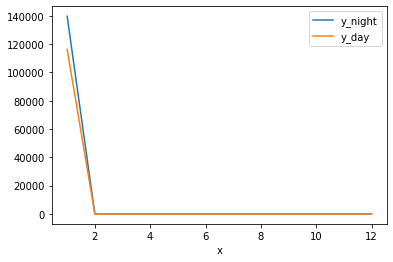

1 month
january day
139740.10420260121 january total distance at nigth
117906.06097613244 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
139740.10420260121
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
117906.06097613244
0
0
0
0
0
0
0
0
0
0
0


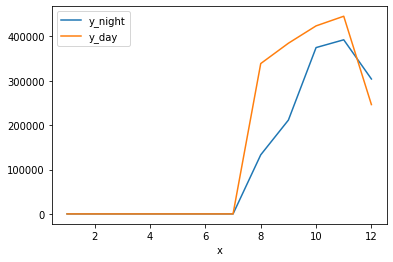

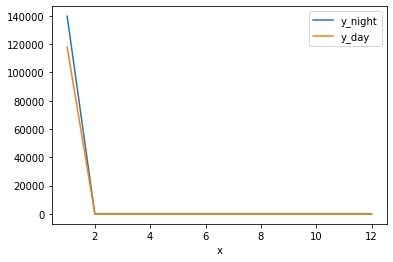

1 month
january day
139740.10420260121 january total distance at nigth
119080.66365198996 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
139740.10420260121
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
119080.66365198996
0
0
0
0
0
0
0
0
0
0
0


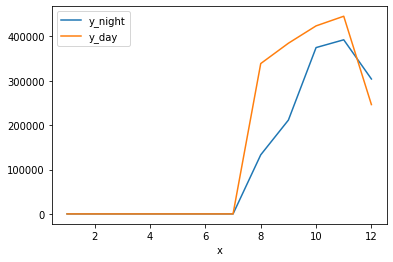

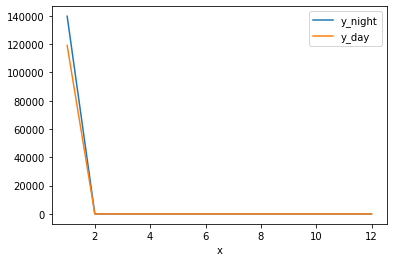

1 month
january nigth
141558.0698972682 january total distance at nigth
119080.66365198996 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
141558.0698972682
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
119080.66365198996
0
0
0
0
0
0
0
0
0
0
0


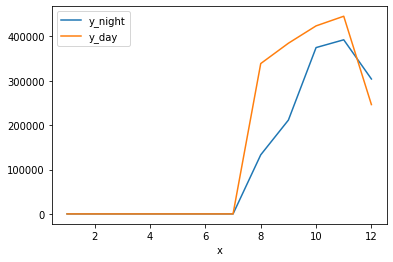

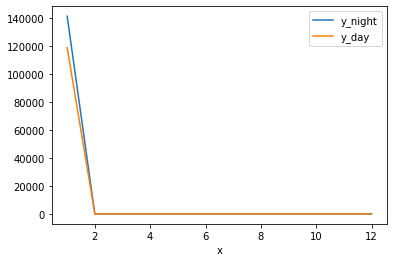

1 month
january nigth
142982.6173745049 january total distance at nigth
119080.66365198996 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
142982.6173745049
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
119080.66365198996
0
0
0
0
0
0
0
0
0
0
0


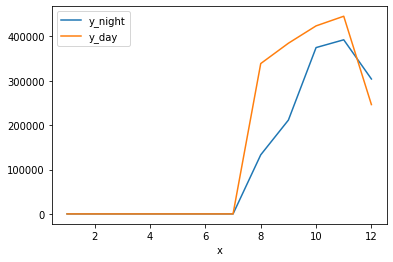

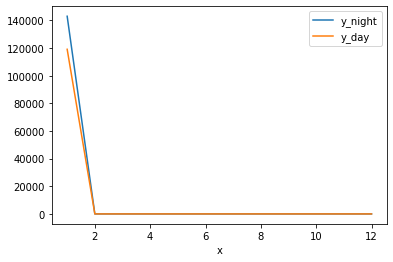

1 month
january nigth
144399.11691854178 january total distance at nigth
119080.66365198996 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
144399.11691854178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
119080.66365198996
0
0
0
0
0
0
0
0
0
0
0


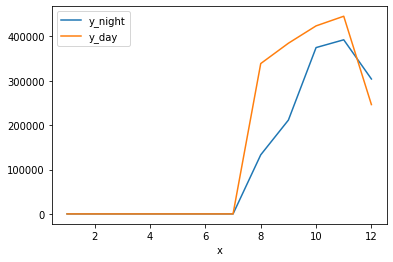

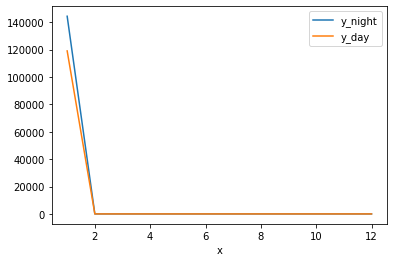

1 month
january day
144399.11691854178 january total distance at nigth
120363.17594296196 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
144399.11691854178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
120363.17594296196
0
0
0
0
0
0
0
0
0
0
0


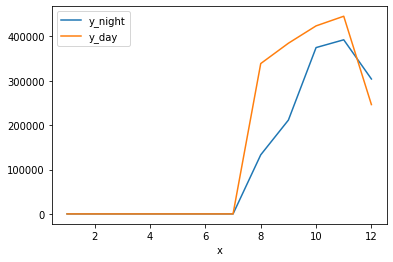

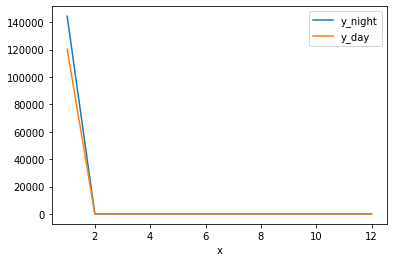

1 month
january day
144399.11691854178 january total distance at nigth
120469.75780801976 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
144399.11691854178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
120469.75780801976
0
0
0
0
0
0
0
0
0
0
0


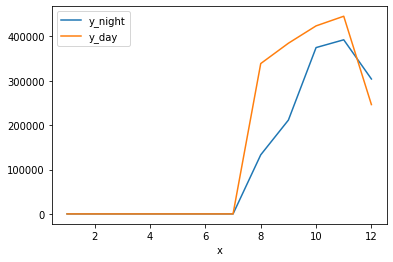

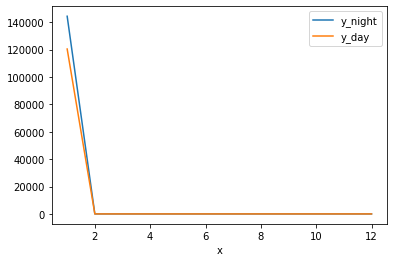

1 month
january day
144399.11691854178 january total distance at nigth
120820.31601353588 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
144399.11691854178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
120820.31601353588
0
0
0
0
0
0
0
0
0
0
0


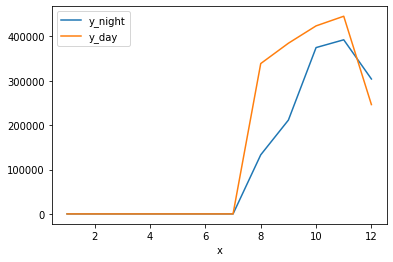

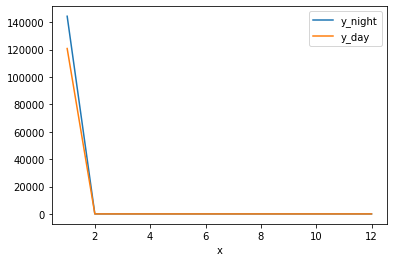

1 month
january day
144399.11691854178 january total distance at nigth
121075.22729458624 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
144399.11691854178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
121075.22729458624
0
0
0
0
0
0
0
0
0
0
0


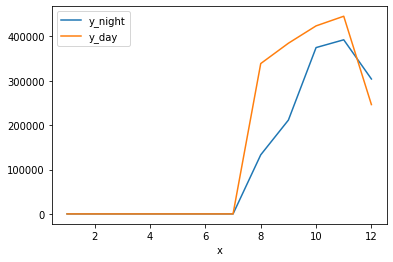

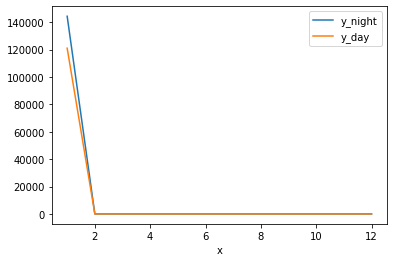

1 month
january day
144399.11691854178 january total distance at nigth
121507.59676755883 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
144399.11691854178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
121507.59676755883
0
0
0
0
0
0
0
0
0
0
0


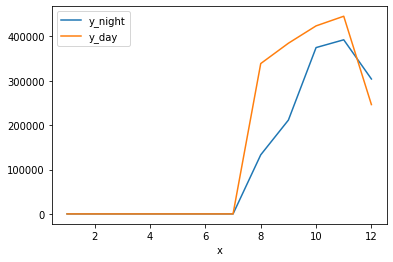

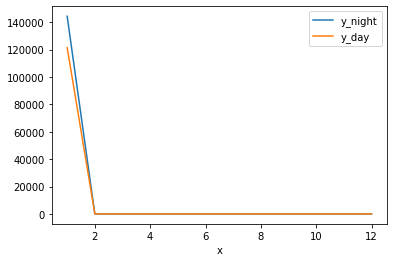

1 month
january day
144399.11691854178 january total distance at nigth
123002.76792218702 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
144399.11691854178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
123002.76792218702
0
0
0
0
0
0
0
0
0
0
0


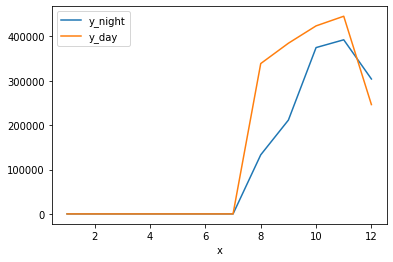

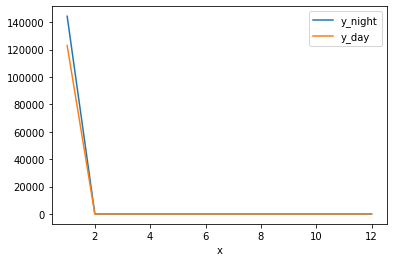

1 month
january day
144399.11691854178 january total distance at nigth
124003.89501941037 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
144399.11691854178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
124003.89501941037
0
0
0
0
0
0
0
0
0
0
0


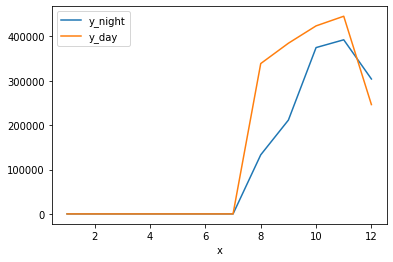

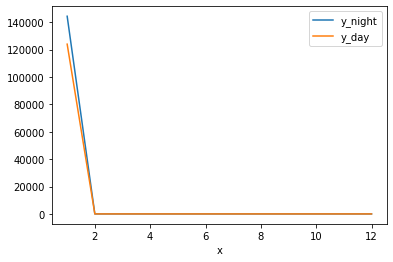

1 month
january nigth
147497.37154362164 january total distance at nigth
124003.89501941037 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
147497.37154362164
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
124003.89501941037
0
0
0
0
0
0
0
0
0
0
0


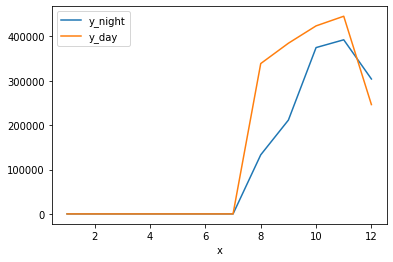

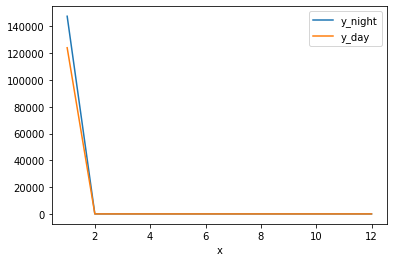

1 month
january nigth
148926.41881862865 january total distance at nigth
124003.89501941037 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
148926.41881862865
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
124003.89501941037
0
0
0
0
0
0
0
0
0
0
0


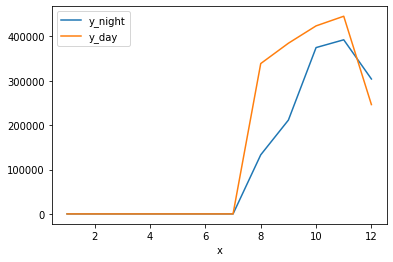

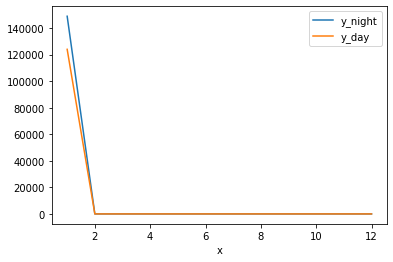

1 month
january nigth
151799.37401605808 january total distance at nigth
124003.89501941037 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
151799.37401605808
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
124003.89501941037
0
0
0
0
0
0
0
0
0
0
0


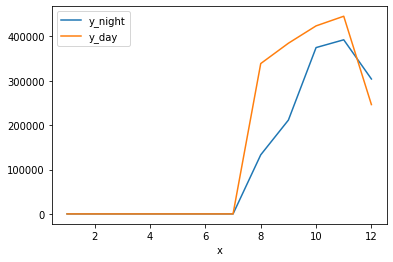

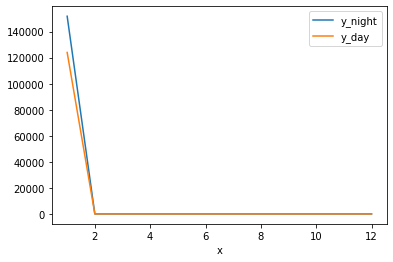

1 month
january day
151799.37401605808 january total distance at nigth
125745.11003479235 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
151799.37401605808
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
125745.11003479235
0
0
0
0
0
0
0
0
0
0
0


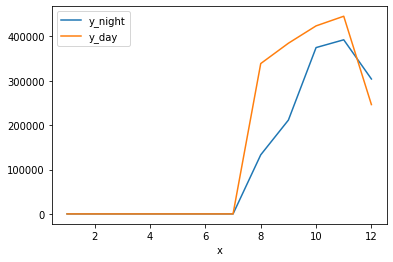

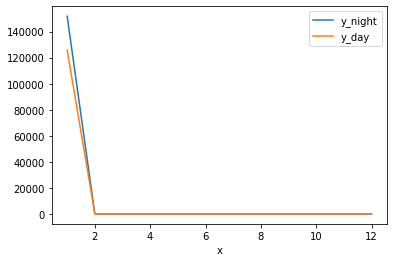

1 month
january day
151799.37401605808 january total distance at nigth
126366.47865062272 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
151799.37401605808
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
126366.47865062272
0
0
0
0
0
0
0
0
0
0
0


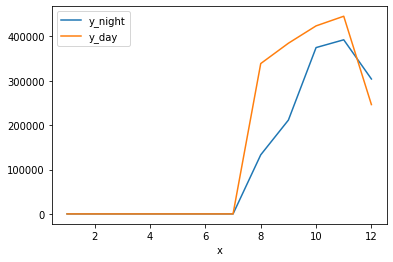

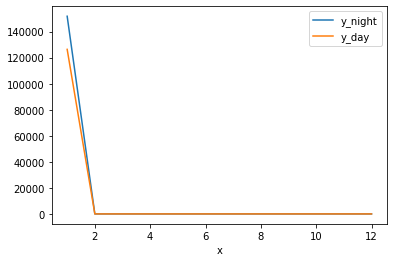

1 month
january day
151799.37401605808 january total distance at nigth
126641.82331648537 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
151799.37401605808
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
126641.82331648537
0
0
0
0
0
0
0
0
0
0
0


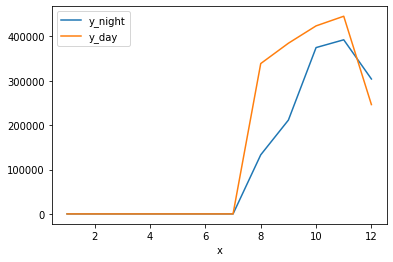

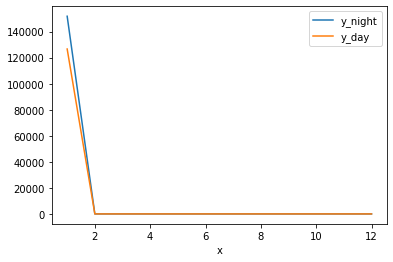

1 month
january day
151799.37401605808 january total distance at nigth
127017.75658854774 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
151799.37401605808
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
127017.75658854774
0
0
0
0
0
0
0
0
0
0
0


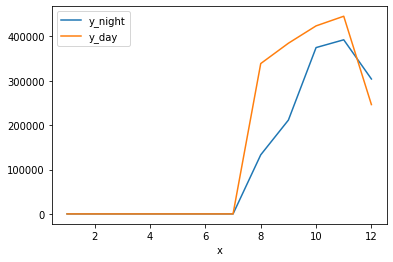

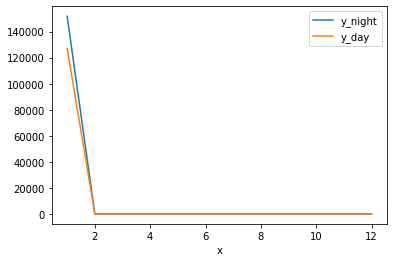

1 month
january nigth
156204.05089859 january total distance at nigth
127017.75658854774 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
156204.05089859
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
127017.75658854774
0
0
0
0
0
0
0
0
0
0
0


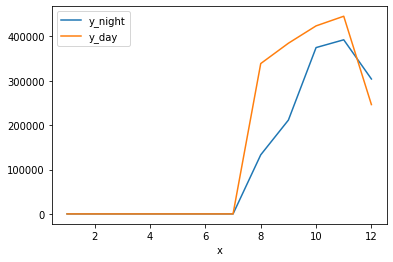

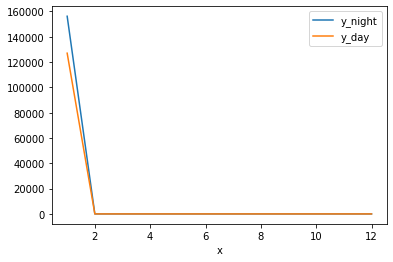

1 month
january nigth
156407.11341169153 january total distance at nigth
127017.75658854774 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
156407.11341169153
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
127017.75658854774
0
0
0
0
0
0
0
0
0
0
0


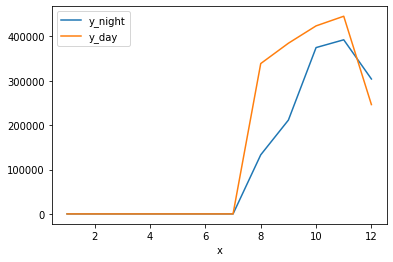

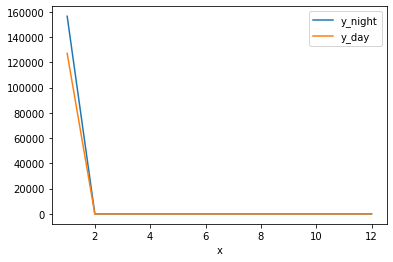

1 month
january nigth
157410.2327256844 january total distance at nigth
127017.75658854774 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
157410.2327256844
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
127017.75658854774
0
0
0
0
0
0
0
0
0
0
0


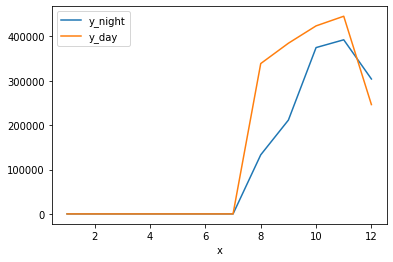

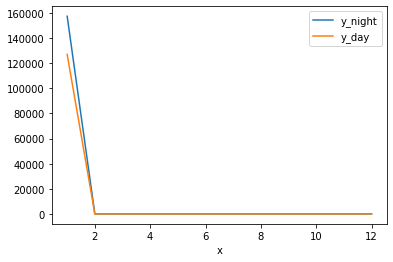

1 month
january day
157410.2327256844 january total distance at nigth
128457.01295190258 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
157410.2327256844
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
128457.01295190258
0
0
0
0
0
0
0
0
0
0
0


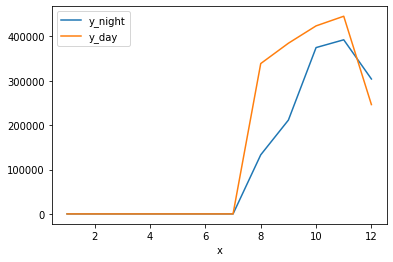

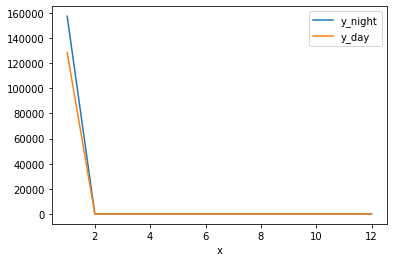

1 month
january day
157410.2327256844 january total distance at nigth
128594.25070212304 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
157410.2327256844
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
128594.25070212304
0
0
0
0
0
0
0
0
0
0
0


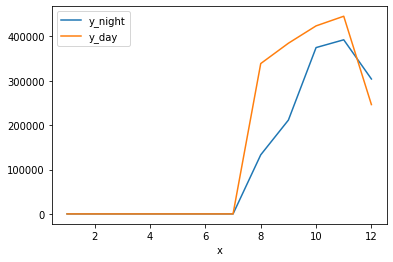

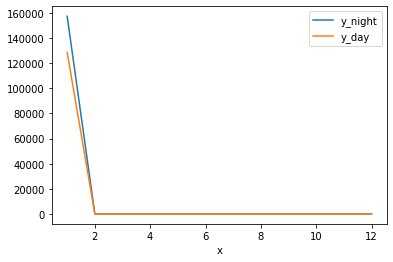

1 month
january day
157410.2327256844 january total distance at nigth
129483.67367305535 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
157410.2327256844
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
129483.67367305535
0
0
0
0
0
0
0
0
0
0
0


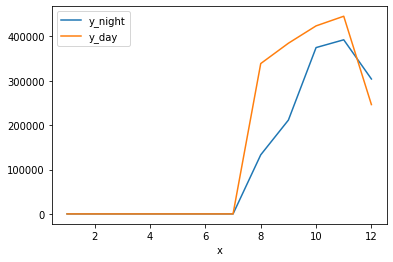

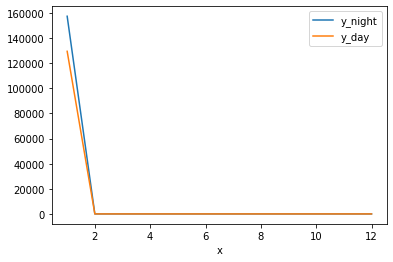

1 month
january day
157410.2327256844 january total distance at nigth
130123.75708749105 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
157410.2327256844
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
130123.75708749105
0
0
0
0
0
0
0
0
0
0
0


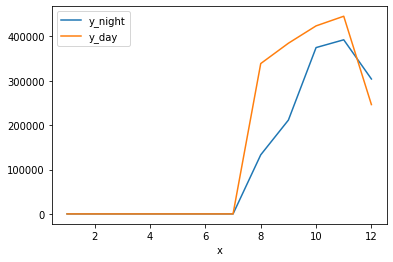

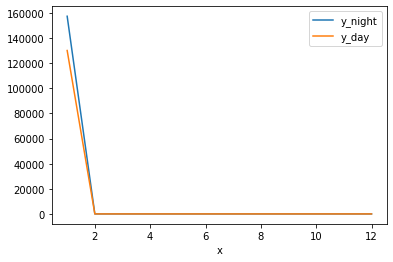

1 month
january day
157410.2327256844 january total distance at nigth
130825.53993328993 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
157410.2327256844
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
130825.53993328993
0
0
0
0
0
0
0
0
0
0
0


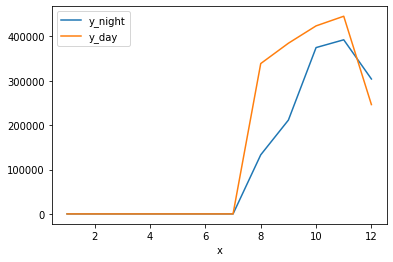

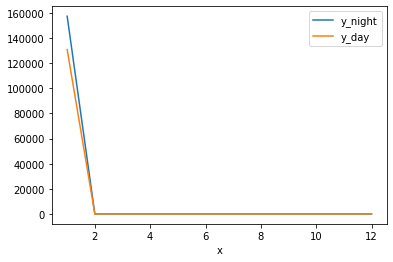

1 month
january day
157410.2327256844 january total distance at nigth
131392.41351522147 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
157410.2327256844
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
131392.41351522147
0
0
0
0
0
0
0
0
0
0
0


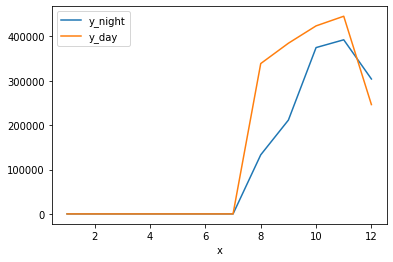

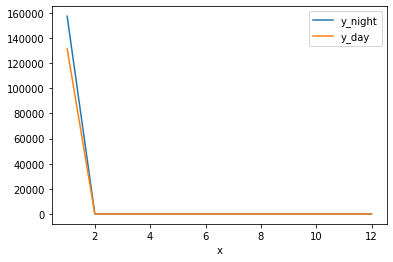

1 month
january nigth
160954.76399294133 january total distance at nigth
131392.41351522147 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
160954.76399294133
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
131392.41351522147
0
0
0
0
0
0
0
0
0
0
0


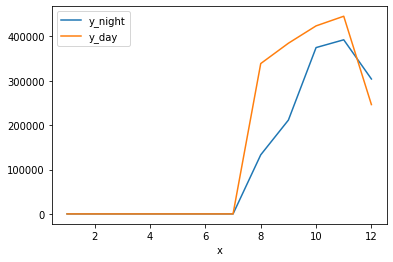

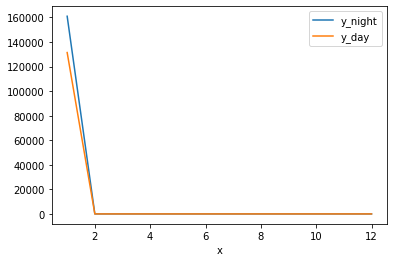

1 month
january nigth
164286.91318617165 january total distance at nigth
131392.41351522147 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
164286.91318617165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
131392.41351522147
0
0
0
0
0
0
0
0
0
0
0


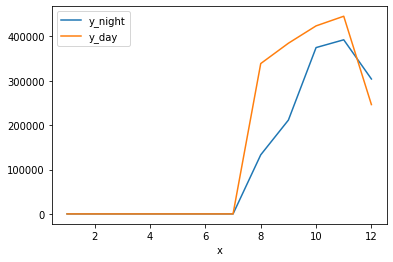

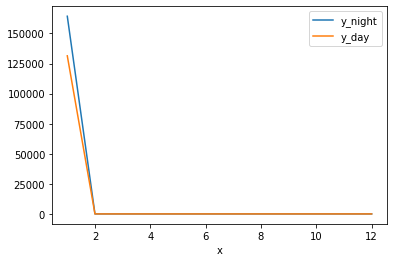

1 month
january day
164286.91318617165 january total distance at nigth
133642.60121251992 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
164286.91318617165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
133642.60121251992
0
0
0
0
0
0
0
0
0
0
0


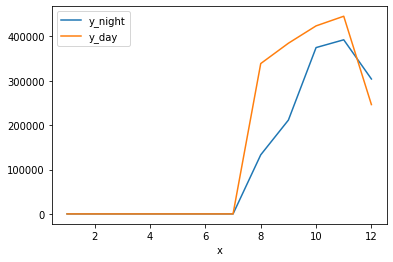

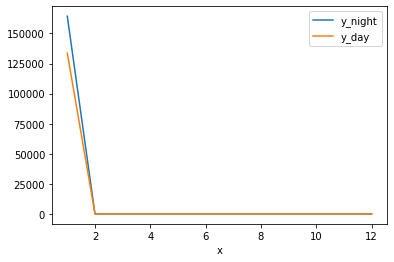

1 month
january day
164286.91318617165 january total distance at nigth
134159.12437389742 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
164286.91318617165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
134159.12437389742
0
0
0
0
0
0
0
0
0
0
0


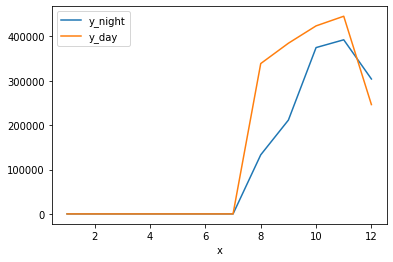

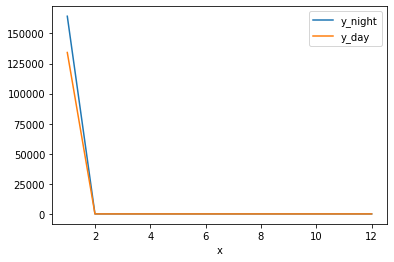

1 month
january day
164286.91318617165 january total distance at nigth
134631.99684203666 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
164286.91318617165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
134631.99684203666
0
0
0
0
0
0
0
0
0
0
0


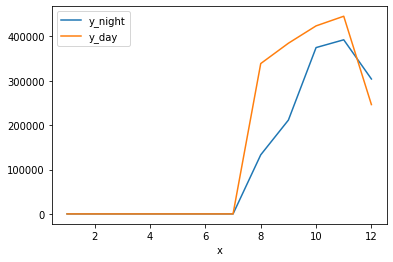

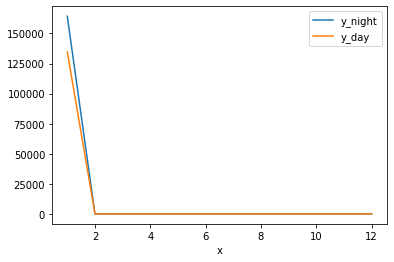

1 month
january day
164286.91318617165 january total distance at nigth
135743.45288429997 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
164286.91318617165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
135743.45288429997
0
0
0
0
0
0
0
0
0
0
0


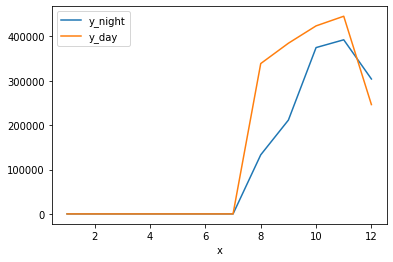

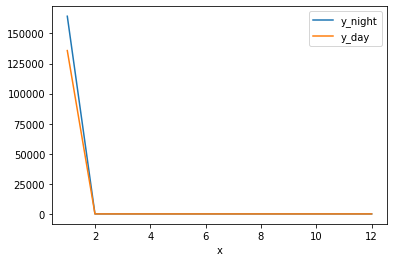

1 month
january day
164286.91318617165 january total distance at nigth
136518.2347656398 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
164286.91318617165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
136518.2347656398
0
0
0
0
0
0
0
0
0
0
0


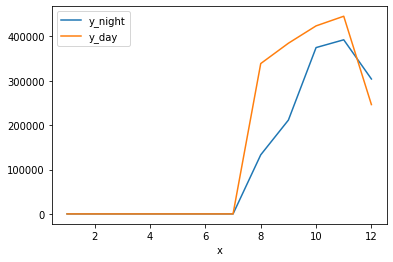

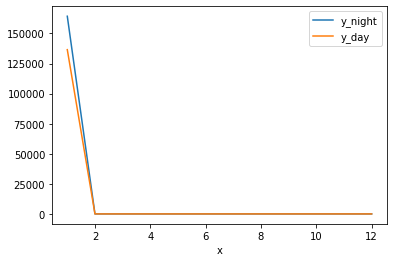

1 month
january day
164286.91318617165 january total distance at nigth
138400.1751842306 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
164286.91318617165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
138400.1751842306
0
0
0
0
0
0
0
0
0
0
0


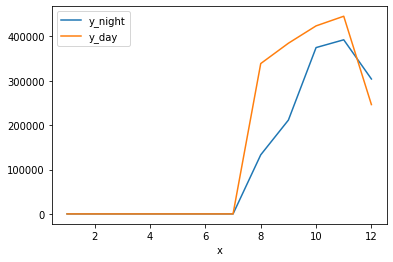

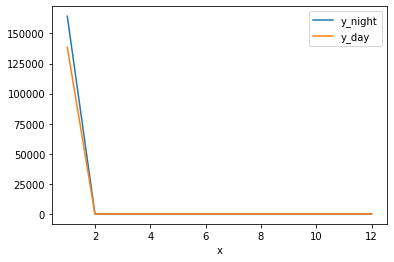

1 month
january nigth
168470.90035575157 january total distance at nigth
138400.1751842306 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
168470.90035575157
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
138400.1751842306
0
0
0
0
0
0
0
0
0
0
0


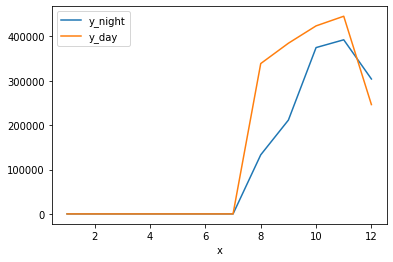

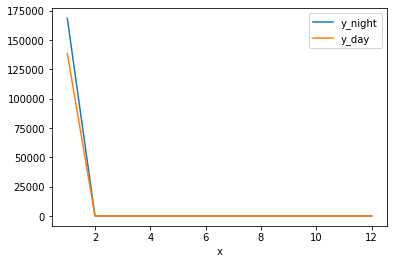

1 month
january nigth
169338.78208796252 january total distance at nigth
138400.1751842306 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
169338.78208796252
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
138400.1751842306
0
0
0
0
0
0
0
0
0
0
0


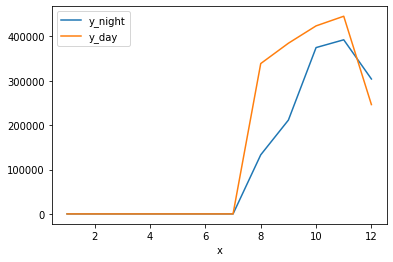

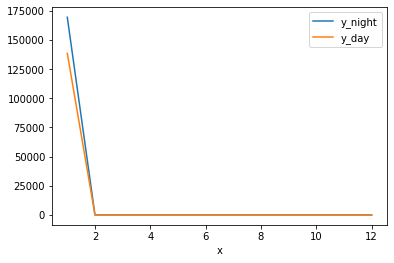

1 month
january nigth
170055.41925916032 january total distance at nigth
138400.1751842306 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
170055.41925916032
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
138400.1751842306
0
0
0
0
0
0
0
0
0
0
0


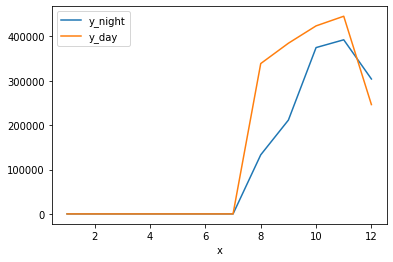

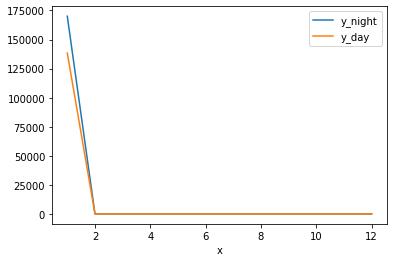

1 month
january nigth
172607.75459394927 january total distance at nigth
138400.1751842306 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
172607.75459394927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
138400.1751842306
0
0
0
0
0
0
0
0
0
0
0


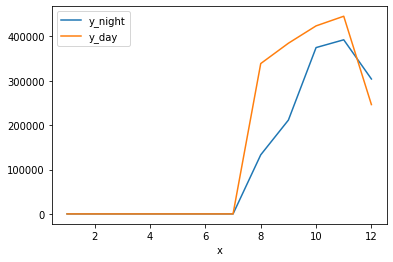

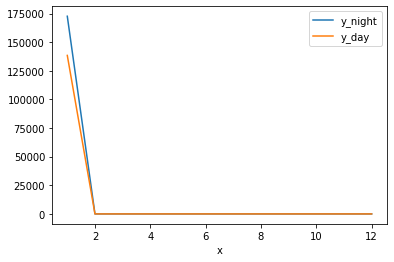

1 month
january day
172607.75459394927 january total distance at nigth
141430.85472081634 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
172607.75459394927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
141430.85472081634
0
0
0
0
0
0
0
0
0
0
0


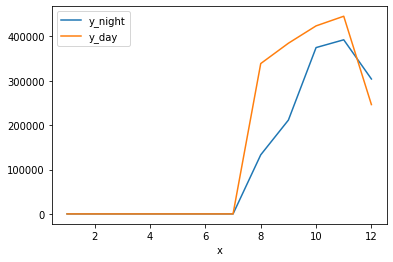

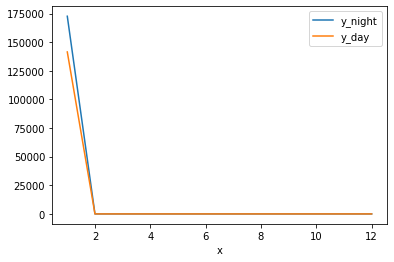

1 month
january day
172607.75459394927 january total distance at nigth
142652.08096383585 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
172607.75459394927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
142652.08096383585
0
0
0
0
0
0
0
0
0
0
0


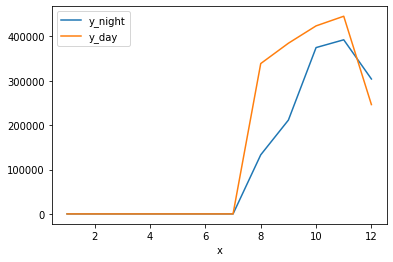

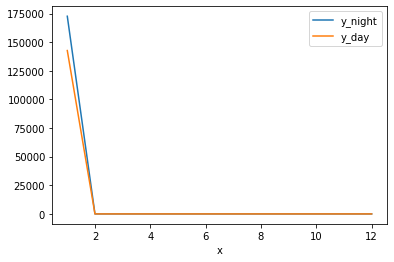

1 month
january day
172607.75459394927 january total distance at nigth
143752.75123187978 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
172607.75459394927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
143752.75123187978
0
0
0
0
0
0
0
0
0
0
0


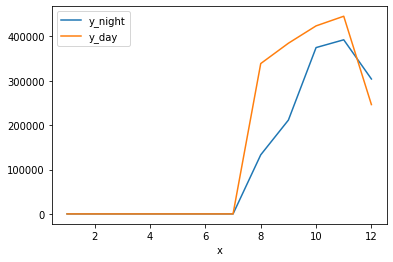

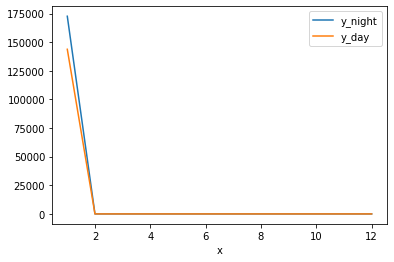

1 month
january day
172607.75459394927 january total distance at nigth
144794.5650804705 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
172607.75459394927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
144794.5650804705
0
0
0
0
0
0
0
0
0
0
0


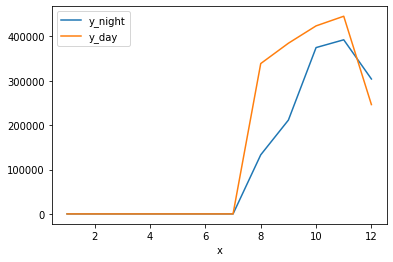

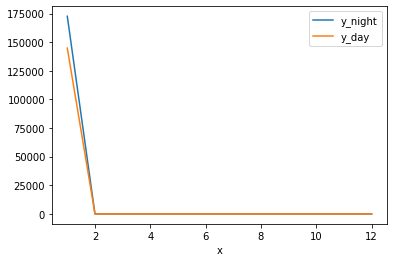

1 month
january day
172607.75459394927 january total distance at nigth
145919.8364943555 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
172607.75459394927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
145919.8364943555
0
0
0
0
0
0
0
0
0
0
0


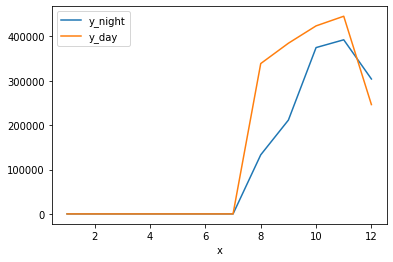

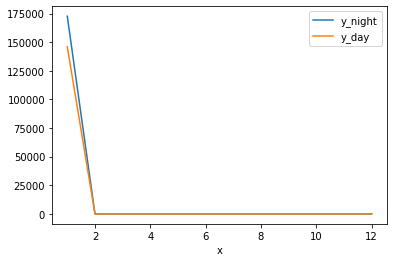

1 month
january day
172607.75459394927 january total distance at nigth
147046.2958363128 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
172607.75459394927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
147046.2958363128
0
0
0
0
0
0
0
0
0
0
0


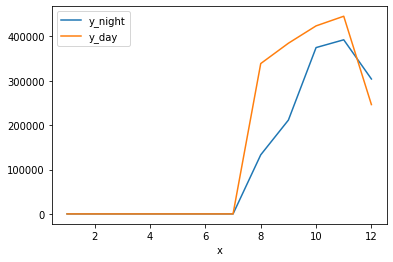

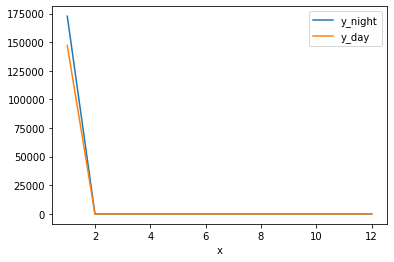

1 month
january day
172607.75459394927 january total distance at nigth
147773.43393484346 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
172607.75459394927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
147773.43393484346
0
0
0
0
0
0
0
0
0
0
0


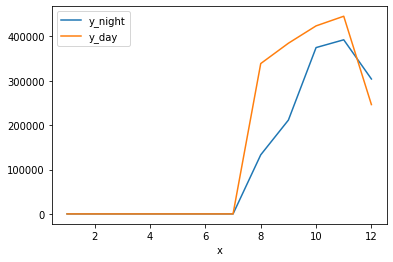

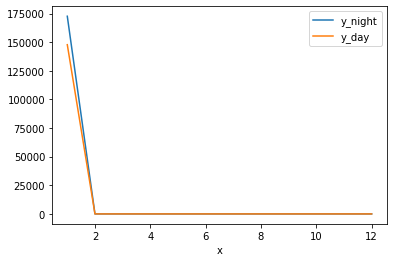

1 month
january day
172607.75459394927 january total distance at nigth
148285.34289982586 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
172607.75459394927
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
148285.34289982586
0
0
0
0
0
0
0
0
0
0
0


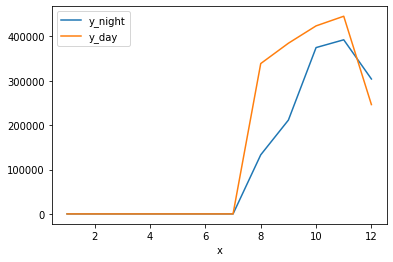

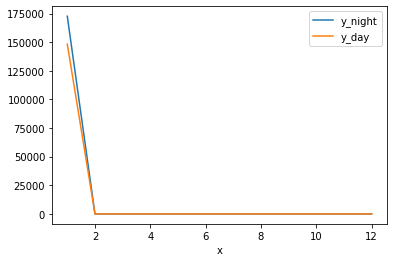

1 month
january nigth
173022.91748827347 january total distance at nigth
148285.34289982586 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
173022.91748827347
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
148285.34289982586
0
0
0
0
0
0
0
0
0
0
0


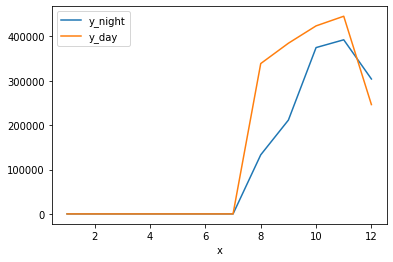

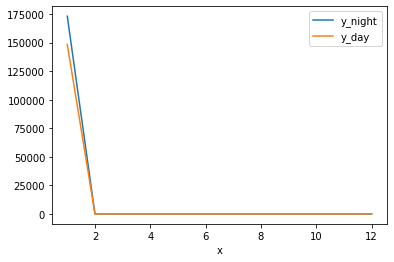

1 month
january nigth
173236.97593190006 january total distance at nigth
148285.34289982586 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
173236.97593190006
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
148285.34289982586
0
0
0
0
0
0
0
0
0
0
0


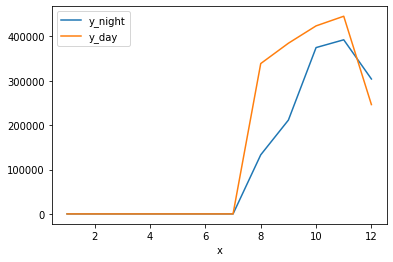

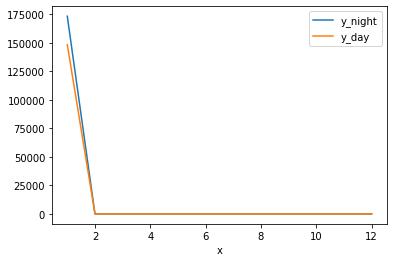

1 month
january nigth
173969.22600744735 january total distance at nigth
148285.34289982586 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
173969.22600744735
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
148285.34289982586
0
0
0
0
0
0
0
0
0
0
0


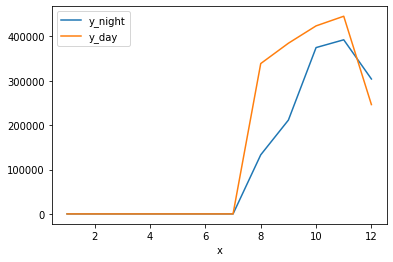

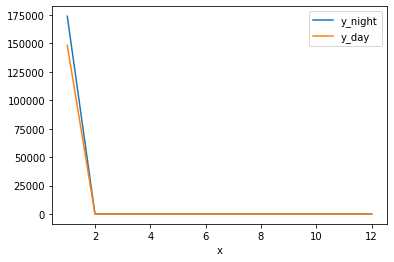

1 month
january nigth
178060.66583298505 january total distance at nigth
148285.34289982586 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
178060.66583298505
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
148285.34289982586
0
0
0
0
0
0
0
0
0
0
0


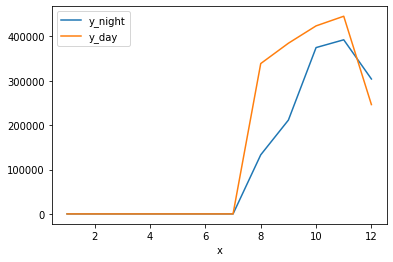

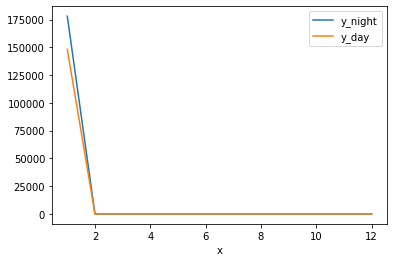

1 month
january day
178060.66583298505 january total distance at nigth
151078.67599825593 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
178060.66583298505
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
151078.67599825593
0
0
0
0
0
0
0
0
0
0
0


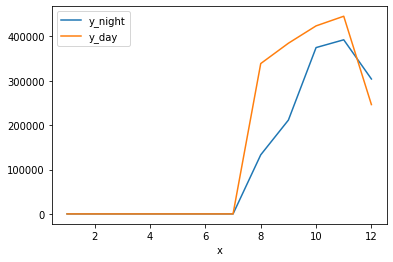

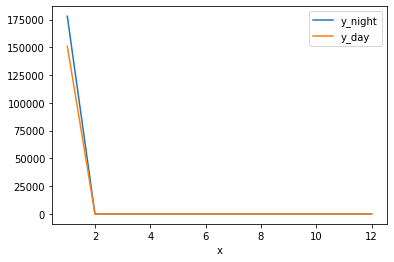

1 month
january day
178060.66583298505 january total distance at nigth
151425.56797251877 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
178060.66583298505
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
151425.56797251877
0
0
0
0
0
0
0
0
0
0
0


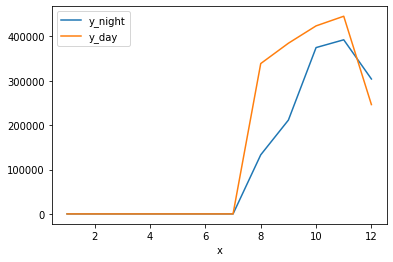

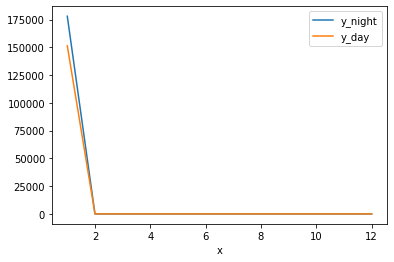

1 month
january day
178060.66583298505 january total distance at nigth
151479.3527591851 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
178060.66583298505
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
151479.3527591851
0
0
0
0
0
0
0
0
0
0
0


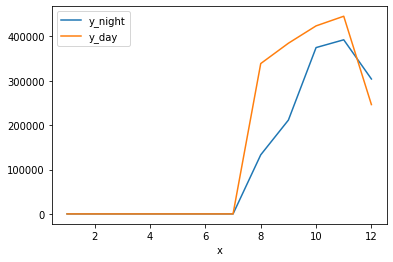

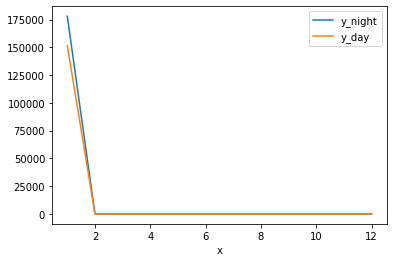

1 month
january nigth
182386.18321279617 january total distance at nigth
151479.3527591851 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
182386.18321279617
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
151479.3527591851
0
0
0
0
0
0
0
0
0
0
0


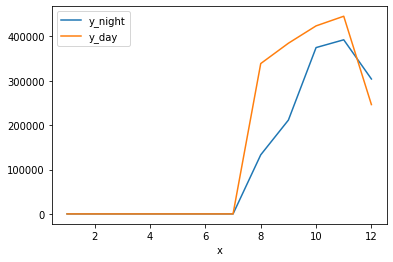

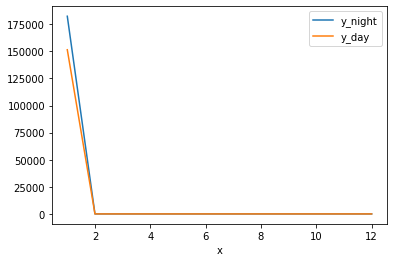

1 month
january nigth
184702.8384250328 january total distance at nigth
151479.3527591851 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
151479.3527591851
0
0
0
0
0
0
0
0
0
0
0


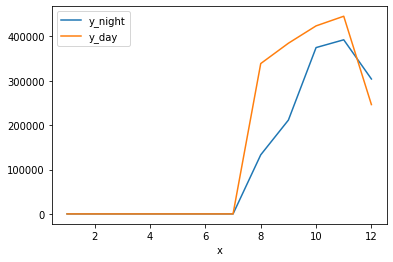

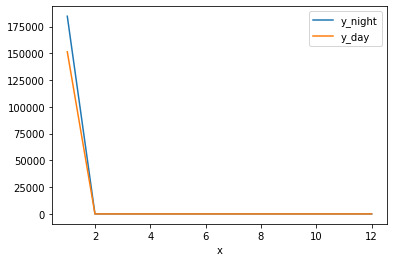

1 month
january day
184702.8384250328 january total distance at nigth
151618.03298192518 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
151618.03298192518
0
0
0
0
0
0
0
0
0
0
0


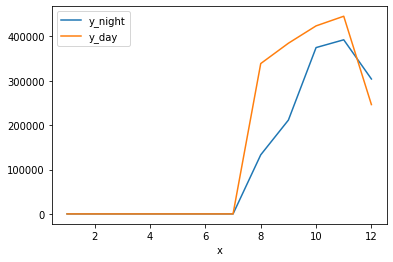

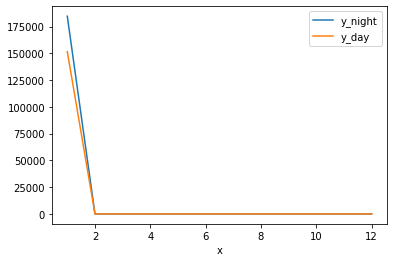

1 month
january day
184702.8384250328 january total distance at nigth
152387.10030657946 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
152387.10030657946
0
0
0
0
0
0
0
0
0
0
0


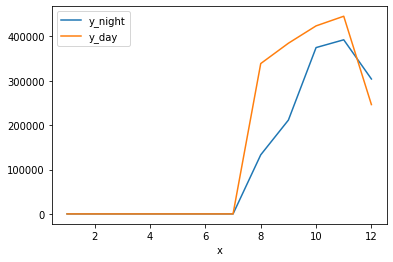

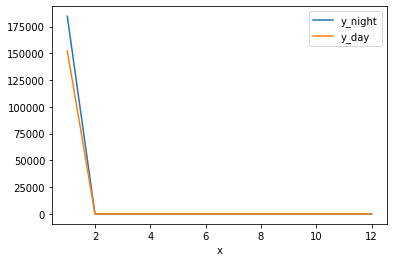

1 month
january day
184702.8384250328 january total distance at nigth
153330.41247193603 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
153330.41247193603
0
0
0
0
0
0
0
0
0
0
0


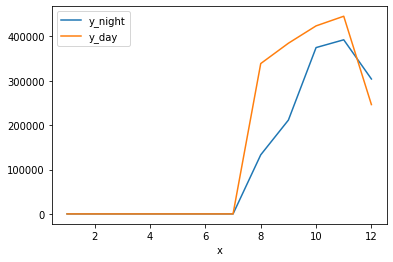

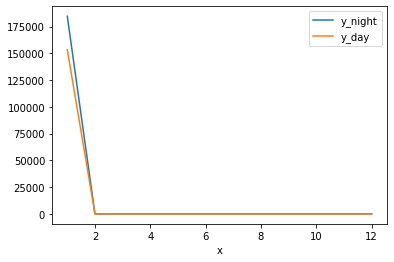

1 month
january day
184702.8384250328 january total distance at nigth
154461.10026407242 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
154461.10026407242
0
0
0
0
0
0
0
0
0
0
0


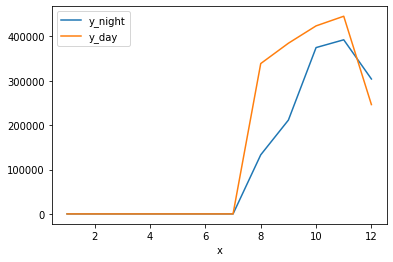

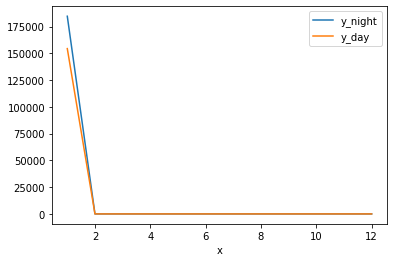

1 month
january day
184702.8384250328 january total distance at nigth
156926.40006435648 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
156926.40006435648
0
0
0
0
0
0
0
0
0
0
0


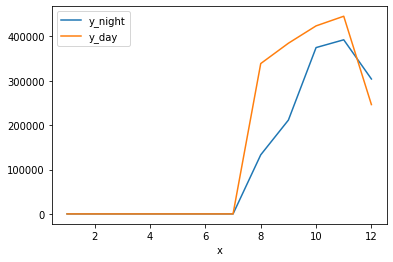

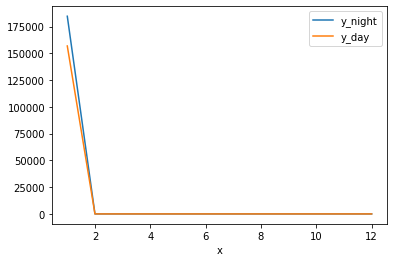

1 month
january day
184702.8384250328 january total distance at nigth
158131.30418286126 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
158131.30418286126
0
0
0
0
0
0
0
0
0
0
0


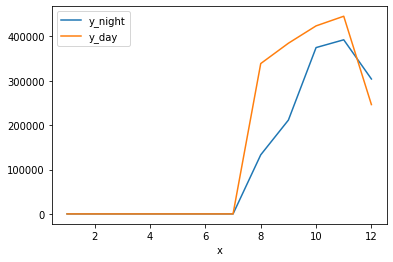

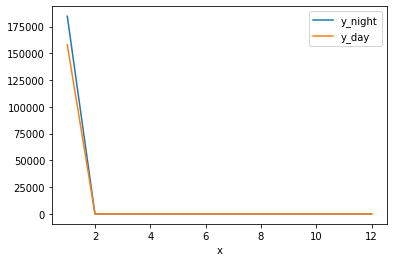

1 month
january day
184702.8384250328 january total distance at nigth
159344.0164063131 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
159344.0164063131
0
0
0
0
0
0
0
0
0
0
0


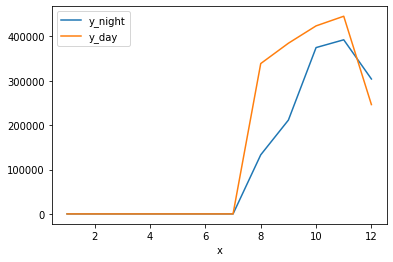

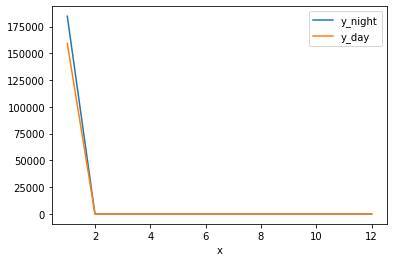

1 month
january day
184702.8384250328 january total distance at nigth
160239.7512889719 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
160239.7512889719
0
0
0
0
0
0
0
0
0
0
0


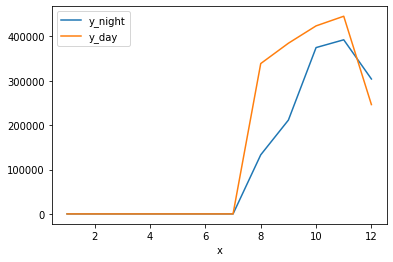

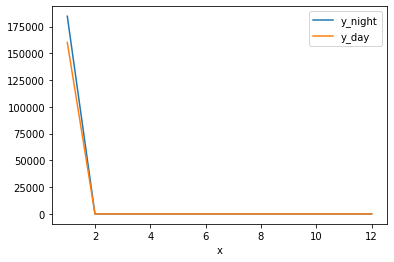

1 month
january day
184702.8384250328 january total distance at nigth
161093.83027005367 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
161093.83027005367
0
0
0
0
0
0
0
0
0
0
0


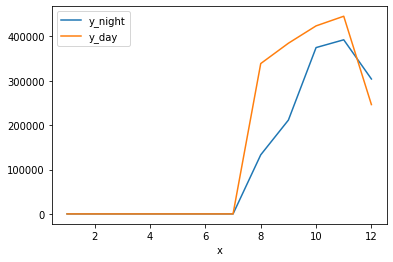

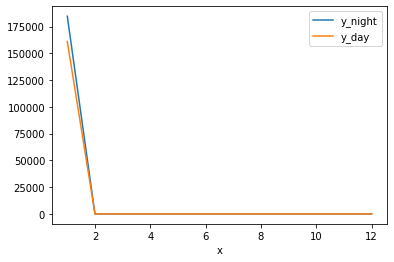

1 month
january day
184702.8384250328 january total distance at nigth
161788.46049947166 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
184702.8384250328
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
161788.46049947166
0
0
0
0
0
0
0
0
0
0
0


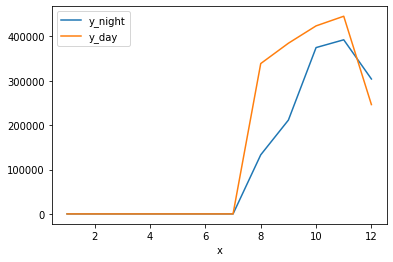

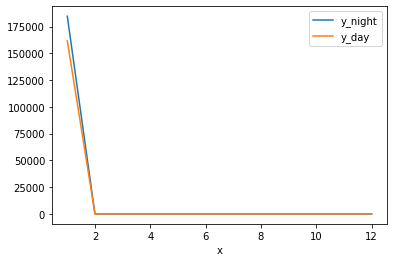

1 month
january nigth
186070.40871830436 january total distance at nigth
161788.46049947166 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
186070.40871830436
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
161788.46049947166
0
0
0
0
0
0
0
0
0
0
0


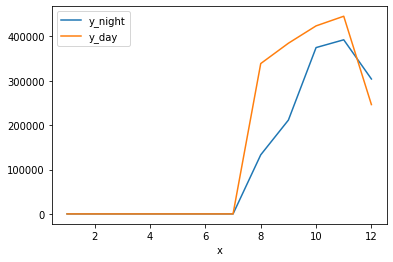

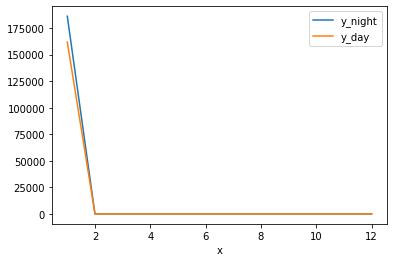

1 month
january nigth
186985.068387452 january total distance at nigth
161788.46049947166 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
186985.068387452
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
161788.46049947166
0
0
0
0
0
0
0
0
0
0
0


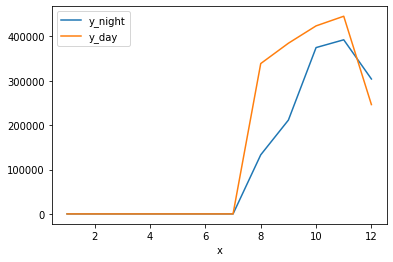

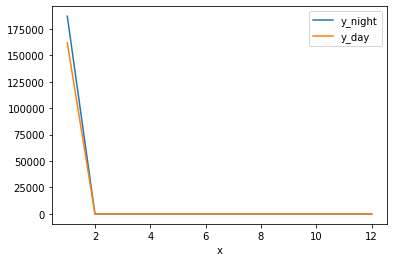

1 month
january nigth
187779.3418803255 january total distance at nigth
161788.46049947166 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
187779.3418803255
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
161788.46049947166
0
0
0
0
0
0
0
0
0
0
0


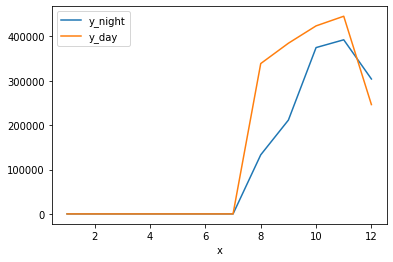

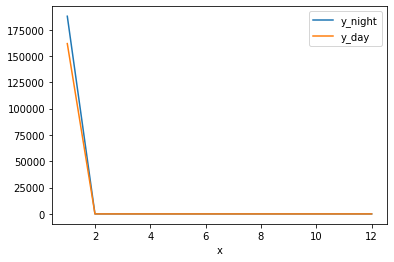

1 month
january nigth
189114.61471959346 january total distance at nigth
161788.46049947166 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
189114.61471959346
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
161788.46049947166
0
0
0
0
0
0
0
0
0
0
0


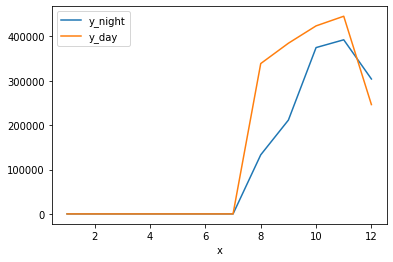

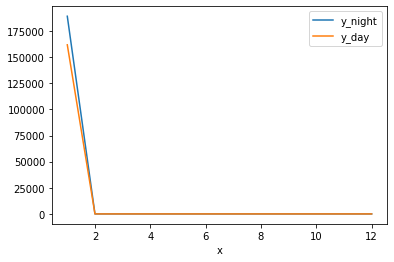

1 month
january nigth
189785.93891526287 january total distance at nigth
161788.46049947166 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
189785.93891526287
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
161788.46049947166
0
0
0
0
0
0
0
0
0
0
0


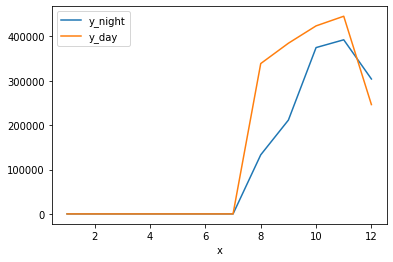

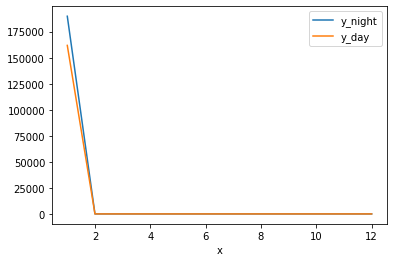

1 month
january day
189785.93891526287 january total distance at nigth
163199.0212229889 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
189785.93891526287
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
163199.0212229889
0
0
0
0
0
0
0
0
0
0
0


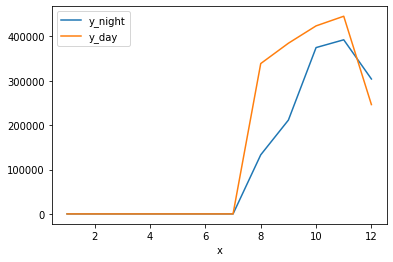

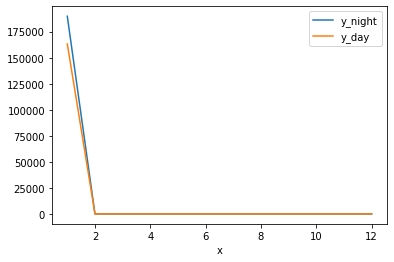

1 month
january day
189785.93891526287 january total distance at nigth
163215.5168108243 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
189785.93891526287
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
163215.5168108243
0
0
0
0
0
0
0
0
0
0
0


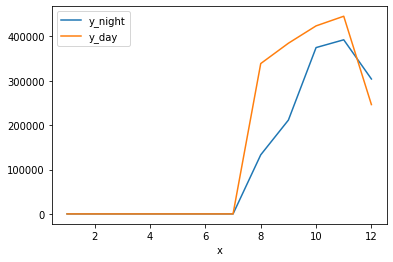

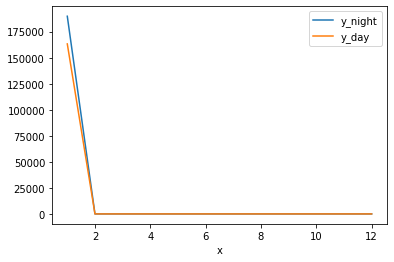

1 month
january day
189785.93891526287 january total distance at nigth
163462.75334754048 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
189785.93891526287
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
163462.75334754048
0
0
0
0
0
0
0
0
0
0
0


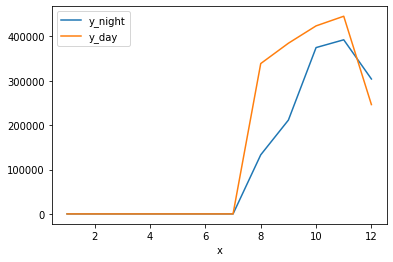

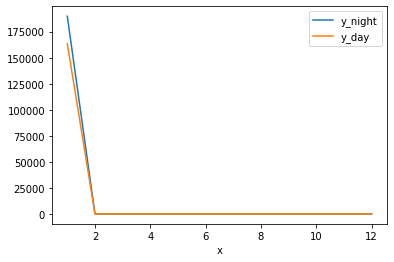

1 month
january day
189785.93891526287 january total distance at nigth
163743.96679480645 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
189785.93891526287
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
163743.96679480645
0
0
0
0
0
0
0
0
0
0
0


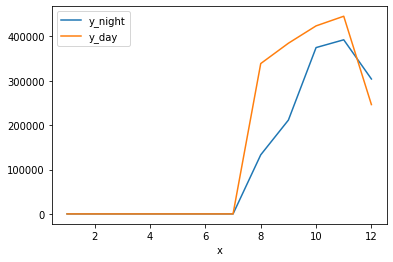

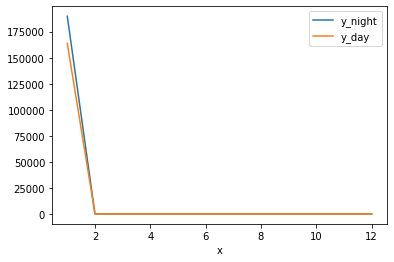

1 month
january nigth
190544.5764929482 january total distance at nigth
163743.96679480645 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
190544.5764929482
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
163743.96679480645
0
0
0
0
0
0
0
0
0
0
0


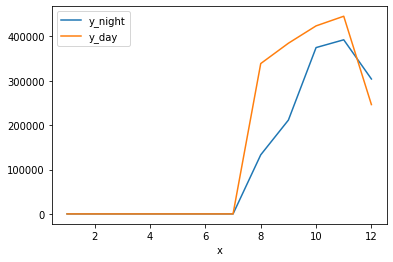

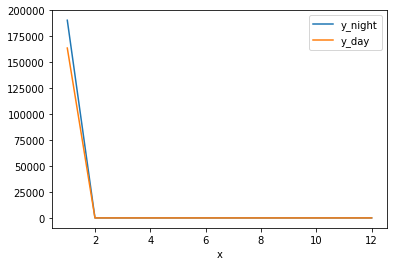

1 month
january nigth
191369.8521863793 january total distance at nigth
163743.96679480645 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
191369.8521863793
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
163743.96679480645
0
0
0
0
0
0
0
0
0
0
0


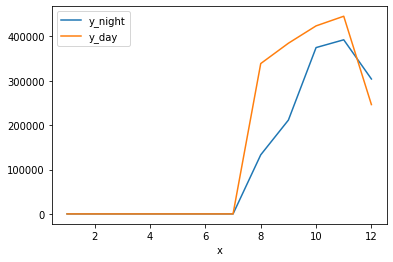

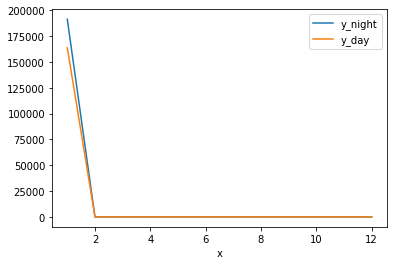

1 month
january nigth
192959.15864885657 january total distance at nigth
163743.96679480645 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
192959.15864885657
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
163743.96679480645
0
0
0
0
0
0
0
0
0
0
0


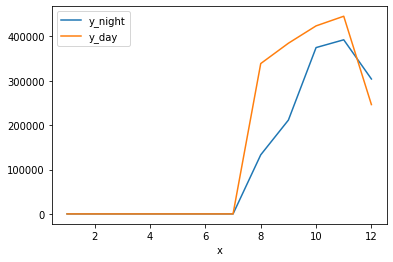

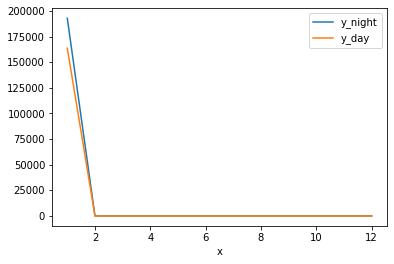

1 month
january day
192959.15864885657 january total distance at nigth
164625.71711242766 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
192959.15864885657
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
164625.71711242766
0
0
0
0
0
0
0
0
0
0
0


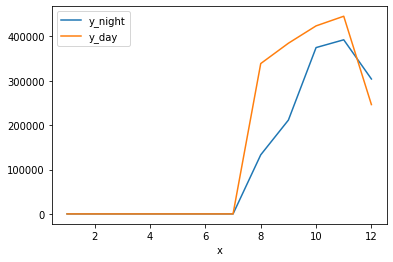

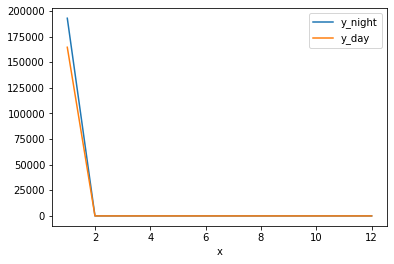

1 month
january day
192959.15864885657 january total distance at nigth
167264.2235430825 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
192959.15864885657
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
167264.2235430825
0
0
0
0
0
0
0
0
0
0
0


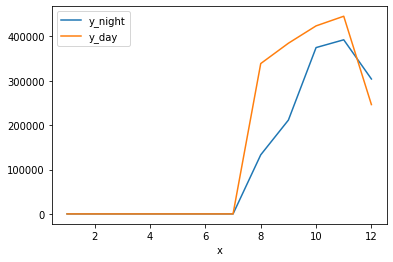

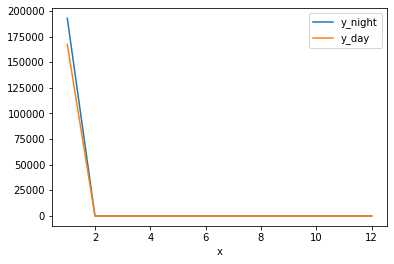

1 month
january day
192959.15864885657 january total distance at nigth
168412.99465746933 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
192959.15864885657
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
168412.99465746933
0
0
0
0
0
0
0
0
0
0
0


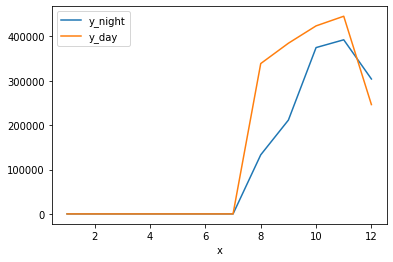

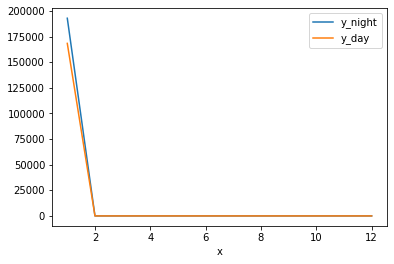

1 month
january day
192959.15864885657 january total distance at nigth
170167.74658208987 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
192959.15864885657
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
170167.74658208987
0
0
0
0
0
0
0
0
0
0
0


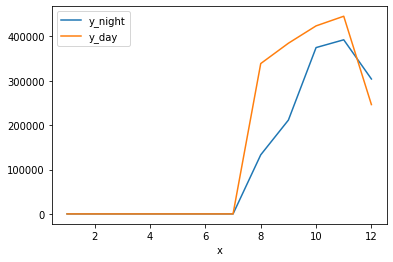

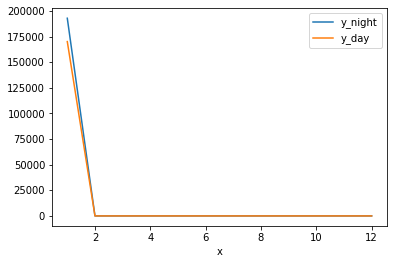

1 month
january day
192959.15864885657 january total distance at nigth
173381.84803354336 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
192959.15864885657
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
173381.84803354336
0
0
0
0
0
0
0
0
0
0
0


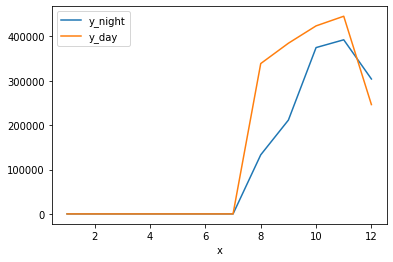

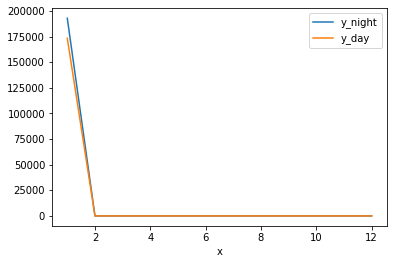

1 month
january day
192959.15864885657 january total distance at nigth
174581.88048629076 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
192959.15864885657
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
174581.88048629076
0
0
0
0
0
0
0
0
0
0
0


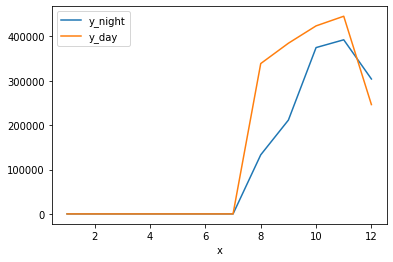

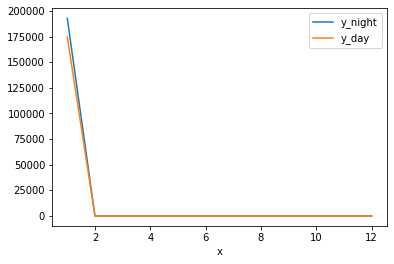

1 month
january nigth
194747.2299620113 january total distance at nigth
174581.88048629076 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
194747.2299620113
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
174581.88048629076
0
0
0
0
0
0
0
0
0
0
0


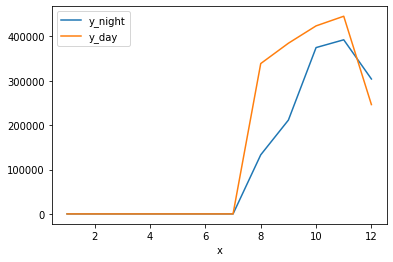

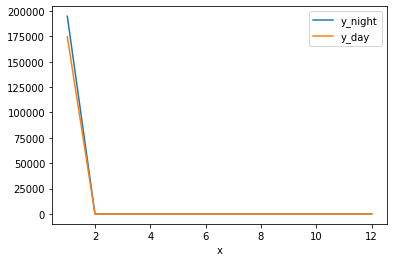

1 month
january nigth
196353.93191517793 january total distance at nigth
174581.88048629076 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
196353.93191517793
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
174581.88048629076
0
0
0
0
0
0
0
0
0
0
0


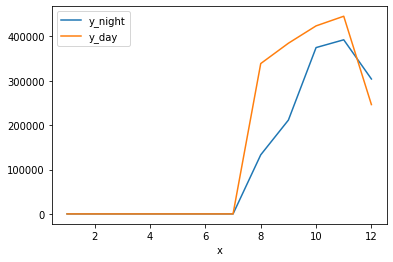

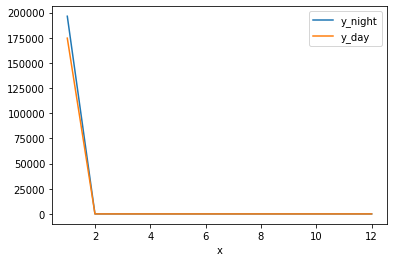

1 month
january nigth
197008.1383441229 january total distance at nigth
174581.88048629076 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
197008.1383441229
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
174581.88048629076
0
0
0
0
0
0
0
0
0
0
0


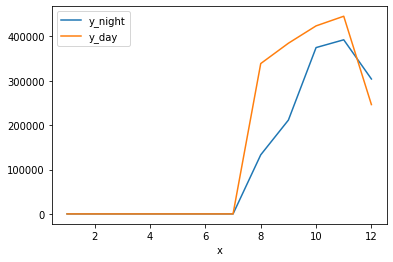

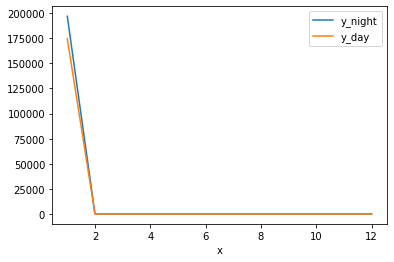

1 month
january nigth
197647.23607501353 january total distance at nigth
174581.88048629076 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
197647.23607501353
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
174581.88048629076
0
0
0
0
0
0
0
0
0
0
0


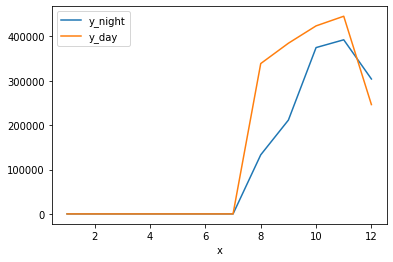

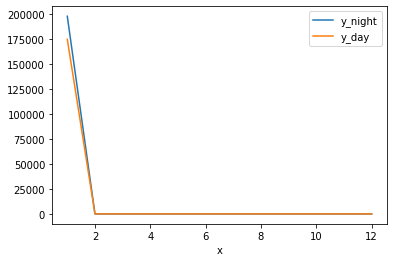

1 month
january nigth
198198.30706331658 january total distance at nigth
174581.88048629076 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
198198.30706331658
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
174581.88048629076
0
0
0
0
0
0
0
0
0
0
0


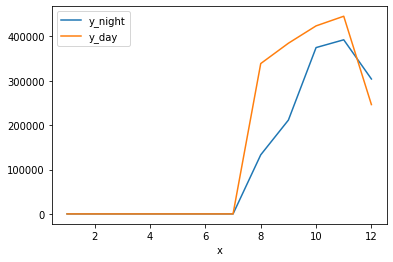

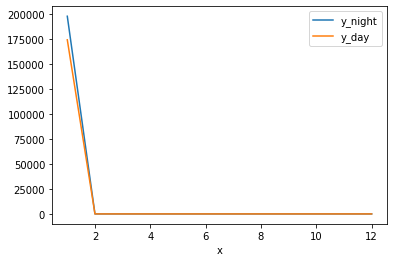

1 month
january nigth
198538.05170770024 january total distance at nigth
174581.88048629076 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
198538.05170770024
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
174581.88048629076
0
0
0
0
0
0
0
0
0
0
0


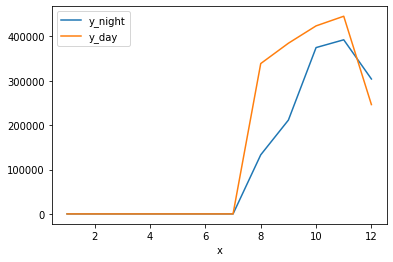

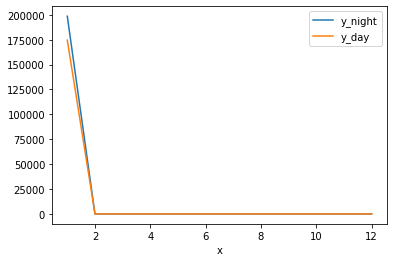

1 month
january nigth
199913.92546490143 january total distance at nigth
174581.88048629076 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
199913.92546490143
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
174581.88048629076
0
0
0
0
0
0
0
0
0
0
0


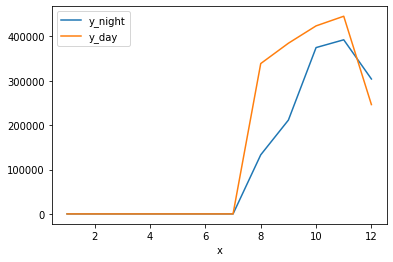

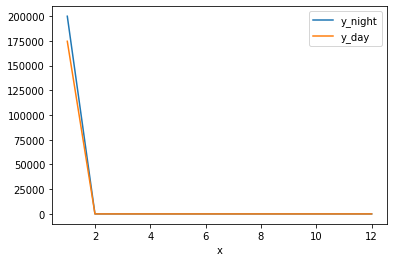

1 month
january nigth
200982.40018516363 january total distance at nigth
174581.88048629076 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
200982.40018516363
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
174581.88048629076
0
0
0
0
0
0
0
0
0
0
0


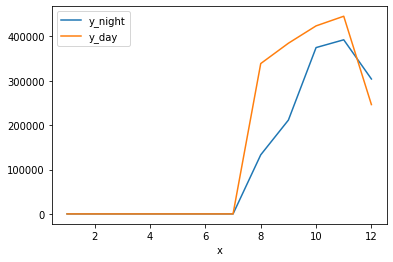

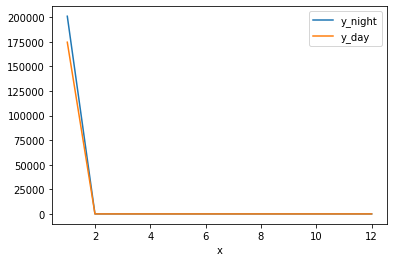

1 month
january nigth
201382.20315432767 january total distance at nigth
174581.88048629076 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201382.20315432767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
174581.88048629076
0
0
0
0
0
0
0
0
0
0
0


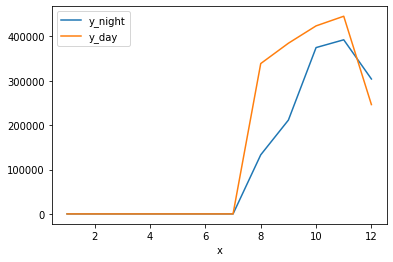

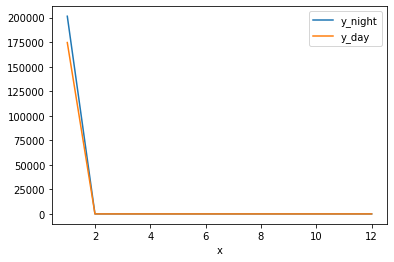

1 month
january day
201382.20315432767 january total distance at nigth
175085.14100185127 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201382.20315432767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
175085.14100185127
0
0
0
0
0
0
0
0
0
0
0


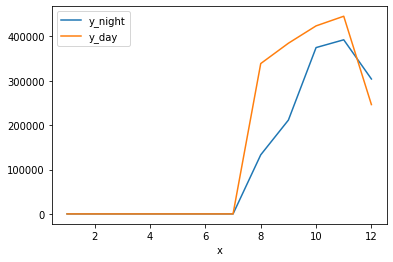

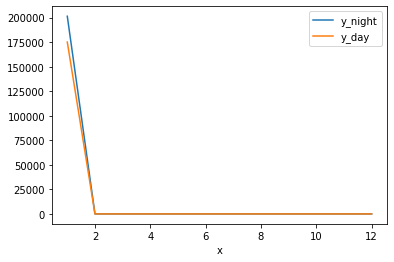

1 month
january day
201382.20315432767 january total distance at nigth
175388.95305202686 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201382.20315432767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
175388.95305202686
0
0
0
0
0
0
0
0
0
0
0


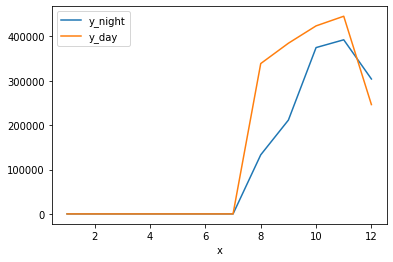

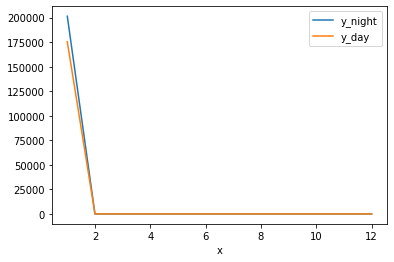

1 month
january day
201382.20315432767 january total distance at nigth
175964.27752861945 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201382.20315432767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
175964.27752861945
0
0
0
0
0
0
0
0
0
0
0


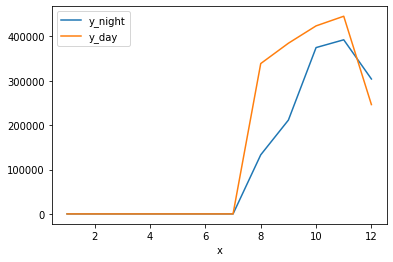

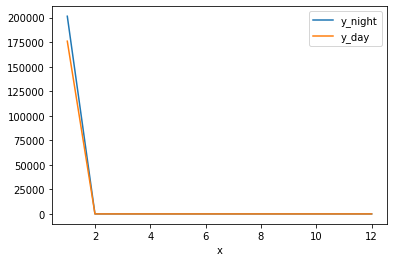

1 month
january day
201382.20315432767 january total distance at nigth
176243.81611636825 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201382.20315432767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
176243.81611636825
0
0
0
0
0
0
0
0
0
0
0


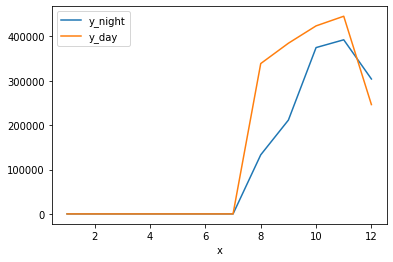

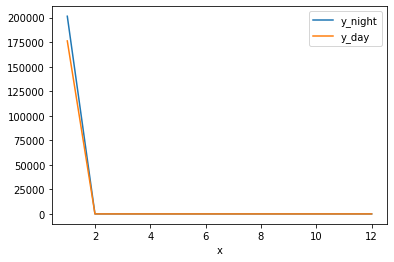

1 month
january day
201382.20315432767 january total distance at nigth
176813.77420162992 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201382.20315432767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
176813.77420162992
0
0
0
0
0
0
0
0
0
0
0


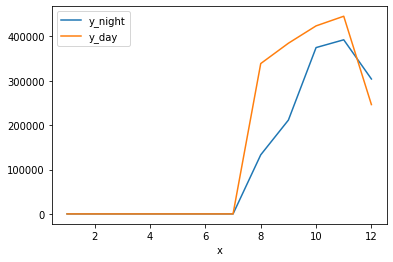

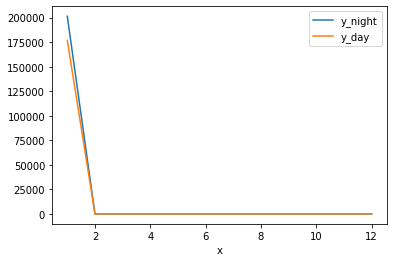

1 month
january day
201382.20315432767 january total distance at nigth
177404.36023295618 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201382.20315432767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
177404.36023295618
0
0
0
0
0
0
0
0
0
0
0


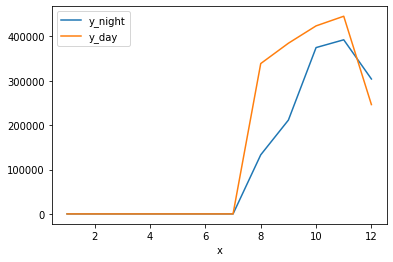

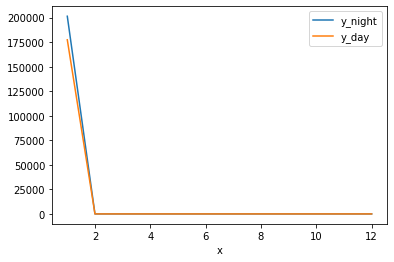

1 month
january day
201382.20315432767 january total distance at nigth
177974.42289494595 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201382.20315432767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
177974.42289494595
0
0
0
0
0
0
0
0
0
0
0


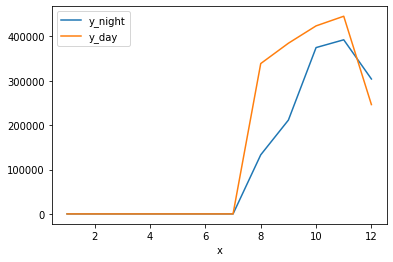

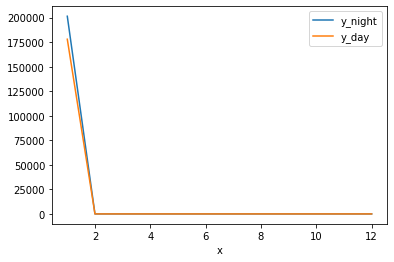

1 month
january day
201382.20315432767 january total distance at nigth
178543.49379698493 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201382.20315432767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
178543.49379698493
0
0
0
0
0
0
0
0
0
0
0


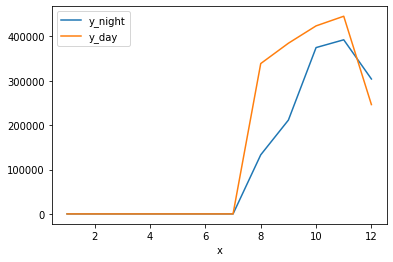

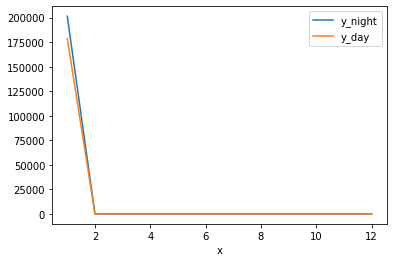

1 month
january day
201382.20315432767 january total distance at nigth
179059.7720112434 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201382.20315432767
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
179059.7720112434
0
0
0
0
0
0
0
0
0
0
0


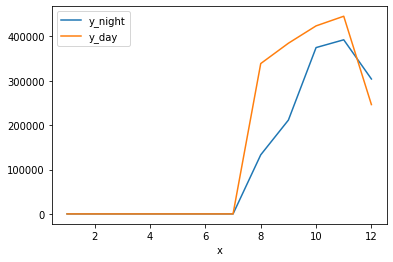

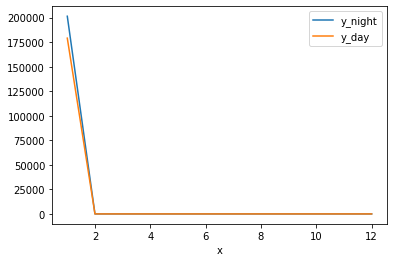

1 month
january nigth
201955.44127503215 january total distance at nigth
179059.7720112434 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
201955.44127503215
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
179059.7720112434
0
0
0
0
0
0
0
0
0
0
0


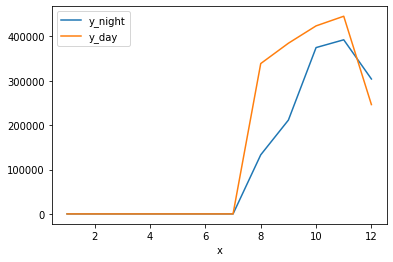

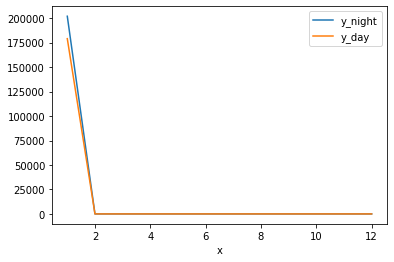

1 month
january nigth
202666.42247621014 january total distance at nigth
179059.7720112434 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
202666.42247621014
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
179059.7720112434
0
0
0
0
0
0
0
0
0
0
0


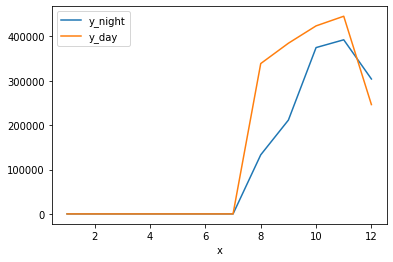

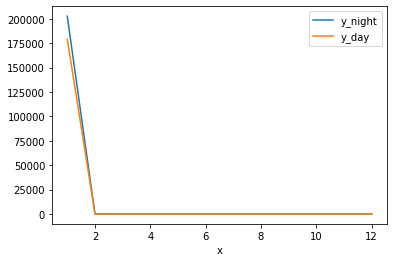

1 month
january nigth
203456.37958027728 january total distance at nigth
179059.7720112434 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
203456.37958027728
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
179059.7720112434
0
0
0
0
0
0
0
0
0
0
0


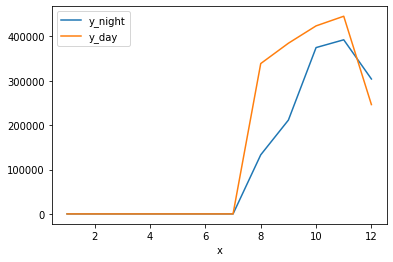

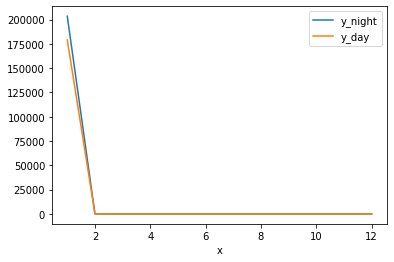

1 month
january nigth
203680.09042347278 january total distance at nigth
179059.7720112434 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
203680.09042347278
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
179059.7720112434
0
0
0
0
0
0
0
0
0
0
0


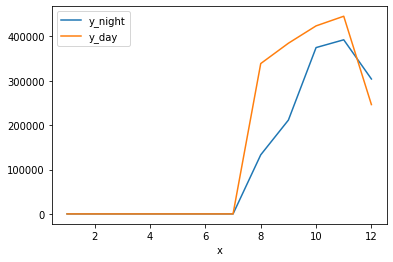

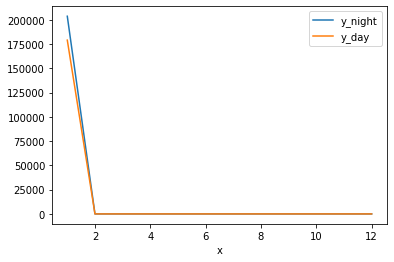

1 month
january day
203680.09042347278 january total distance at nigth
180001.04578031795 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
203680.09042347278
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
180001.04578031795
0
0
0
0
0
0
0
0
0
0
0


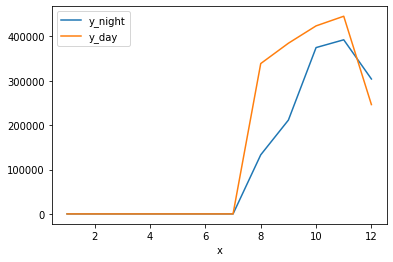

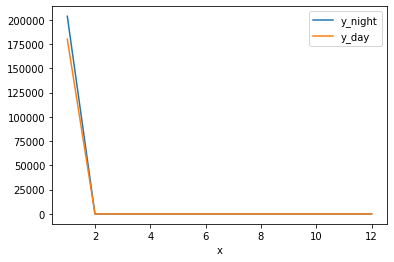

1 month
january day
203680.09042347278 january total distance at nigth
181501.19666874 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
203680.09042347278
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
181501.19666874
0
0
0
0
0
0
0
0
0
0
0


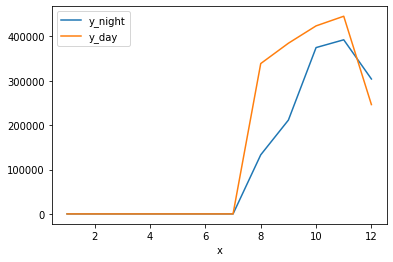

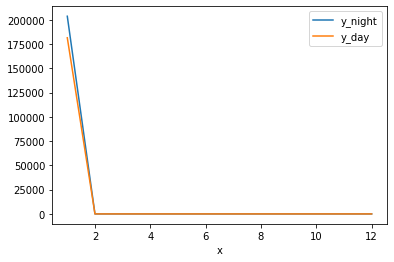

1 month
january day
203680.09042347278 january total distance at nigth
182370.55079939152 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
203680.09042347278
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
182370.55079939152
0
0
0
0
0
0
0
0
0
0
0


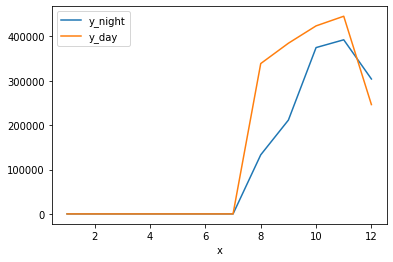

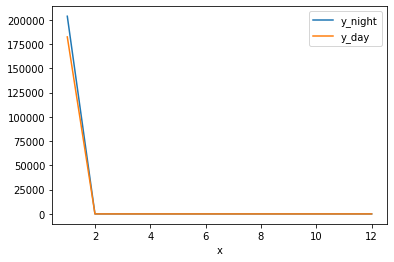

1 month
january day
203680.09042347278 january total distance at nigth
183115.62203183392 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
203680.09042347278
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
183115.62203183392
0
0
0
0
0
0
0
0
0
0
0


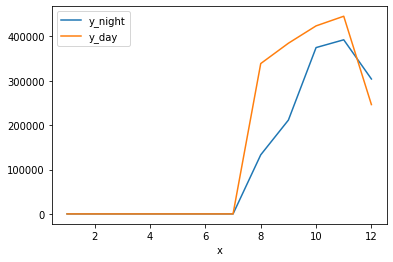

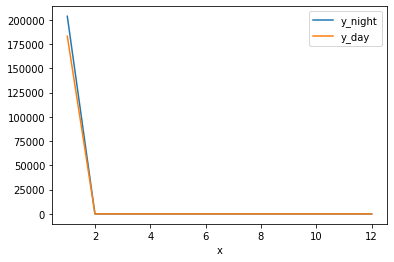

1 month
january nigth
204479.00251079098 january total distance at nigth
183115.62203183392 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
204479.00251079098
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
183115.62203183392
0
0
0
0
0
0
0
0
0
0
0


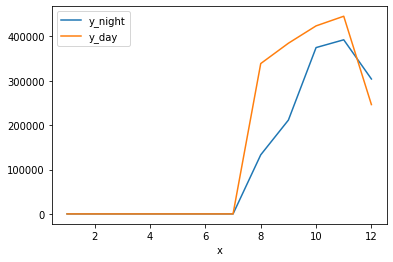

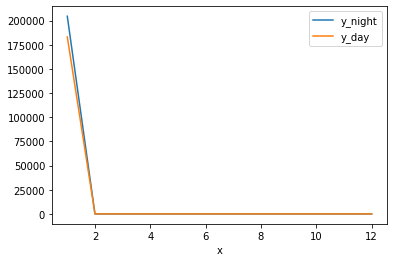

1 month
january nigth
205491.86432262842 january total distance at nigth
183115.62203183392 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
205491.86432262842
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
183115.62203183392
0
0
0
0
0
0
0
0
0
0
0


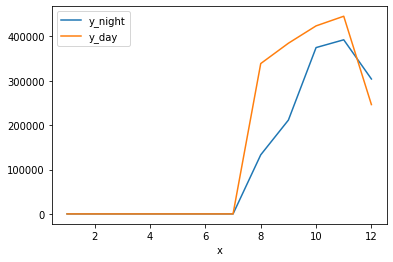

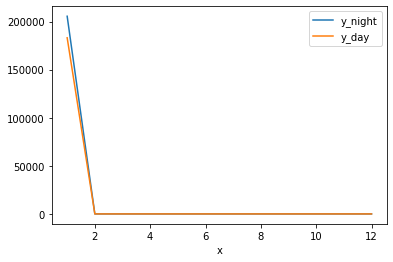

1 month
january nigth
205586.43937935715 january total distance at nigth
183115.62203183392 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
205586.43937935715
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
183115.62203183392
0
0
0
0
0
0
0
0
0
0
0


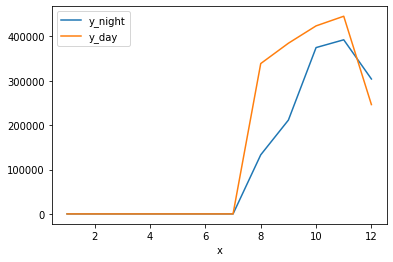

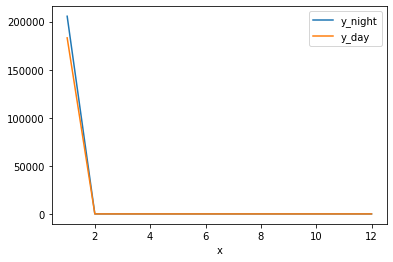

1 month
january nigth
206312.52199912549 january total distance at nigth
183115.62203183392 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
206312.52199912549
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
183115.62203183392
0
0
0
0
0
0
0
0
0
0
0


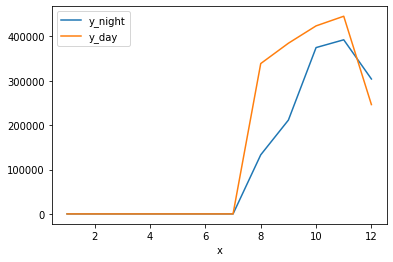

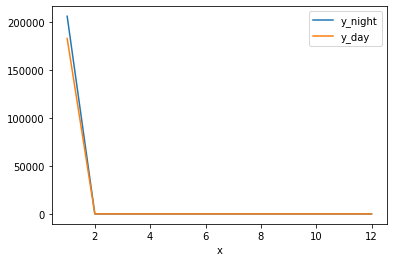

1 month
january day
206312.52199912549 january total distance at nigth
183685.83803893358 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
206312.52199912549
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
183685.83803893358
0
0
0
0
0
0
0
0
0
0
0


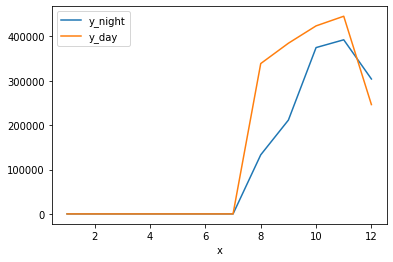

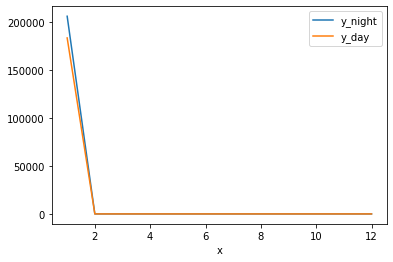

1 month
january day
206312.52199912549 january total distance at nigth
183730.78453787265 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
206312.52199912549
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
183730.78453787265
0
0
0
0
0
0
0
0
0
0
0


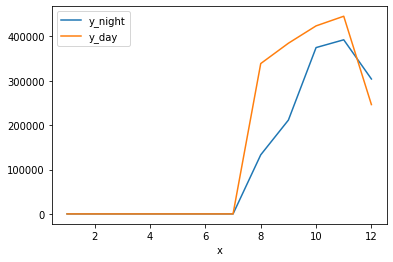

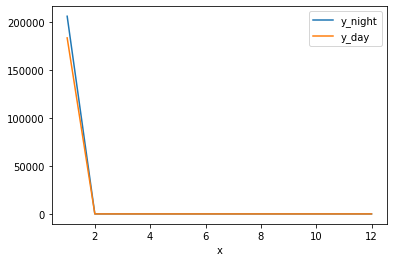

1 month
january nigth
208254.00254217826 january total distance at nigth
183730.78453787265 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
208254.00254217826
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
183730.78453787265
0
0
0
0
0
0
0
0
0
0
0


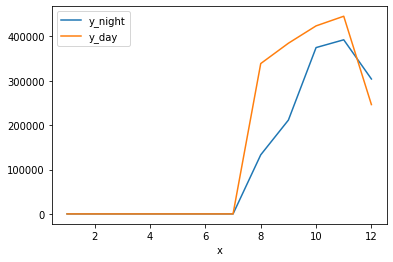

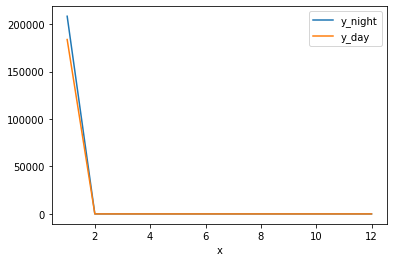

1 month
january nigth
210836.1574682056 january total distance at nigth
183730.78453787265 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
210836.1574682056
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
183730.78453787265
0
0
0
0
0
0
0
0
0
0
0


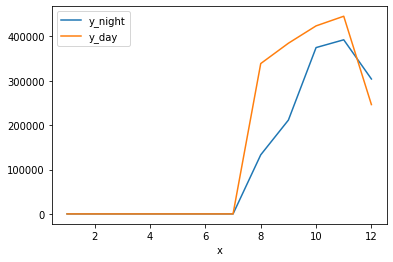

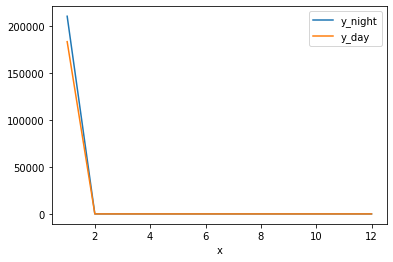

1 month
january day
210836.1574682056 january total distance at nigth
185579.08360345158 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
210836.1574682056
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
185579.08360345158
0
0
0
0
0
0
0
0
0
0
0


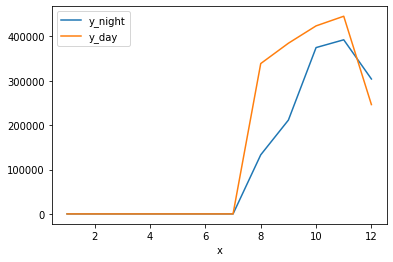

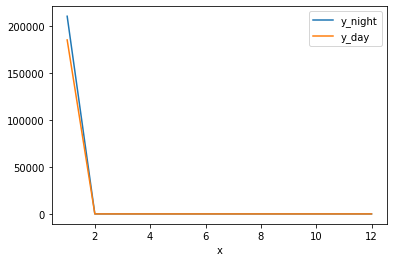

1 month
january day
210836.1574682056 january total distance at nigth
186493.4670898496 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
210836.1574682056
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
186493.4670898496
0
0
0
0
0
0
0
0
0
0
0


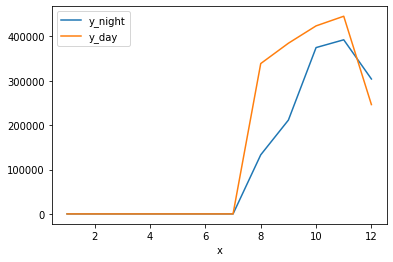

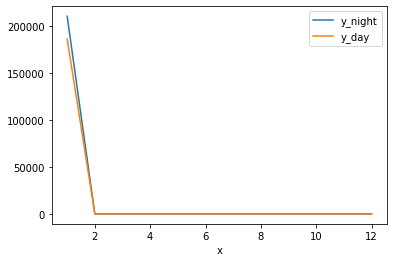

1 month
january day
210836.1574682056 january total distance at nigth
187925.12432382733 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
210836.1574682056
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
187925.12432382733
0
0
0
0
0
0
0
0
0
0
0


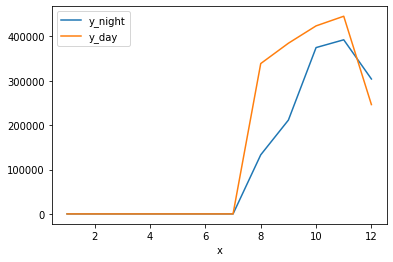

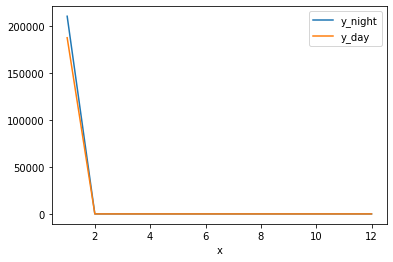

1 month
january nigth
213261.9797224696 january total distance at nigth
187925.12432382733 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
213261.9797224696
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
187925.12432382733
0
0
0
0
0
0
0
0
0
0
0


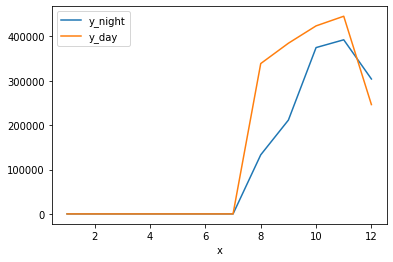

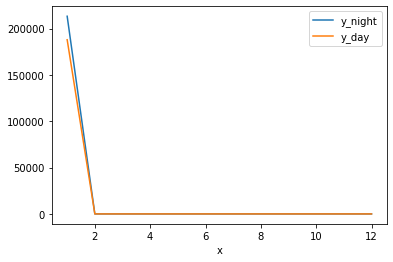

1 month
january nigth
213349.56611147555 january total distance at nigth
187925.12432382733 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
213349.56611147555
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
187925.12432382733
0
0
0
0
0
0
0
0
0
0
0


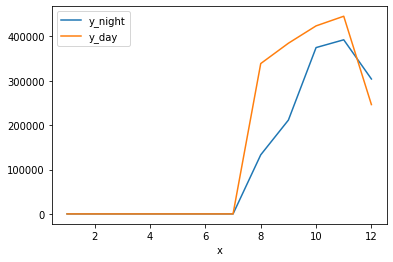

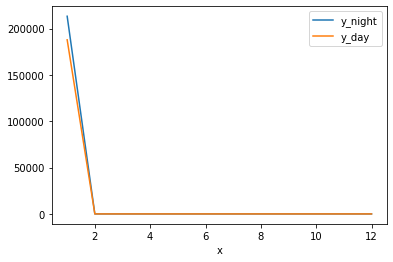

1 month
january nigth
214189.42641696386 january total distance at nigth
187925.12432382733 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
214189.42641696386
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
187925.12432382733
0
0
0
0
0
0
0
0
0
0
0


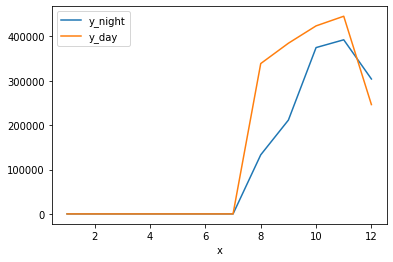

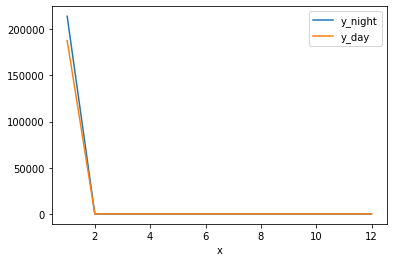

1 month
january nigth
214518.1832816979 january total distance at nigth
187925.12432382733 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
214518.1832816979
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
187925.12432382733
0
0
0
0
0
0
0
0
0
0
0


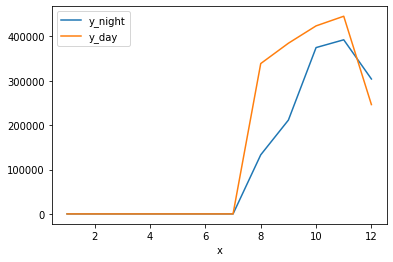

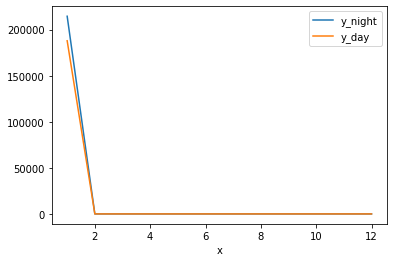

1 month
january day
214518.1832816979 january total distance at nigth
188231.3848229954 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
214518.1832816979
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
188231.3848229954
0
0
0
0
0
0
0
0
0
0
0


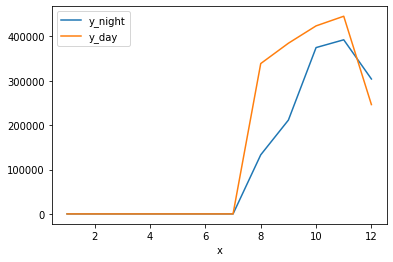

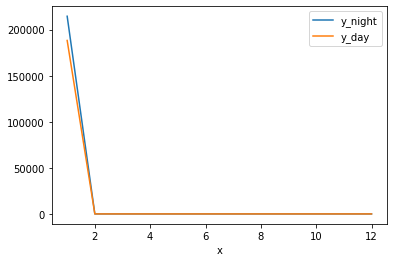

1 month
january day
214518.1832816979 january total distance at nigth
188460.30005458358 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
214518.1832816979
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
188460.30005458358
0
0
0
0
0
0
0
0
0
0
0


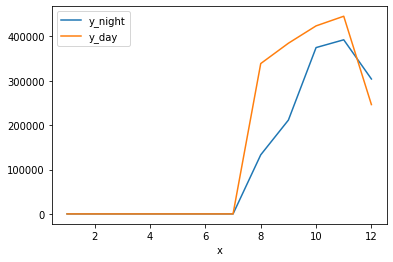

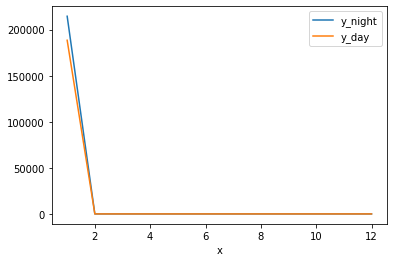

1 month
january day
214518.1832816979 january total distance at nigth
188736.44899915153 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
214518.1832816979
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
188736.44899915153
0
0
0
0
0
0
0
0
0
0
0


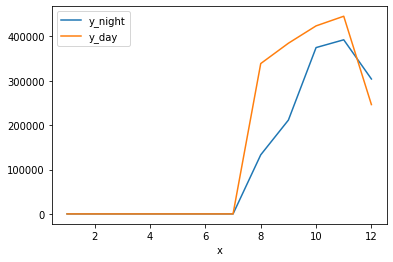

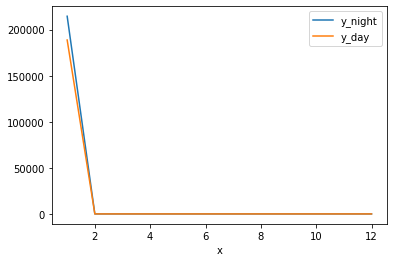

1 month
january day
214518.1832816979 january total distance at nigth
189331.86889808316 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
214518.1832816979
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
189331.86889808316
0
0
0
0
0
0
0
0
0
0
0


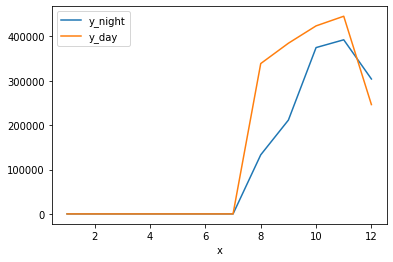

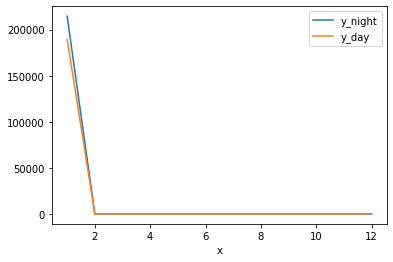

1 month
january day
214518.1832816979 january total distance at nigth
192039.65768393155 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
214518.1832816979
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
192039.65768393155
0
0
0
0
0
0
0
0
0
0
0


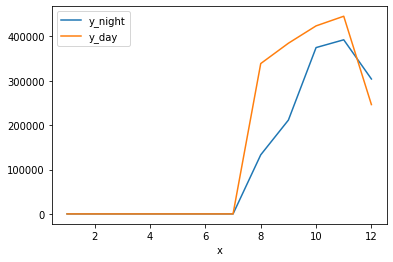

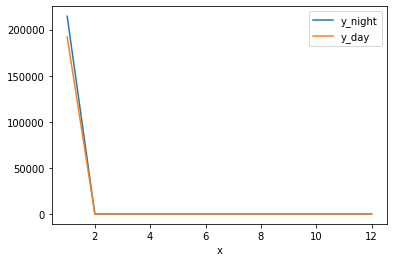

1 month
january nigth
216541.3745642717 january total distance at nigth
192039.65768393155 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
216541.3745642717
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
192039.65768393155
0
0
0
0
0
0
0
0
0
0
0


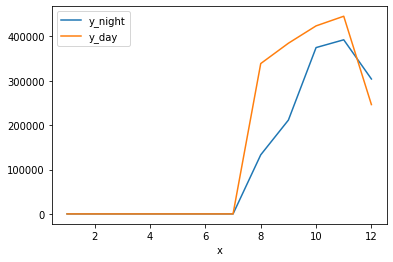

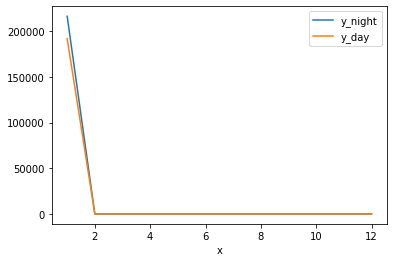

1 month
january nigth
217296.31451564294 january total distance at nigth
192039.65768393155 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
217296.31451564294
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
192039.65768393155
0
0
0
0
0
0
0
0
0
0
0


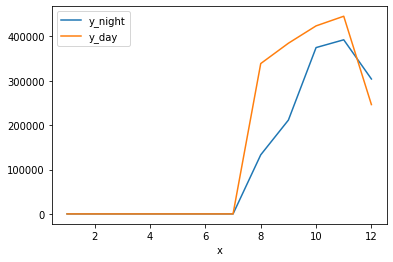

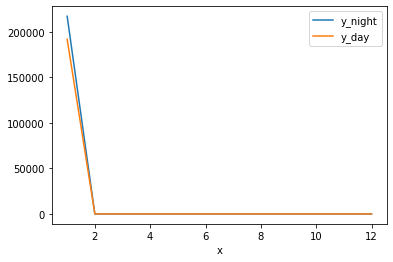

1 month
january nigth
217336.44736854162 january total distance at nigth
192039.65768393155 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
217336.44736854162
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
192039.65768393155
0
0
0
0
0
0
0
0
0
0
0


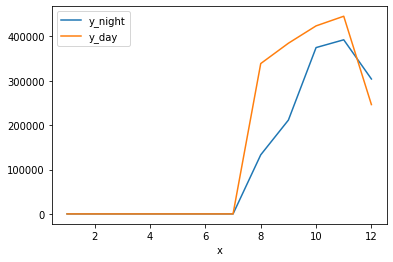

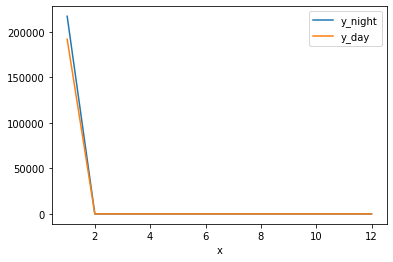

1 month
january nigth
218716.11406548053 january total distance at nigth
192039.65768393155 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
218716.11406548053
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
192039.65768393155
0
0
0
0
0
0
0
0
0
0
0


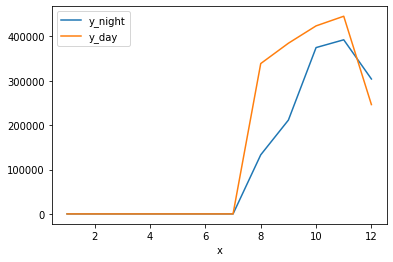

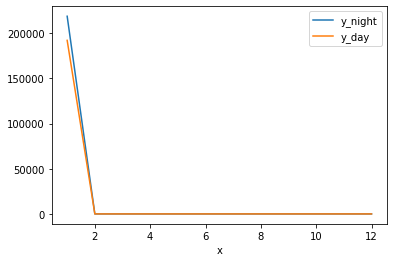

1 month
january day
218716.11406548053 january total distance at nigth
192931.7132681138 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
218716.11406548053
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
192931.7132681138
0
0
0
0
0
0
0
0
0
0
0


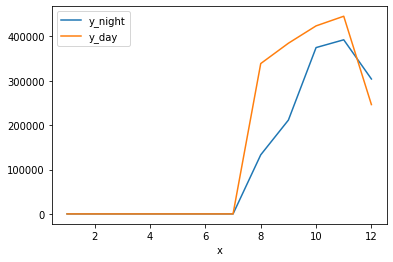

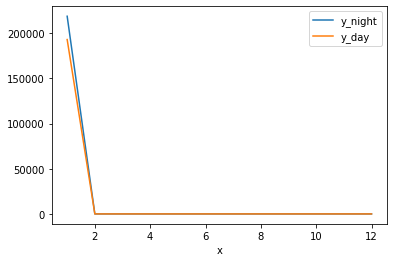

1 month
january day
218716.11406548053 january total distance at nigth
193982.65160464696 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
218716.11406548053
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
193982.65160464696
0
0
0
0
0
0
0
0
0
0
0


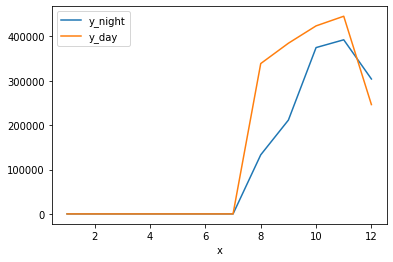

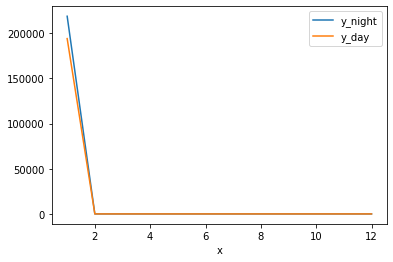

1 month
january nigth
222111.89415701907 january total distance at nigth
193982.65160464696 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
222111.89415701907
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
193982.65160464696
0
0
0
0
0
0
0
0
0
0
0


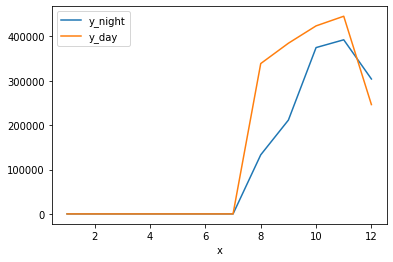

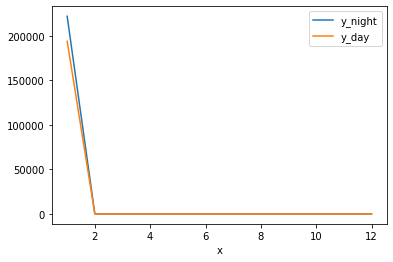

1 month
january nigth
222350.50157453382 january total distance at nigth
193982.65160464696 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
222350.50157453382
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
193982.65160464696
0
0
0
0
0
0
0
0
0
0
0


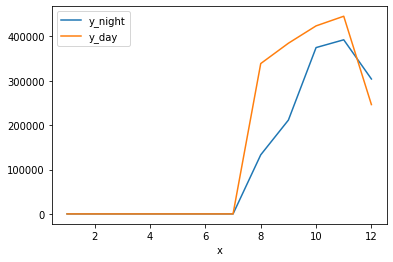

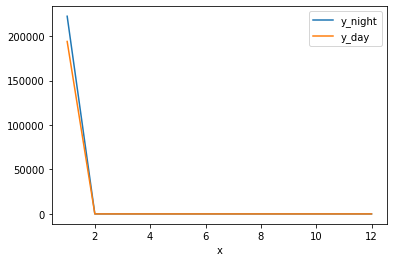

1 month
january nigth
224273.37118323147 january total distance at nigth
193982.65160464696 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
224273.37118323147
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
193982.65160464696
0
0
0
0
0
0
0
0
0
0
0


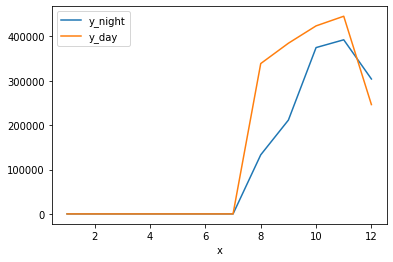

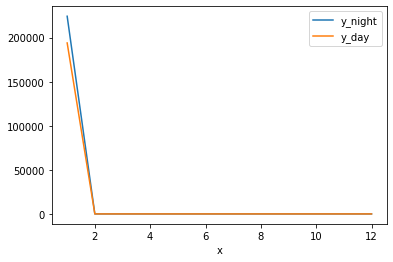

1 month
january day
224273.37118323147 january total distance at nigth
195901.15083746932 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
224273.37118323147
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
195901.15083746932
0
0
0
0
0
0
0
0
0
0
0


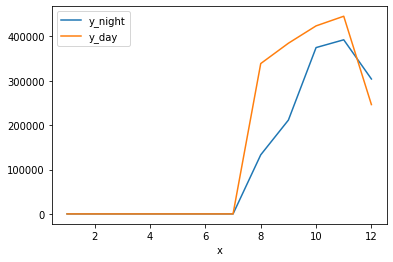

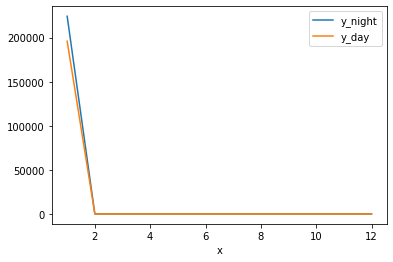

1 month
january day
224273.37118323147 january total distance at nigth
195932.2878142318 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
224273.37118323147
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
195932.2878142318
0
0
0
0
0
0
0
0
0
0
0


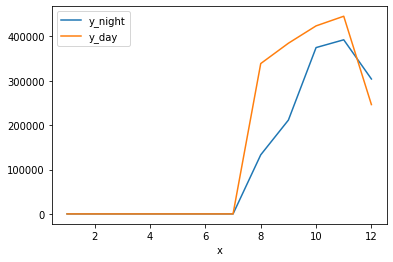

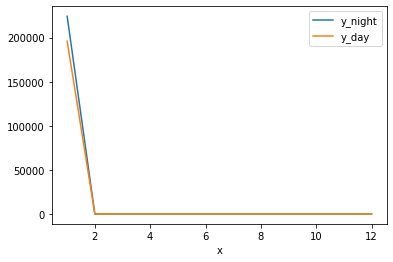

1 month
january day
224273.37118323147 january total distance at nigth
198209.7900641756 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
224273.37118323147
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198209.7900641756
0
0
0
0
0
0
0
0
0
0
0


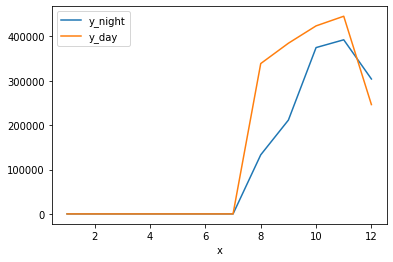

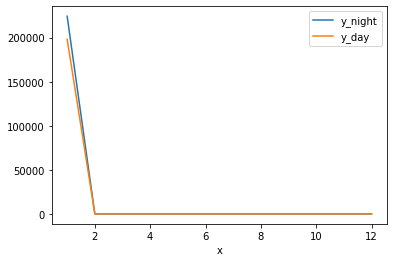

1 month
january day
224273.37118323147 january total distance at nigth
198433.71737991253 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
224273.37118323147
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
0
0
0
0
0
0
0
0
0
0
0


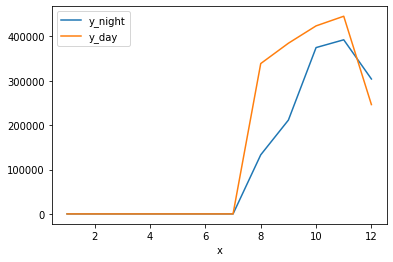

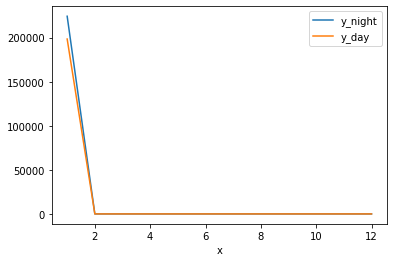

1 month
january nigth
226249.87633906695 january total distance at nigth
198433.71737991253 january total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
0
0
0
0
0
0
0
0
0
0
0


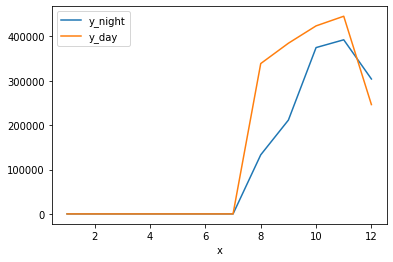

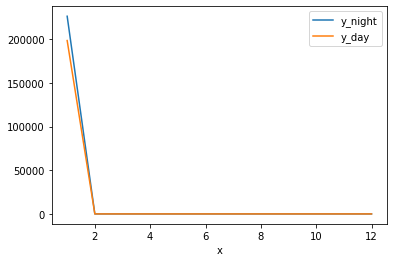

2 month
february day
0 february total distance at nigth
3829.761006139942 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
3829.761006139942
0
0
0
0
0
0
0
0
0
0


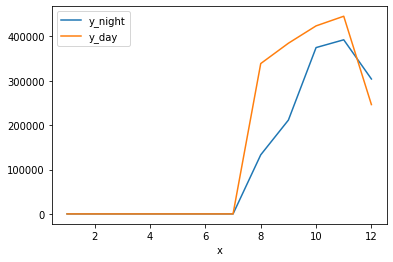

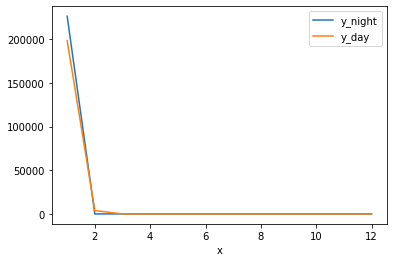

2 month
february day
0 february total distance at nigth
4437.866460707206 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
4437.866460707206
0
0
0
0
0
0
0
0
0
0


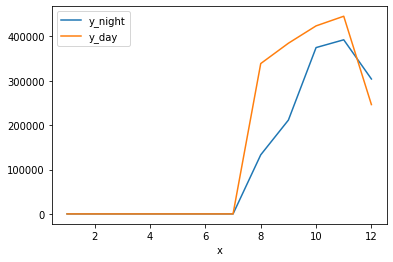

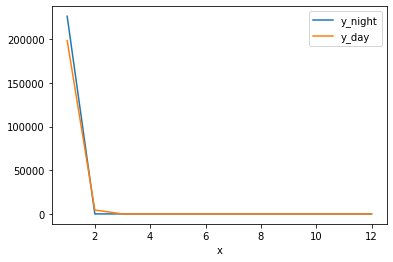

2 month
february day
0 february total distance at nigth
8486.546996114603 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
8486.546996114603
0
0
0
0
0
0
0
0
0
0


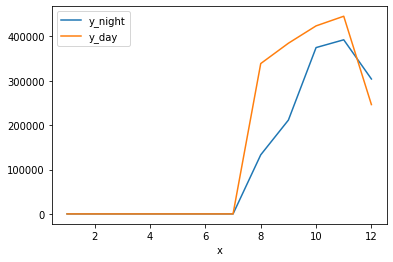

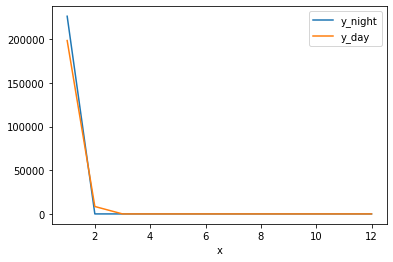

2 month
february day
0 february total distance at nigth
10163.355503633305 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
10163.355503633305
0
0
0
0
0
0
0
0
0
0


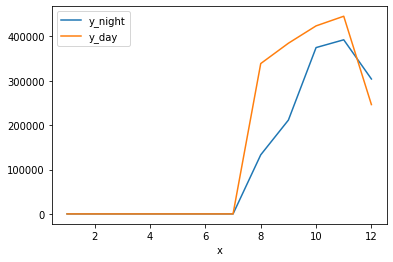

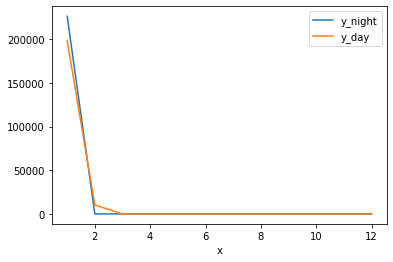

2 month
february nigth
1681.8656886090957 february total distance at nigth
10163.355503633305 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
1681.8656886090957
1681.8656886090957
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
10163.355503633305
0
0
0
0
0
0
0
0
0
0


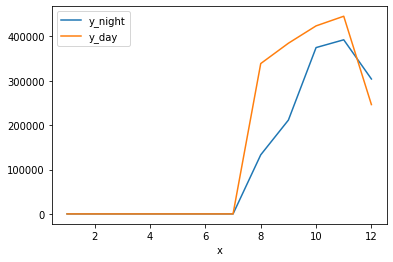

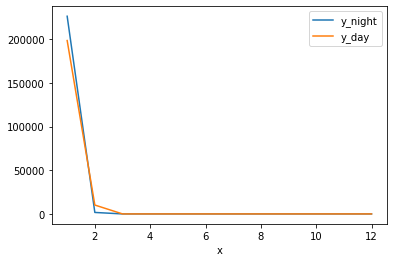

2 month
february nigth
3525.688950740707 february total distance at nigth
10163.355503633305 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
3525.688950740707
3525.688950740707
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
10163.355503633305
0
0
0
0
0
0
0
0
0
0


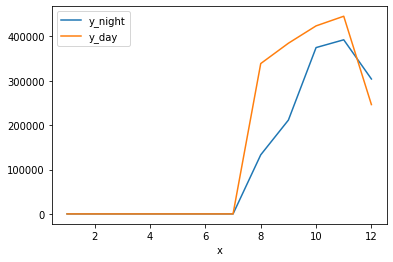

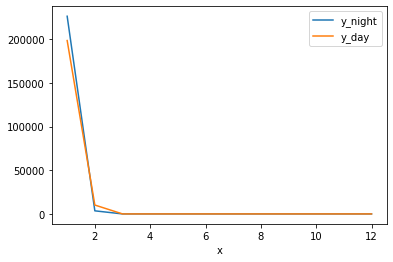

2 month
february nigth
4219.197336534768 february total distance at nigth
10163.355503633305 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
4219.197336534768
4219.197336534768
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
10163.355503633305
0
0
0
0
0
0
0
0
0
0


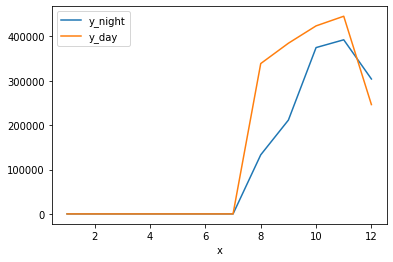

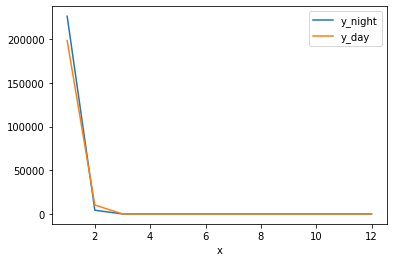

2 month
february nigth
4409.193100301742 february total distance at nigth
10163.355503633305 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
4409.193100301742
4409.193100301742
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
10163.355503633305
0
0
0
0
0
0
0
0
0
0


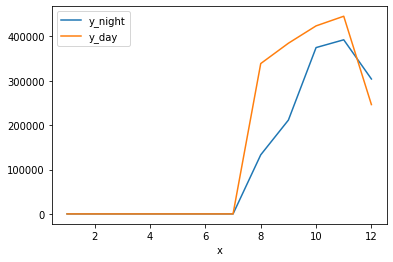

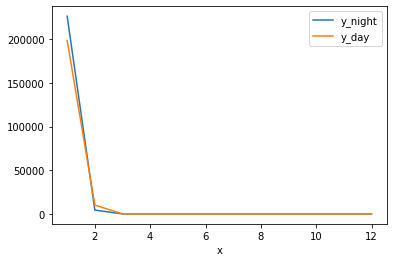

2 month
february nigth
6120.640796167863 february total distance at nigth
10163.355503633305 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
6120.640796167863
6120.640796167863
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
10163.355503633305
0
0
0
0
0
0
0
0
0
0


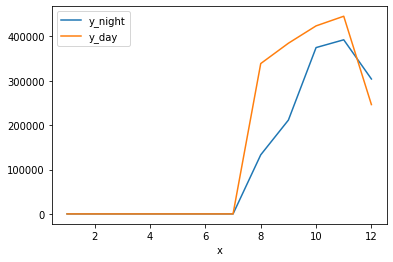

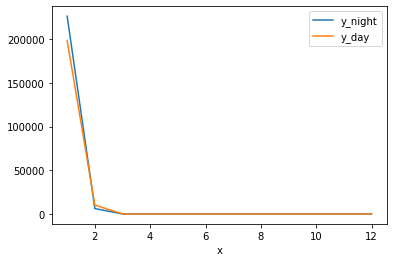

2 month
february nigth
6137.467126287691 february total distance at nigth
10163.355503633305 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
6137.467126287691
6137.467126287691
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
10163.355503633305
0
0
0
0
0
0
0
0
0
0


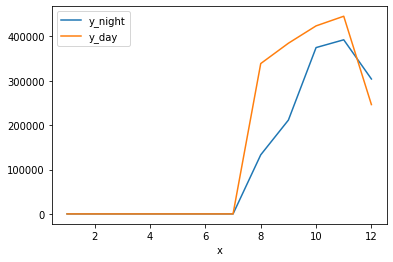

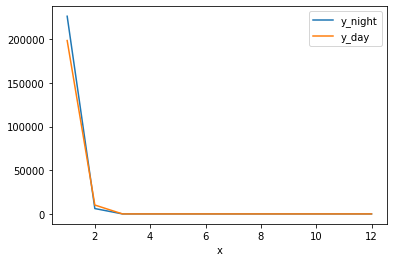

2 month
february day
6137.467126287691 february total distance at nigth
11730.73258559158 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
6137.467126287691
6137.467126287691
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
11730.73258559158
0
0
0
0
0
0
0
0
0
0


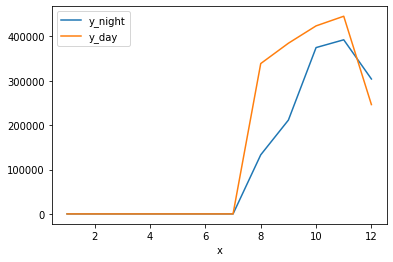

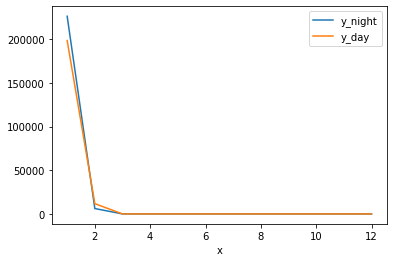

2 month
february day
6137.467126287691 february total distance at nigth
12571.755483847808 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
6137.467126287691
6137.467126287691
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
12571.755483847808
0
0
0
0
0
0
0
0
0
0


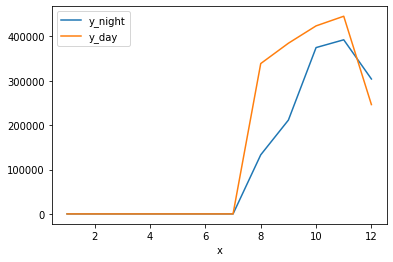

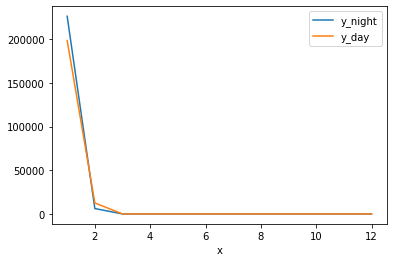

2 month
february day
6137.467126287691 february total distance at nigth
13218.490600291478 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
6137.467126287691
6137.467126287691
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
13218.490600291478
0
0
0
0
0
0
0
0
0
0


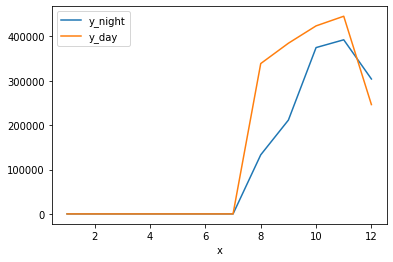

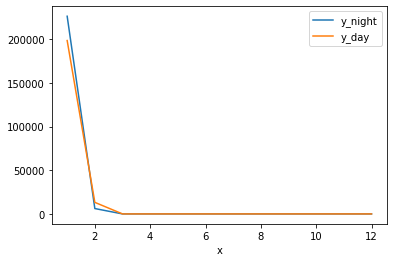

2 month
february day
6137.467126287691 february total distance at nigth
14674.077834290527 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
6137.467126287691
6137.467126287691
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
14674.077834290527
0
0
0
0
0
0
0
0
0
0


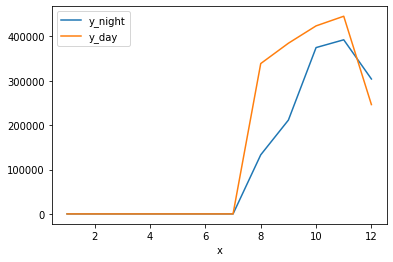

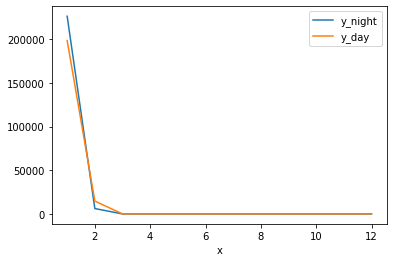

2 month
february day
6137.467126287691 february total distance at nigth
16582.40446307761 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
6137.467126287691
6137.467126287691
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
16582.40446307761
0
0
0
0
0
0
0
0
0
0


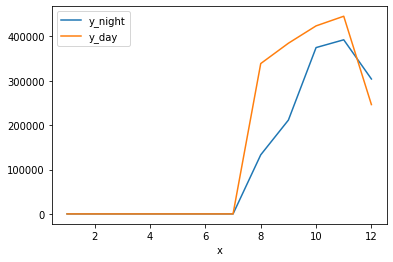

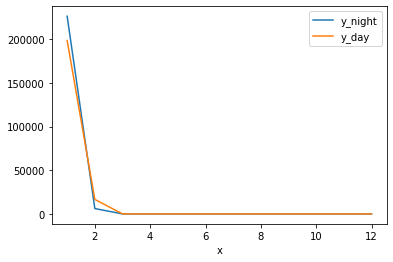

2 month
february day
6137.467126287691 february total distance at nigth
18483.920563196865 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
6137.467126287691
6137.467126287691
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
18483.920563196865
0
0
0
0
0
0
0
0
0
0


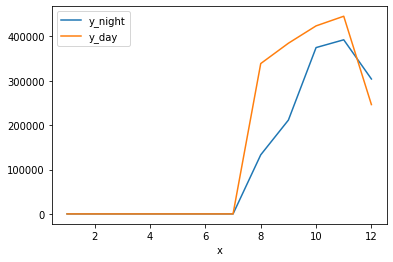

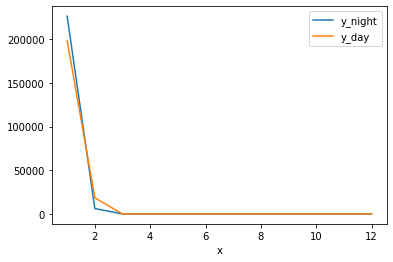

2 month
february nigth
8599.20657169239 february total distance at nigth
18483.920563196865 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
8599.20657169239
8599.20657169239
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
18483.920563196865
0
0
0
0
0
0
0
0
0
0


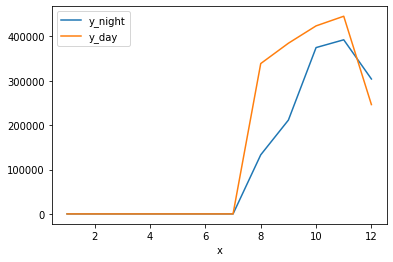

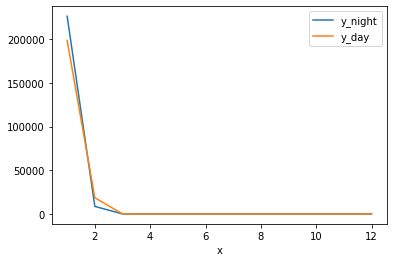

2 month
february nigth
9558.618256077509 february total distance at nigth
18483.920563196865 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
9558.618256077509
9558.618256077509
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
18483.920563196865
0
0
0
0
0
0
0
0
0
0


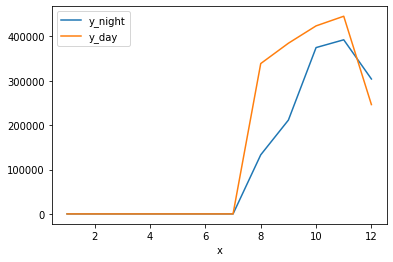

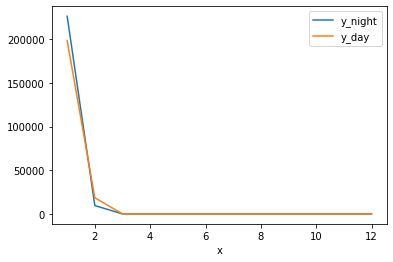

2 month
february nigth
10639.141728945264 february total distance at nigth
18483.920563196865 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
10639.141728945264
10639.141728945264
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
18483.920563196865
0
0
0
0
0
0
0
0
0
0


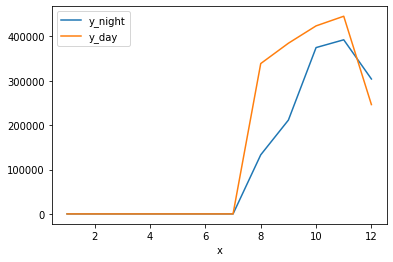

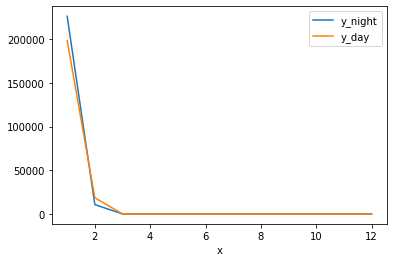

2 month
february day
10639.141728945264 february total distance at nigth
19268.634090910637 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
10639.141728945264
10639.141728945264
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
19268.634090910637
0
0
0
0
0
0
0
0
0
0


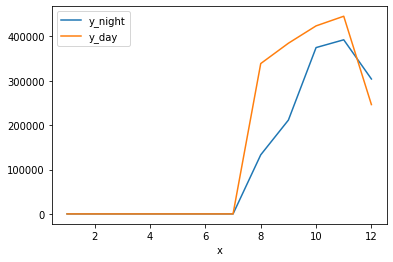

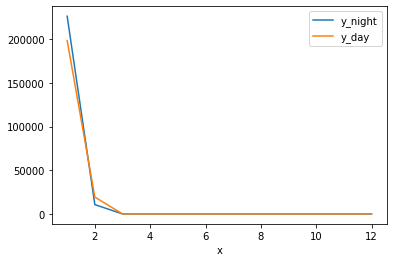

2 month
february day
10639.141728945264 february total distance at nigth
20215.000969200228 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
10639.141728945264
10639.141728945264
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
20215.000969200228
0
0
0
0
0
0
0
0
0
0


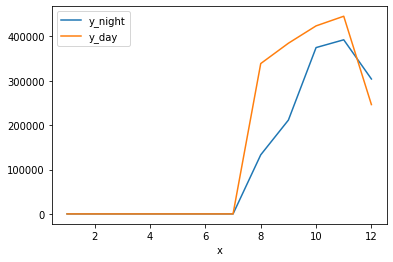

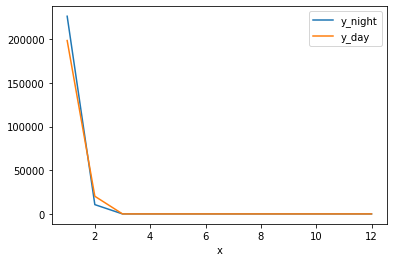

2 month
february day
10639.141728945264 february total distance at nigth
21771.747228923883 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
10639.141728945264
10639.141728945264
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
21771.747228923883
0
0
0
0
0
0
0
0
0
0


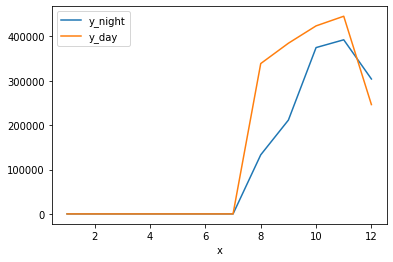

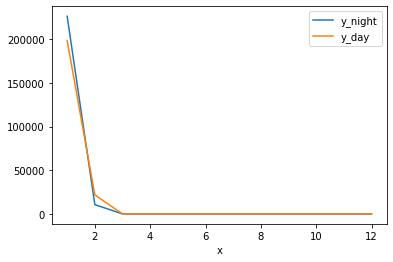

2 month
february day
10639.141728945264 february total distance at nigth
23334.562795765047 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
10639.141728945264
10639.141728945264
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
23334.562795765047
0
0
0
0
0
0
0
0
0
0


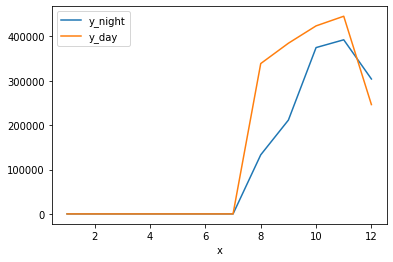

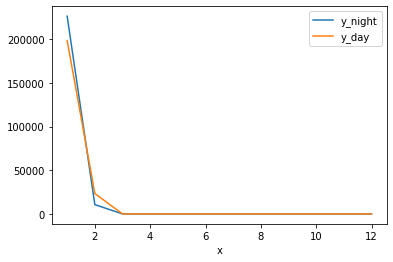

2 month
february day
10639.141728945264 february total distance at nigth
26151.955095793222 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
10639.141728945264
10639.141728945264
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
26151.955095793222
0
0
0
0
0
0
0
0
0
0


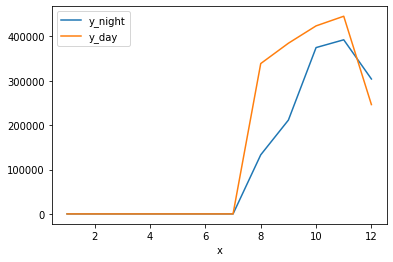

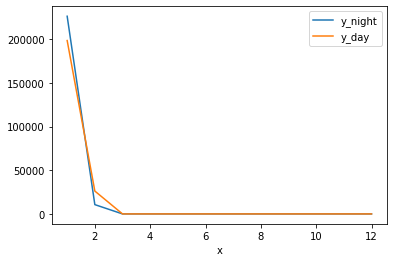

2 month
february nigth
16588.268107948406 february total distance at nigth
26151.955095793222 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
16588.268107948406
16588.268107948406
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
26151.955095793222
0
0
0
0
0
0
0
0
0
0


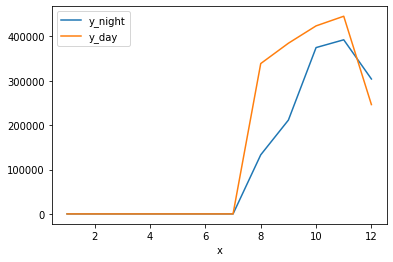

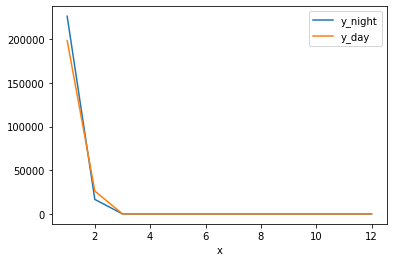

2 month
february nigth
19501.121221122216 february total distance at nigth
26151.955095793222 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
19501.121221122216
19501.121221122216
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
26151.955095793222
0
0
0
0
0
0
0
0
0
0


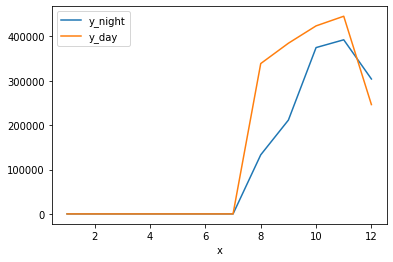

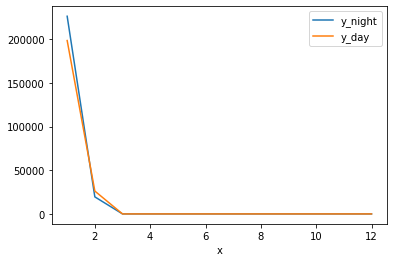

2 month
february nigth
20171.379887006413 february total distance at nigth
26151.955095793222 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
20171.379887006413
20171.379887006413
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
26151.955095793222
0
0
0
0
0
0
0
0
0
0


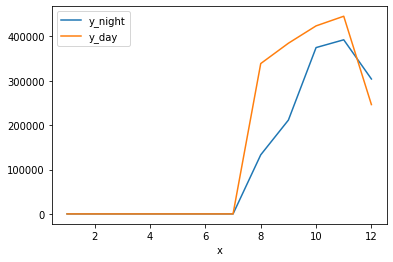

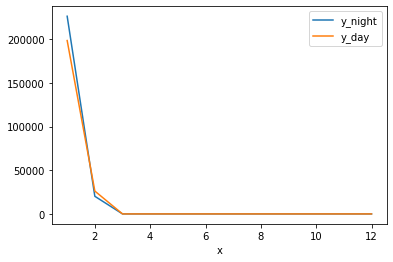

2 month
february nigth
21531.313865252083 february total distance at nigth
26151.955095793222 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
21531.313865252083
21531.313865252083
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
26151.955095793222
0
0
0
0
0
0
0
0
0
0


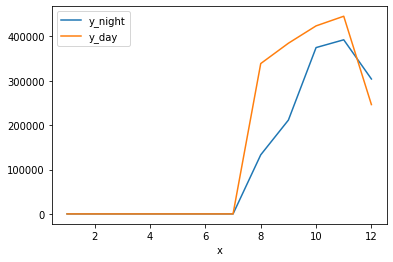

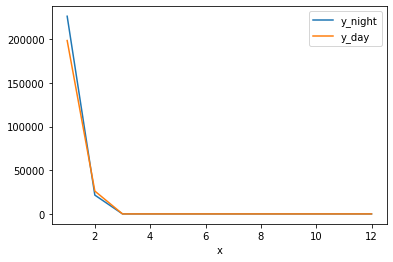

2 month
february nigth
22806.797817124563 february total distance at nigth
26151.955095793222 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
22806.797817124563
22806.797817124563
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
26151.955095793222
0
0
0
0
0
0
0
0
0
0


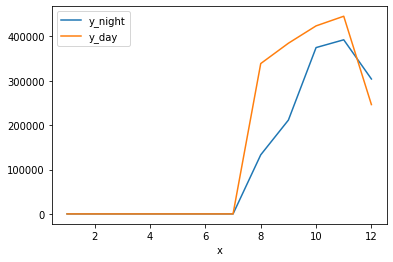

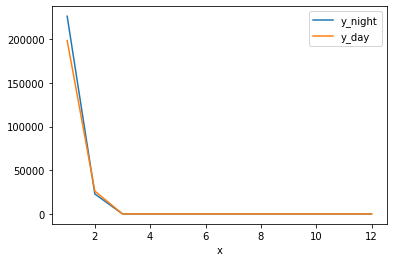

2 month
february nigth
26674.425799626624 february total distance at nigth
26151.955095793222 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
26674.425799626624
26674.425799626624
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
26151.955095793222
0
0
0
0
0
0
0
0
0
0


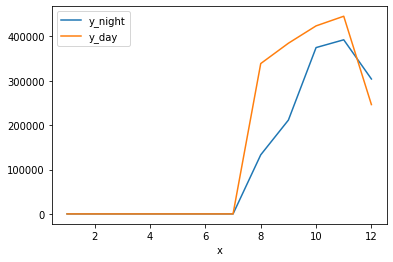

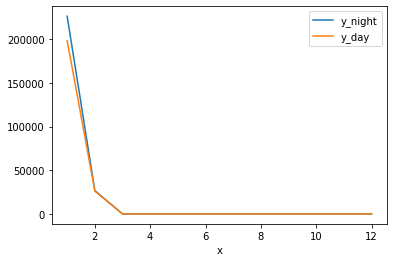

2 month
february day
26674.425799626624 february total distance at nigth
27229.692572361546 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
26674.425799626624
26674.425799626624
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
27229.692572361546
0
0
0
0
0
0
0
0
0
0


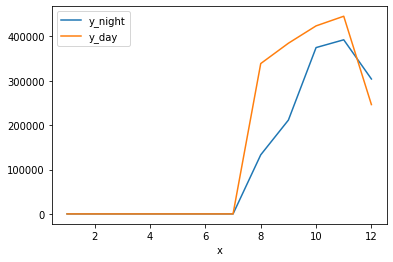

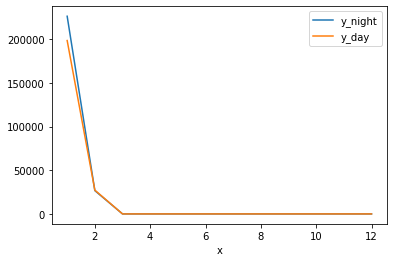

2 month
february day
26674.425799626624 february total distance at nigth
29276.71312512874 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
26674.425799626624
26674.425799626624
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
29276.71312512874
0
0
0
0
0
0
0
0
0
0


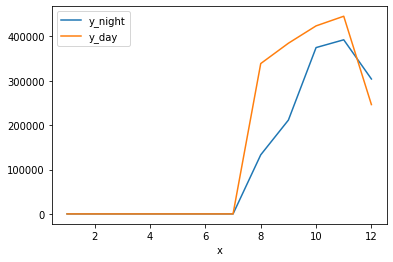

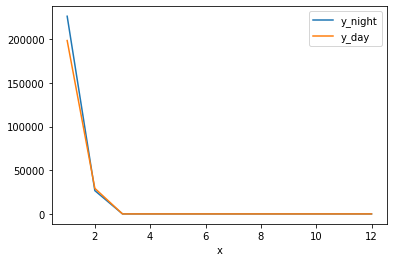

2 month
february day
26674.425799626624 february total distance at nigth
31766.643685283205 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
26674.425799626624
26674.425799626624
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
31766.643685283205
0
0
0
0
0
0
0
0
0
0


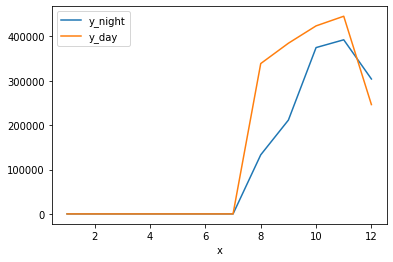

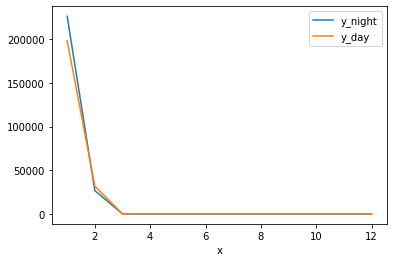

2 month
february day
26674.425799626624 february total distance at nigth
31914.930116470117 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
26674.425799626624
26674.425799626624
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
31914.930116470117
0
0
0
0
0
0
0
0
0
0


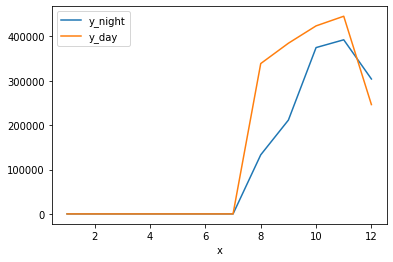

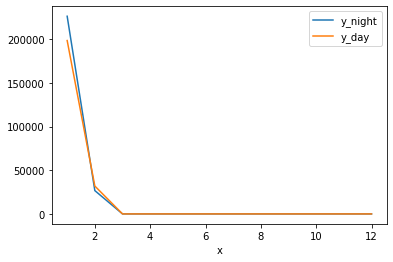

2 month
february day
26674.425799626624 february total distance at nigth
35176.7780842985 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
26674.425799626624
26674.425799626624
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
35176.7780842985
0
0
0
0
0
0
0
0
0
0


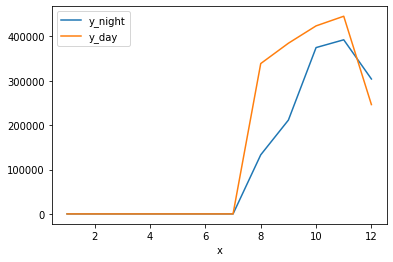

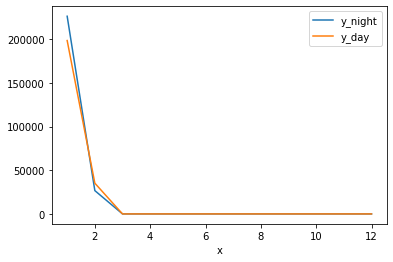

2 month
february nigth
30749.87789332475 february total distance at nigth
35176.7780842985 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
30749.87789332475
30749.87789332475
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
35176.7780842985
0
0
0
0
0
0
0
0
0
0


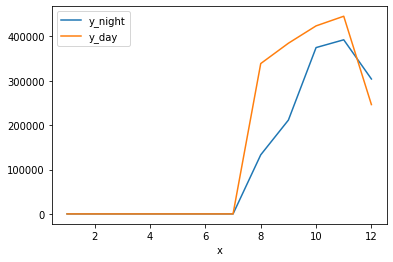

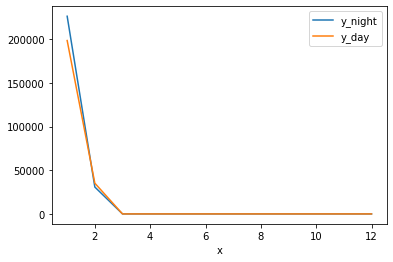

2 month
february nigth
33957.84667793176 february total distance at nigth
35176.7780842985 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
33957.84667793176
33957.84667793176
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
35176.7780842985
0
0
0
0
0
0
0
0
0
0


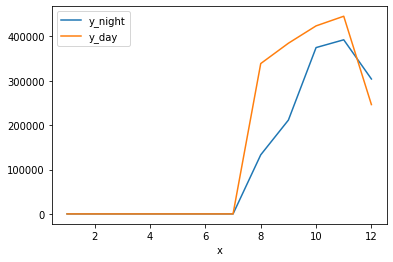

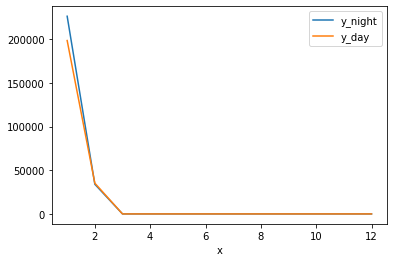

2 month
february nigth
36967.32122231264 february total distance at nigth
35176.7780842985 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
36967.32122231264
36967.32122231264
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
35176.7780842985
0
0
0
0
0
0
0
0
0
0


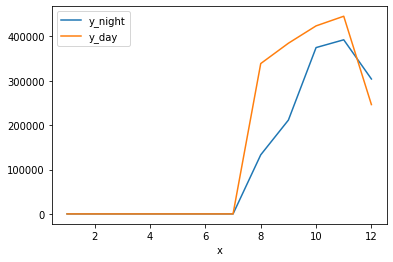

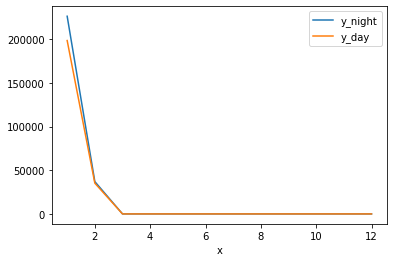

2 month
february nigth
39158.89887778173 february total distance at nigth
35176.7780842985 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
39158.89887778173
39158.89887778173
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
35176.7780842985
0
0
0
0
0
0
0
0
0
0


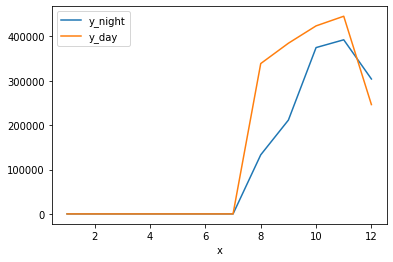

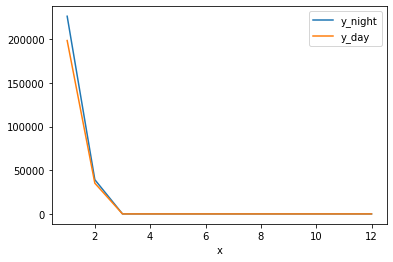

2 month
february day
39158.89887778173 february total distance at nigth
36544.57693364688 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
39158.89887778173
39158.89887778173
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
36544.57693364688
0
0
0
0
0
0
0
0
0
0


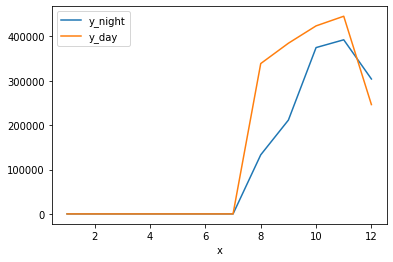

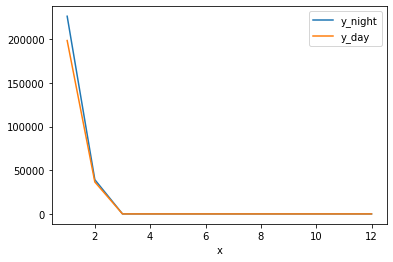

2 month
february day
39158.89887778173 february total distance at nigth
36706.8032436104 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
39158.89887778173
39158.89887778173
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
36706.8032436104
0
0
0
0
0
0
0
0
0
0


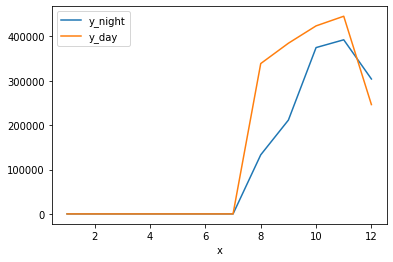

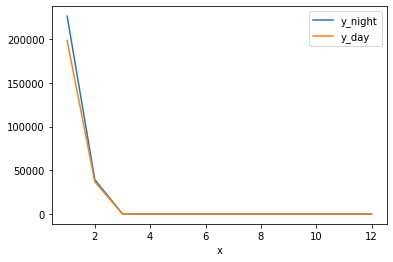

2 month
february day
39158.89887778173 february total distance at nigth
41006.842367597106 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
39158.89887778173
39158.89887778173
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
41006.842367597106
0
0
0
0
0
0
0
0
0
0


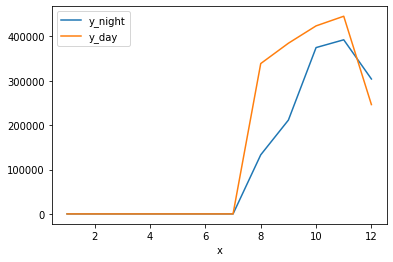

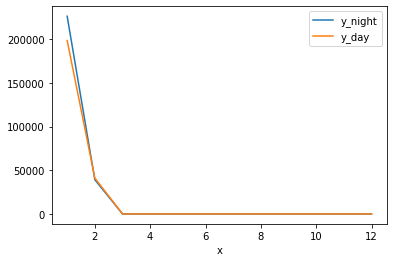

2 month
february day
39158.89887778173 february total distance at nigth
43416.4984170558 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
39158.89887778173
39158.89887778173
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
43416.4984170558
0
0
0
0
0
0
0
0
0
0


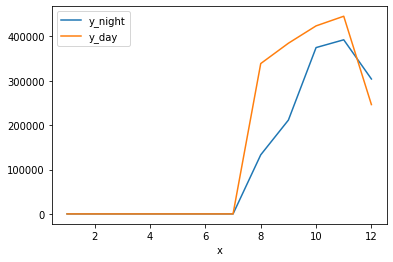

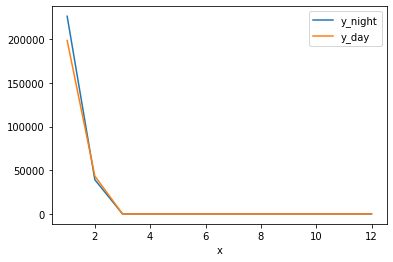

2 month
february day
39158.89887778173 february total distance at nigth
43650.04646936641 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
39158.89887778173
39158.89887778173
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
43650.04646936641
0
0
0
0
0
0
0
0
0
0


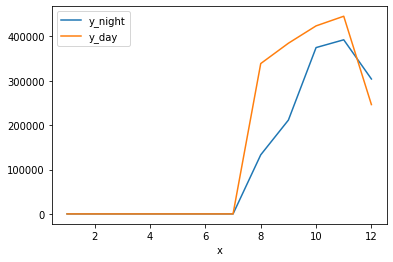

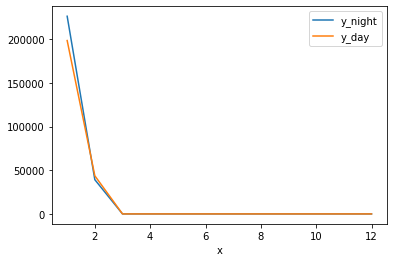

2 month
february nigth
41139.51801547823 february total distance at nigth
43650.04646936641 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
41139.51801547823
41139.51801547823
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
43650.04646936641
0
0
0
0
0
0
0
0
0
0


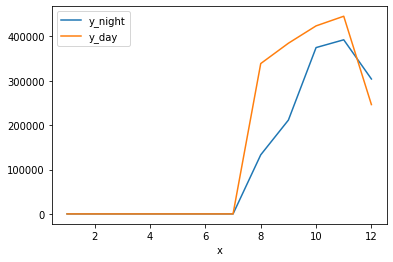

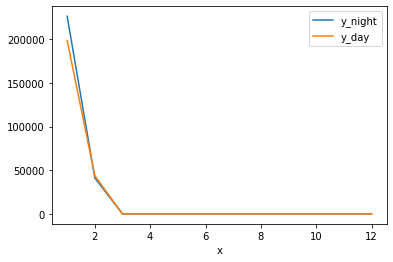

2 month
february nigth
42003.0462201919 february total distance at nigth
43650.04646936641 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
42003.0462201919
42003.0462201919
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
43650.04646936641
0
0
0
0
0
0
0
0
0
0


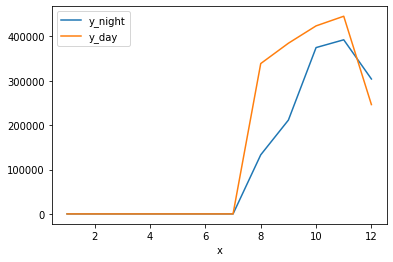

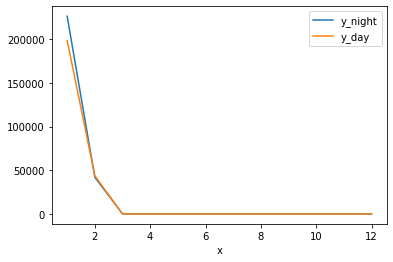

2 month
february nigth
42846.75287235908 february total distance at nigth
43650.04646936641 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
42846.75287235908
42846.75287235908
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
43650.04646936641
0
0
0
0
0
0
0
0
0
0


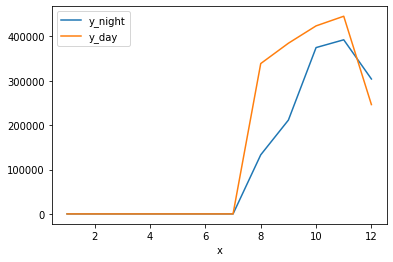

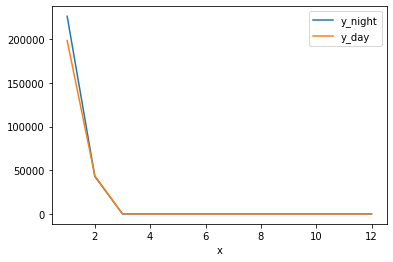

2 month
february nigth
42889.02435956715 february total distance at nigth
43650.04646936641 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
42889.02435956715
42889.02435956715
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
43650.04646936641
0
0
0
0
0
0
0
0
0
0


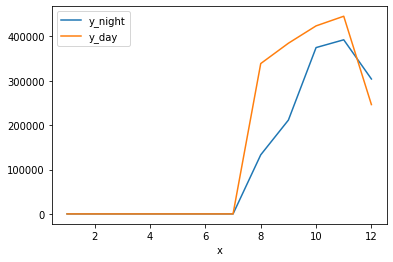

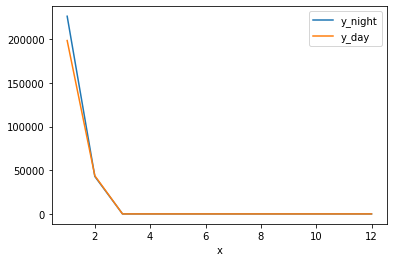

2 month
february nigth
43511.21772449994 february total distance at nigth
43650.04646936641 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
43511.21772449994
43511.21772449994
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
43650.04646936641
0
0
0
0
0
0
0
0
0
0


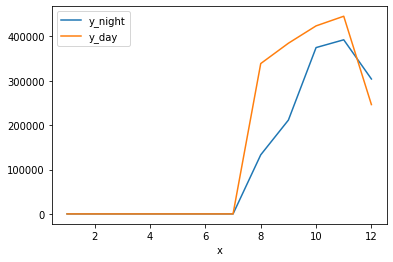

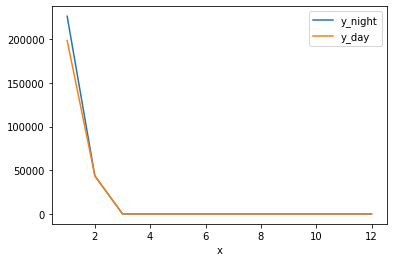

2 month
february nigth
44007.340863041136 february total distance at nigth
43650.04646936641 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
44007.340863041136
44007.340863041136
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
43650.04646936641
0
0
0
0
0
0
0
0
0
0


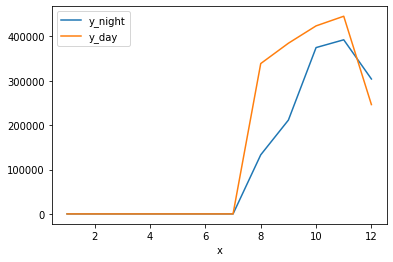

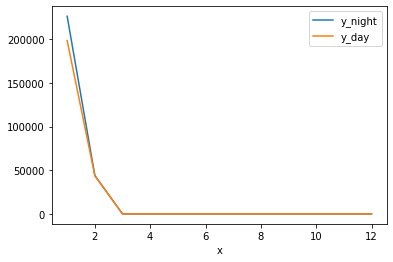

2 month
february day
44007.340863041136 february total distance at nigth
43849.57149870396 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
44007.340863041136
44007.340863041136
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
43849.57149870396
0
0
0
0
0
0
0
0
0
0


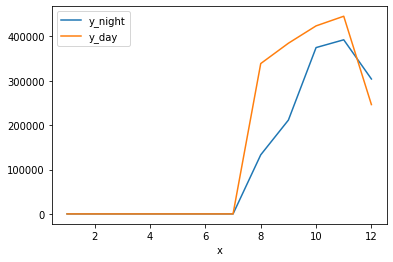

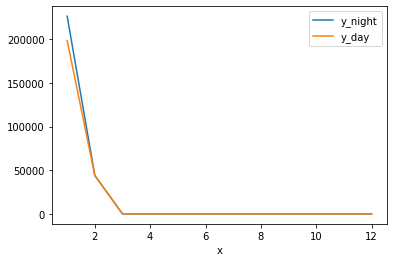

2 month
february day
44007.340863041136 february total distance at nigth
44778.5678810913 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
44007.340863041136
44007.340863041136
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
44778.5678810913
0
0
0
0
0
0
0
0
0
0


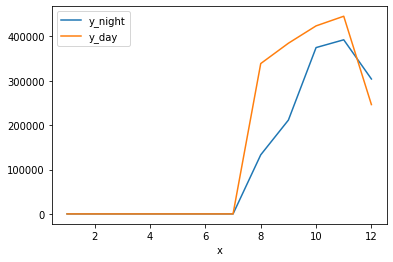

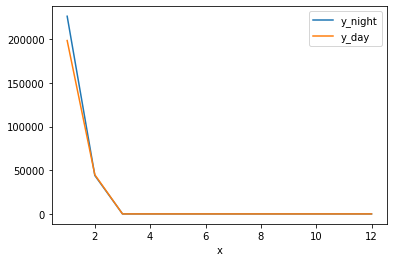

2 month
february day
44007.340863041136 february total distance at nigth
46568.28621514203 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
44007.340863041136
44007.340863041136
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
46568.28621514203
0
0
0
0
0
0
0
0
0
0


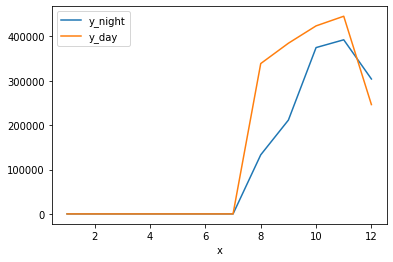

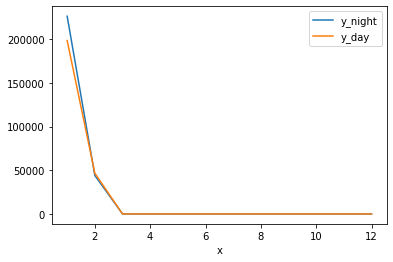

2 month
february day
44007.340863041136 february total distance at nigth
46770.66617601539 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
44007.340863041136
44007.340863041136
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
46770.66617601539
0
0
0
0
0
0
0
0
0
0


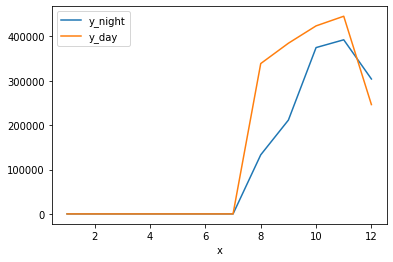

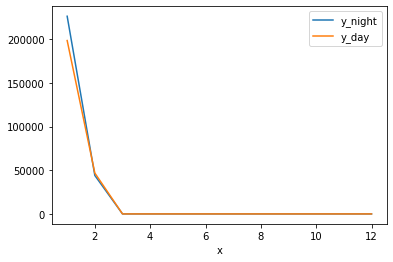

2 month
february nigth
48231.69690569569 february total distance at nigth
46770.66617601539 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
48231.69690569569
48231.69690569569
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
46770.66617601539
0
0
0
0
0
0
0
0
0
0


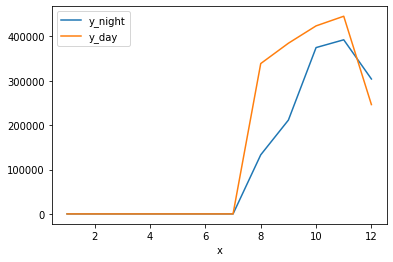

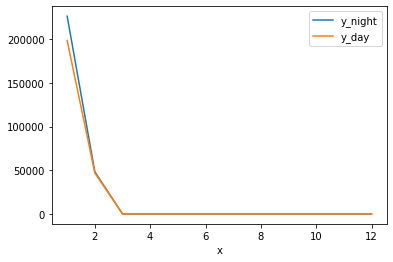

2 month
february nigth
51539.3532754733 february total distance at nigth
46770.66617601539 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
51539.3532754733
51539.3532754733
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
46770.66617601539
0
0
0
0
0
0
0
0
0
0


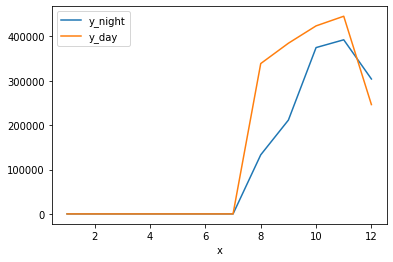

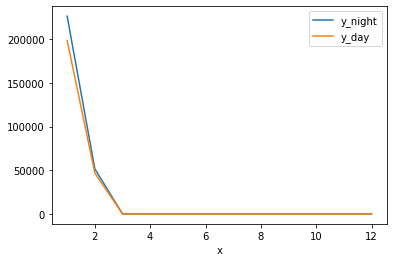

2 month
february nigth
53514.31635913804 february total distance at nigth
46770.66617601539 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
53514.31635913804
53514.31635913804
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
46770.66617601539
0
0
0
0
0
0
0
0
0
0


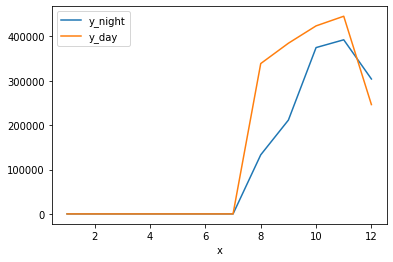

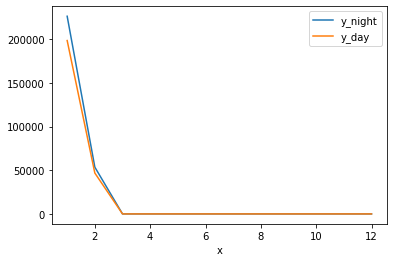

2 month
february nigth
55805.96418826254 february total distance at nigth
46770.66617601539 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
55805.96418826254
55805.96418826254
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
46770.66617601539
0
0
0
0
0
0
0
0
0
0


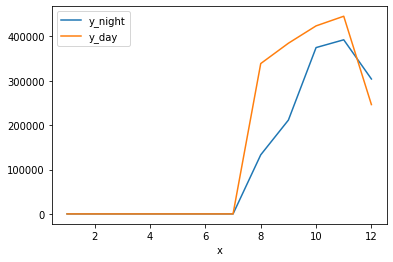

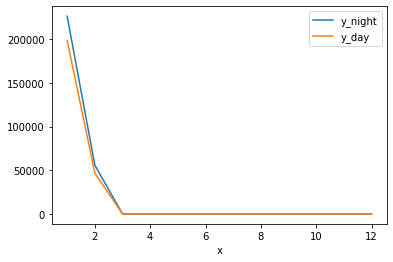

2 month
february day
55805.96418826254 february total distance at nigth
48003.47279076564 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
55805.96418826254
55805.96418826254
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
48003.47279076564
0
0
0
0
0
0
0
0
0
0


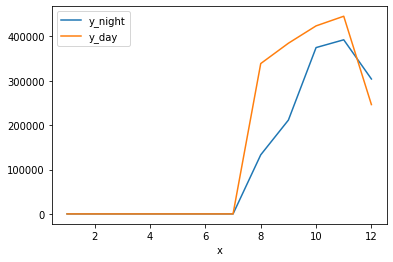

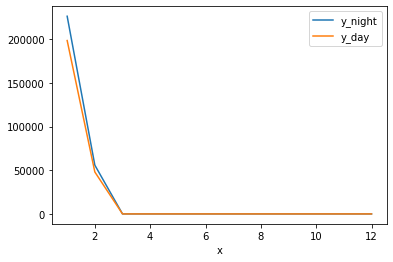

2 month
february day
55805.96418826254 february total distance at nigth
48633.55912147984 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
55805.96418826254
55805.96418826254
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
48633.55912147984
0
0
0
0
0
0
0
0
0
0


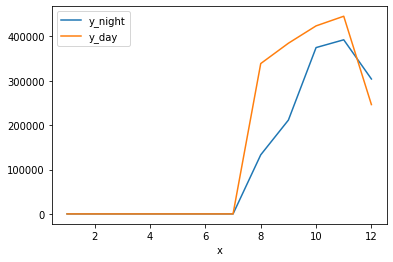

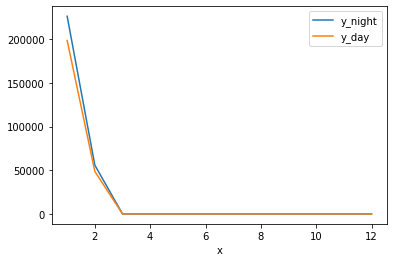

2 month
february day
55805.96418826254 february total distance at nigth
50278.693680867 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
55805.96418826254
55805.96418826254
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
50278.693680867
0
0
0
0
0
0
0
0
0
0


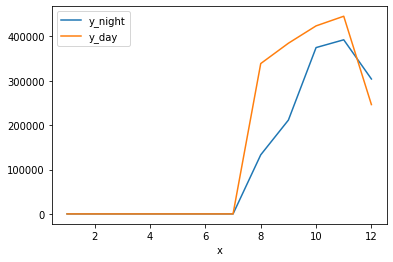

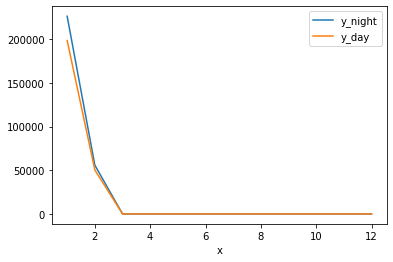

2 month
february day
55805.96418826254 february total distance at nigth
53632.78373637195 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
55805.96418826254
55805.96418826254
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
53632.78373637195
0
0
0
0
0
0
0
0
0
0


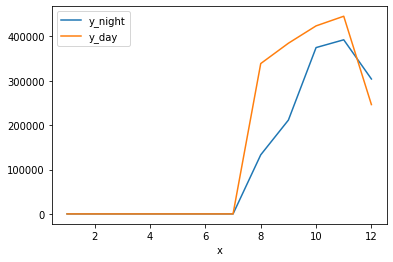

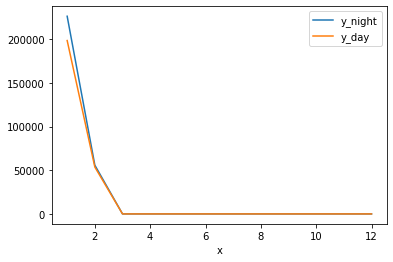

2 month
february day
55805.96418826254 february total distance at nigth
53712.56376564247 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
55805.96418826254
55805.96418826254
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
53712.56376564247
0
0
0
0
0
0
0
0
0
0


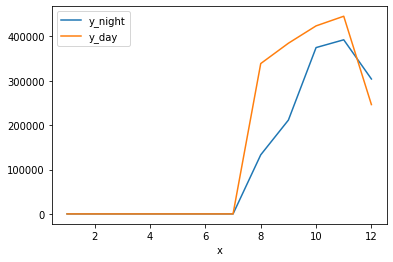

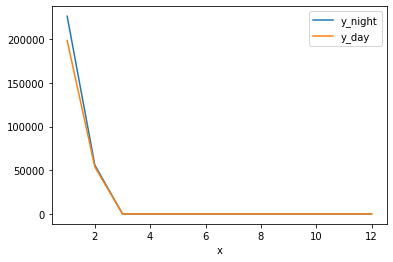

2 month
february nigth
60280.932370368035 february total distance at nigth
53712.56376564247 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
60280.932370368035
60280.932370368035
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
53712.56376564247
0
0
0
0
0
0
0
0
0
0


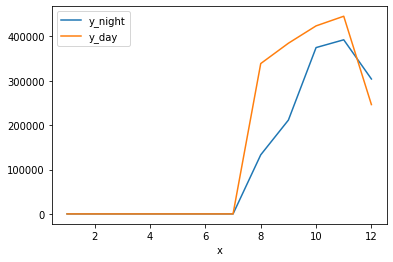

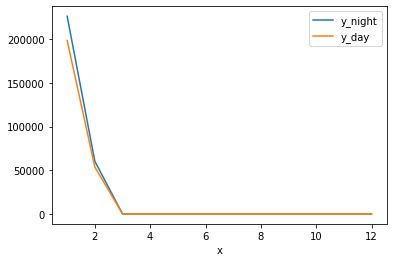

2 month
february nigth
65585.79981605864 february total distance at nigth
53712.56376564247 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
65585.79981605864
65585.79981605864
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
53712.56376564247
0
0
0
0
0
0
0
0
0
0


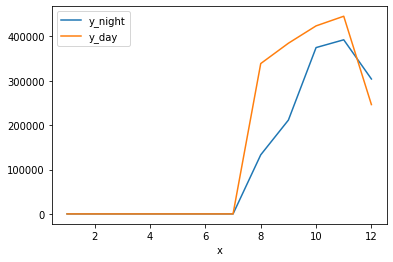

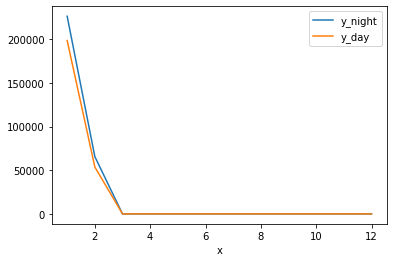

2 month
february nigth
68990.71031675347 february total distance at nigth
53712.56376564247 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
68990.71031675347
68990.71031675347
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
53712.56376564247
0
0
0
0
0
0
0
0
0
0


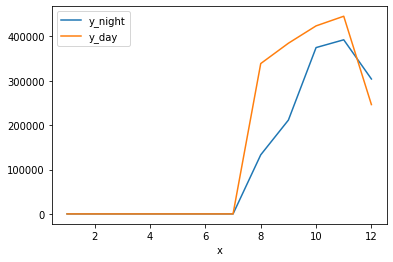

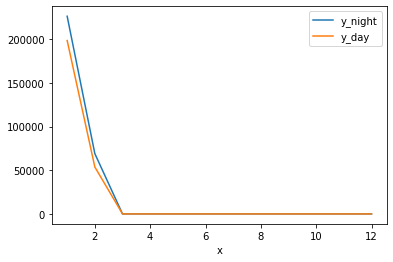

2 month
february nigth
69852.55172148407 february total distance at nigth
53712.56376564247 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
69852.55172148407
69852.55172148407
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
53712.56376564247
0
0
0
0
0
0
0
0
0
0


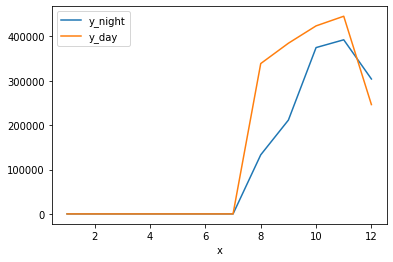

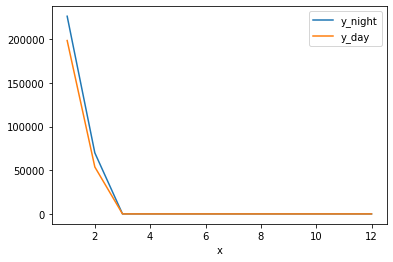

2 month
february nigth
70759.72201171872 february total distance at nigth
53712.56376564247 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
70759.72201171872
70759.72201171872
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
53712.56376564247
0
0
0
0
0
0
0
0
0
0


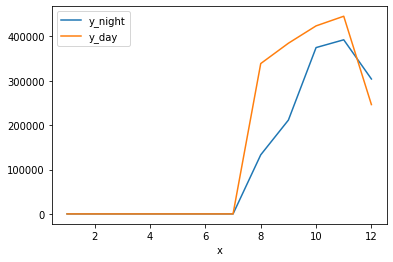

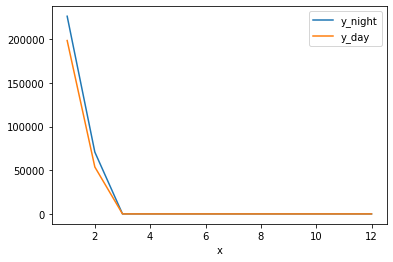

2 month
february nigth
72410.73202844968 february total distance at nigth
53712.56376564247 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
72410.73202844968
72410.73202844968
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
53712.56376564247
0
0
0
0
0
0
0
0
0
0


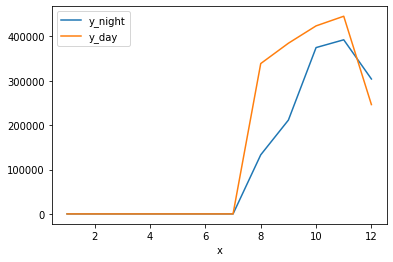

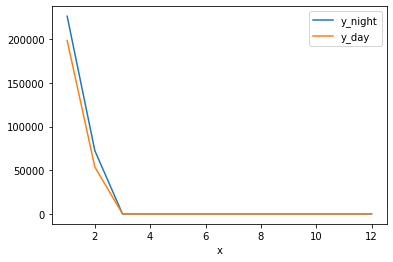

2 month
february day
72410.73202844968 february total distance at nigth
60639.085045714615 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
72410.73202844968
72410.73202844968
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
60639.085045714615
0
0
0
0
0
0
0
0
0
0


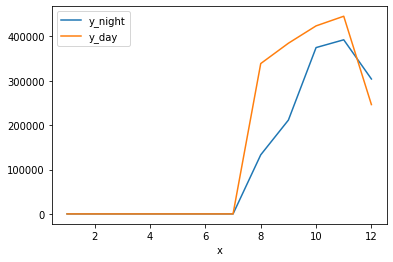

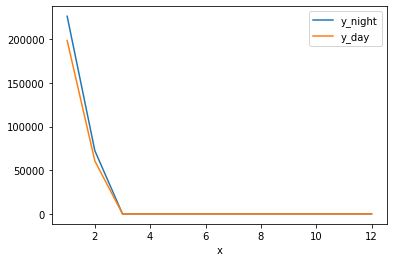

2 month
february day
72410.73202844968 february total distance at nigth
60717.202363348755 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
72410.73202844968
72410.73202844968
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
60717.202363348755
0
0
0
0
0
0
0
0
0
0


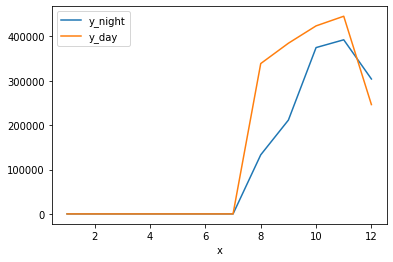

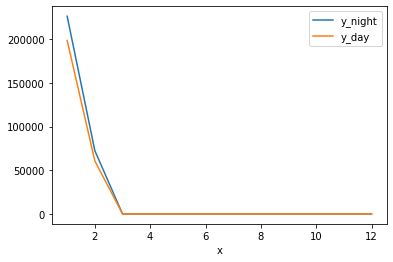

2 month
february day
72410.73202844968 february total distance at nigth
63528.77642132801 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
72410.73202844968
72410.73202844968
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
63528.77642132801
0
0
0
0
0
0
0
0
0
0


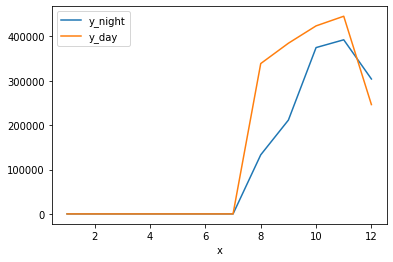

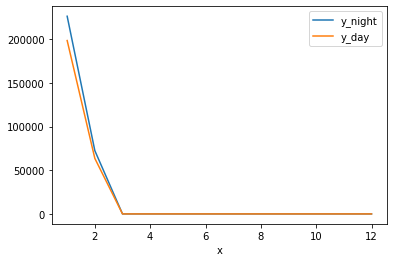

2 month
february day
72410.73202844968 february total distance at nigth
65952.56267551928 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
72410.73202844968
72410.73202844968
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
65952.56267551928
0
0
0
0
0
0
0
0
0
0


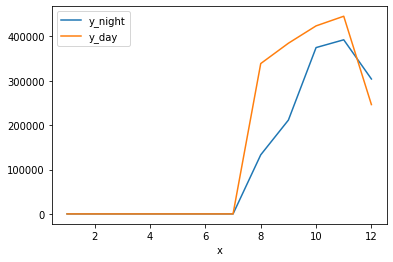

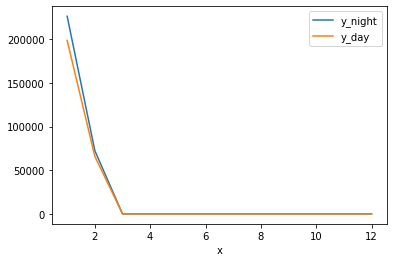

2 month
february nigth
80164.78638963313 february total distance at nigth
65952.56267551928 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
80164.78638963313
80164.78638963313
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
65952.56267551928
0
0
0
0
0
0
0
0
0
0


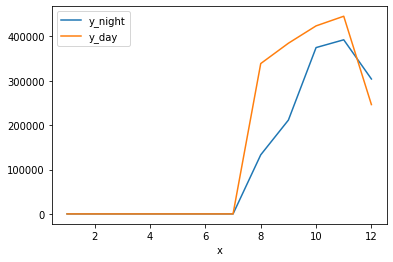

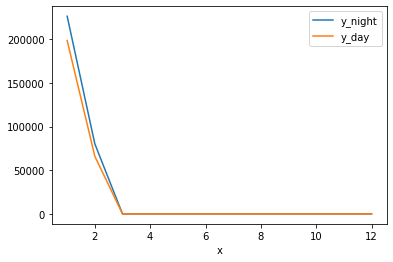

2 month
february nigth
80185.84054205433 february total distance at nigth
65952.56267551928 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
80185.84054205433
80185.84054205433
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
65952.56267551928
0
0
0
0
0
0
0
0
0
0


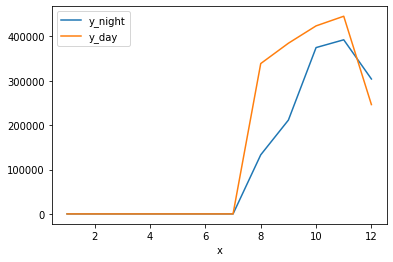

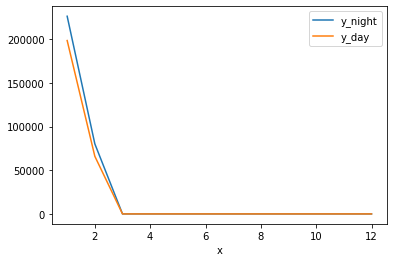

2 month
february nigth
81915.56846522736 february total distance at nigth
65952.56267551928 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
81915.56846522736
81915.56846522736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
65952.56267551928
0
0
0
0
0
0
0
0
0
0


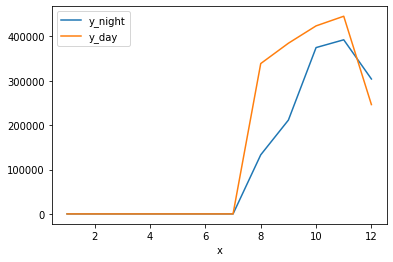

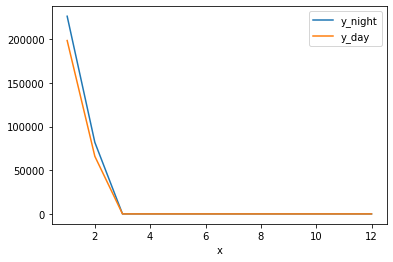

2 month
february day
81915.56846522736 february total distance at nigth
66285.71332607104 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
81915.56846522736
81915.56846522736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
66285.71332607104
0
0
0
0
0
0
0
0
0
0


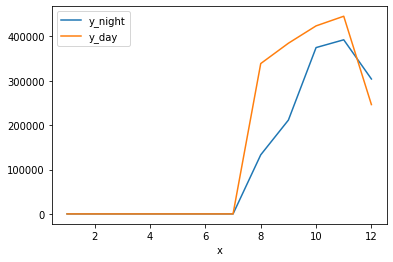

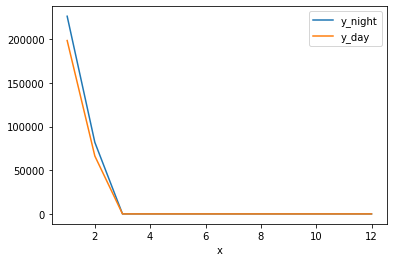

2 month
february day
81915.56846522736 february total distance at nigth
67274.5105258159 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
81915.56846522736
81915.56846522736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
67274.5105258159
0
0
0
0
0
0
0
0
0
0


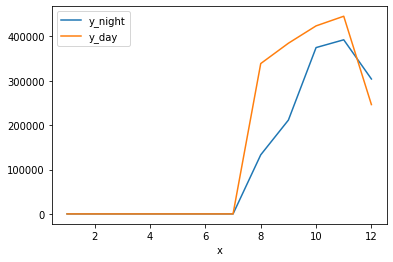

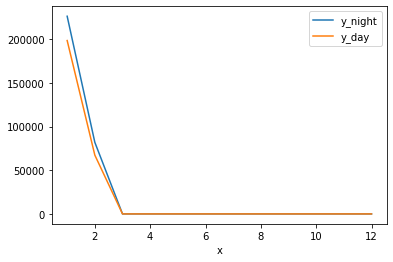

2 month
february day
81915.56846522736 february total distance at nigth
69571.87021800362 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
81915.56846522736
81915.56846522736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
69571.87021800362
0
0
0
0
0
0
0
0
0
0


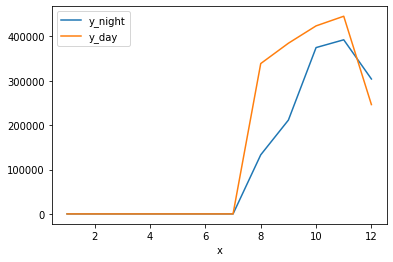

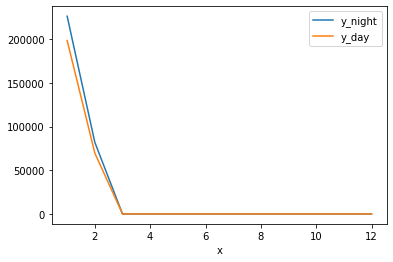

2 month
february day
81915.56846522736 february total distance at nigth
72849.48638327455 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
81915.56846522736
81915.56846522736
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
72849.48638327455
0
0
0
0
0
0
0
0
0
0


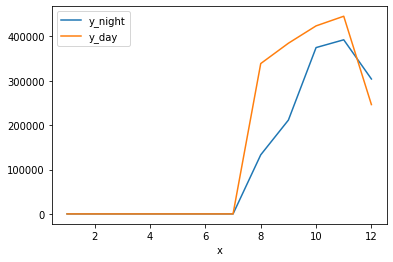

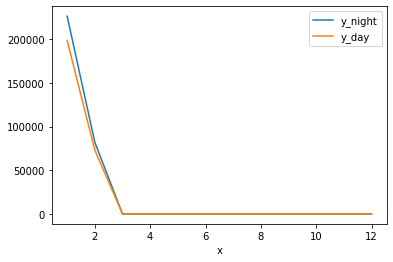

2 month
february nigth
85505.51872054624 february total distance at nigth
72849.48638327455 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
85505.51872054624
85505.51872054624
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
72849.48638327455
0
0
0
0
0
0
0
0
0
0


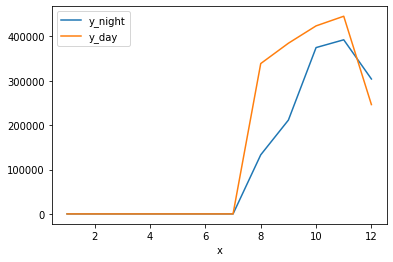

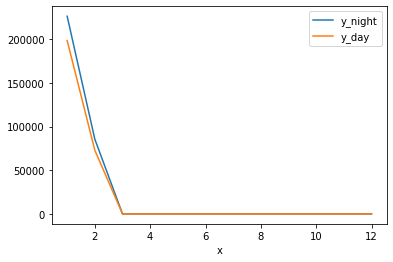

2 month
february nigth
85883.06983614474 february total distance at nigth
72849.48638327455 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
85883.06983614474
85883.06983614474
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
72849.48638327455
0
0
0
0
0
0
0
0
0
0


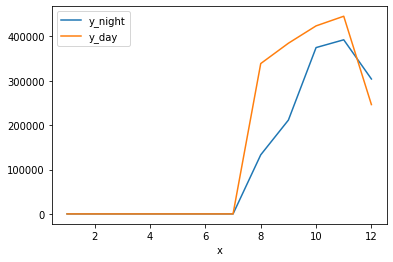

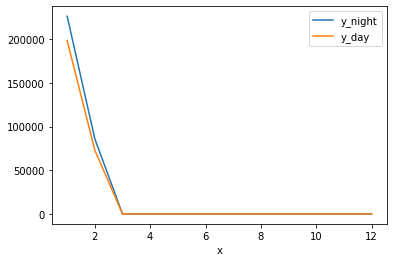

2 month
february nigth
87164.89267936602 february total distance at nigth
72849.48638327455 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
87164.89267936602
87164.89267936602
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
72849.48638327455
0
0
0
0
0
0
0
0
0
0


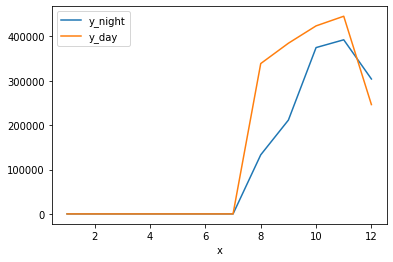

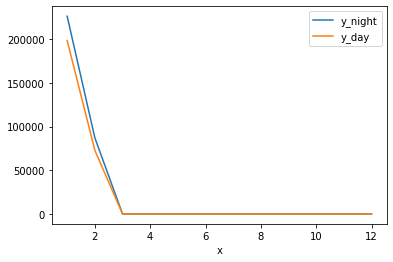

2 month
february nigth
87608.5392942987 february total distance at nigth
72849.48638327455 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
87608.5392942987
87608.5392942987
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
72849.48638327455
0
0
0
0
0
0
0
0
0
0


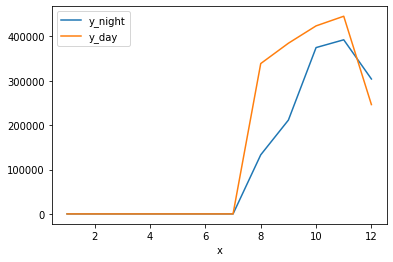

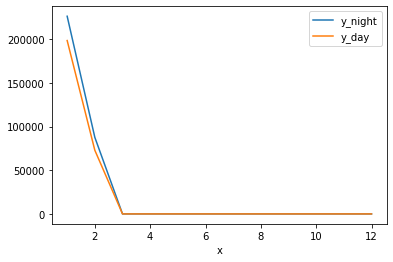

2 month
february nigth
88530.31324027563 february total distance at nigth
72849.48638327455 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
88530.31324027563
88530.31324027563
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
72849.48638327455
0
0
0
0
0
0
0
0
0
0


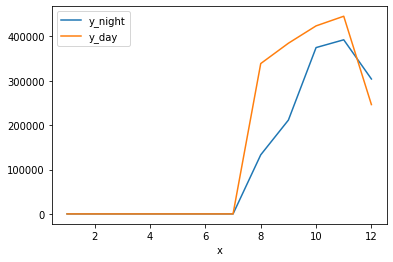

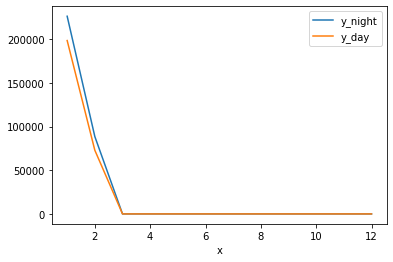

2 month
february nigth
92968.8365113547 february total distance at nigth
72849.48638327455 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
92968.8365113547
92968.8365113547
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
72849.48638327455
0
0
0
0
0
0
0
0
0
0


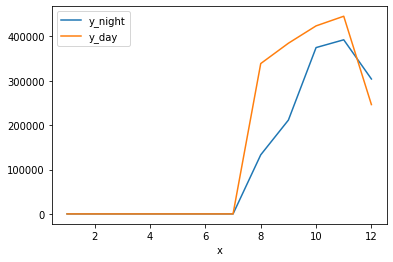

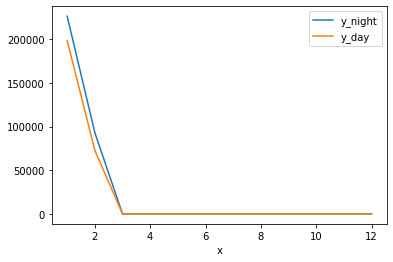

2 month
february nigth
93623.46472409036 february total distance at nigth
72849.48638327455 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
93623.46472409036
93623.46472409036
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
72849.48638327455
0
0
0
0
0
0
0
0
0
0


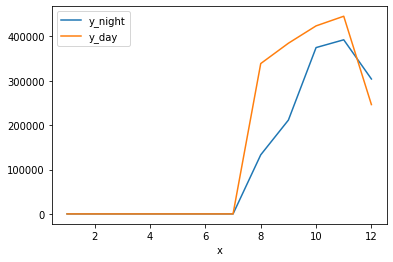

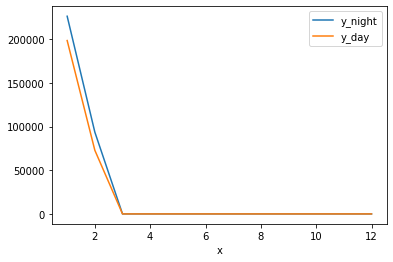

2 month
february day
93623.46472409036 february total distance at nigth
79037.9703461838 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
93623.46472409036
93623.46472409036
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
79037.9703461838
0
0
0
0
0
0
0
0
0
0


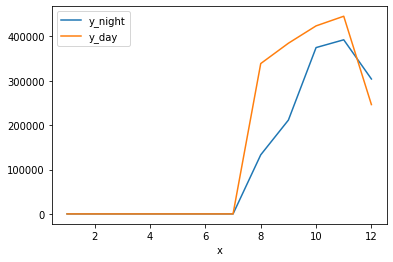

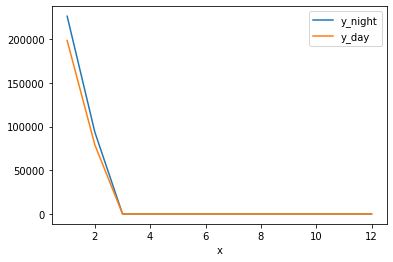

2 month
february day
93623.46472409036 february total distance at nigth
84773.2199308729 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
93623.46472409036
93623.46472409036
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
84773.2199308729
0
0
0
0
0
0
0
0
0
0


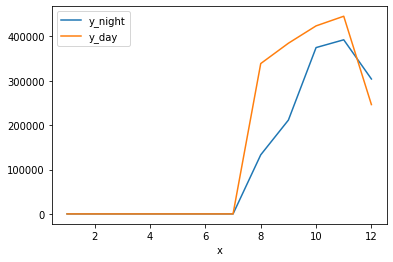

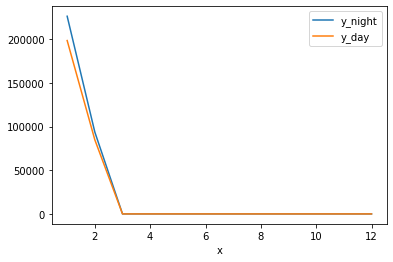

2 month
february nigth
98206.71118176656 february total distance at nigth
84773.2199308729 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
98206.71118176656
98206.71118176656
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
84773.2199308729
0
0
0
0
0
0
0
0
0
0


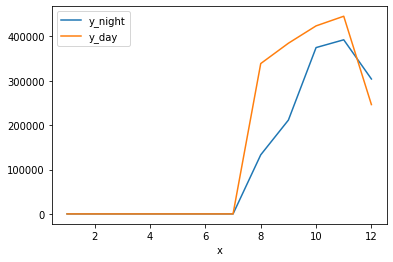

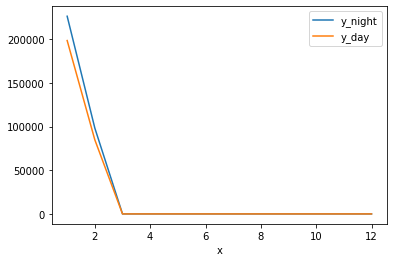

2 month
february nigth
102636.14105013131 february total distance at nigth
84773.2199308729 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
102636.14105013131
102636.14105013131
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
84773.2199308729
0
0
0
0
0
0
0
0
0
0


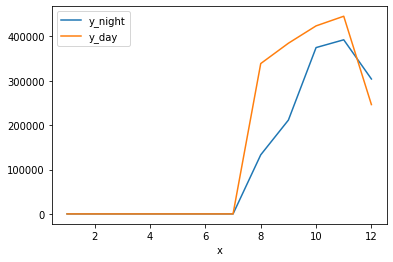

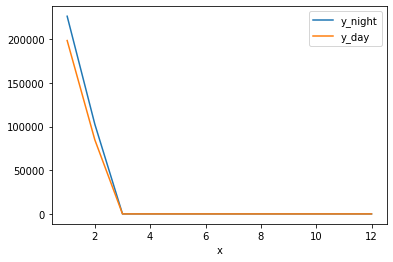

2 month
february nigth
107665.5720154059 february total distance at nigth
84773.2199308729 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
107665.5720154059
107665.5720154059
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
84773.2199308729
0
0
0
0
0
0
0
0
0
0


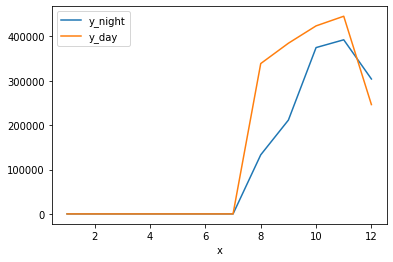

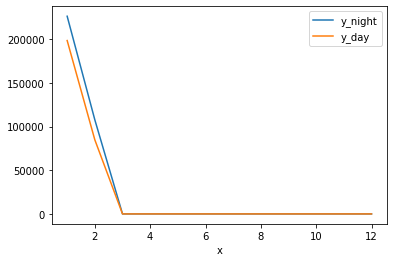

2 month
february nigth
107754.63722678491 february total distance at nigth
84773.2199308729 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
107754.63722678491
107754.63722678491
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
84773.2199308729
0
0
0
0
0
0
0
0
0
0


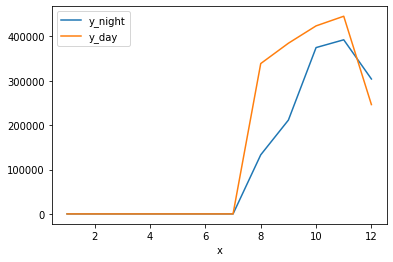

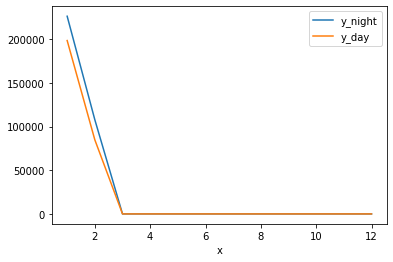

2 month
february day
107754.63722678491 february total distance at nigth
88751.4527033953 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
107754.63722678491
107754.63722678491
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
88751.4527033953
0
0
0
0
0
0
0
0
0
0


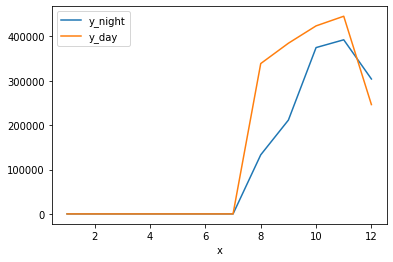

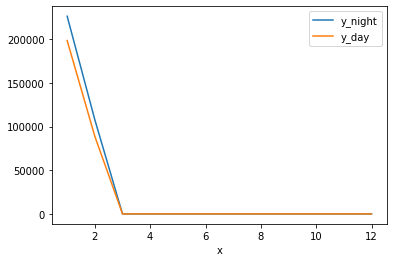

2 month
february day
107754.63722678491 february total distance at nigth
90001.28067880229 february total distance in day
0
0
0
0
0
0
0
0
133180.19859000848
211543.39656898304
374994.11566269415
392555.33285015053
226249.87633906695
107754.63722678491
107754.63722678491
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
338964.16695754416
384820.88042580825
423905.19112408854
445647.18420081114
246509.94076801106
198433.71737991253
90001.28067880229
0
0
0
0
0
0
0
0
0
0


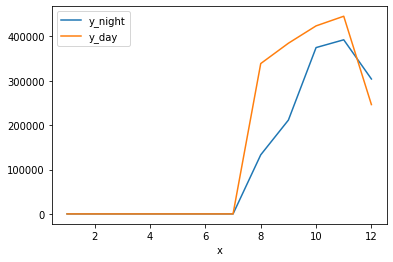

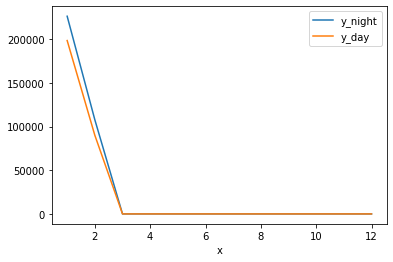

In [25]:
getGPSDfSeparatedByMonth(turtlesData)